<a href="https://colab.research.google.com/github/JoDeMiro/Micado-Research/blob/main/ML_Auto_9.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ToDo
letölteni a pythont és ott futtatni a kódot

huzzon egy nyomot a becslésre is, hogy lássam, hogy hova a faszomba becsüli az első modell
a mit is? ja igen a középtől való eltérést.

csinálni egy második modelt illetve kettőt

az egyik legyen a régi, de hagyjuk a faszba a fel-le becslést, az egész before aftert
és csak egyszerűen kössünk rá a becslésre valamilyen szabályt. Ha nagyobb mint x akkor +3

a másik verzió amit gyorsan ki kéne próbálni, hogy a linreg helyett beteszek egy mlp-t

**ToDo:**

Megnézni, hogy normalizálom-e az adatokat a neruális háló előtt, mert lehet hogy ez viszi félre a becslést.

# Micado Auto Scale Research

Ebben a felskálázási adatok elemzésével foglalkozom.

Ez az interkatív bemutató arra van, hogy a válotzók közötti összefüggéseket jobban átlásssam, elemezzem, az esetleges anomáliákat rögtön kiszúrjam.

A playground részben a rendszer alapját adó neuráli háló beállításaival lehet játszani és megfigyelni, hogy milyen hatással van a rendszer teljesítményére.

<a name="tartalom"></a>

## Tartalom

Bevezetés

> [Empty](#empty)<br>
> [Play Ground](#play_ground)<br>
> [SandBox](#sandbox)<br>
> [Before After](#beforeafter)<br>
> [Szintetikus adatok generálása](#szintetikus_adatok)<br>
> [Irodalom](#irodalom)<br>
> [ToDo](#todo)<br>


## Bevezető gondolat

Összességében az egésszel kapcsolatban van egy hatalmas kérdőjel.

Tulajdonképpen két paradigma van.

Az egyik - nem az enyém - így néz ki:

Egyszerűen becsüjük meg azt, hogy az adott szenzoros adatok alapján mi legyen a döntés kimenetele (fel, le, semmi). Akkor hoztunk jó döntést, ha valamilyen metrika alapján valamilyen költséget minimalizáltunk, vagy maximalizáltunk. Például, ha egy döntéssel sikerült közelebb kerülni a záróvonalhoz, vagyis az út közepére. Vagy az az autó a lehető legmeszebb jutott el anélkül, hogy érintette volna a falat és lehetőleg a leggyorsabban is.

A másik - amin én dolgozom - viszont egy plusz lépéssel egészül ki és ettől sokkal bonyolultabb. Hogy van-e létjogosultsága az ennek a kisérletnek a lényege.

Vannak szenzoros adataink, ami alapján hozunk egy döntést. Eddig olyan mint a máisik, de az érdemi különbség a módszerben és a tanulás folyamatában van.

A szenzoros adatokból megbecsüljük azt, hogy mennyire vagyunk jók és nem azt becsüljük, hogy mit kéne tenni!

Ha nem vagyunk jók akkor egy második modell segítségével csinálunk valamilyen lépést, amitől azt várjuk, hogy jók leszünk.

És itt jogosan merül fel a kérdés, hogy de miért nem az első módszert alkalmazzuk és erre most még én sem tudom a választ pontosan megadni. De röviden erről szól ez a kutatás.

In [1]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.linear_model import LinearRegression

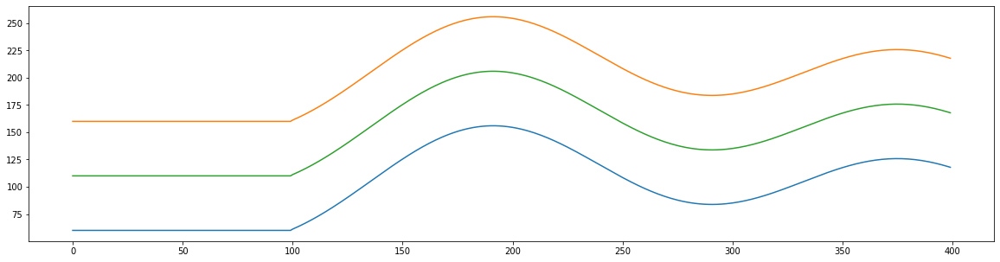

In [2]:
distance    = np.arange(0, 400, 1)
road        = 100
wall_left   = 30*(np.sin(distance/180)) + distance * 0.3 + 30 * np.cos(distance/30) + 50 * np.sin(distance/90)
wall_left[0:100] = 60
wall_right  = wall_left + road
wall_center = ( wall_left + wall_right ) / 2


plt.figure(figsize=(20,5)); plt.plot(wall_left); plt.plot(wall_right); plt.plot(wall_center); plt.show()

In [3]:
class Road():
  def __init__(self, wide):
    self.distance    = np.arange(0, 400, 1)
    self.wide        = wide
    self.wall_right  = 30*(np.sin(self.distance/180)) + self.distance * 0.3 + 30 * np.cos(self.distance/30) + 50 * np.sin(self.distance/90)
    self.wall_right[0:100] = 60
    self.wall_left   = self.wall_right + self.wide
    self.wall_center = ( self.wall_left + self.wall_right ) / 2

  def show(self):
    fig, ax = plt.subplots(figsize=(26,10)); ax.set_ylim(40, 300); ax.plot(self.wall_left); ax.plot(self.wall_right); ax.plot(self.wall_center);
    return fig, ax


In [4]:
class Car():
  def __init__(self, road):
    self.road = road
    self.x = 0
    self.y = self.road.wall_center[0]
    self.sight = 154           # ennyit lát előre 300, 54
    self.sight_center = 150

    self.y_history  = []
    self.x_history  = []
    self.y_center   = []; self.y_center = self.road.wall_center
    self.y_distance = []
    self.y_distance_real = []
    self.y_distance_predicted = []
    self.regression = LinearRegression()
    self.sensor_center = []
    self.sensor_left   = []
    self.sensor_right  = []
    self.before  = []
    self.after   = []

    self.mesterseges_coutner = 0


  def calculate_distances(self):
    # ha bármikor kevesebb a faltól mért távolsága bármelyik szenzoron akkor a szenzorokon mért távolság is ennyi lesz
    
    k = self.x; d = 0
    while(k < self.x + self.sight_center):
      k += 1; d += 1
      self.distance_center_from_wall = d
      if(int(self.road.wall_left[k]) < self.y):
        print('Sensor center = ', self.distance_center_from_wall)
        break
      if(int(self.road.wall_right[k]) > self.y):
        print('Sensor center = ', self.distance_center_from_wall)
        break

    k = self.x; d = 0
    while(k < self.x + self.sight):
      k += 1;  d += 1
      self.distance_left_from_wall = d
      if(int(self.road.wall_left[k]) < self.y + d):
        print('Sensor from left wall = ', self.distance_left_from_wall)
        break

    k = self.x; d = 0
    while(k < self.x + self.sight):
      k += 1; d += 1
      self.distance_right_from_wall = d
      if(int(self.road.wall_right[k]) > self.y - d):
        print('Sensor from right wall = ', self.distance_right_from_wall)
        break

    #ki kell kalkulálni a tényleges távolságot a ball és a jobb faltól
    # mert ezekre fogom tanítani a neurális hálót, ahol ezeket becsüljük
    # és a bemeneti változó a 3 szenzorból érkező adat lesz.
    # valójában azt mérjük, hogy milyen távolságra van az út közepétől

    self.distance_from_top     = abs(self.road.wall_left[self.x] - self.y)
    self.distance_from_bottom  = abs(self.road.wall_right[self.x] - self.y)
    print('most távolsagra van a felső faltól = ', self.distance_from_top)
    print('most távolsagra van az alsó faltól = ', self.distance_from_bottom)


    print('cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc')
    print('self.x                       = ', self.x)
    print('cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc')

    # mi lenne, ha mégis inkább a kettő hányadosát becsülném (1 ha egyenlő távolságra van)
    # self.vertical_distance_from_middle = self.road.wall_center[self.x] - self.y
    # self.vertical_distance_from_middle = self.distance_from_top / self.distance_from_bottom

    self.vertical_distance_from_middle = self.y - self.road.wall_center[self.x]

    print('KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK')
    print('self.vertical_distance_from_middle = ', self.vertical_distance_from_middle)
    print('KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK')




    print('ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa = ', self.vertical_distance_from_middle)


    # de elötte szeretnék még valamit leellenőrizni
    # ezeknek a hossza nem fog megeggyezni a tényleges futások számával, hanem több lesz (milyen jó lett volna erre egy teszt esetet írni és akkor test driven development lenne)

    print('\t\t\t ---------------- Teszt ----------------')
    print('\t\t\t len(self.y_distance)    = ', len(self.y_distance))
    print('\t\t\t len(self.sensor_left)   = ', len(self.sensor_left))
    print('\t\t\t len(self.sensor_center) = ', len(self.sensor_center))
    print('\t\t\t len(self.sensor_right)  = ', len(self.sensor_right))
    print('\t\t\t self.x                  = ', self.x)
    print('\t\t\t -------------- Teszt End --------------')


  def append(self):
    self.y_distance.append(self.vertical_distance_from_middle)

    self.sensor_left.append(self.distance_left_from_wall)
    self.sensor_center.append(self.distance_center_from_wall)
    self.sensor_right.append(self.distance_right_from_wall)

    print('\t\t\t ---------------- Append ----------------')
    print('\t\t\t len(self.y_distance)    = ', len(self.y_distance))
    print('\t\t\t len(self.sensor_left)   = ', len(self.sensor_left))
    print('\t\t\t len(self.sensor_center) = ', len(self.sensor_center))
    print('\t\t\t len(self.sensor_right)  = ', len(self.sensor_right))
    print('\t\t\t self.x                  = ', self.x)
    print('\t\t\t -------------- Append End --------------')


  def run(self):
    for i in range(0, 400, 1):
      print('# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------')
      _summary_mlp_prediction_was_taken = 0
      _summary_mlp_fit_was_taken = 0
      _summary_mesterseges_mozgatas = 0
      _summary_action_was_taken = 0

      self.x = i
      self.calculate_distances()
      # !!!
      self.append()
      # !!!
      if( i % 1 == 0):
        self.plot()

      if( i >= 0 ):

        if( i % 3 == 0 and i >= 12 ):

          print('------------------------------ IF i % 3 == 0 ------------------------------')
          print('# i = ', i)
          print('# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)')
          X = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
          y = np.array([self.y_distance]).T
          print('X.shape = ', X.shape)
          print('y.shape = ', y.shape)
          # print('X       = ', X)
          # print('y       = ', y)
          print('i       = ', i)
          self.regression.fit(X, y)
          _summary_mlp_fit_was_taken = 1

        if( i % 3 == 1 and i >= 22 ):

          print('------------------------------ IF i % 3 == 1 ------------------------------')
          print('# i = ', i)
          print('# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja')
          X_test = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
          _X_test = np.array([X_test[-1,:].reshape(-1,1)])
          _X_test = np.array([X_test[-1,:]])
          print('actual _X_test = ', _X_test)
          predicted_test = self.regression.predict(_X_test)
          _summary_mlp_prediction_was_taken = 1
#most
          self.y_distance_real.append(self.y_distance[-1])
          self.y_distance_predicted.append(predicted_test)
          print('actual predicted = ', predicted_test)
          # print('actual predicted = {:.5f}'.format(predicted_test[0,0]))
          print('actual self.y_distance[-1] = ', self.y_distance[-1])
          print('actual self.y_distance     = ', self.y_distance)
          print('len(self.y_distance_real)      = ', len(self.y_distance_real))
          print('len(self.y_distance_predicted) = ', len(self.y_distance_predicted))

          # olyan szar a becslés, hogy az hihetetlen
          plt.figure(figsize=(12, 5)); plt.scatter(self.y_distance_real, self.y_distance_predicted); plt.show()

          # korábban csak azokat az adatokat plottoltam amik a tanulás után lettek visszamérve,
          # de nézzük meg a teljes adatsoron
          X_test_full = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
          _X_test_full = X_test_full
          predicted_test_full = self.regression.predict(_X_test_full)
          _y_test_full = np.array([self.y_distance]).T
          print(_y_test_full.shape)
          print(predicted_test_full.shape)
          plt.figure(figsize=(12, 5)); plt.scatter(_y_test_full, predicted_test_full, c='r'); plt.show()

          plt.figure(figsize=(12, 5)); ax = plt.axes(); ax.scatter(_y_test_full, predicted_test_full, c='r')
          ax.plot([-10, 2, 4, 10], [-10, 2, 4, 10]); plt.show()


        # most jön az, hogy véletlenszerűen kell egyet ugrania fel, vagy le
        # ez felel meg a before after dologonak
        # az így létrejött adatokat is el kell tárolni úgy mint
        # mi volt a szezoros adat before
        # mi lett a szenzoros adat after
        # mi volt az y before, mi lett az y after
        # mivel mindíg egyet fogunk csak lépni, ezért a dif mindíg egy lesz
        # de ezt számítani kell, mivel a későbbiek folyamán lehet, hogy többet is fog lépni

        if( i % 3 == 2 ):

          print('------------------------------ IF i % 3 == 2 ------------------------------')
          print('# i = ', i)
          print('# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok')

          _summary_mesterseges_mozgatas = 1
          
          if( self.mesterseges_coutner == 0 ):                             # Első lépésben fel
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y + 1
            print('artificial move -> up first')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 1

          elif( self.mesterseges_coutner == 1 ):                           # Második lépésben le
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y - 1
            print('artificial move -> down first')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 2

          elif( self.mesterseges_coutner == 2 ):                           # Harmadik lépésben le
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y - 1
            print('artificial move -> down second')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 3

          elif( self.mesterseges_coutner == 3 ):                           # Negyedik lépésben fel
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y + 1
            print('artificial move -> up second')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 0

          else:
            print('semmi\n\n\n\n')

          print('self.y = ', self.y)



# itt van egy érdekesség amit csak magamnak írok fel
# ezen a ponton lépünk ki a három if ágból - if( i % 3 == _ )

# ez azért fontos, mert ami itt következik az mindíg lefut
# akár volt neurális háló tanítás
# akár volt neurális háló predikció visszamérése
# akár volt mesterséges mozgatás


# felmerül a kérdés de csak felmerül, hogy nem lehet-e az, hogy ezt csak akkor kéne elvégezni amikor nincs neurális háló tanítás és nincs mesterséges mozgatás sem
# ezt csak egy kísérlet ereéig ki kéne próbálni (if i % 3 == 1) -> vagyis amikor az nn predikció mérése történik

        action = 0
        if( i % 3 == 0 ):

          if( len(self.before) > 9 ):           # ha már van néhány before after adatunk, akkor

            print('------------------------------ IF len(self.before) > 9 ------------------------------')
            print('\n')
            print('# i = ', i)
            print('  Ha már van elég before after adatunk')
            print('# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára')
            # minden egyes szezor adatára el kell készítenünk azt a lineráis regressziós modelt ami megmondja, hogy mi lenne a szenzor értéke, ha 1, 2, 3, ... n lépéssel elvinnénk a kocsit

            # oké megvan a before és megvan az after (self.y, left, center, right)
            before_array = np.array(self.before)
            after_array  = np.array(self.after)
            y_delta = after_array[:,0] - before_array[:,0]
            delta_array = after_array - before_array
            print('--------------------------------------')
            print(y_delta)
            print(before_array.shape)
            print(after_array.shape)
            print(self.before)
            print(self.after)
            print(delta_array)
            print('--------------------------------------')

            # képlet szerint senzor' = w0 + w1 * senzor + w2 * delta_y
            # valójában ez a képlet nem jó és nem így kéne számolni, mert ez figyelembe veszi a szenzor aktuális értékét is, de most így hagyom
            # ------- fenti sort nem tudom miért írtam, hogy baj az ha figyelembe veszük az aktuális értéket is, hm.

            print('# Linear Regression Learning --------------------------------------------------------------------------------------')
            print('\t\t # Linear Regression Training Results -------------------------------------------------------------------------')

            _X_left = np.array([before_array[:,1], delta_array[:,0]]).T # left és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_left = delta_array[:,1].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_left = after = after_array[:,1].reshape(-1, 1)
            regression_left = LinearRegression()
            regression_left.fit(_X_left, _y_left)
            # print('\t\t _X_left = \n', _X_left)
            # print('\t\t _y_left = \n', _y_left)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_left.coef_ = ', regression_left.coef_)
            _predicted_left = regression_left.predict(_X_left)
            plt.scatter(_y_left, _predicted_left)
            plt.show()

            _X_center = np.array([before_array[:,2], delta_array[:,0]]).T # center és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_center = delta_array[:,2].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_center = after_array[:,2].reshape(-1, 1)
            regression_center = LinearRegression()
            regression_center.fit(_X_center, _y_center)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_center.coef_ = ', regression_center.coef_)
            _predicted_center = regression_center.predict(_X_center)
            plt.scatter(_y_center, _predicted_center)
            plt.show()

            _X_right = np.array([before_array[:,3], delta_array[:,0]]).T # right és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_right = delta_array[:,3].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_right = after_array[:,3].reshape(-1, 1)
            regression_right = LinearRegression()
            regression_right.fit(_X_right, _y_right)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_right.coef_ = ', regression_right.coef_)
            _predicted_right = regression_right.predict(_X_right)
            plt.scatter(_y_right, _predicted_right)
            plt.show()

            # most ki kell számolni, hogy mennyi lenne a szenzorok értéke, ha fel le lépkednénk

            # mondjuk maximalizáljuk a fel le lépkedés mértékét 5-ben

            move = np.array([-5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5])

            move = np.array([-2, -1, 0, 1, 2])

            move = np.array([-3, -2, -1, 0, 1, 2, 3])

  # most


            print('\t # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------')

            print('\t\t # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke')
            proba_X_metrika   = np.array([1,1]).reshape(1, -1)
            print('proba_X_metrika   = ', proba_X_metrika)
            predicted_proba_left = regression_left.predict(proba_X_metrika)
            predicted_proba_center = regression_center.predict(proba_X_metrika)
            predicted_proba_right = regression_right.predict(proba_X_metrika)
            print('-------- 1 y up ->  left   = ', predicted_proba_left)
            print('-------- 1 y up ->  center = ', predicted_proba_center)
            print('-------- 1 y up ->  right  = ', predicted_proba_right)
            print('\n')

            # EGY KURVA NAGY ELMÉLETI DILLEMMÁHOZ ÉRKEZTEM.

            # HÁROM MEGOLDÁS VAN

            # EBBŐL SZERINTEM MOST A LEGROSSZABBAT VÁLASZOTTAM

            # 1, MINDENKÉPPEN VÁLASZT EGYET, A LEGJOBBAT

            # 2, CSAK AKKOR MODOSÍT HA KÖZELEBB TUDJA VINNI A KÖZÉPPONTHOZ MINT AHOL MOST VAN
            
            action = 0; tmp = 999999990

            for j in move:
              print('\n')
              print('\t\t minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba')
              print('\t\t j = ', j)
              # ide be kell helyettesítenem az éppen aktuális értéket, olyan mintha egy új X változót csinálnék amiben csak egy sor van és arra kérnék egy becslést a korábbi modell alapján
              # a bement az éppen aktuális szenzoros érték és az új lépés

              # na majd ezt a bemenetet kell ellenőrizni, hogy stimmel-e a tanítás során használt bemenettel
              _X_left   = np.array([[self.distance_left_from_wall, j]])
              _X_center = np.array([[self.distance_center_from_wall, j]])
              _X_right  = np.array([[self.distance_right_from_wall, j]])

              print('\t\t ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------')
              print('\t\t _X_left   = ', _X_left)
              print('\t\t _X_center = ', _X_center)
              print('\t\t _X_right  = ', _X_right)

              # a fenti értékek valószínűleg jók, de mindíg minden lépésnél ellenőrizni kell

              predicted_left   = regression_left.predict(_X_left)
              predicted_center = regression_center.predict(_X_center)
              predicted_right  = regression_right.predict(_X_right)

              print('\t\t predicted_left   = ', predicted_left)
              print('\t\t predicted_center = ', predicted_center)
              print('\t\t predicted_right  = ', predicted_right)

              print('\t\t --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------')
              print('\t\t regression_left.coef_   = ', regression_left.coef_)
              print('\t\t regression_center.coef_ = ', regression_center.coef_)
              print('\t\t regression_right.coef_  = ', regression_right.coef_)
              print('\t\t regression_left.intercept_   = ', regression_left.intercept_)
              print('\t\t regression_center.intercept_ = ', regression_center.intercept_)
              print('\t\t regression_right.intercept_  = ', regression_right.intercept_)

              # nekünk majd azt az értéket kell választanunk amelyik segítségével a legközelebb jutunk a 1 értékhez

              _X = np.array([predicted_left.ravel(), predicted_center.ravel(), predicted_right.ravel()]).T    # figyelni kell rá, hogy eredetileg is ez volt-e a változók sorrendje

              print('\t\t # Ez lesz a bemenete a neurális hálónak')
              print('\t\t -------------------------X-------------------------')
              print('\t\t ', _X)
              print('\t\t ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------')

              predicted_position = self.regression.predict(_X)

              print('\t\t predicted_position = ', predicted_position)
              print('\t\t --------------------------------------------------------------------------------------------------------------------------------------')

              # legyünk bátrak és módosítsuk az autó self.y pozicióját

              # azzal az értékkel amely abszolút értékben a legkissebb, helyett
              # mivel a célváltozónk akkor jó ha 1. mivel a felső/alsótól mért távolság hányadosa
              # ezért itt azt az értéket kell kiválasztani ami a legközelebb van +1-hez (és nem azt amelyik 0-hoz)

              # természetesen ezen változtatni kell ha ismét az középvonaltól való eltérés mértékét akarjuk becsülni
              # de ahhoz fenti is át kell állítani az adatokat

              if( abs(0 - predicted_position) < tmp):       # rossz - javítva - tesztelés alatt
                action = j
                tmp = abs(0 - predicted_position)
                print('\t\t ---------------------')
                print('\t\t  action = ', action)
                print('\t\t  predicted_position = ', predicted_position)
                print('\t\t  distance from 0 (tmp)= ', tmp)
                print('\t\t ---------------------')

              print('\t\t adott j-re {0} kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------'.format(j))
              print('\t\t --------------------------------------------------------------------------------------------------------------------------------------')
            
            print('\t minden j-re kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------\n')

# igazság szerint ez a kör ahogy mondtam minden lépésben lefut ha már van elég before after adatunk


# a döntés azonban csak akkor fut le ha az alábbi feltétel teljesül

          if( i % 3 == 0 ):                                                       # ugyan ez a feltétel amikor tanítom az út közepének a becslésére
            print('------------------------------ IF i % 3 == 0 ------------------------------')
            _summary_action_was_taken = 1
            print('=================== TAKE ACTION ===================')
            print('-------- ennyivel módosítom self.y értékét --------')
            print('self.y régi értéke = ', self.y)
            self.y = self.y + action
            print('self.y új értéke   = ', self.y)
            print('action             = ', action)
            print('----------------- módosítás vége -----------------')

          # újra kell gondolni az egészet, ugyanis akkor is ki kell számolni a before after értéket amikor modosítom a pozicióját,
          # vagyis végig kell gondolni ezt az egészet.
          # az első elképzelésem az volt, hogy a poziciót csak bizonyos esetben modosíthatom, csak akkor amikor nincs tanítás, és nincs szimulált emelés, vagy csökkentés sem
          # utóbbit az if( i % 3 == 2) feltétellel szűrtem


      # adjuk hozzá az értéket a self.y_history-hoz
      print('# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------')
      print('#   itt adom hozzás a self.y a self.y_history-hoz')
      self.y_history.append(self.y)
      print('#    self.y :')
      print(self.y)
      print('#   self.y_history after append :')
      print(self.y_history)
      print('# \t\t ----------------- Summary -----------------')
      print('# \t\t\t _summary_mlp_fit_was_taken         = ', _summary_mlp_fit_was_taken)
      print('# \t\t\t _summary_mlp_prediction_was_taken  = ', _summary_mlp_prediction_was_taken)
      print('# \t\t\t _summary_mesterseges_mozgatas      = ', _summary_mesterseges_mozgatas)
      print('# \t\t\t _summary_action_were_taken         = ', _summary_action_was_taken)
      print('# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++')
          



  def plot(self):
    fig, ax = self.road.show()
    circle = plt.Circle((self.x, self.y), 5, color='black')
    ax.add_patch(circle)
    ax.plot(range(int(self.x), int(self.x+self.distance_center_from_wall)), np.repeat(self.y, self.distance_center_from_wall))
    ax.plot(range(int(self.x), int(self.x+self.distance_left_from_wall)), range(int(self.y), int(self.y+self.distance_left_from_wall)))
    ax.plot(range(int(self.x), int(self.x+self.distance_right_from_wall)), range(int(self.y), int(self.y-self.distance_right_from_wall), -1))
    if( len(self.y_history) > 0 ):
      ax.plot(self.y_history)
    plt.show()

Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------


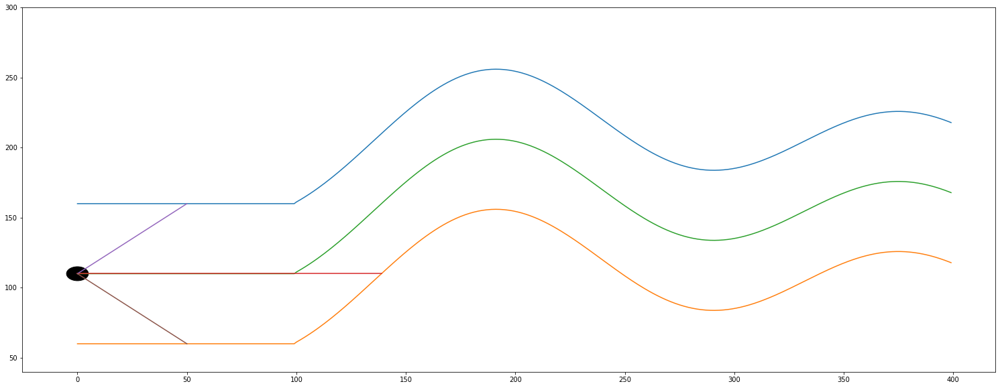

In [5]:
road = Road(wide = 100)
auto = Car(road)

auto.calculate_distances()
auto.plot()

In [6]:
auto.calculate_distances()

Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------


# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------
			 ---------------- 

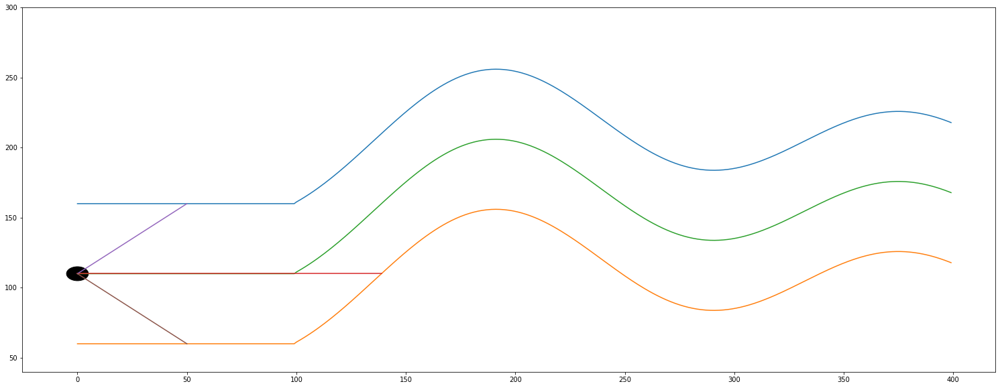

------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  110.0
self.y új értéke   =  110.0
action             =  0
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  1
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----

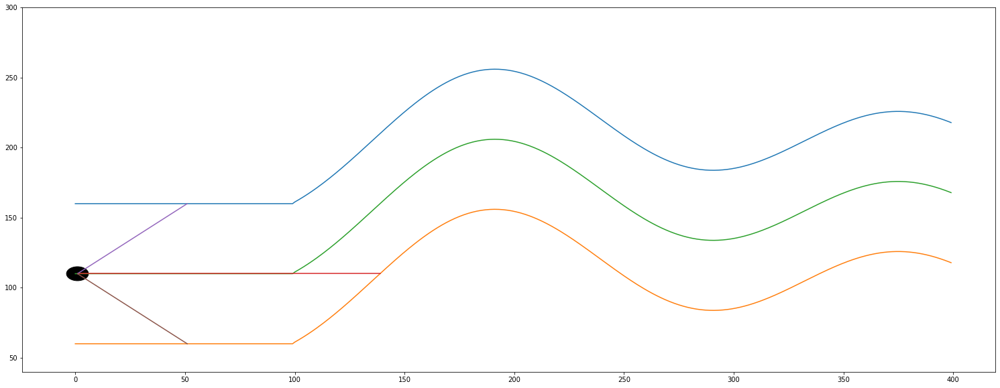

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  138
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
ccccccc

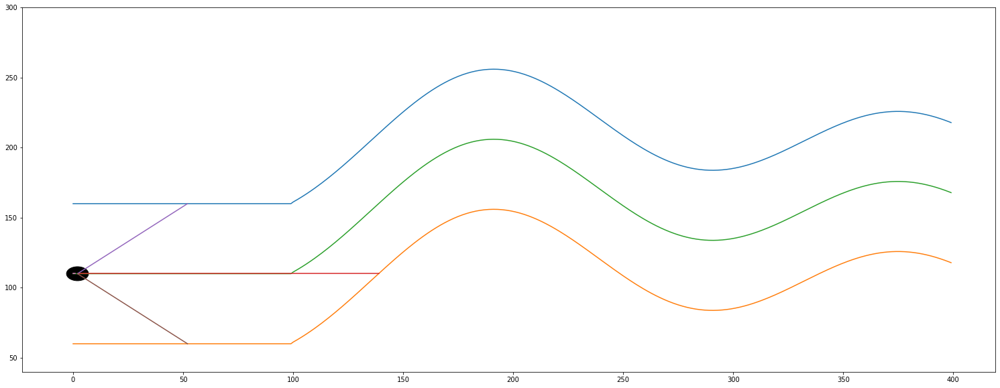

------------------------------ IF i % 3 == 2 ------------------------------
# i =  2
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  139
Sensor from left wall =  50
Sensor from right wall =  52
most távolsagra van a felső faltól =  49.0
most távolsagra van az alsó faltól =  51.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  3
			 len(self.sensor_left)   =  3
			 len(self.sensor_center) =  3
			 len(self.sensor_right)  =  3
			 self.x                  =  2
			 -------------

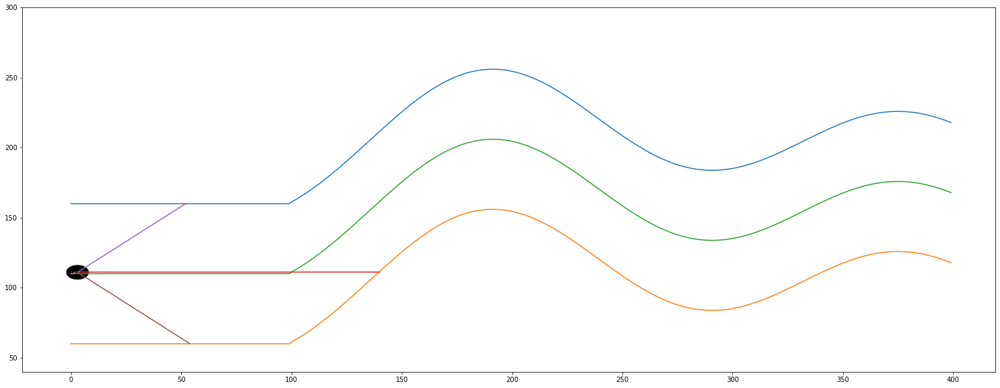

------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  111.0
self.y új értéke   =  111.0
action             =  0
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
111.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  1
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A r

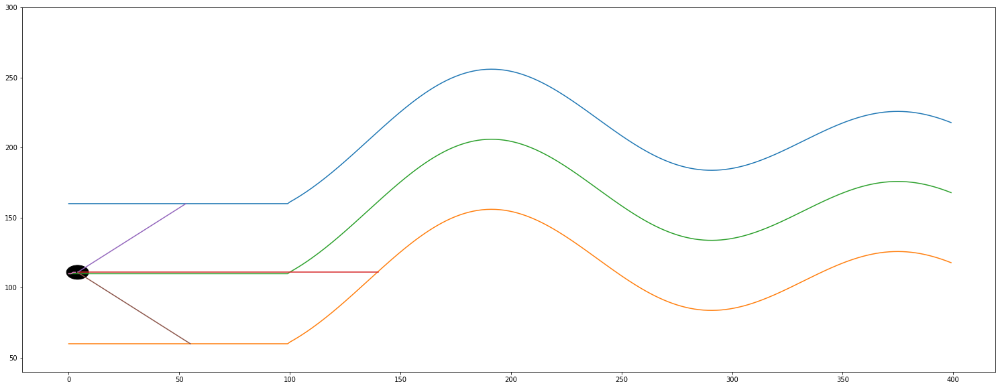

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
111.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  136
Sensor from left wall =  50
Sensor from right wall =  52
most távolsagra van a felső faltól =  49.0
most távolsagra van az alsó f

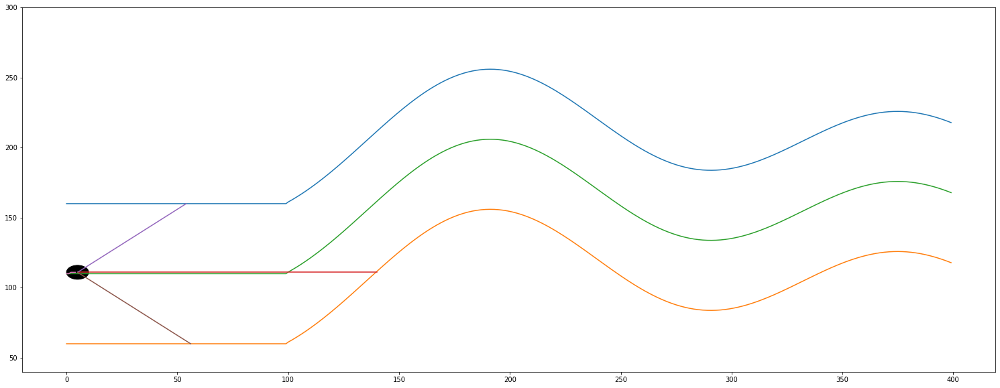

------------------------------ IF i % 3 == 2 ------------------------------
# i =  5
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  135
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  5
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  6
			 len(self.sensor_left)   =  6
			 len(self.sensor_center) =  6
			 len(self.sensor_right)  =  6
			 self.x                  =  5
			 -----------

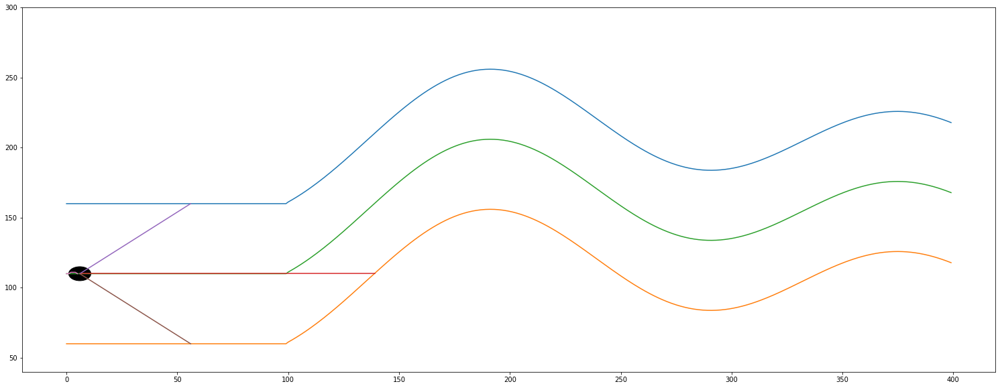

------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  110.0
self.y új értéke   =  110.0
action             =  0
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  1
# A run ciklus vége +++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

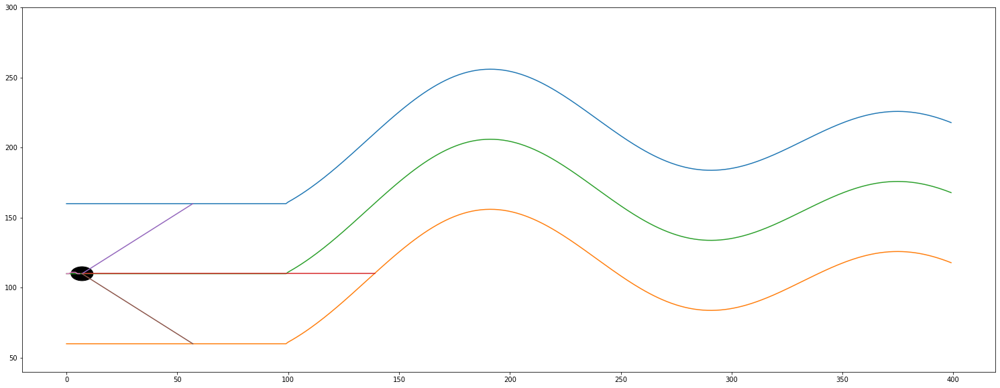

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  132
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most táv

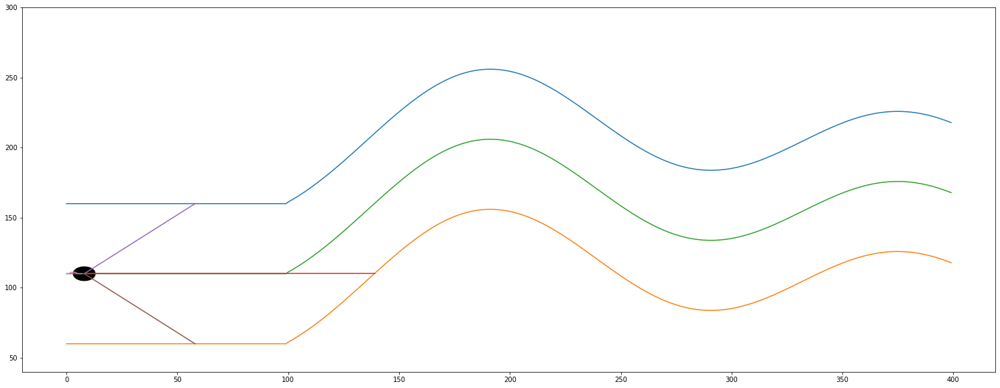

------------------------------ IF i % 3 == 2 ------------------------------
# i =  8
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  131
Sensor from left wall =  52
Sensor from right wall =  50
most távolsagra van a felső faltól =  51.0
most távolsagra van az alsó faltól =  49.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  8
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  9
			 len(self.sensor_left)   =  9
			 len(self.sensor_center) =  9
			 len(self.sensor_right)  =  9
			 self.x                  =  8
			 --------

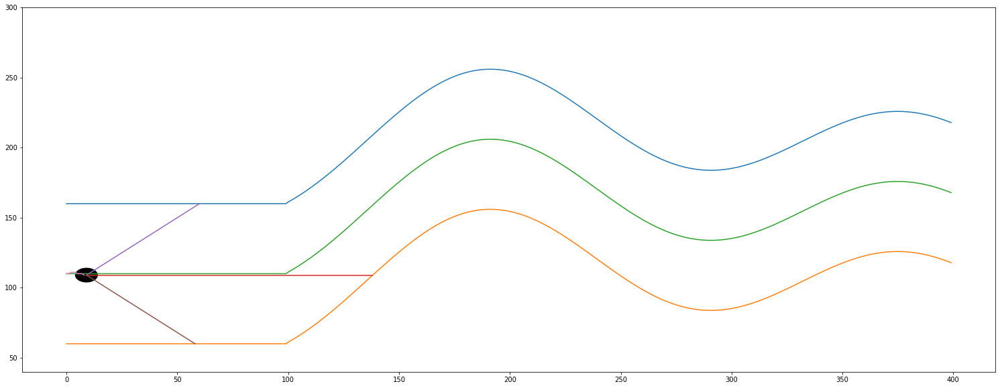

------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  109.0
self.y új értéke   =  109.0
action             =  0
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
109.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  1
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

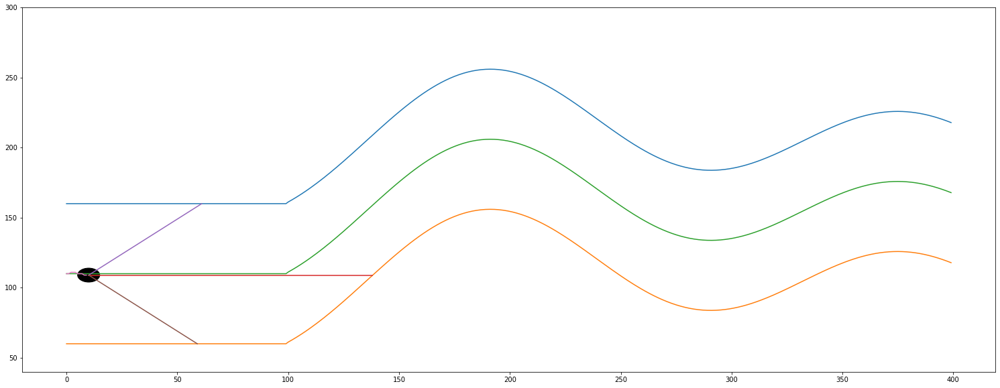

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
109.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  128
Sensor from left wall =  52
Sensor from right wall =  50
most távolsagra van a felső fa

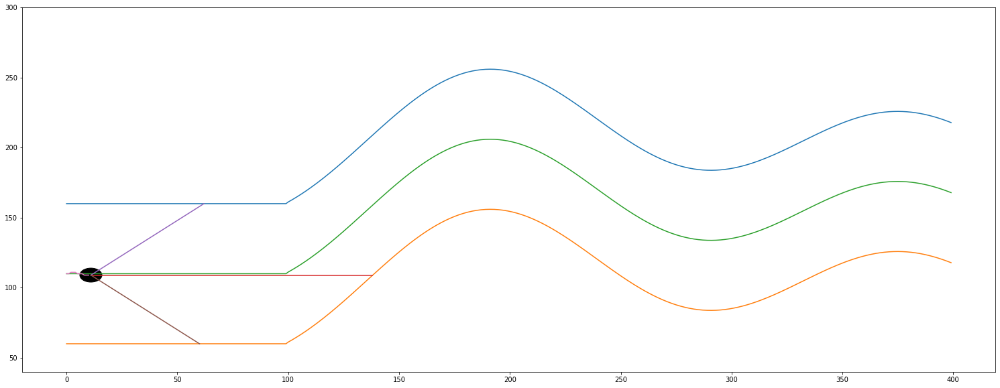

------------------------------ IF i % 3 == 2 ------------------------------
# i =  11
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  129
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  11
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  12
			 len(self.sensor_left)   =  12
			 len(self.sensor_center) =  12
			 len(self.sensor_right)  =  12
			 self.x                  =  11
			 -----

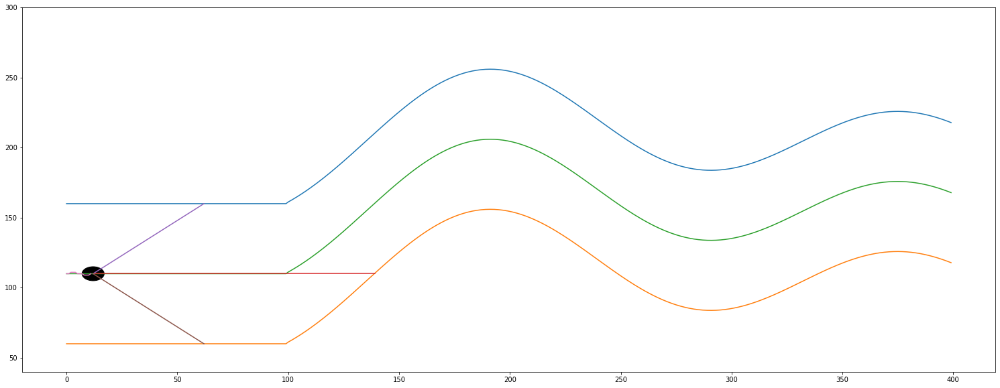

------------------------------ IF i % 3 == 0 ------------------------------
# i =  12
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (13, 3)
y.shape =  (13, 1)
i       =  12
------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  110.0
self.y új értéke   =  110.0
action             =  0
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_

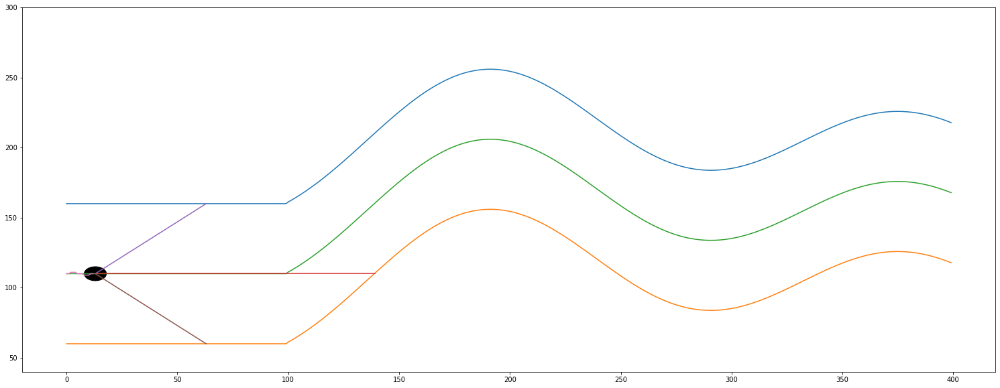

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  126
Sensor from left wall =  51
Sensor from right wall =  51
most távo

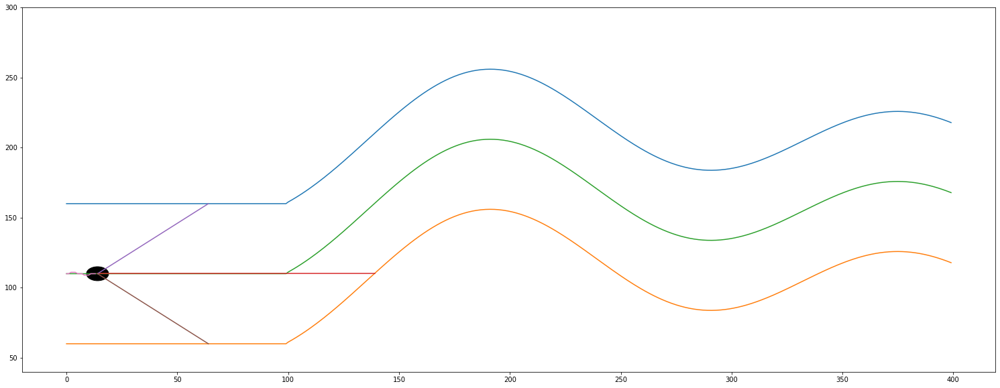

------------------------------ IF i % 3 == 2 ------------------------------
# i =  14
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  127
Sensor from left wall =  50
Sensor from right wall =  52
most távolsagra van a felső faltól =  49.0
most távolsagra van az alsó faltól =  51.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  14
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  15
			 len(self.sensor_left)   =  15
			 len(self.sensor_center) =  15
			 len(self.sensor_right)  =  15
			 self.x                  =  14
			 ------

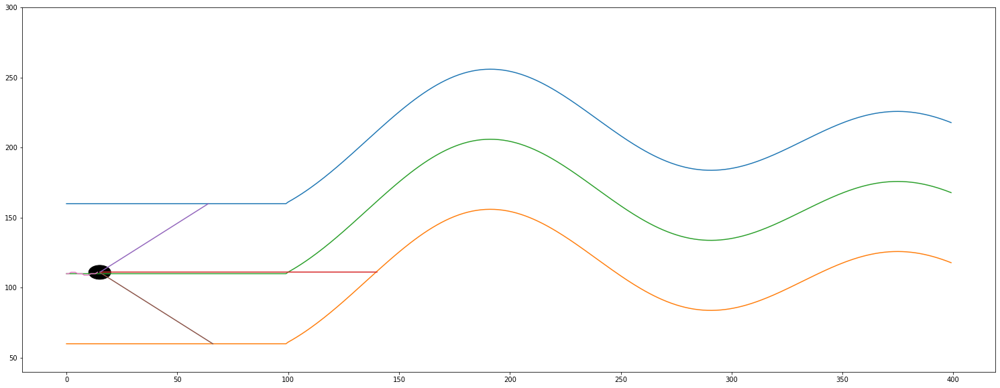

------------------------------ IF i % 3 == 0 ------------------------------
# i =  15
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (16, 3)
y.shape =  (16, 1)
i       =  15
------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  111.0
self.y új értéke   =  111.0
action             =  0
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
111.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0]
# 		 ----------------- Summary -----------------
# 

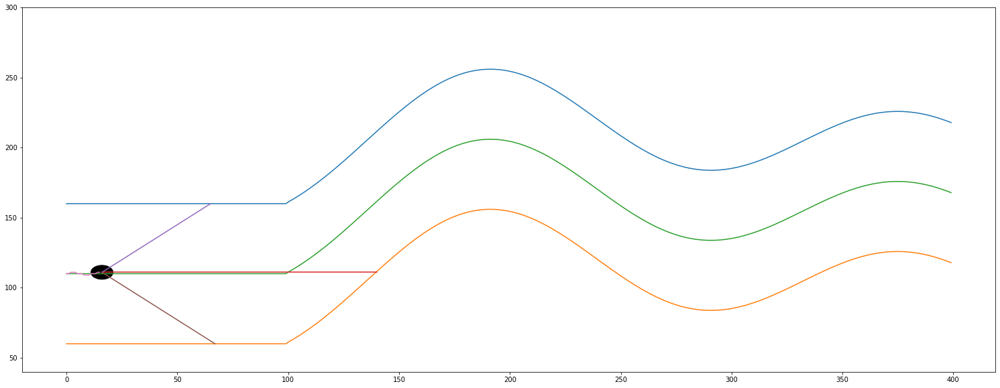

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
111.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  124
Sensor from left wall =  50
Sensor from right

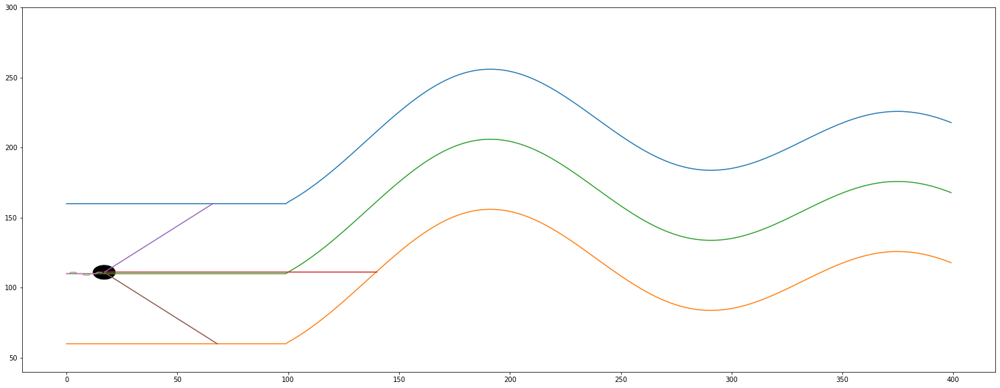

------------------------------ IF i % 3 == 2 ------------------------------
# i =  17
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  123
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  17
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  18
			 len(self.sensor_left)   =  18
			 len(self.sensor_center) =  18
			 len(self.sensor_right)  =  18
			 self.x                  =  17
			 ----

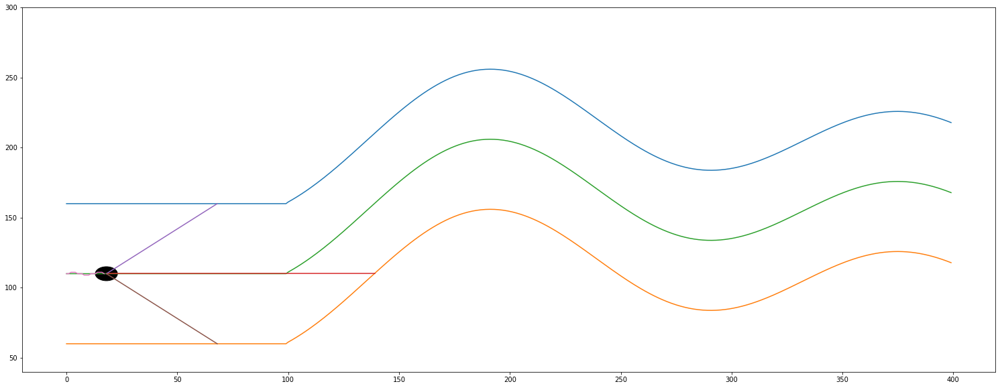

------------------------------ IF i % 3 == 0 ------------------------------
# i =  18
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (19, 3)
y.shape =  (19, 1)
i       =  18
------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  110.0
self.y új értéke   =  110.0
action             =  0
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0]
# 		 ----------------- Summary

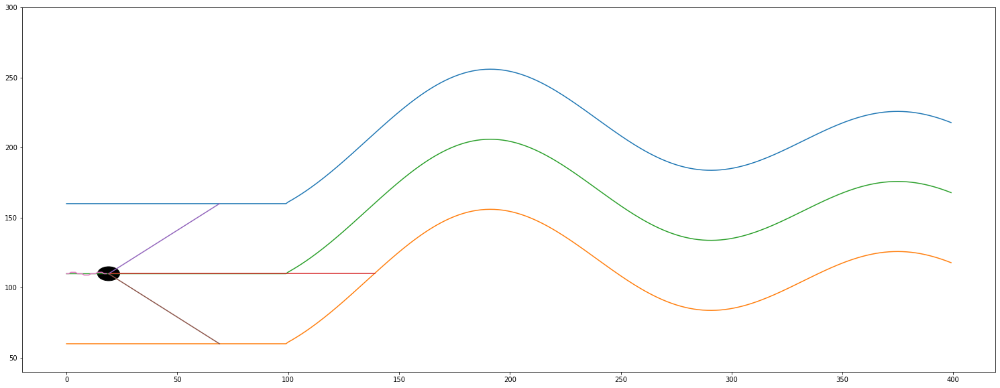

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  120
Sensor from left wall = 

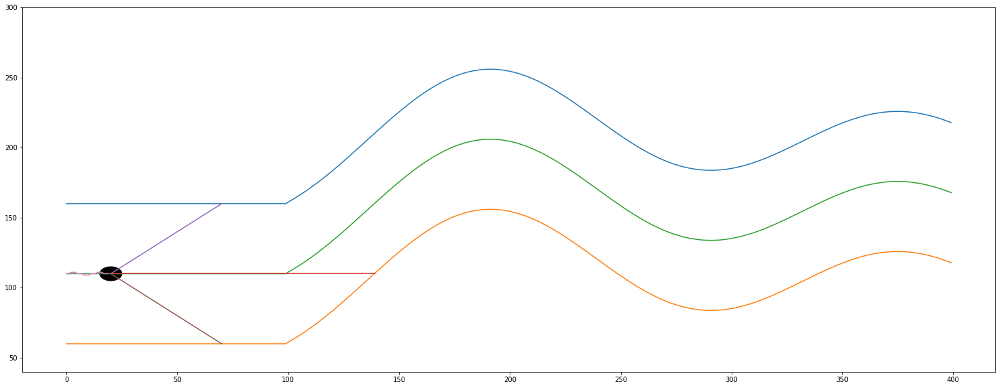

------------------------------ IF i % 3 == 2 ------------------------------
# i =  20
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  119
Sensor from left wall =  52
Sensor from right wall =  50
most távolsagra van a felső faltól =  51.0
most távolsagra van az alsó faltól =  49.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  20
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  21
			 len(self.sensor_left)   =  21
			 len(self.sensor_center) =  21
			 len(self.sensor_right)  =  21
			 self.x                  =  20
			 -

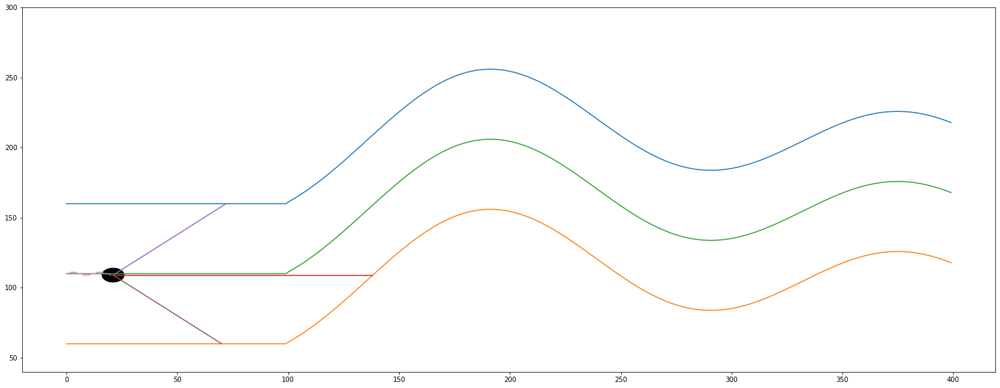

------------------------------ IF i % 3 == 0 ------------------------------
# i =  21
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (22, 3)
y.shape =  (22, 1)
i       =  21
------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  109.0
self.y új értéke   =  109.0
action             =  0
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
109.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0]
# 		 ----

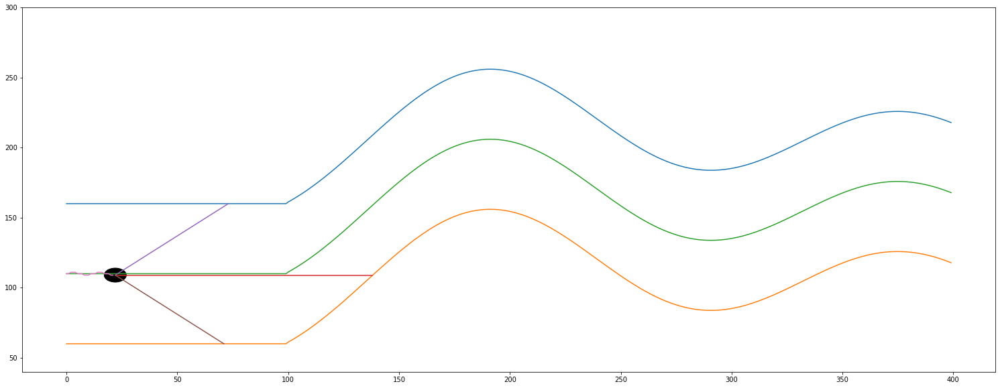

------------------------------ IF i % 3 == 1 ------------------------------
# i =  22
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 52 117  50]]
actual predicted =  [[-1.]]
actual self.y_distance[-1] =  -1.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0]
len(self.y_distance_real)      =  1
len(self.y_distance_predicted) =  1


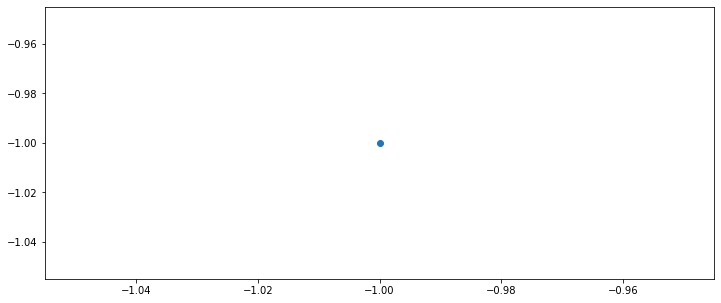

(23, 1)
(23, 1)


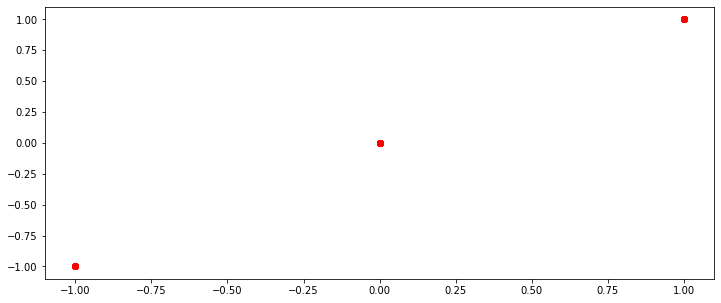

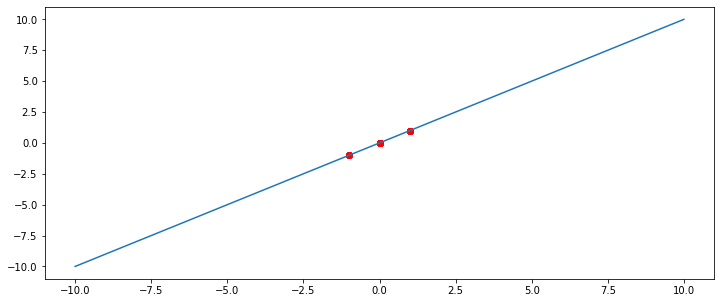

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
109.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  116
Sen

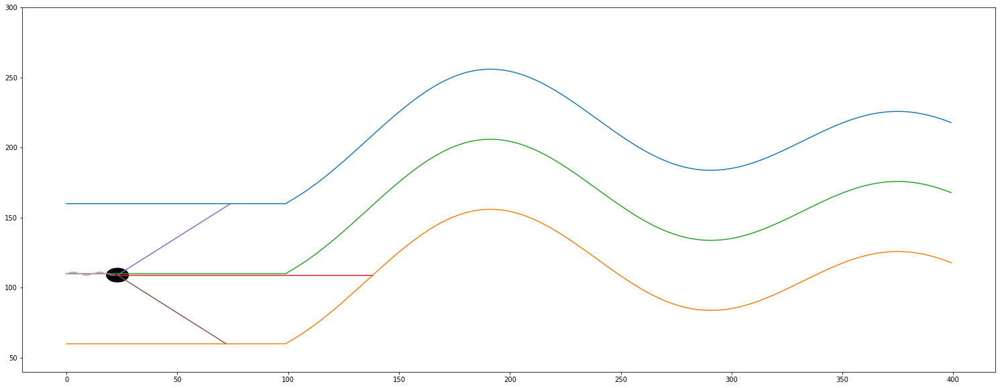

------------------------------ IF i % 3 == 2 ------------------------------
# i =  23
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  117
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  23
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  24
			 len(self.sensor_left)   =  24
			 len(self.sensor_center) =  24
			 len(self.sensor_right)  =  24
			 self.x                  =  23
			 -----

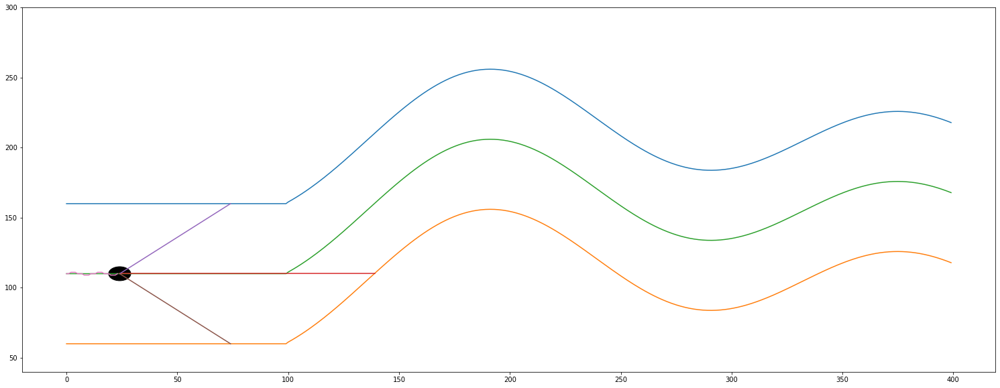

------------------------------ IF i % 3 == 0 ------------------------------
# i =  24
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (25, 3)
y.shape =  (25, 1)
i       =  24
------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  110.0
self.y új értéke   =  110.0
action             =  0
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 11

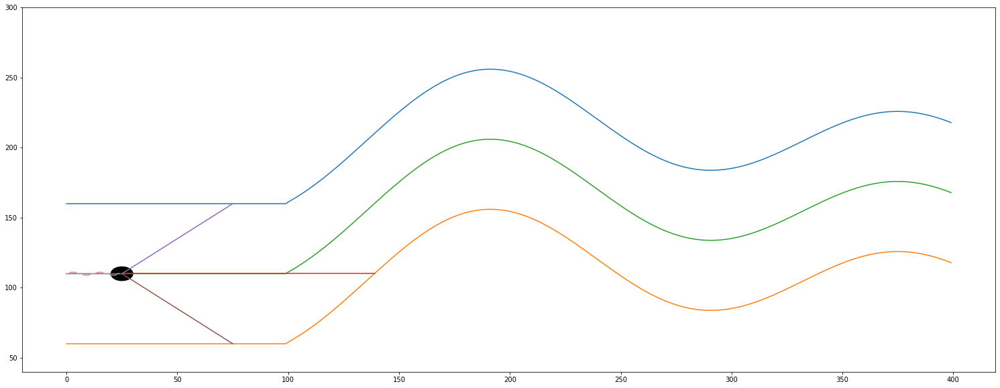

------------------------------ IF i % 3 == 1 ------------------------------
# i =  25
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 51 115  51]]
actual predicted =  [[-3.55271368e-15]]
actual self.y_distance[-1] =  0.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0]
len(self.y_distance_real)      =  2
len(self.y_distance_predicted) =  2


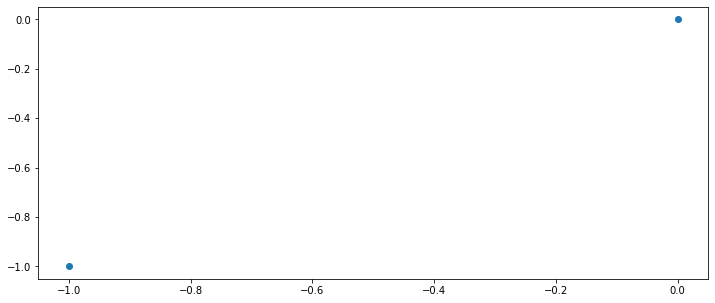

(26, 1)
(26, 1)


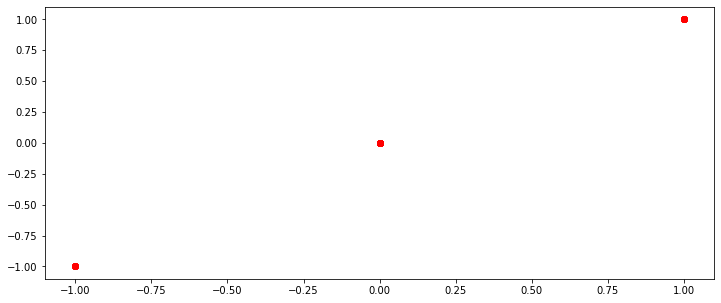

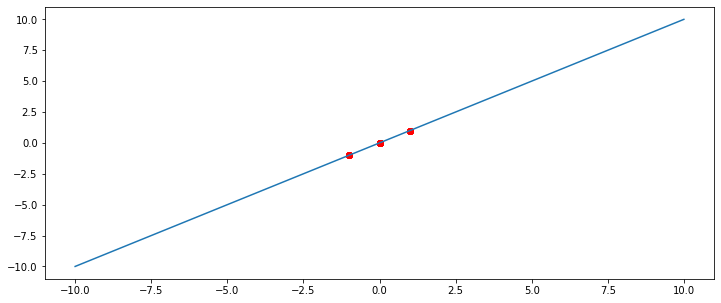

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sen

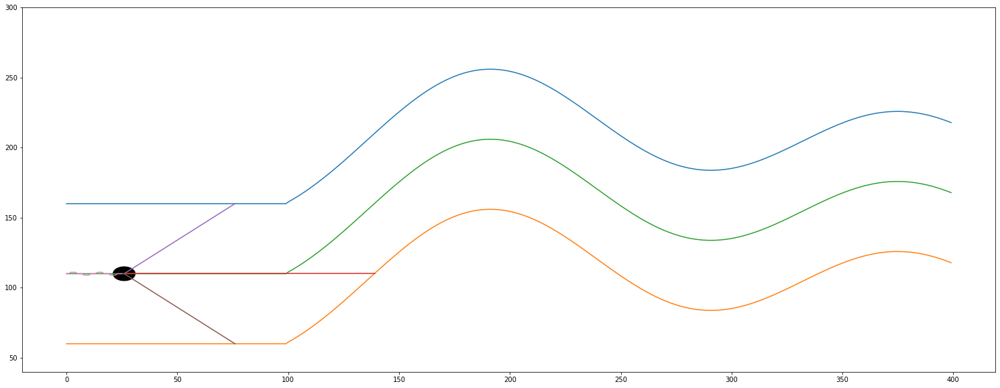

------------------------------ IF i % 3 == 2 ------------------------------
# i =  26
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  115
Sensor from left wall =  50
Sensor from right wall =  52
most távolsagra van a felső faltól =  49.0
most távolsagra van az alsó faltól =  51.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  26
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  27
			 len(self.sensor_left)   =  27
			 len(self.sensor_center) =  27
			 len(self.sensor_right)  =  27
			 self.x                  =  26
			 ------

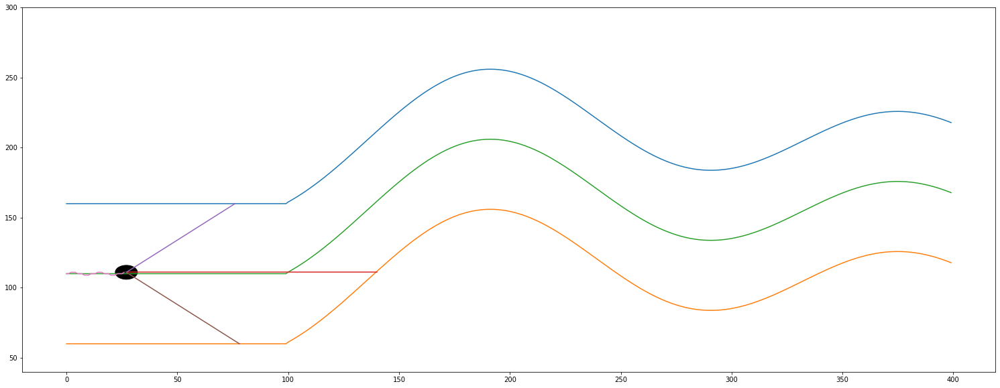

------------------------------ IF i % 3 == 0 ------------------------------
# i =  27
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (28, 3)
y.shape =  (28, 1)
i       =  27
------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  111.0
self.y új értéke   =  111.0
action             =  0
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
111.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 11

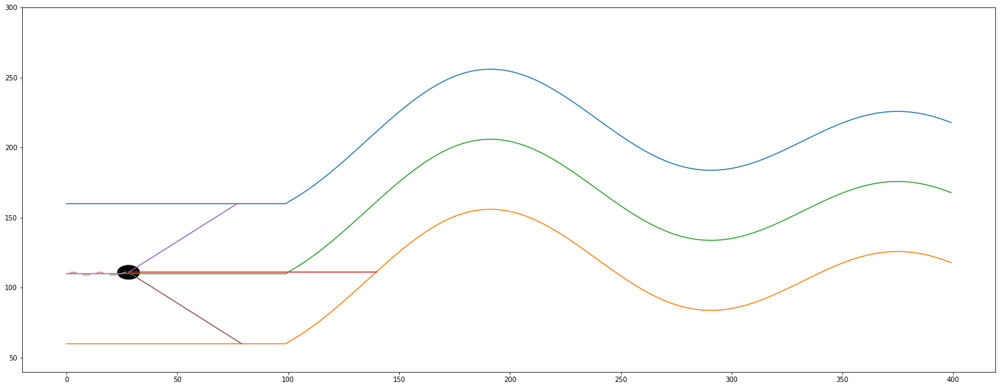

------------------------------ IF i % 3 == 1 ------------------------------
# i =  28
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 50 113  52]]
actual predicted =  [[1.]]
actual self.y_distance[-1] =  1.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0]
len(self.y_distance_real)      =  3
len(self.y_distance_predicted) =  3


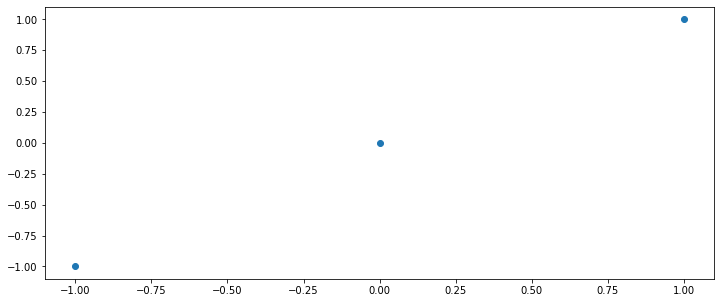

(29, 1)
(29, 1)


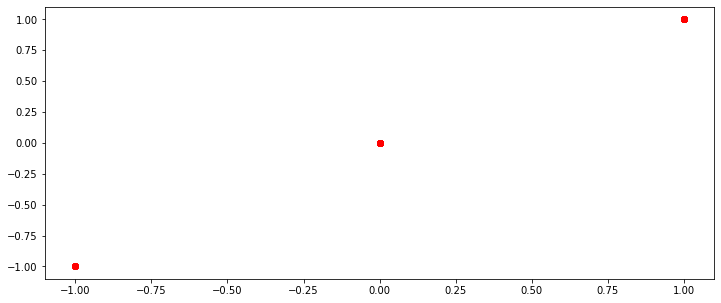

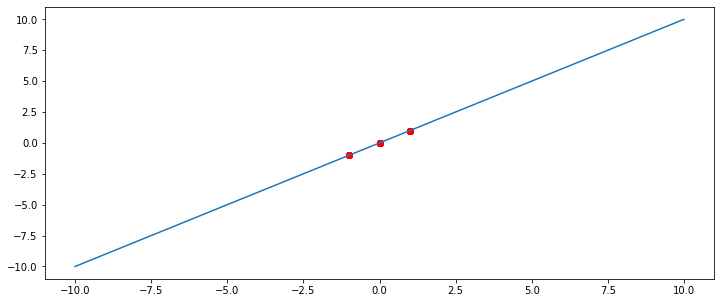

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
111.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje ------------------------------------------------------------------------------------------------------------------------

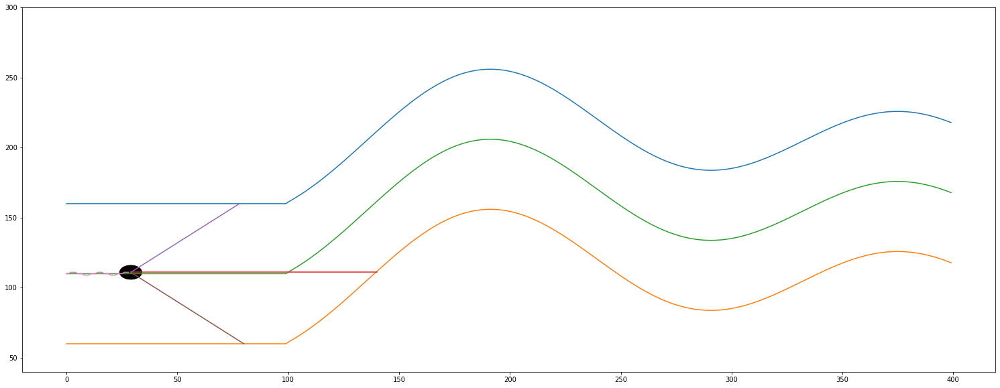

------------------------------ IF i % 3 == 2 ------------------------------
# i =  29
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  111
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  29
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  30
			 len(self.sensor_left)   =  30
			 len(self.sensor_center) =  30
			 len(self.sensor_right)  =  30
			 self.x                  =  29
			 ----

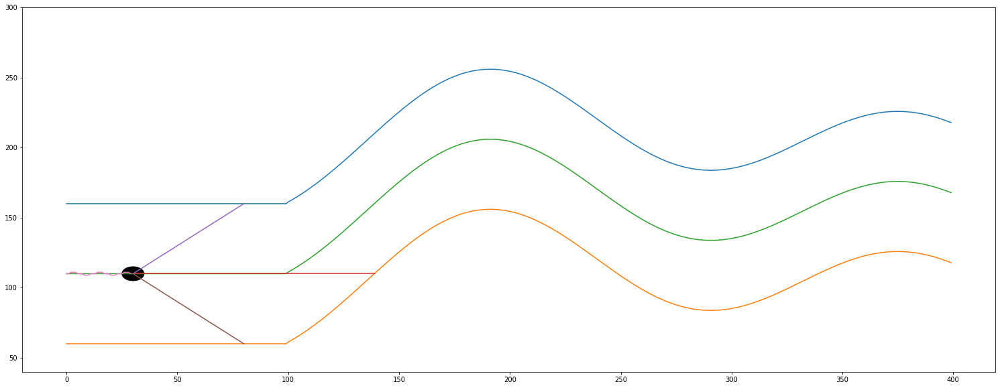

------------------------------ IF i % 3 == 0 ------------------------------
# i =  30
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (31, 3)
y.shape =  (31, 1)
i       =  30
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  30
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(10, 4)
(10, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.])]
[array([111.,  50., 139.,  52.]), array([110.,  51., 135.,  51.]), array([109.,  52., 131., 

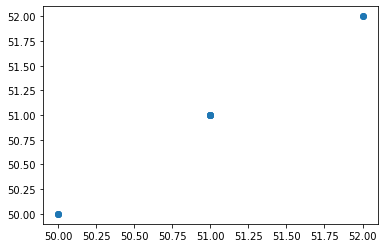

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1. 1.]]


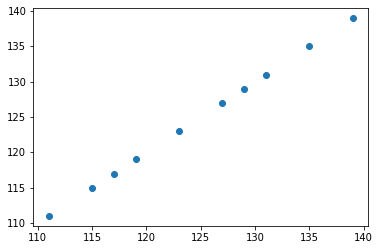

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[1. 1.]]


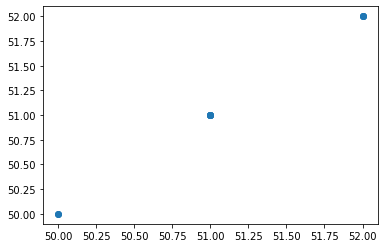

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[-3.50830476e-14]]
-------- 1 y up ->  center =  [[2.]]
-------- 1 y up ->  right  =  [[2.]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[51 -3]]
		 _X_center =  [[110  -3]]
		 _X_right  =  [[51 -3]]
		 predicted_left   =  [[54.]]
		 predicted_center =  [[107.]]
		 predicted_right  =  [[48.]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 1. -1.]]
		 regression_center.coef_ =  [[1. 1.]]
		 regression_right.coef_  =  [[1. 1.]]
		 regression_left.intercept_   =  [-3.55271368e-14]
		 regres

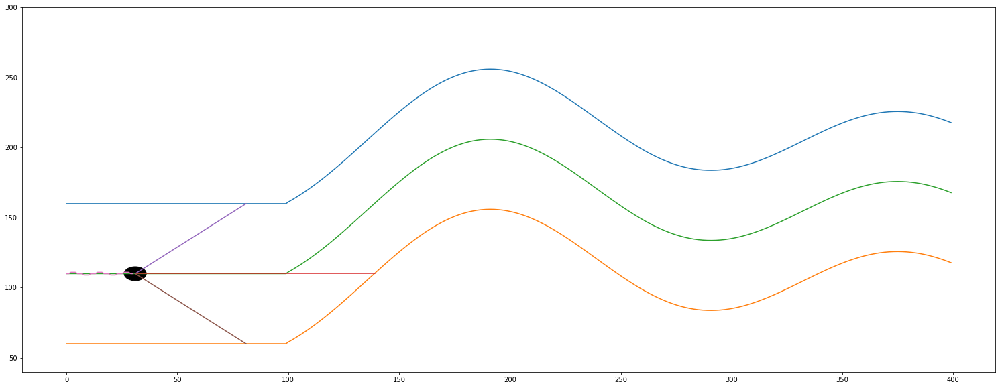

------------------------------ IF i % 3 == 1 ------------------------------
# i =  31
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 51 109  51]]
actual predicted =  [[2.7339242e-15]]
actual self.y_distance[-1] =  0.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0]
len(self.y_distance_real)      =  4
len(self.y_distance_predicted) =  4


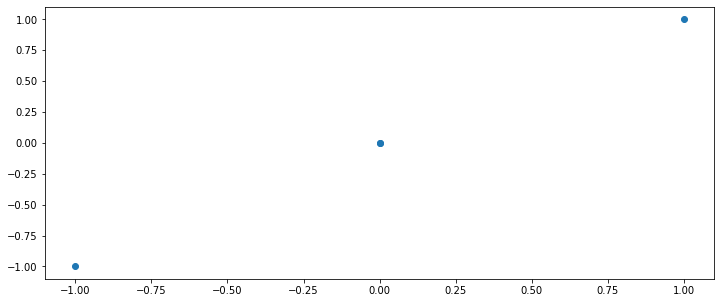

(32, 1)
(32, 1)


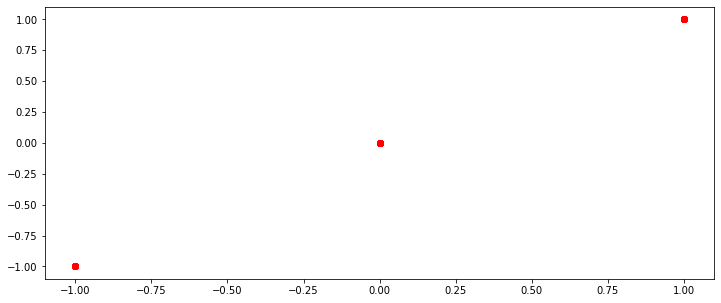

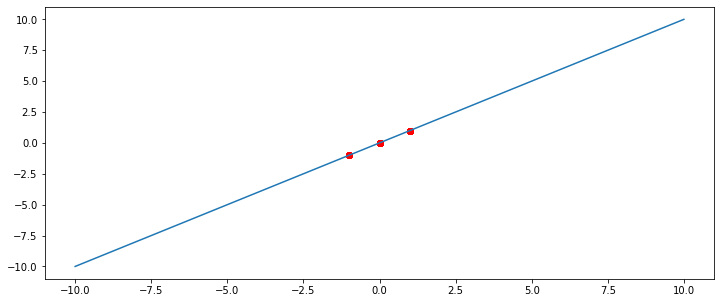

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje ---------------------------------------------------------------------------------------------------

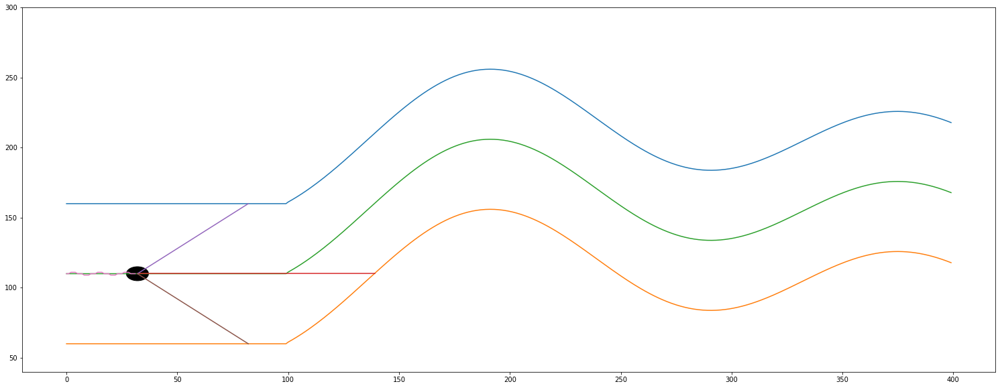

------------------------------ IF i % 3 == 2 ------------------------------
# i =  32
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  107
Sensor from left wall =  52
Sensor from right wall =  50
most távolsagra van a felső faltól =  51.0
most távolsagra van az alsó faltól =  49.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  32
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  33
			 len(self.sensor_left)   =  33
			 len(self.sensor_center) =  33
			 len(self.sensor_right)  =  33
			 self.x                  =  32
			 -

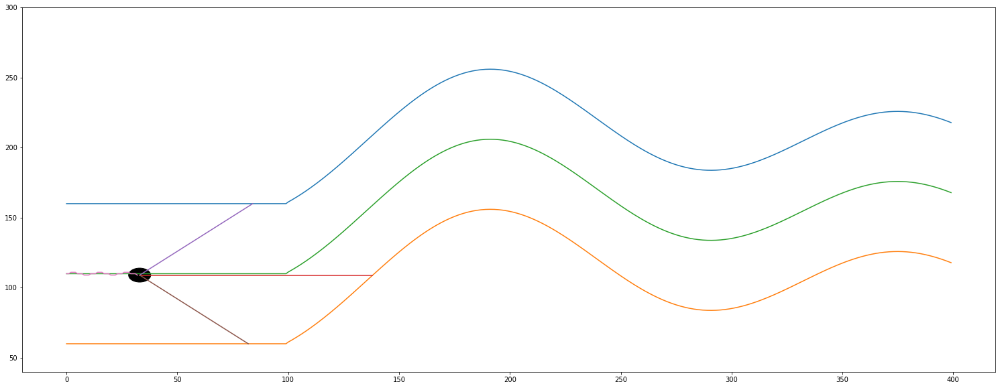

------------------------------ IF i % 3 == 0 ------------------------------
# i =  33
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (34, 3)
y.shape =  (34, 1)
i       =  33
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  33
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(11, 4)
(11, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.])]
[array([111.,  50., 139.,  52.]), array([110.,  51., 13

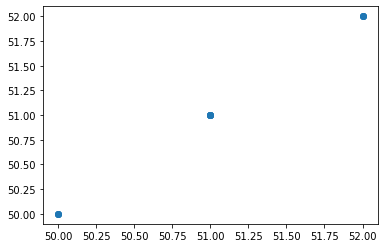

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1. 1.]]


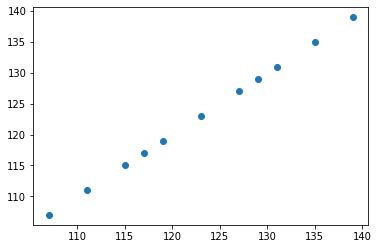

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[1. 1.]]


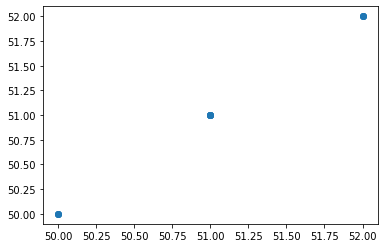

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.4861003e-14]]
-------- 1 y up ->  center =  [[2.]]
-------- 1 y up ->  right  =  [[2.]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[52 -3]]
		 _X_center =  [[106  -3]]
		 _X_right  =  [[50 -3]]
		 predicted_left   =  [[55.]]
		 predicted_center =  [[103.]]
		 predicted_right  =  [[47.]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 1. -1.]]
		 regression_center.coef_ =  [[1. 1.]]
		 regression_right.coef_  =  [[1. 1.]]
		 regression_left.intercept_   =  [3.55271368e-14]
		 regressio

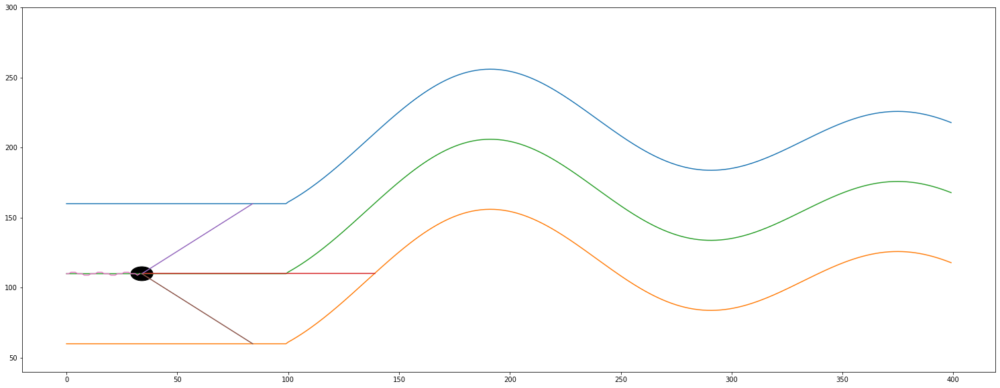

------------------------------ IF i % 3 == 1 ------------------------------
# i =  34
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 51 106  51]]
actual predicted =  [[-3.35148576e-15]]
actual self.y_distance[-1] =  0.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0]
len(self.y_distance_real)      =  5
len(self.y_distance_predicted) =  5


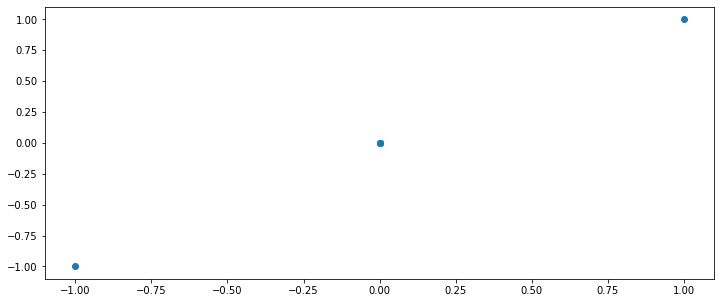

(35, 1)
(35, 1)


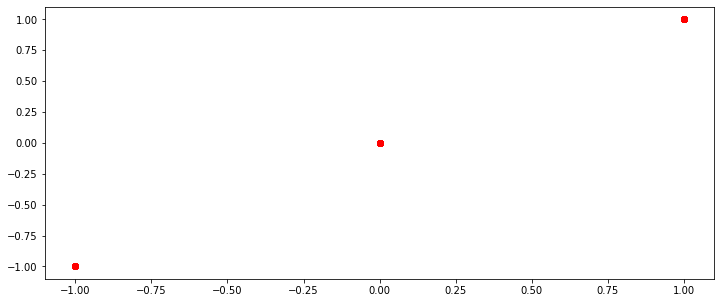

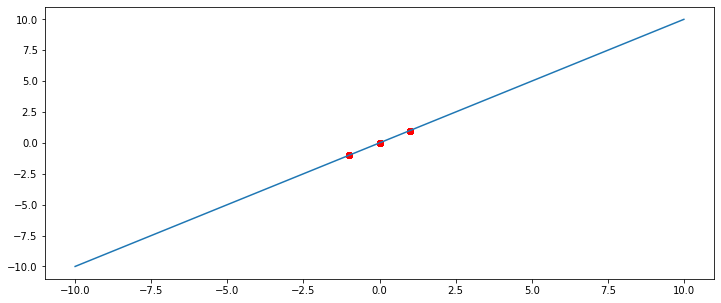

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje ------------------------------------------------------------------------------

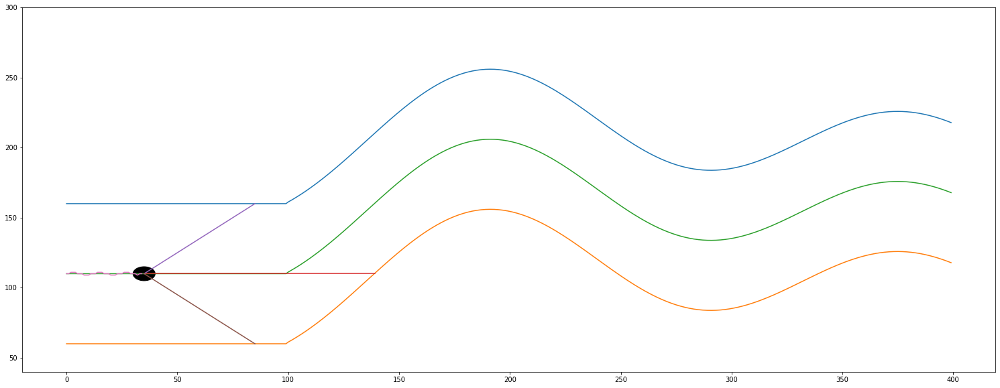

------------------------------ IF i % 3 == 2 ------------------------------
# i =  35
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  106
Sensor from left wall =  50
Sensor from right wall =  52
most távolsagra van a felső faltól =  49.0
most távolsagra van az alsó faltól =  51.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  35
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  36
			 len(self.sensor_left)   =  36
			 len(self.sensor_center) =  36
			 len(self.sensor_right)  =  36
			 self.x                  =  35
			 -----

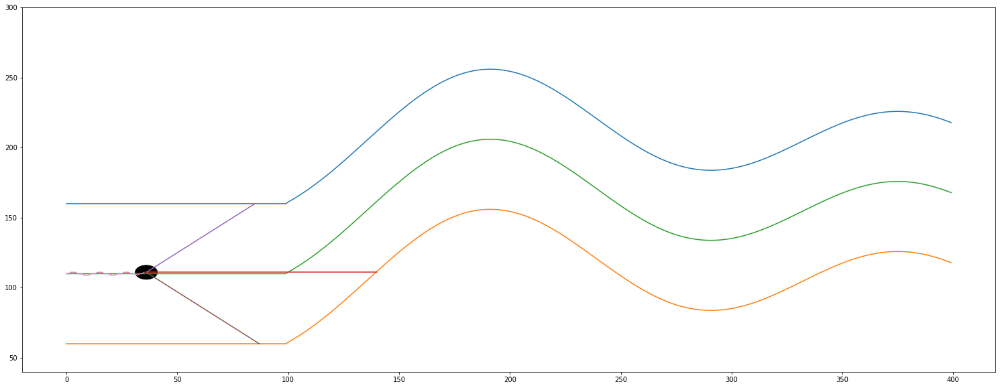

------------------------------ IF i % 3 == 0 ------------------------------
# i =  36
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (37, 3)
y.shape =  (37, 1)
i       =  36
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  36
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(12, 4)
(12, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array([110.,  51., 105.,  51.])]
[array([111.,  50.

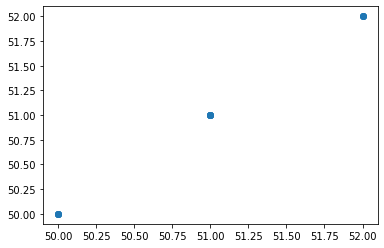

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1. 1.]]


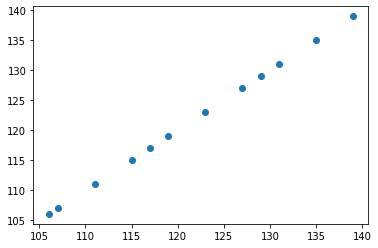

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[1. 1.]]


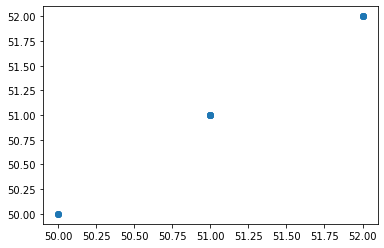

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[-2.22044605e-16]]
-------- 1 y up ->  center =  [[2.]]
-------- 1 y up ->  right  =  [[2.]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[50 -3]]
		 _X_center =  [[105  -3]]
		 _X_right  =  [[52 -3]]
		 predicted_left   =  [[53.]]
		 predicted_center =  [[102.]]
		 predicted_right  =  [[49.]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 1. -1.]]
		 regression_center.coef_ =  [[1. 1.]]
		 regression_right.coef_  =  [[1. 1.]]
		 regression_left.intercept_   =  [0.]
		 regression_center.i

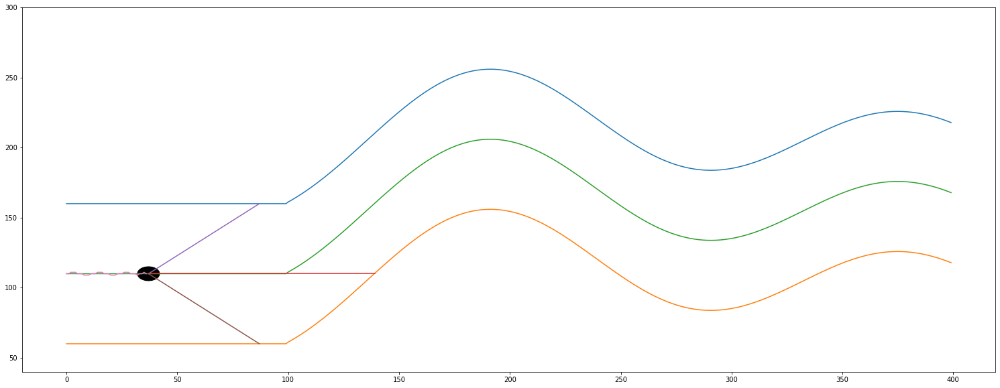

------------------------------ IF i % 3 == 1 ------------------------------
# i =  37
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 51 103  51]]
actual predicted =  [[4.02455846e-16]]
actual self.y_distance[-1] =  0.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0]
len(self.y_distance_real)      =  6
len(self.y_distance_predicted) =  6


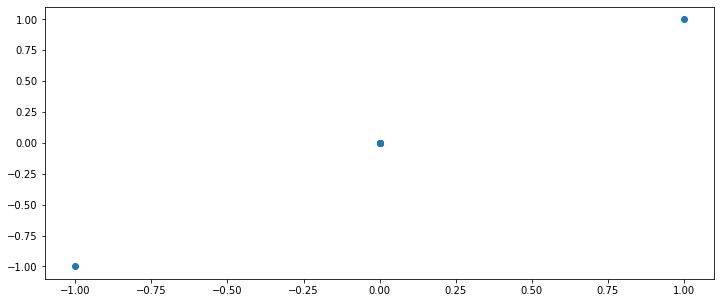

(38, 1)
(38, 1)


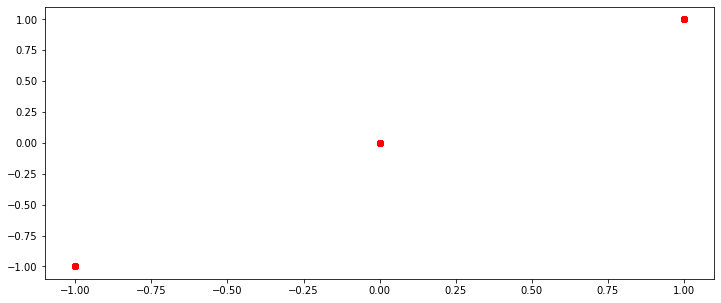

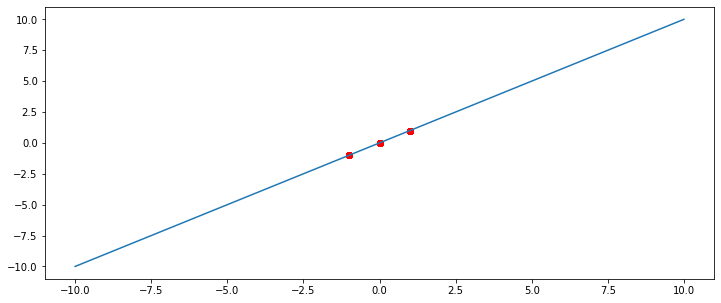

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje ---------------------------------------------------------

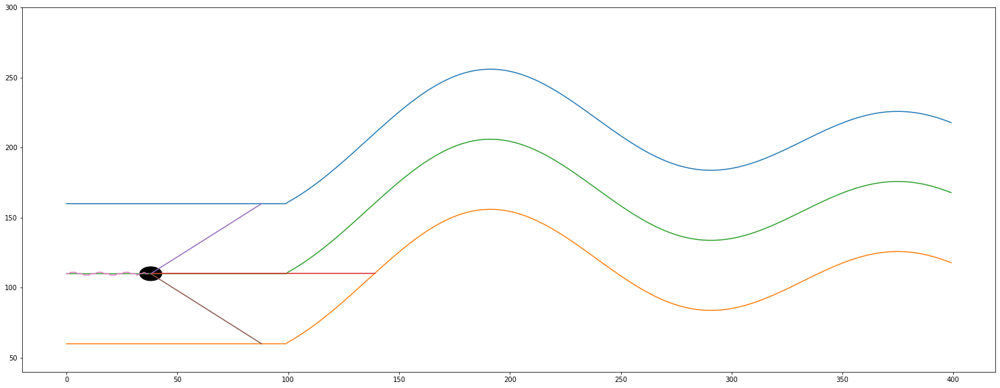

------------------------------ IF i % 3 == 2 ------------------------------
# i =  38
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  103
Sensor from left wall =  50
Sensor from right wall =  52
most távolsagra van a felső faltól =  49.0
most távolsagra van az alsó faltól =  51.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  38
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  39
			 len(self.sensor_left)   =  39
			 len(self.sensor_center) =  39
			 len(self.sensor_right)  =  39
			 self.x                  =  38
			 ------

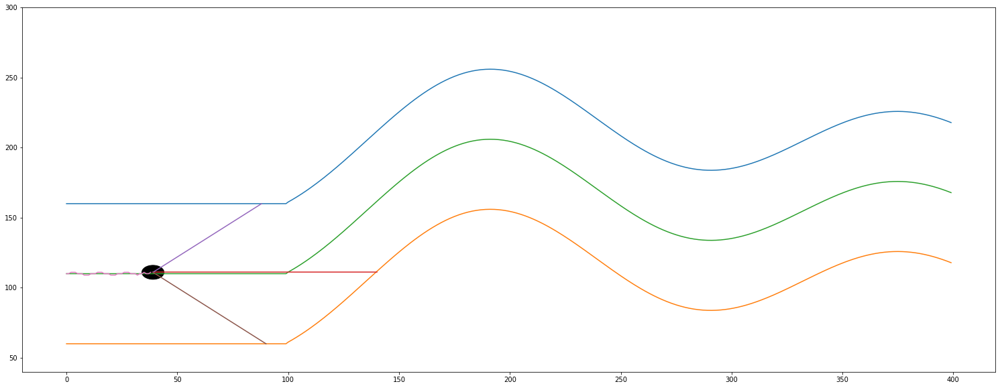

------------------------------ IF i % 3 == 0 ------------------------------
# i =  39
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (40, 3)
y.shape =  (40, 1)
i       =  39
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  39
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(13, 4)
(13, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array([110.,  51., 105.,  51.]), array([110.,  

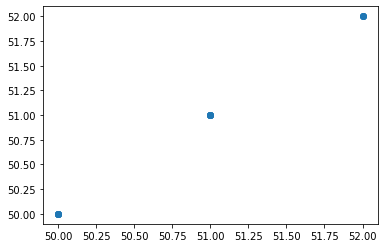

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1. 1.]]


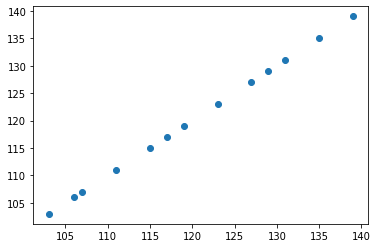

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[1. 1.]]


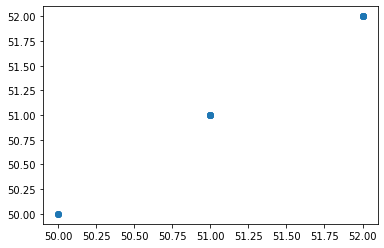

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[1.38777878e-14]]
-------- 1 y up ->  center =  [[2.]]
-------- 1 y up ->  right  =  [[2.]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[50 -3]]
		 _X_center =  [[102  -3]]
		 _X_right  =  [[52 -3]]
		 predicted_left   =  [[53.]]
		 predicted_center =  [[99.]]
		 predicted_right  =  [[49.]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 1. -1.]]
		 regression_center.coef_ =  [[1. 1.]]
		 regression_right.coef_  =  [[1. 1.]]
		 regression_left.intercept_   =  [1.42108547e-14]
		 regressio

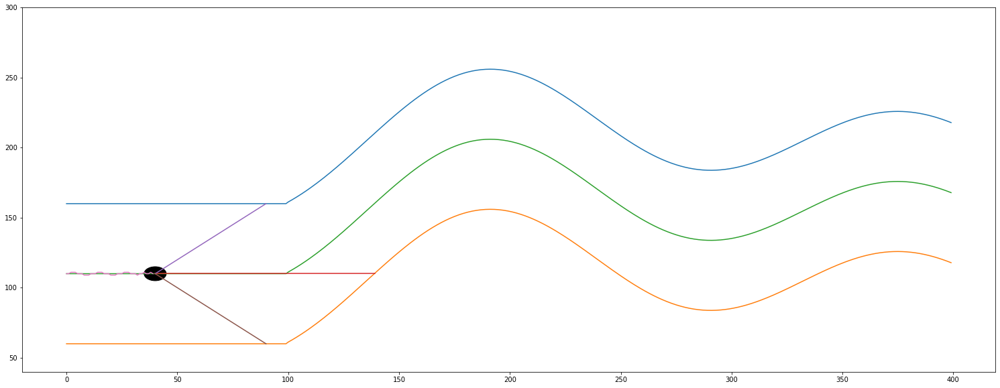

------------------------------ IF i % 3 == 1 ------------------------------
# i =  40
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 51 100  51]]
actual predicted =  [[-1.41553436e-15]]
actual self.y_distance[-1] =  0.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0]
len(self.y_distance_real)      =  7
len(self.y_distance_predicted) =  7


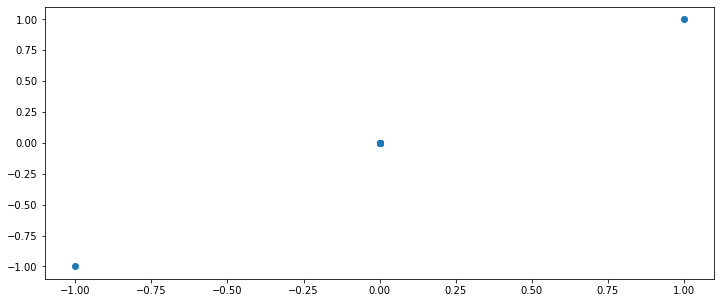

(41, 1)
(41, 1)


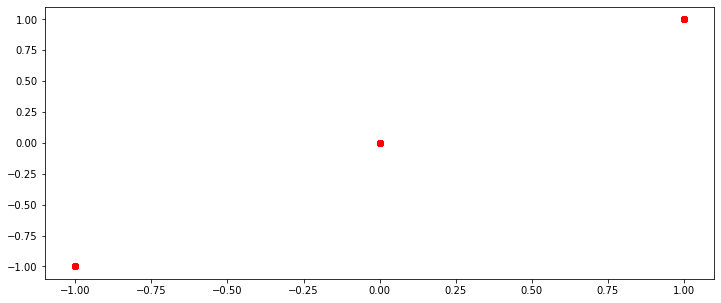

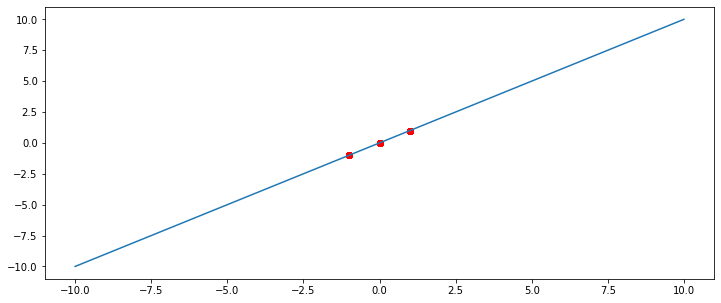

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje ------------------------------------

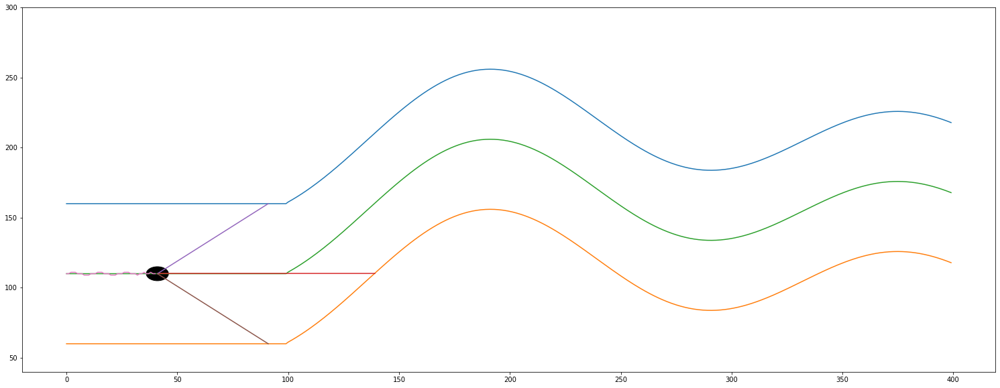

------------------------------ IF i % 3 == 2 ------------------------------
# i =  41
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  98
Sensor from left wall =  52
Sensor from right wall =  50
most távolsagra van a felső faltól =  51.0
most távolsagra van az alsó faltól =  49.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  41
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  42
			 len(self.sensor_left)   =  42
			 len(self.sensor_center) =  42
			 len(self.sensor_right)  =  42
			 self.x                  =  41
			 ---

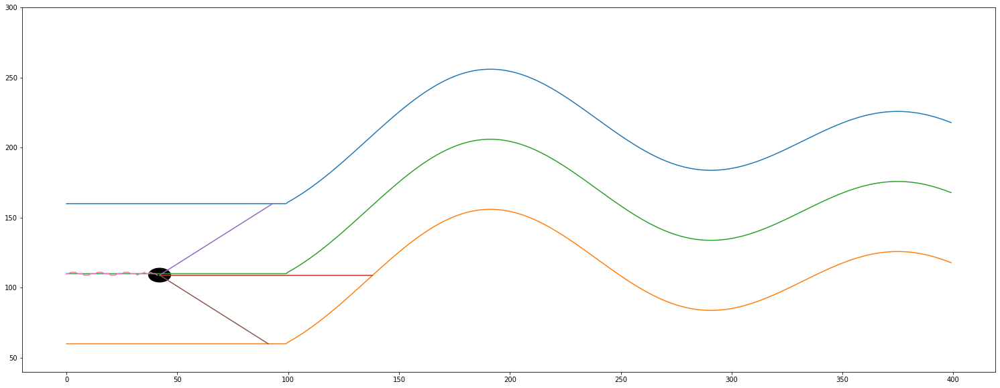

------------------------------ IF i % 3 == 0 ------------------------------
# i =  42
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (43, 3)
y.shape =  (43, 1)
i       =  42
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  42
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(14, 4)
(14, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array([110.,  51., 105.,  51.]), array([110

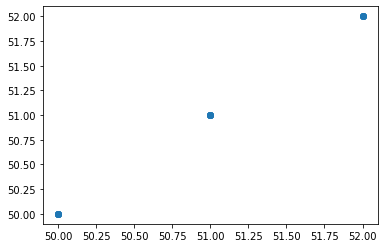

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1. 1.]]


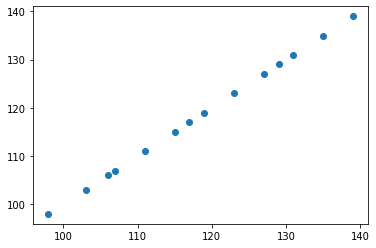

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[1. 1.]]


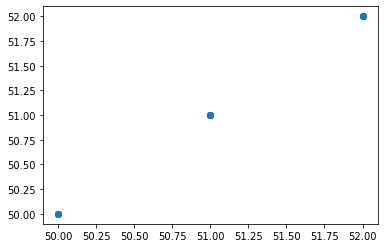

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.06501483e-14]]
-------- 1 y up ->  center =  [[2.]]
-------- 1 y up ->  right  =  [[2.]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[52 -3]]
		 _X_center =  [[97 -3]]
		 _X_right  =  [[50 -3]]
		 predicted_left   =  [[55.]]
		 predicted_center =  [[94.]]
		 predicted_right  =  [[47.]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 1. -1.]]
		 regression_center.coef_ =  [[1. 1.]]
		 regression_right.coef_  =  [[1. 1.]]
		 regression_left.intercept_   =  [2.13162821e-14]
		 regression_

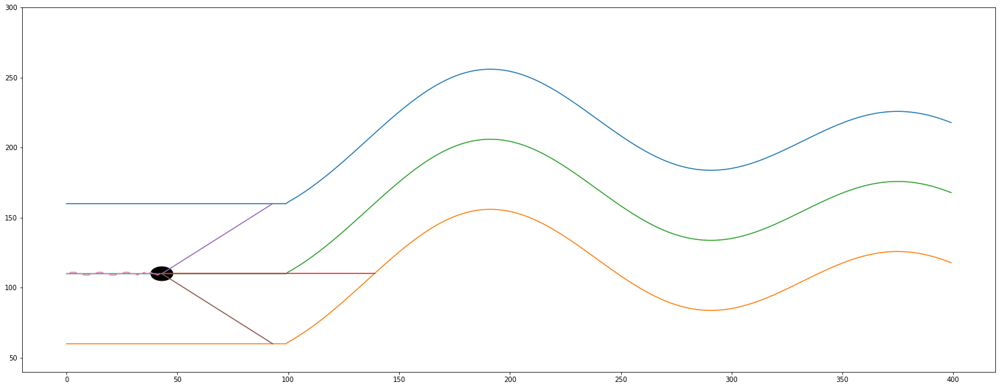

------------------------------ IF i % 3 == 1 ------------------------------
# i =  43
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[51 97 51]]
actual predicted =  [[1.65145675e-15]]
actual self.y_distance[-1] =  0.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0]
len(self.y_distance_real)      =  8
len(self.y_distance_predicted) =  8


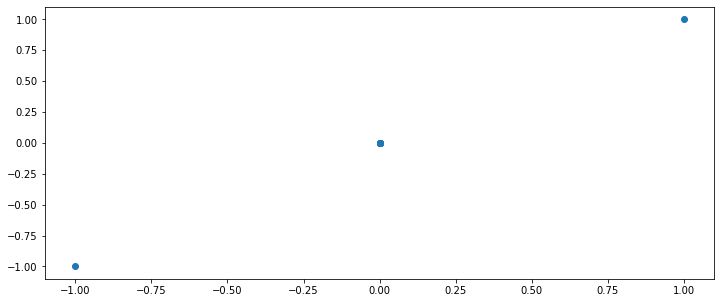

(44, 1)
(44, 1)


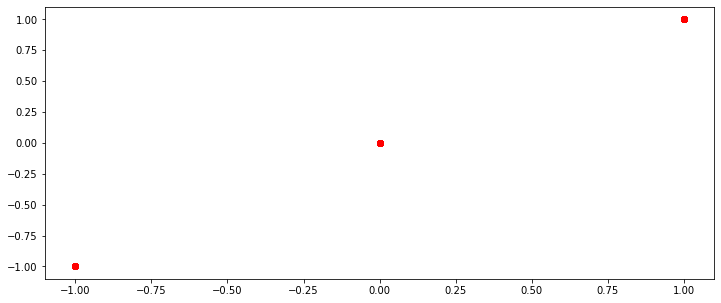

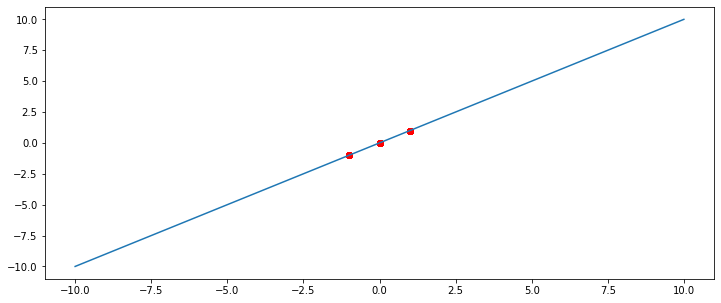

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje ---------------

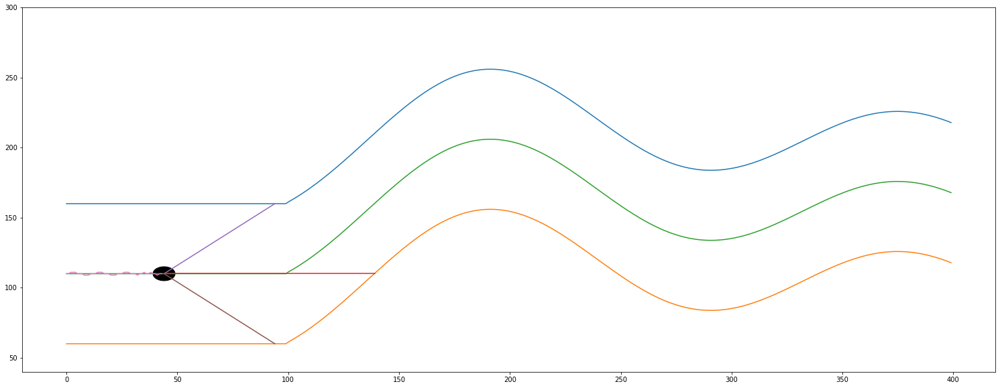

------------------------------ IF i % 3 == 2 ------------------------------
# i =  44
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  95
Sensor from left wall =  52
Sensor from right wall =  50
most távolsagra van a felső faltól =  51.0
most távolsagra van az alsó faltól =  49.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  44
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  45
			 len(self.sensor_left)   =  45
			 len(self.sensor_center) =  45
			 len(self.sensor_right)  =  45
			 self.x                  =  44
			 --

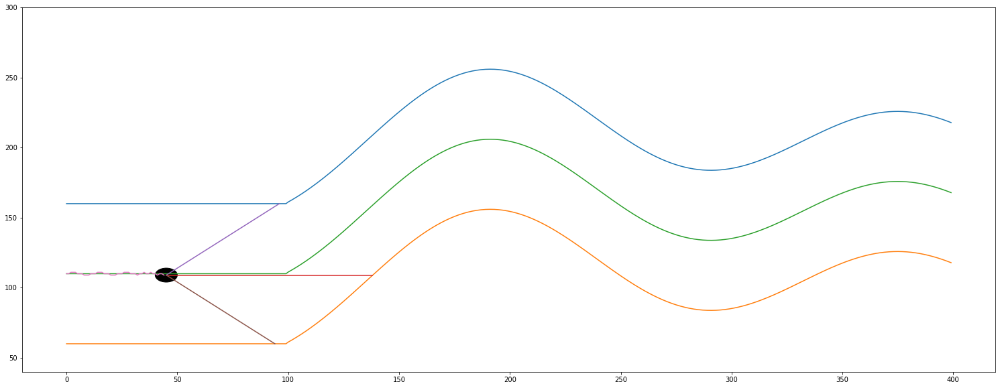

------------------------------ IF i % 3 == 0 ------------------------------
# i =  45
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (46, 3)
y.shape =  (46, 1)
i       =  45
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  45
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(15, 4)
(15, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array([110.,  51., 105.,  51.]), array(

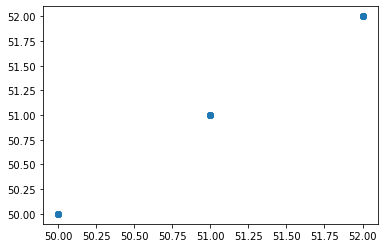

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1. 1.]]


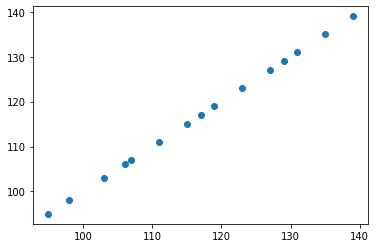

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[1. 1.]]


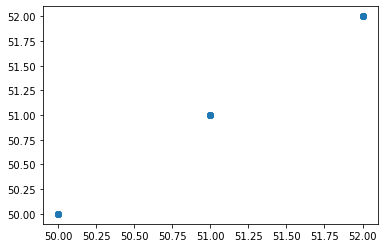

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.08721929e-14]]
-------- 1 y up ->  center =  [[2.]]
-------- 1 y up ->  right  =  [[2.]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[52 -3]]
		 _X_center =  [[94 -3]]
		 _X_right  =  [[50 -3]]
		 predicted_left   =  [[55.]]
		 predicted_center =  [[91.]]
		 predicted_right  =  [[47.]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 1. -1.]]
		 regression_center.coef_ =  [[1. 1.]]
		 regression_right.coef_  =  [[1. 1.]]
		 regression_left.intercept_   =  [2.13162821e-14]
		 regression_

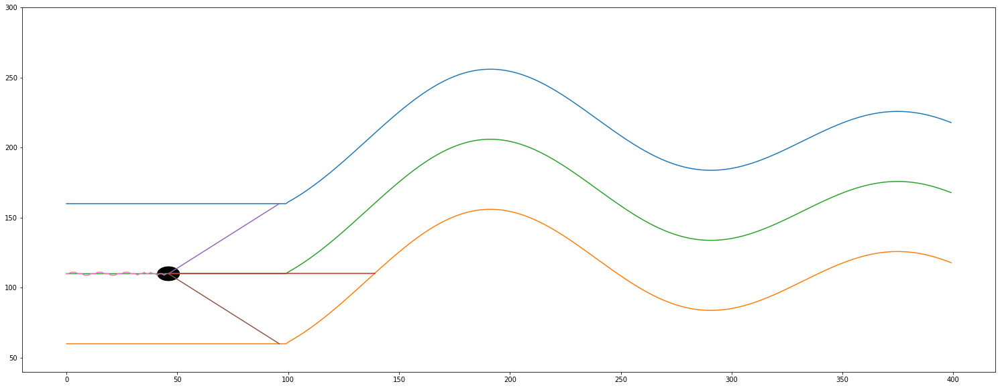

------------------------------ IF i % 3 == 1 ------------------------------
# i =  46
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[51 94 51]]
actual predicted =  [[-1.07552856e-15]]
actual self.y_distance[-1] =  0.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0]
len(self.y_distance_real)      =  9
len(self.y_distance_predicted) =  9


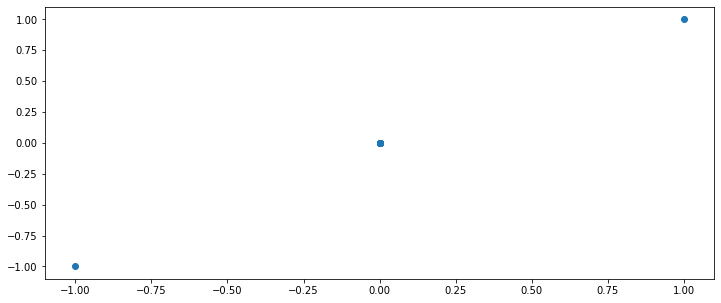

(47, 1)
(47, 1)


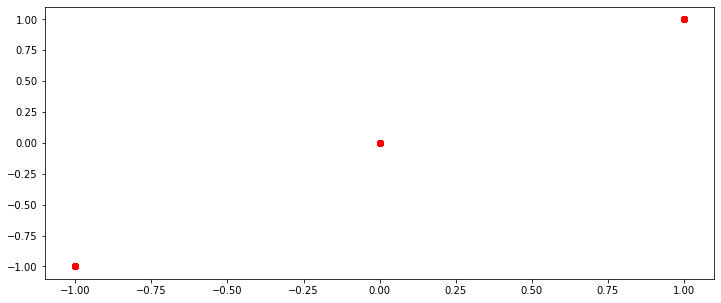

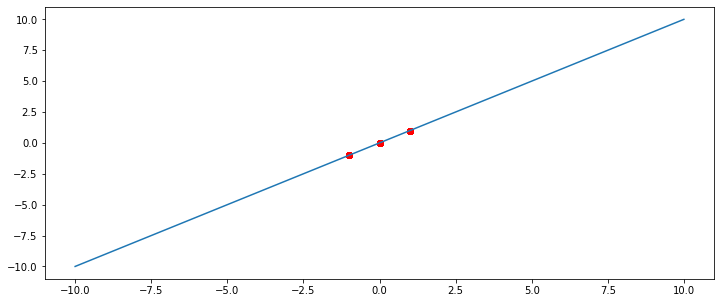

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus 

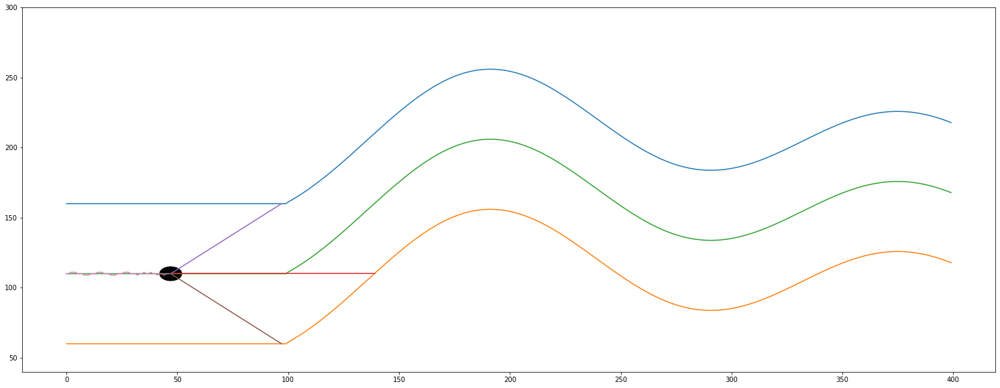

------------------------------ IF i % 3 == 2 ------------------------------
# i =  47
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  94
Sensor from left wall =  50
Sensor from right wall =  52
most távolsagra van a felső faltól =  49.0
most távolsagra van az alsó faltól =  51.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  47
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  48
			 len(self.sensor_left)   =  48
			 len(self.sensor_center) =  48
			 len(self.sensor_right)  =  48
			 self.x                  =  47
			 ------

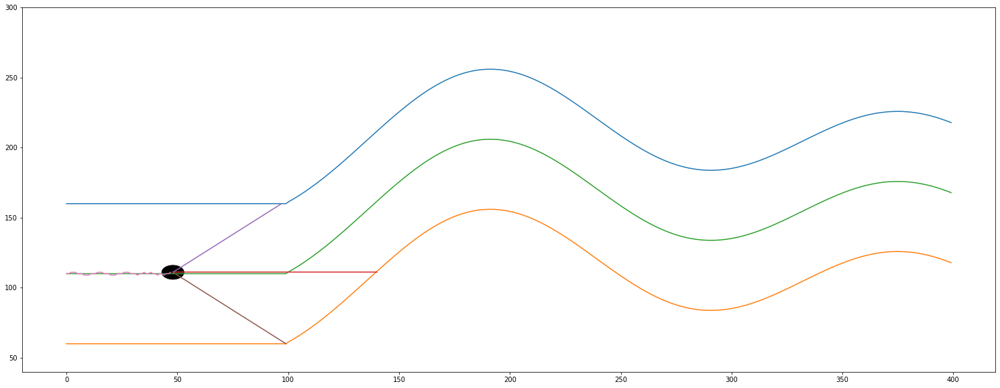

------------------------------ IF i % 3 == 0 ------------------------------
# i =  48
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (49, 3)
y.shape =  (49, 1)
i       =  48
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  48
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(16, 4)
(16, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array([110.,  51., 105.,  51.]), ar

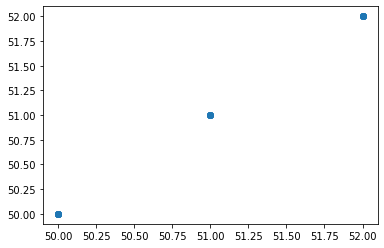

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1. 1.]]


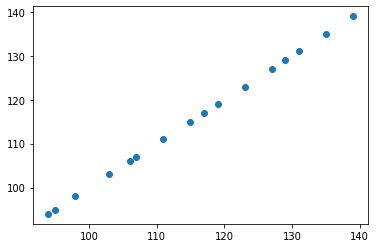

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[1. 1.]]


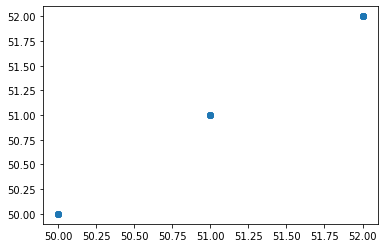

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[-1.33226763e-14]]
-------- 1 y up ->  center =  [[2.]]
-------- 1 y up ->  right  =  [[2.]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[50 -3]]
		 _X_center =  [[93 -3]]
		 _X_right  =  [[52 -3]]
		 predicted_left   =  [[53.]]
		 predicted_center =  [[90.]]
		 predicted_right  =  [[49.]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 1. -1.]]
		 regression_center.coef_ =  [[1. 1.]]
		 regression_right.coef_  =  [[1. 1.]]
		 regression_left.intercept_   =  [-1.42108547e-14]
		 regressio

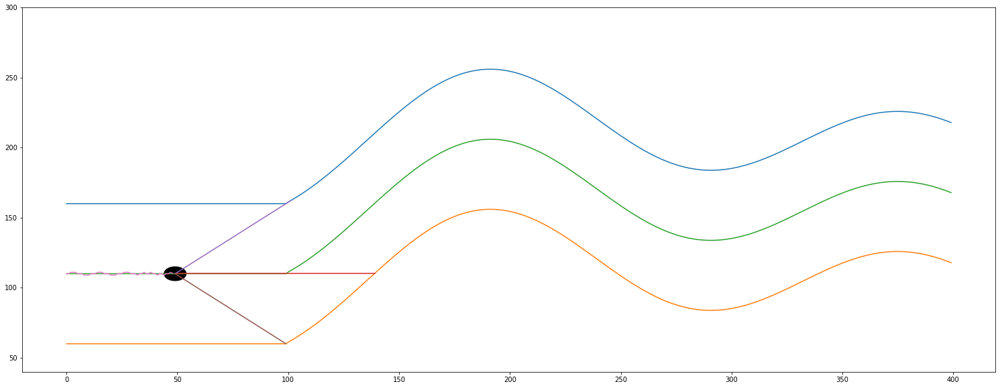

------------------------------ IF i % 3 == 1 ------------------------------
# i =  49
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[53 91 51]]
actual predicted =  [[-1.]]
actual self.y_distance[-1] =  0.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0]
len(self.y_distance_real)      =  10
len(self.y_distance_predicted) =  10


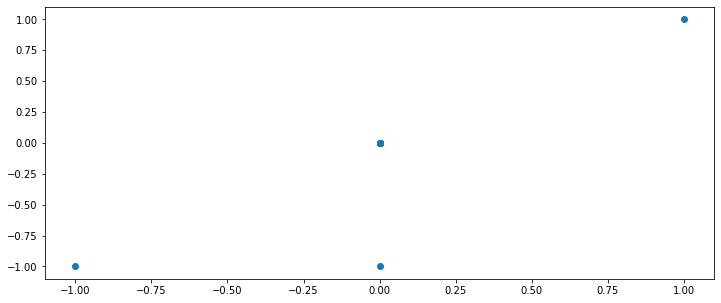

(50, 1)
(50, 1)


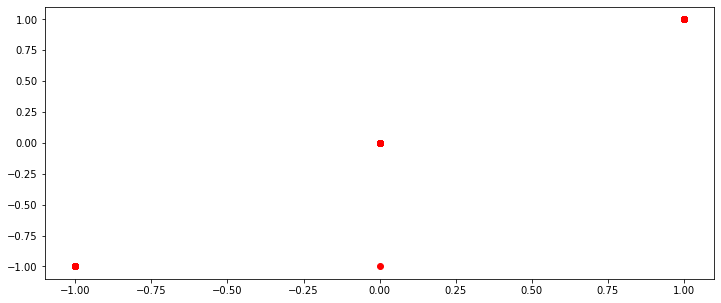

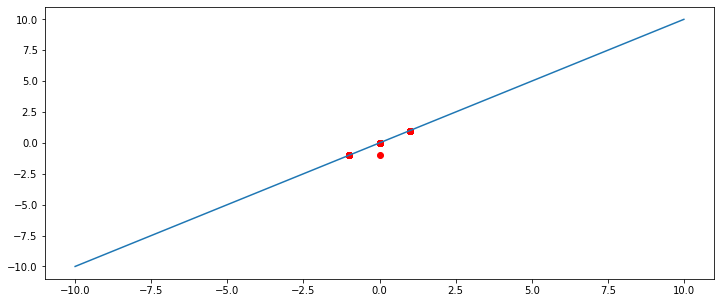

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége +++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

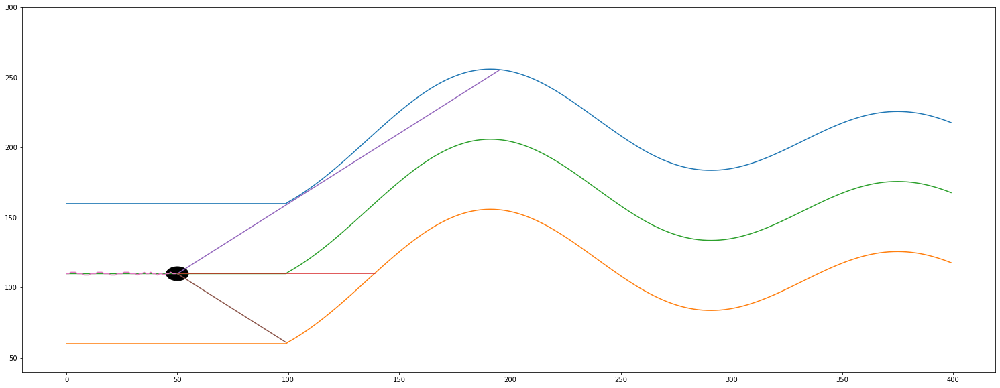

------------------------------ IF i % 3 == 2 ------------------------------
# i =  50
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  91
Sensor from left wall =  52
Sensor from right wall =  51
most távolsagra van a felső faltól =  49.0
most távolsagra van az alsó faltól =  51.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  50
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  51
			 len(self.sensor_left)   =  51
			 len(self.sensor_center) =  51
			 len(self.sensor_right)  =  51
			 self.x                  =  50
			 -------

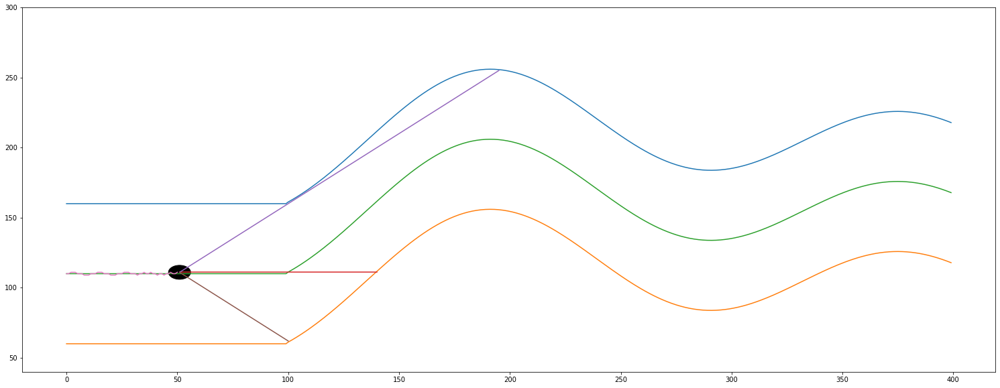

------------------------------ IF i % 3 == 0 ------------------------------
# i =  51
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (52, 3)
y.shape =  (52, 1)
i       =  51
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  51
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(17, 4)
(17, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array([110.,  51., 105.,  51.])

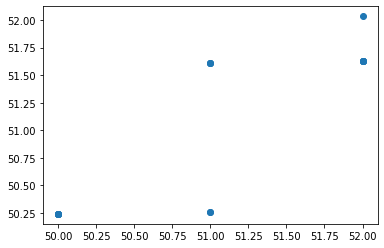

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1. 1.]]


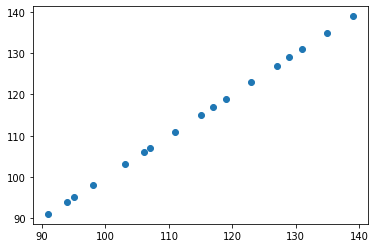

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[1. 1.]]


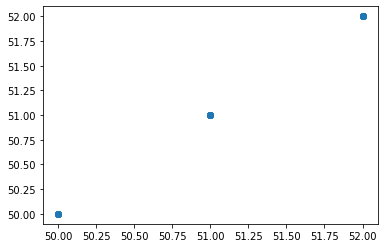

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[49.29668045]]
-------- 1 y up ->  center =  [[2.]]
-------- 1 y up ->  right  =  [[2.]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[145  -3]]
		 _X_center =  [[90 -3]]
		 _X_right  =  [[50 -3]]
		 predicted_left   =  [[54.79840538]]
		 predicted_center =  [[87.]]
		 predicted_right  =  [[47.]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.0188846  -0.69558565]]
		 regression_center.coef_ =  [[1. 1.]]
		 regression_right.coef_  =  [[1. 1.]]
		 regression_left.intercept_   =  [49.9733

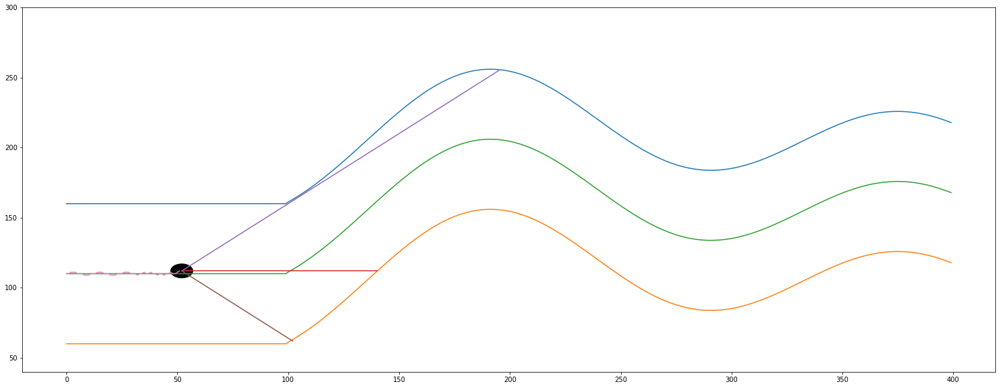

------------------------------ IF i % 3 == 1 ------------------------------
# i =  52
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[144  89  51]]
actual predicted =  [[1.48854046]]
actual self.y_distance[-1] =  2.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0]
len(self.y_distance_real)      =  11
len(self.y_distance_predicted) =  11


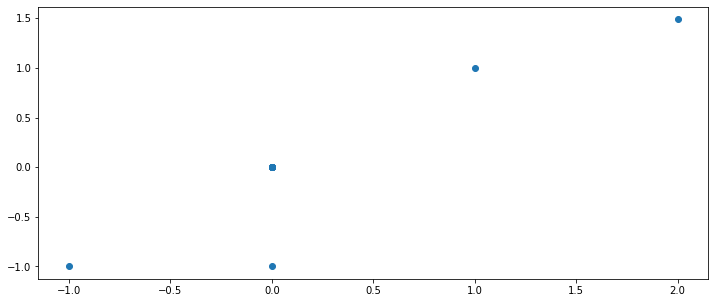

(53, 1)
(53, 1)


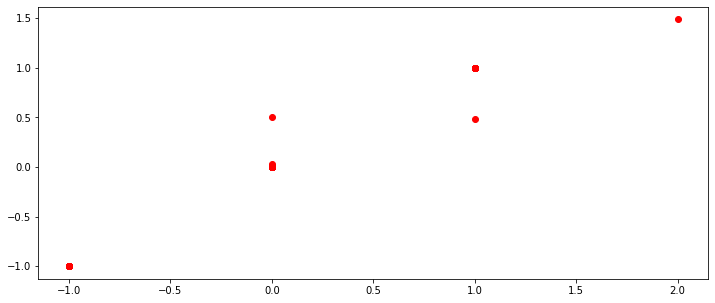

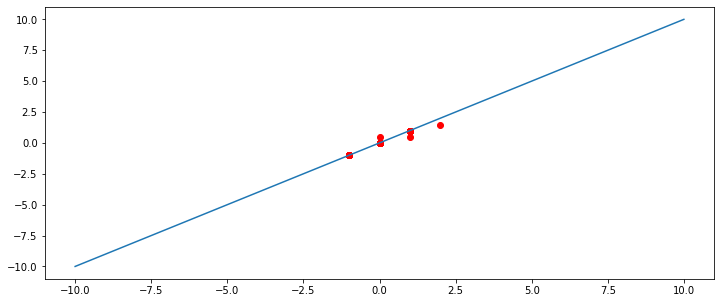

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
112.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

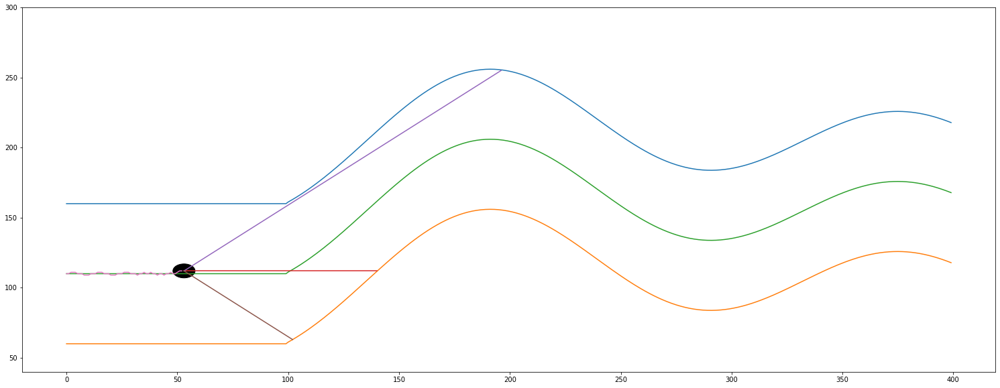

------------------------------ IF i % 3 == 2 ------------------------------
# i =  53
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  88
Sensor from left wall =  145
Sensor from right wall =  50
most távolsagra van a felső faltól =  49.0
most távolsagra van az alsó faltól =  51.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  53
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  54
			 len(self.sensor_left)   =  54
			 len(self.sensor_center) =  54
			 len(self.sensor_right)  =  54
			 self.x                  =  53
			 ----

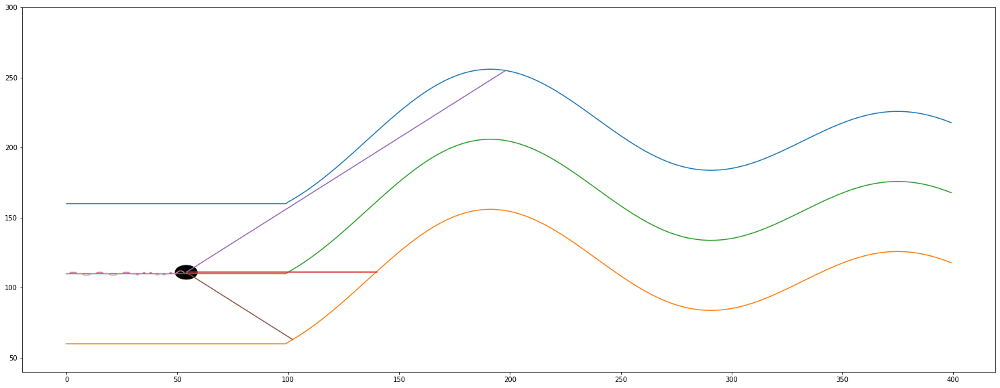

------------------------------ IF i % 3 == 0 ------------------------------
# i =  54
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (55, 3)
y.shape =  (55, 1)
i       =  54
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  54
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(18, 4)
(18, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array([110.,  51., 105.,  5

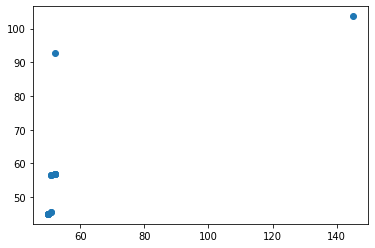

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99428527 0.94349199]]


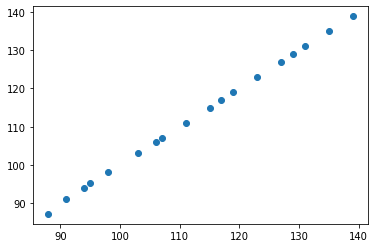

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.78       0.88333333]]


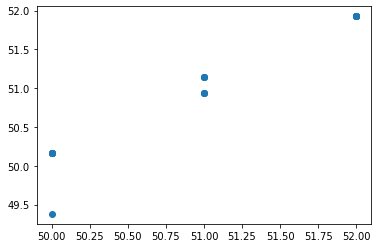

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[19.92378639]]
-------- 1 y up ->  center =  [[2.63687436]]
-------- 1 y up ->  right  =  [[12.92666667]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[145  -3]]
		 _X_center =  [[87 -3]]
		 _X_right  =  [[49 -3]]
		 predicted_left   =  [[116.12824678]]
		 predicted_center =  [[84.37144004]]
		 predicted_right  =  [[46.83333333]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.50216805 -5.97306535]]
		 regression_center.coef_ =  [[0.99428527 0.94349199]]
		 regression_right.coef_  =  [[0

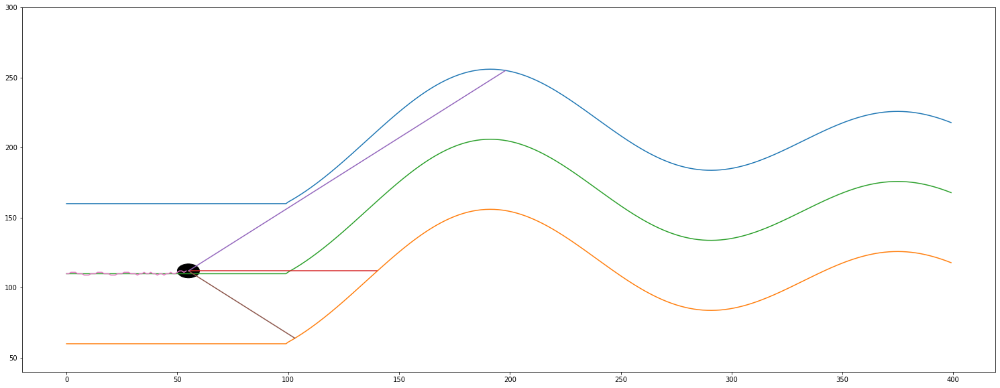

------------------------------ IF i % 3 == 1 ------------------------------
# i =  55
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[144  86  49]]
actual predicted =  [[0.19845585]]
actual self.y_distance[-1] =  2.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0]
len(self.y_distance_real)      =  12
len(self.y_distance_predicted) =  12


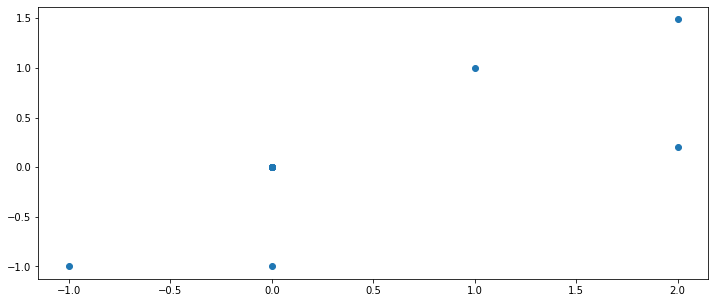

(56, 1)
(56, 1)


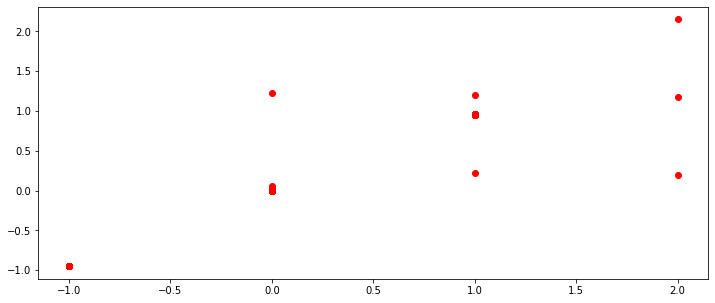

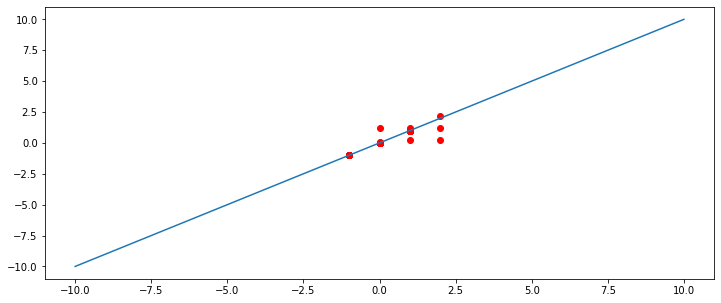

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
112.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége +++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

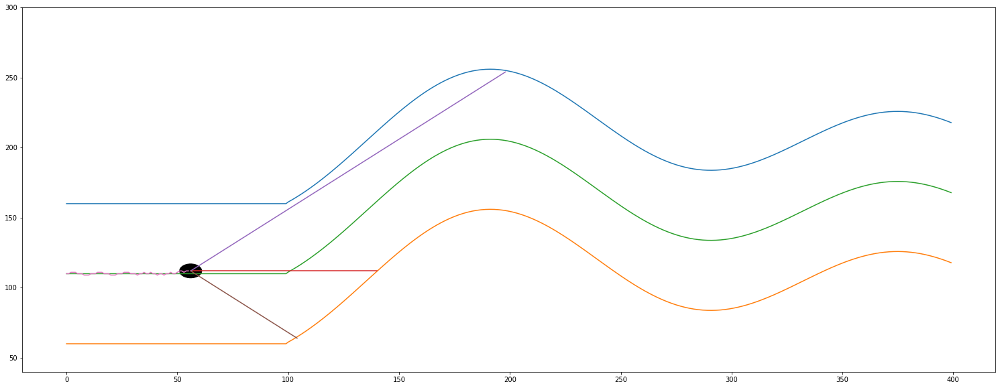

------------------------------ IF i % 3 == 2 ------------------------------
# i =  56
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  85
Sensor from left wall =  144
Sensor from right wall =  48
most távolsagra van a felső faltól =  49.0
most távolsagra van az alsó faltól =  51.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  56
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  57
			 len(self.sensor_left)   =  57
			 len(self.sensor_center) =  57
			 len(self.sensor_right)  =  57
			 self.x                  =  56
			 ---

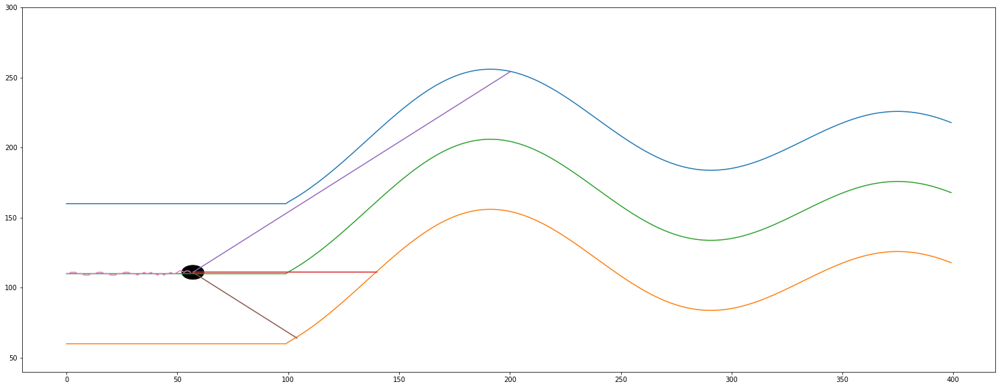

------------------------------ IF i % 3 == 0 ------------------------------
# i =  57
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (58, 3)
y.shape =  (58, 1)
i       =  57
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  57
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.]
(19, 4)
(19, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array([110.,  51., 105

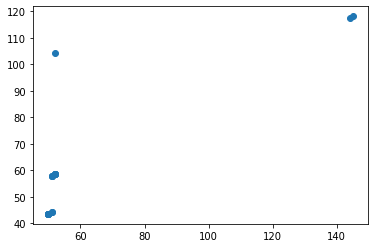

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99065648 0.91141986]]


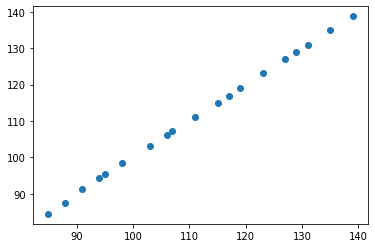

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.9        0.93333333]]


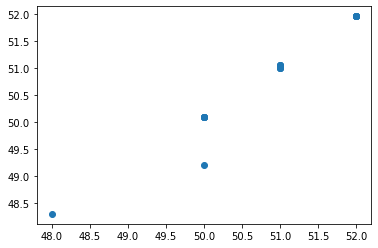

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[11.51879771]]
-------- 1 y up ->  center =  [[3.0412838]]
-------- 1 y up ->  right  =  [[6.96666667]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[144  -3]]
		 _X_center =  [[84 -3]]
		 _X_right  =  [[48 -3]]
		 predicted_left   =  [[133.10822864]]
		 predicted_center =  [[81.62009189]]
		 predicted_right  =  [[45.53333333]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.64045854 -7.50096498]]
		 regression_center.coef_ =  [[0.99065648 0.91141986]]
		 regression_right.coef_  =  [[0.9

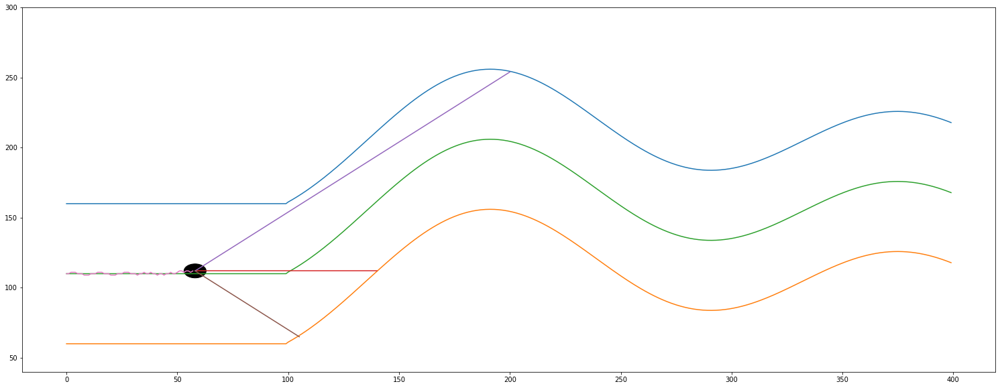

------------------------------ IF i % 3 == 1 ------------------------------
# i =  58
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[143  83  48]]
actual predicted =  [[0.11222369]]
actual self.y_distance[-1] =  2.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0]
len(self.y_distance_real)      =  13
len(self.y_distance_predicted) =  13


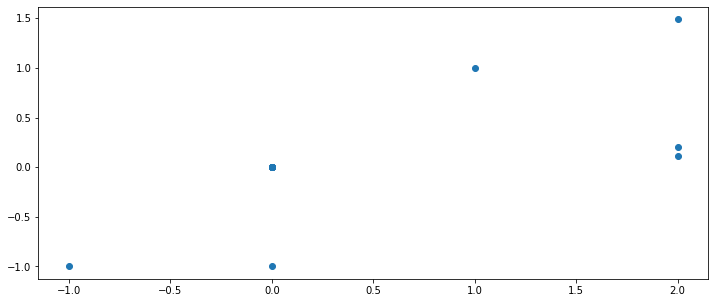

(59, 1)
(59, 1)


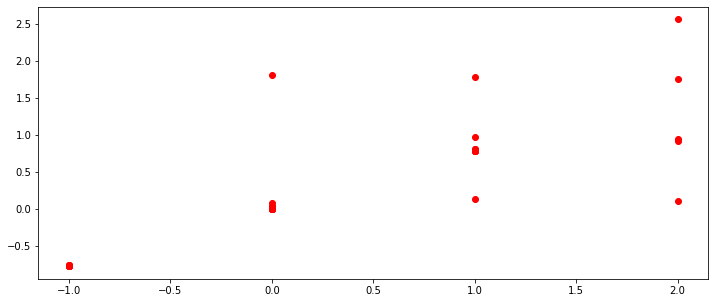

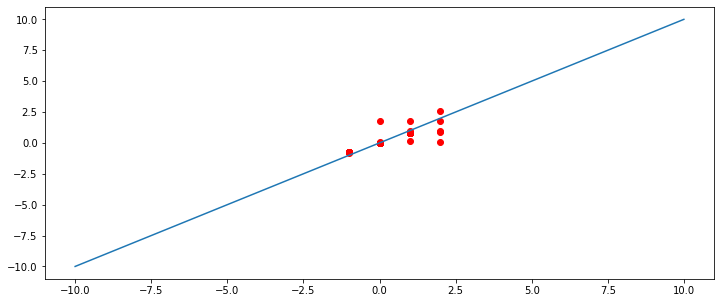

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
112.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

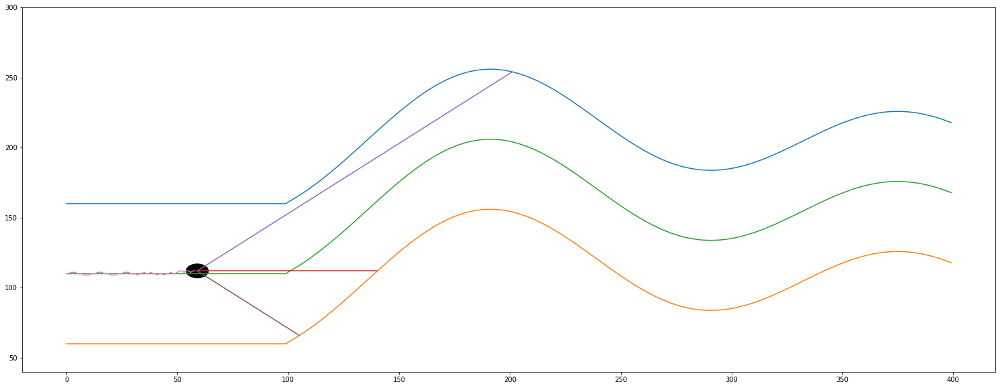

------------------------------ IF i % 3 == 2 ------------------------------
# i =  59
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  83
Sensor from left wall =  142
Sensor from right wall =  48
most távolsagra van a felső faltól =  47.0
most távolsagra van az alsó faltól =  53.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  59
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  3.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  3.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  60
			 len(self.sensor_left)   =  60
			 len(self.sensor_center) =  60
			 len(self.sensor_right)  =  60
			 self.x                  =  59
			 -----

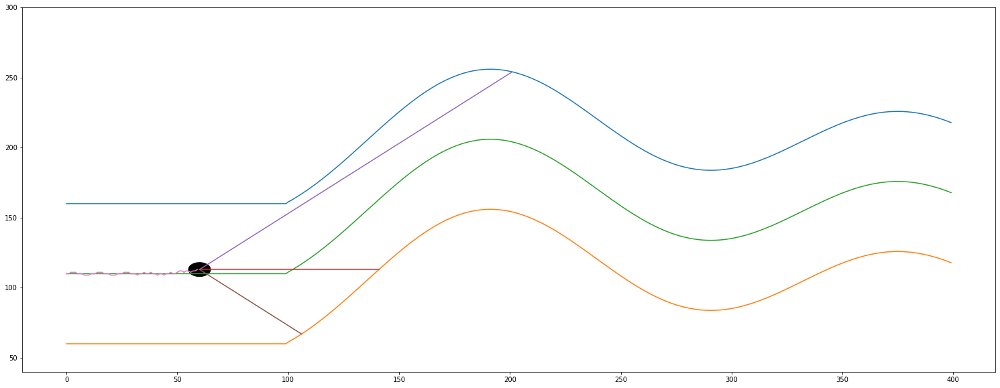

------------------------------ IF i % 3 == 0 ------------------------------
# i =  60
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (61, 3)
y.shape =  (61, 1)
i       =  60
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  60
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.]
(20, 4)
(20, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array([110.,  51.,

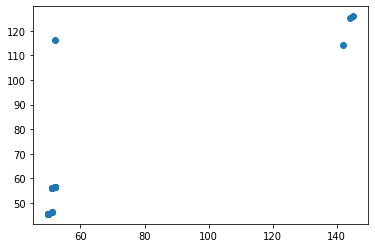

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99198554 0.89759566]]


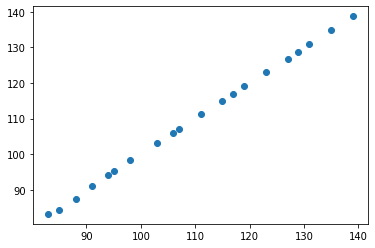

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.95475113 0.9341629 ]]


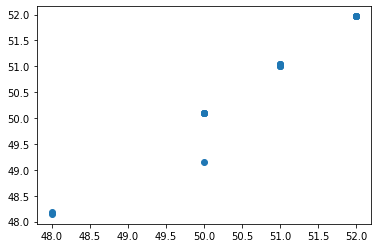

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[8.2895381]]
-------- 1 y up ->  center =  [[2.86876748]]
-------- 1 y up ->  right  =  [[4.23076923]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[142  -3]]
		 _X_center =  [[82 -3]]
		 _X_right  =  [[47 -3]]
		 predicted_left   =  [[135.53612409]]
		 predicted_center =  [[79.62921356]]
		 predicted_right  =  [[44.41266968]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.74470917 -5.56064821]]
		 regression_center.coef_ =  [[0.99198554 0.89759566]]
		 regression_right.coef_  =  [[0.95

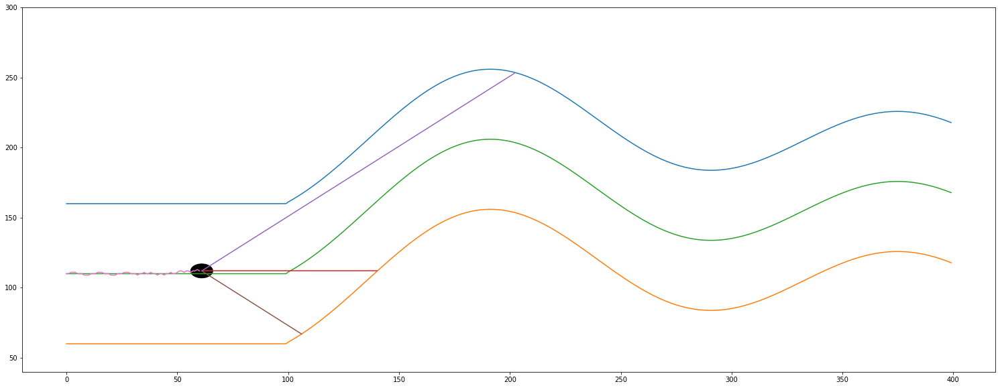

------------------------------ IF i % 3 == 1 ------------------------------
# i =  61
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[142  80  46]]
actual predicted =  [[0.31557542]]
actual self.y_distance[-1] =  2.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0]
len(self.y_distance_real)      =  14
len(self.y_distance_predicted) =  14


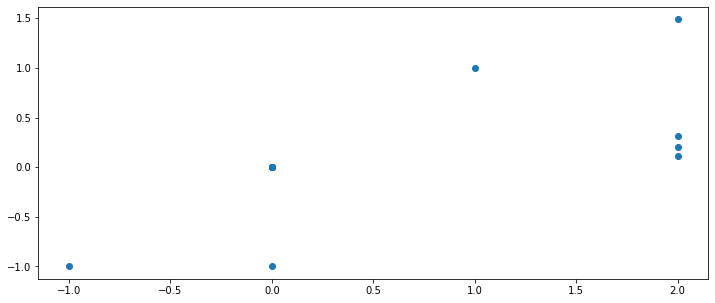

(62, 1)
(62, 1)


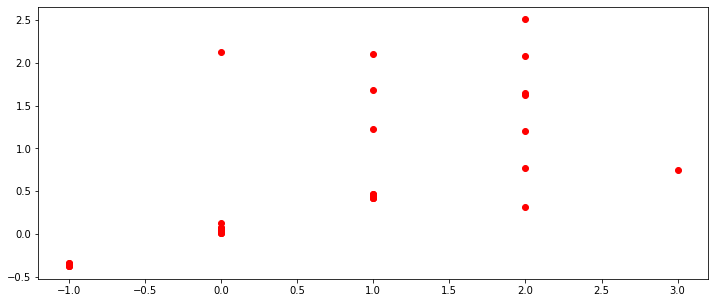

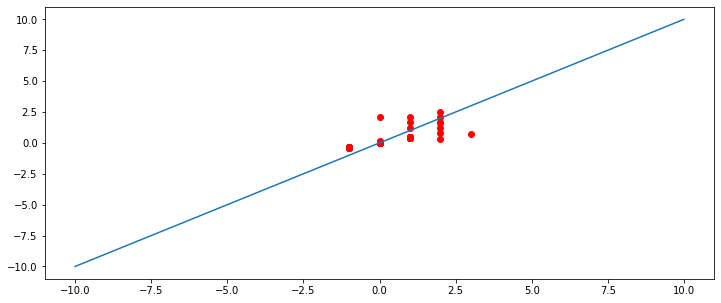

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
112.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége +++++++++++++++++++++++++++++++++++++++++++++++++

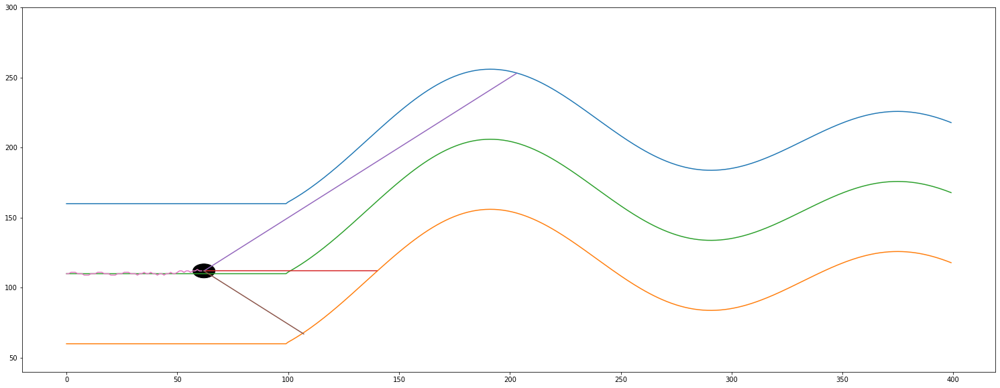

------------------------------ IF i % 3 == 2 ------------------------------
# i =  62
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  80
Sensor from left wall =  141
Sensor from right wall =  46
most távolsagra van a felső faltól =  47.0
most távolsagra van az alsó faltól =  53.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  62
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  3.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  3.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  63
			 len(self.sensor_left)   =  63
			 len(self.sensor_center) =  63
			 len(self.sensor_right)  =  63
			 self.x                  =  62
			 ------

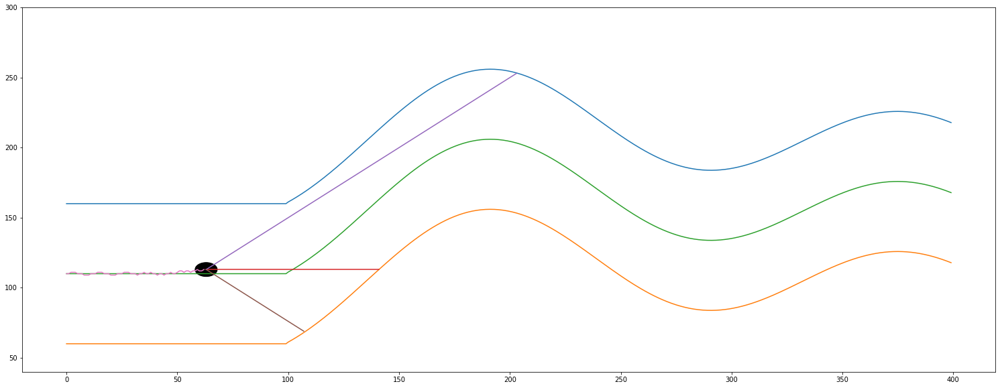

------------------------------ IF i % 3 == 0 ------------------------------
# i =  63
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (64, 3)
y.shape =  (64, 1)
i       =  63
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  63
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1.]
(21, 4)
(21, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array([110.,  

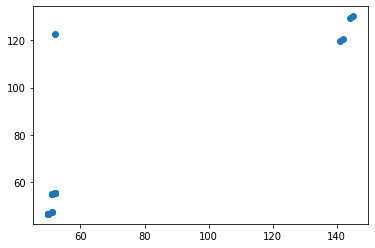

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99298983 0.88821017]]


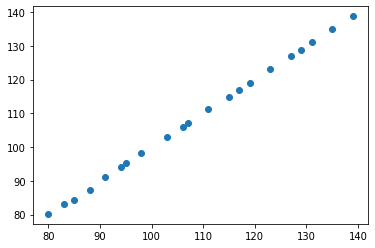

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[1.07476636 0.9453271 ]]


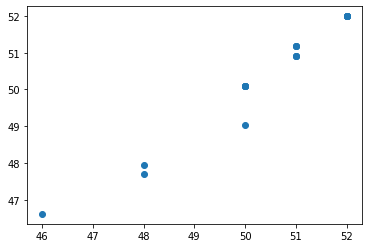

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[6.58534913]]
-------- 1 y up ->  center =  [[2.74052881]]
-------- 1 y up ->  right  =  [[-1.74766355]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[141  -3]]
		 _X_center =  [[79 -3]]
		 _X_right  =  [[45 -3]]
		 predicted_left   =  [[136.69708482]]
		 predicted_center =  [[76.64089492]]
		 predicted_right  =  [[41.76074766]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.8006761  -4.50427057]]
		 regression_center.coef_ =  [[0.99298983 0.88821017]]
		 regression_right.coef_  =  [[1.

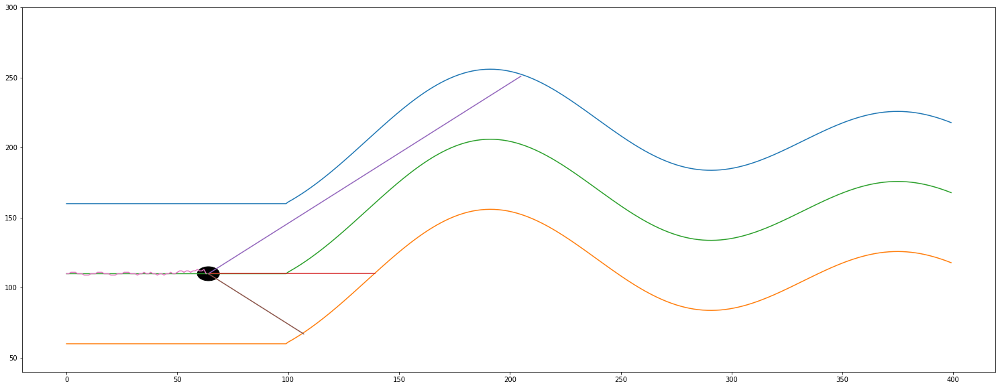

------------------------------ IF i % 3 == 1 ------------------------------
# i =  64
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[142  76  44]]
actual predicted =  [[1.11149791]]
actual self.y_distance[-1] =  0.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0]
len(self.y_distance_real)      =  15
len(self.y_distance_predicted) =  15


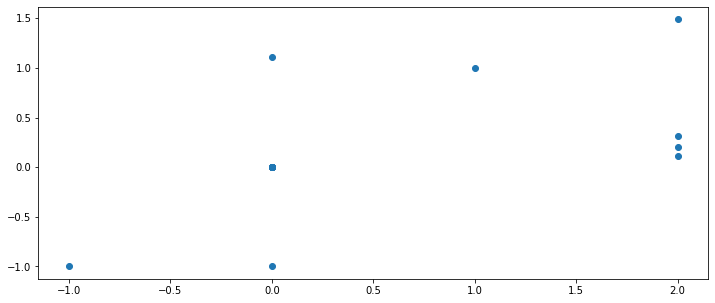

(65, 1)
(65, 1)


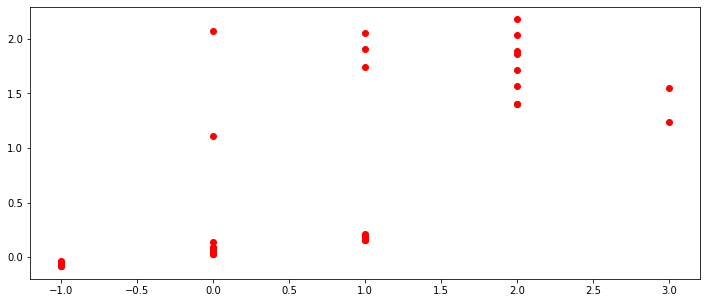

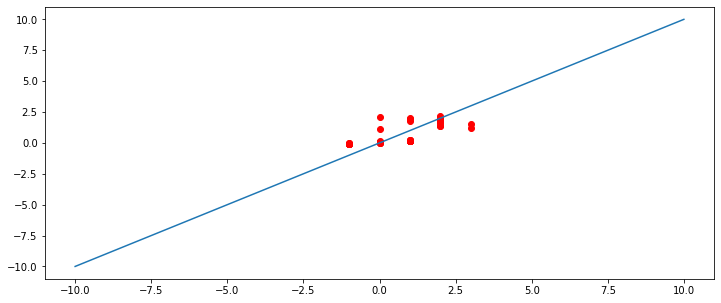

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++

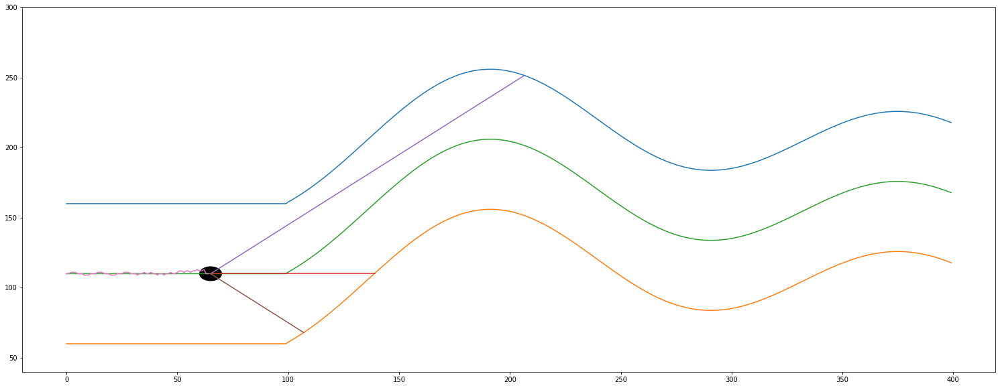

------------------------------ IF i % 3 == 2 ------------------------------
# i =  65
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  74
Sensor from left wall =  143
Sensor from right wall =  43
most távolsagra van a felső faltól =  51.0
most távolsagra van az alsó faltól =  49.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  65
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  66
			 len(self.sensor_left)   =  66
			 len(self.sensor_center) =  66
			 len(self.sensor_right)  =  66
			 self.x                  =  65
			 --

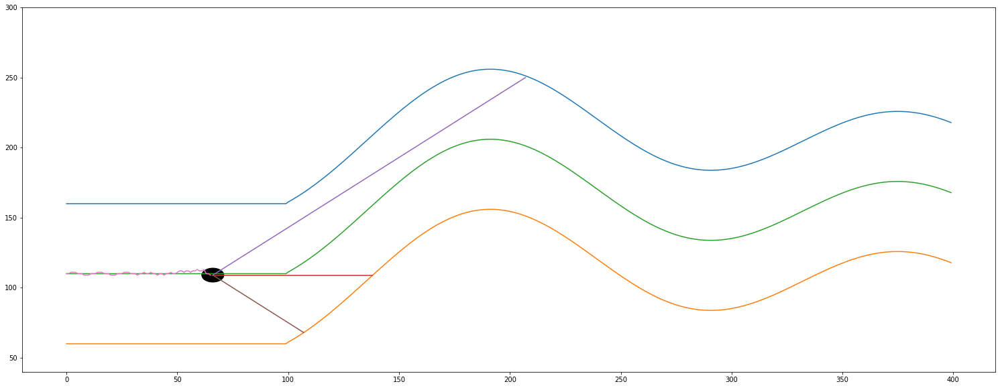

------------------------------ IF i % 3 == 0 ------------------------------
# i =  66
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (67, 3)
y.shape =  (67, 1)
i       =  66
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  66
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1.]
(22, 4)
(22, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array([110

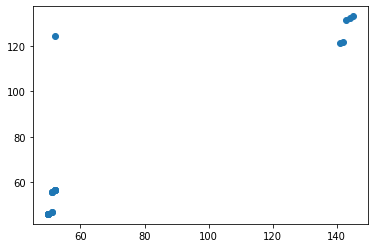

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99480233 0.90861839]]


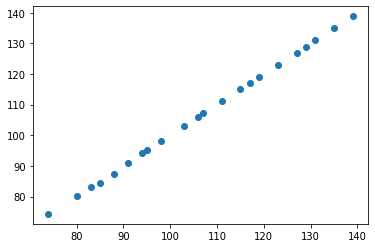

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.96254682 0.85682669]]


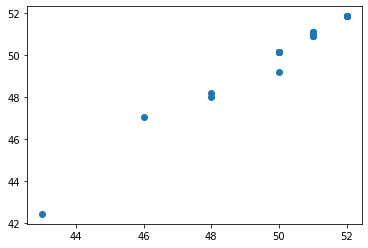

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[4.64089434]]
-------- 1 y up ->  center =  [[2.54906342]]
-------- 1 y up ->  right  =  [[3.74089207]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[142  -3]]
		 _X_center =  [[73 -3]]
		 _X_right  =  [[42 -3]]
		 predicted_left   =  [[141.8579813]]
		 predicted_center =  [[70.54035729]]
		 predicted_right  =  [[39.77800477]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.82644598 -5.17205099]]
		 regression_center.coef_ =  [[0.99480233 0.90861839]]
		 regression_right.coef_  =  [[0.96

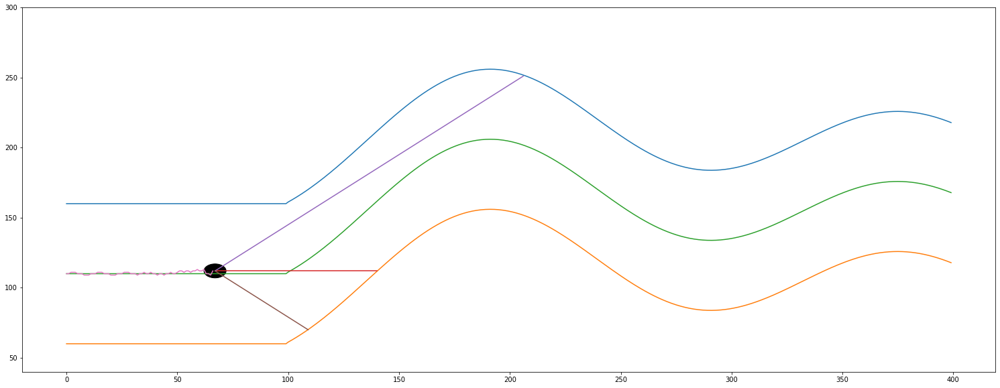

------------------------------ IF i % 3 == 1 ------------------------------
# i =  67
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[140  74  43]]
actual predicted =  [[0.11872418]]
actual self.y_distance[-1] =  2.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0]
len(self.y_distance_real)      =  16
len(self.y_distance_predicted) =  16


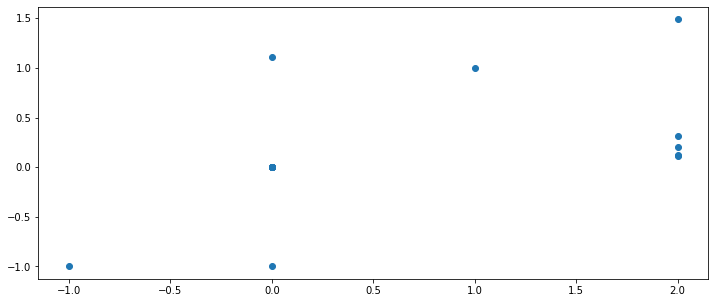

(68, 1)
(68, 1)


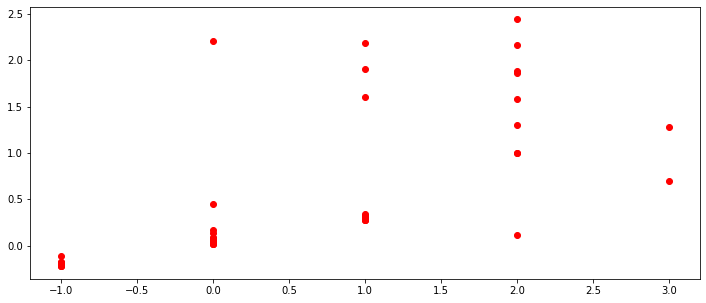

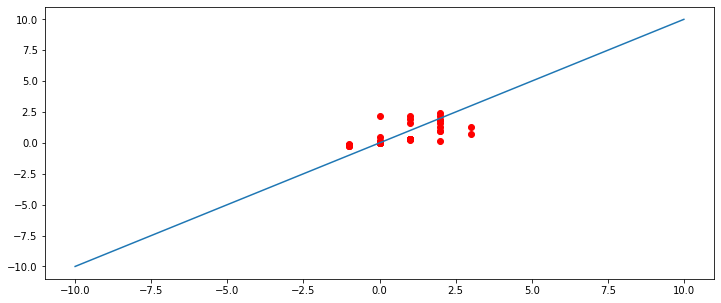

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
112.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége +++++++

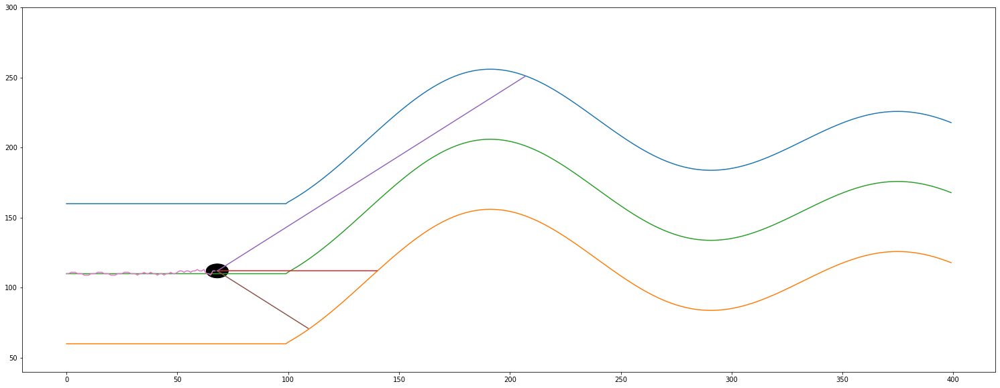

------------------------------ IF i % 3 == 2 ------------------------------
# i =  68
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  73
Sensor from left wall =  140
Sensor from right wall =  42
most távolsagra van a felső faltól =  49.0
most távolsagra van az alsó faltól =  51.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  68
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  69
			 len(self.sensor_left)   =  69
			 len(self.sensor_center) =  69
			 len(self.sensor_right)  =  69
			 self.x                  =  68
			 ---

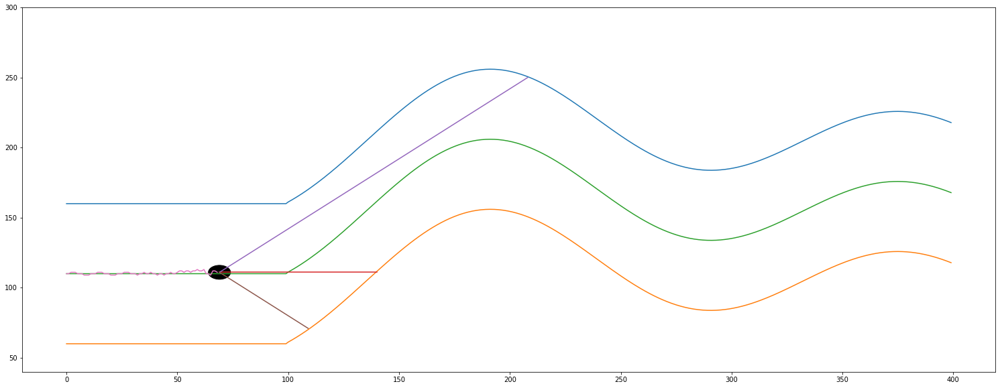

------------------------------ IF i % 3 == 0 ------------------------------
# i =  69
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (70, 3)
y.shape =  (70, 1)
i       =  69
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  69
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.]
(23, 4)
(23, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), array(

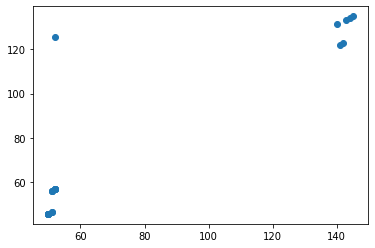

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99255629 0.88481216]]


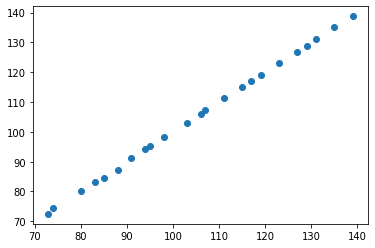

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.93842726 0.83957435]]


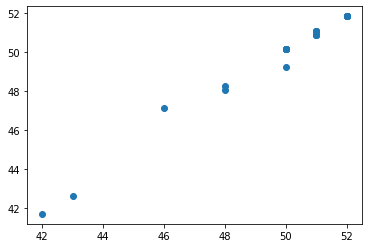

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.54423475]]
-------- 1 y up ->  center =  [[2.78632654]]
-------- 1 y up ->  right  =  [[4.92055743]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[140  -3]]
		 _X_center =  [[72 -3]]
		 _X_right  =  [[41 -3]]
		 predicted_left   =  [[142.68152479]]
		 predicted_center =  [[69.71857442]]
		 predicted_right  =  [[39.09935062]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.84098002 -5.56026677]]
		 regression_center.coef_ =  [[0.99255629 0.88481216]]
		 regression_right.coef_  =  [[0.9

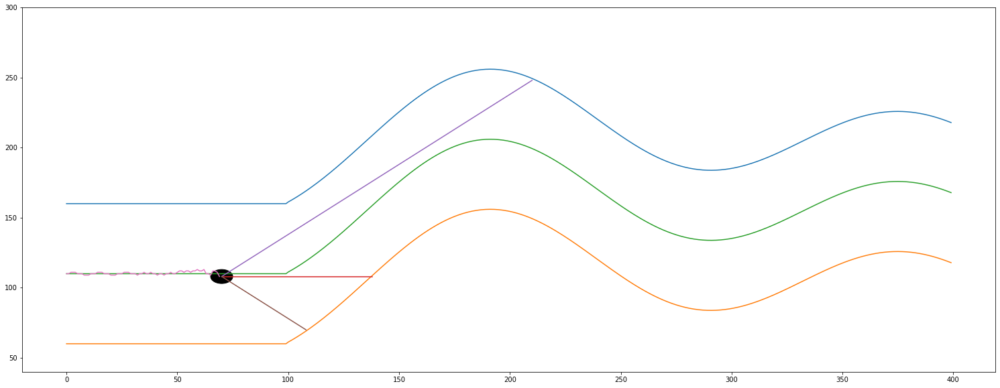

------------------------------ IF i % 3 == 1 ------------------------------
# i =  70
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[141  69  39]]
actual predicted =  [[0.19270971]]
actual self.y_distance[-1] =  -2.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0]
len(self.y_distance_real)      =  17
len(self.y_distance_predicted) =  17


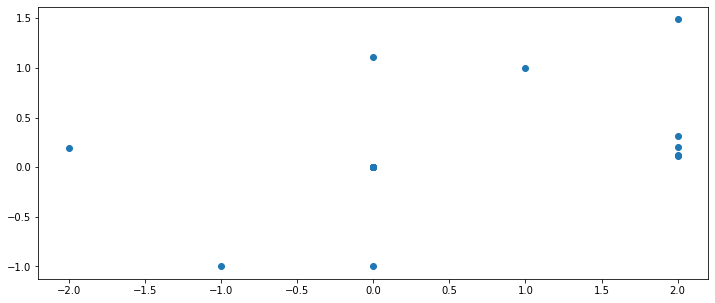

(71, 1)
(71, 1)


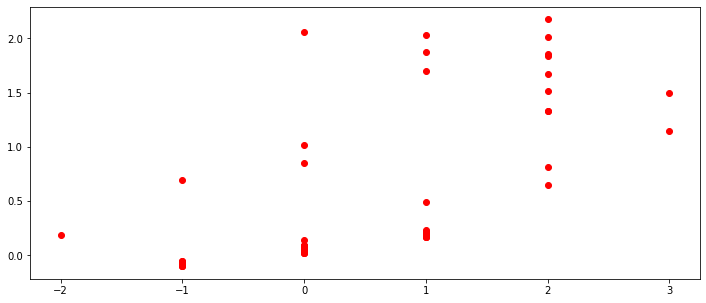

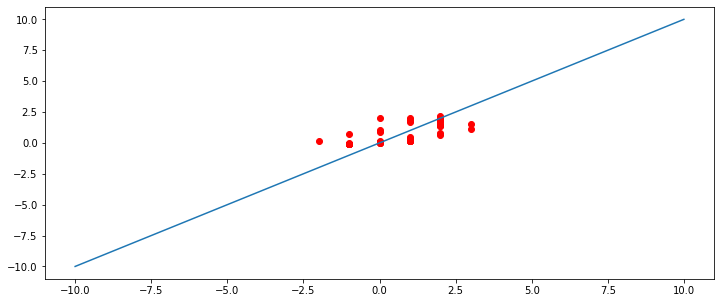

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
108.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A ru

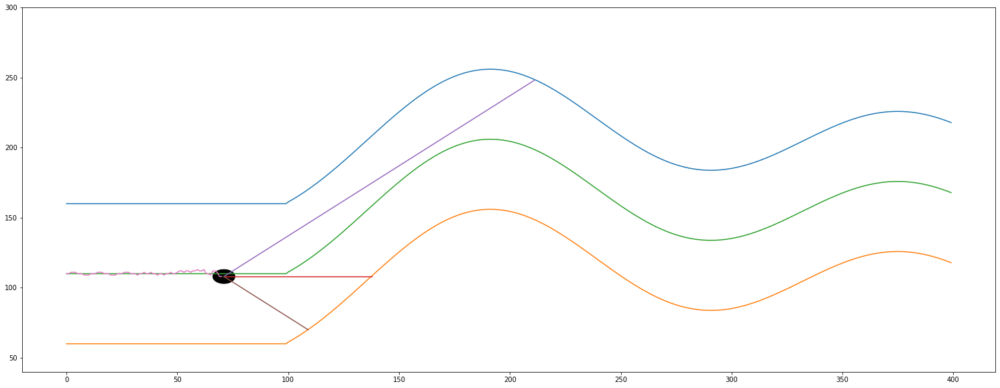

------------------------------ IF i % 3 == 2 ------------------------------
# i =  71
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  68
Sensor from left wall =  140
Sensor from right wall =  39
most távolsagra van a felső faltól =  51.0
most távolsagra van az alsó faltól =  49.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  71
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -1.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -1.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  72
			 len(self.sensor_left)   =  72
			 len(self.sensor_center) =  72
			 len(self.sensor_right)  =  72
			 self.x                  =  71
			 ---

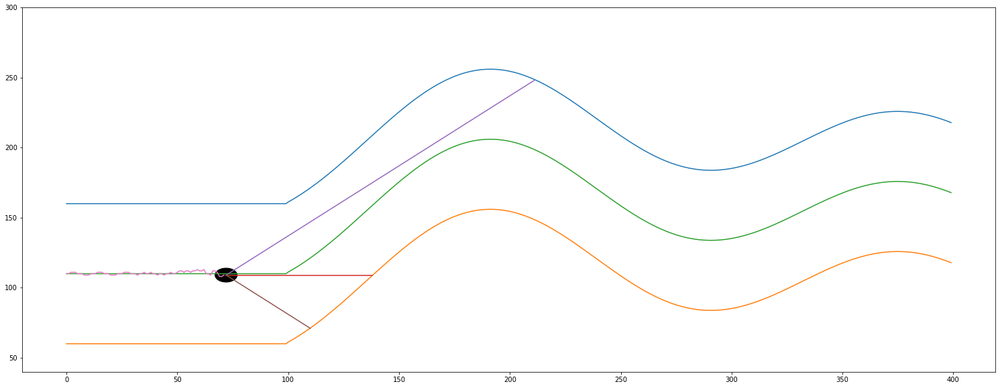

------------------------------ IF i % 3 == 0 ------------------------------
# i =  72
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (73, 3)
y.shape =  (73, 1)
i       =  72
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  72
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.]
(24, 4)
(24, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.]), ar

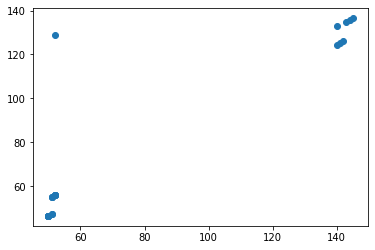

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99701186 0.83246179]]


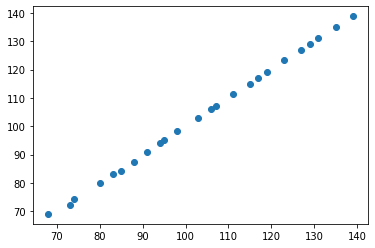

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99721103 0.79085322]]


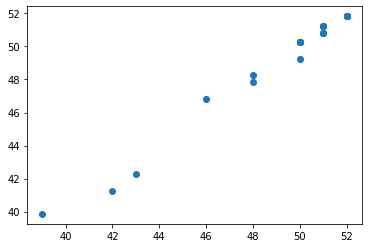

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.10854064]]
-------- 1 y up ->  center =  [[2.2227017]]
-------- 1 y up ->  right  =  [[1.9672038]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[140  -3]]
		 _X_center =  [[67 -3]]
		 _X_right  =  [[39 -3]]
		 predicted_left   =  [[142.59055187]]
		 predicted_center =  [[64.69563748]]
		 predicted_right  =  [[36.69781014]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.86566754 -4.78855585]]
		 regression_center.coef_ =  [[0.99701186 0.83246179]]
		 regression_right.coef_  =  [[0.997

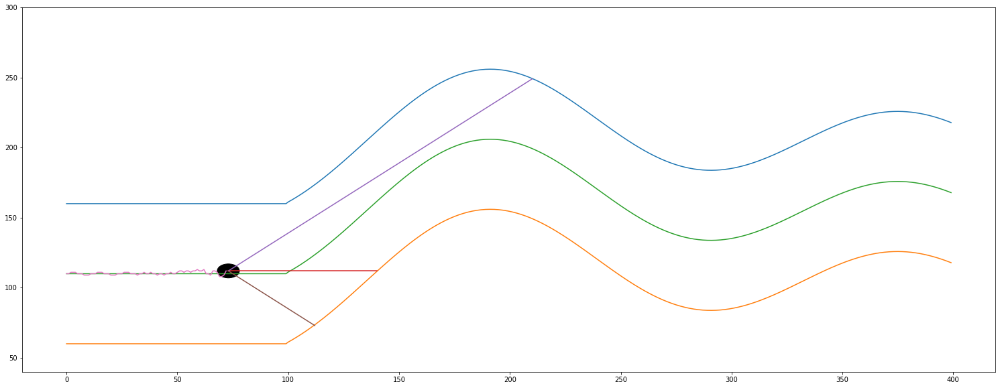

------------------------------ IF i % 3 == 1 ------------------------------
# i =  73
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[138  68  40]]
actual predicted =  [[-0.52811931]]
actual self.y_distance[-1] =  2.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0]
len(self.y_distance_real)      =  18
len(self.y_distance_predicted) =  18


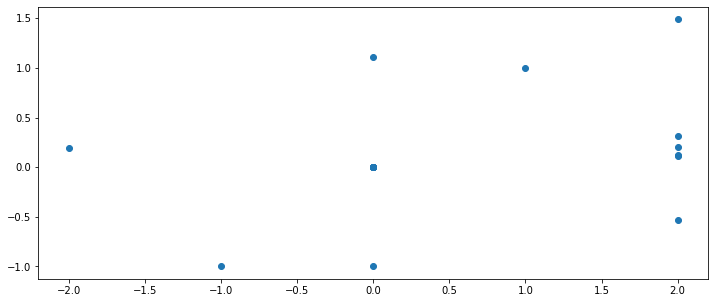

(74, 1)
(74, 1)


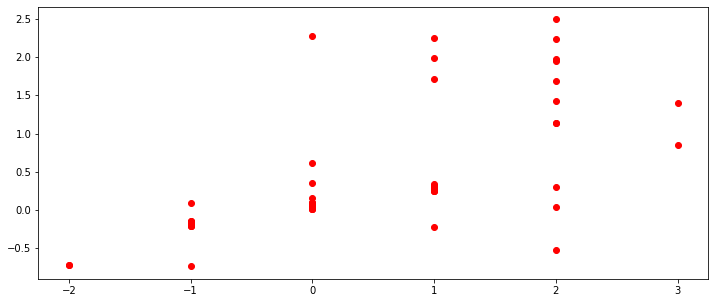

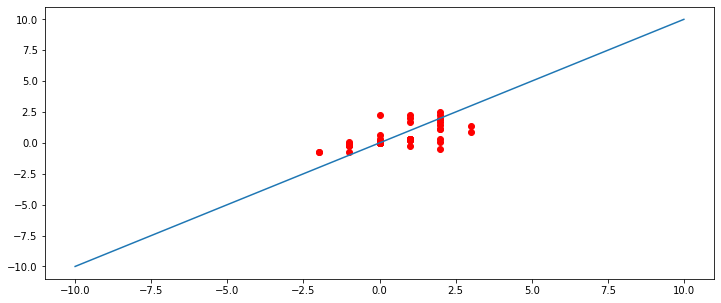

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
112.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_take

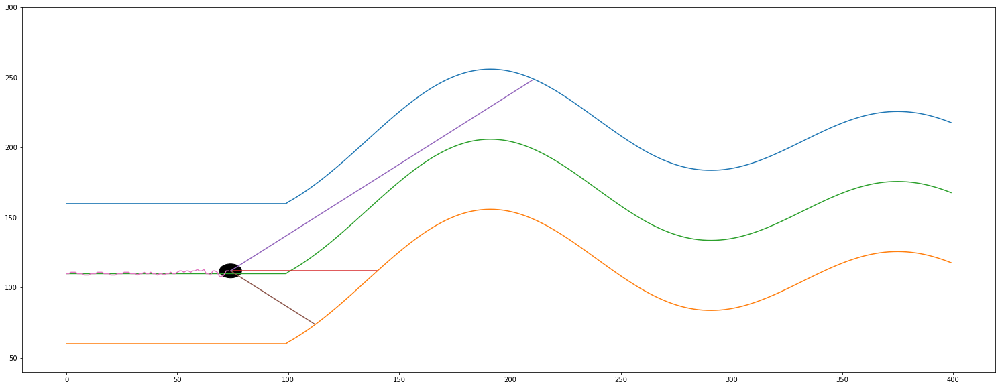

------------------------------ IF i % 3 == 2 ------------------------------
# i =  74
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  68
Sensor from left wall =  137
Sensor from right wall =  40
most távolsagra van a felső faltól =  47.0
most távolsagra van az alsó faltól =  53.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  74
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  3.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  3.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  75
			 len(self.sensor_left)   =  75
			 len(self.sensor_center) =  75
			 len(self.sensor_right)  =  75
			 self.x                  =  74
			 ------

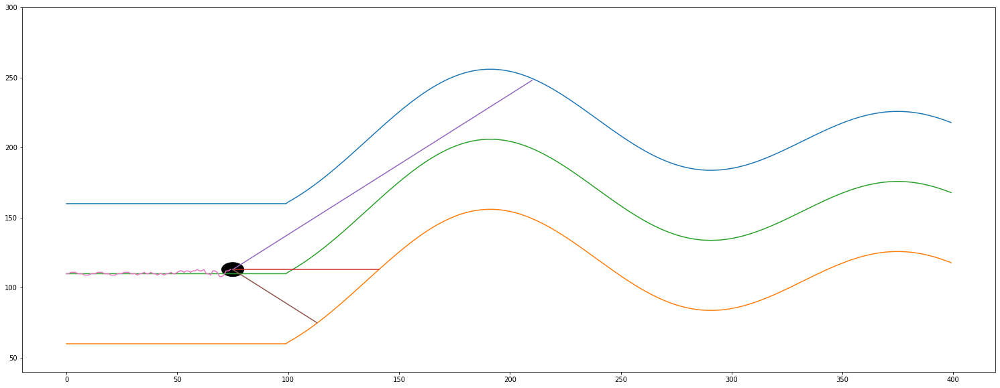

------------------------------ IF i % 3 == 0 ------------------------------
# i =  75
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (76, 3)
y.shape =  (76, 1)
i       =  75
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  75
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1.]
(25, 4)
(25, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  51.])

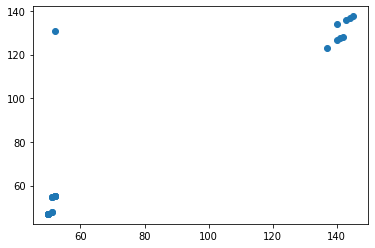

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99708662 0.83160813]]


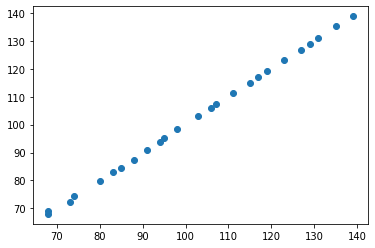

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99366471 0.79379248]]


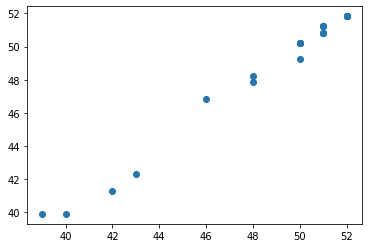

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.88296176]]
-------- 1 y up ->  center =  [[2.21329413]]
-------- 1 y up ->  right  =  [[2.14537453]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[136  -3]]
		 _X_center =  [[67 -3]]
		 _X_right  =  [[39 -3]]
		 predicted_left   =  [[138.9161239]]
		 predicted_center =  [[64.6945787]]
		 predicted_right  =  [[36.72946354]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.88293083 -4.20937505]]
		 regression_center.coef_ =  [[0.99708662 0.83160813]]
		 regression_right.coef_  =  [[0.993

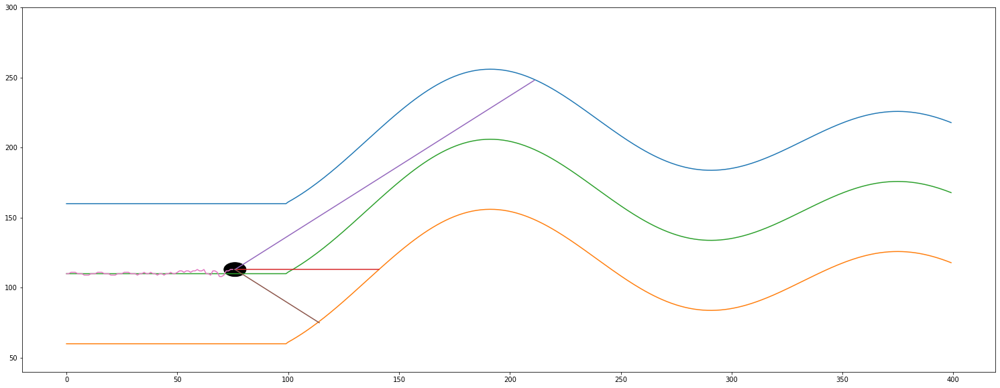

------------------------------ IF i % 3 == 1 ------------------------------
# i =  76
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[136  66  39]]
actual predicted =  [[0.18790802]]
actual self.y_distance[-1] =  3.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0]
len(self.y_distance_real)      =  19
len(self.y_distance_predicted) =  19


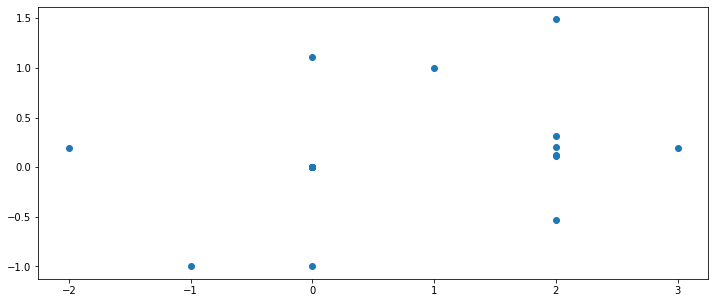

(77, 1)
(77, 1)


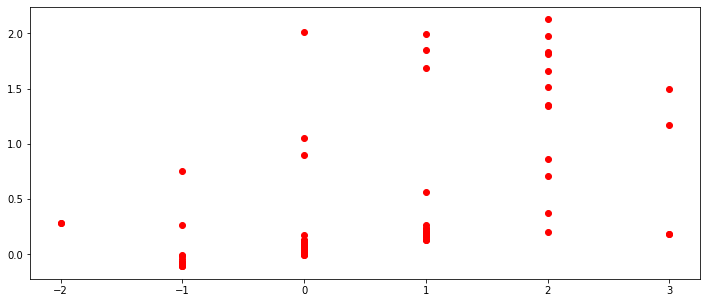

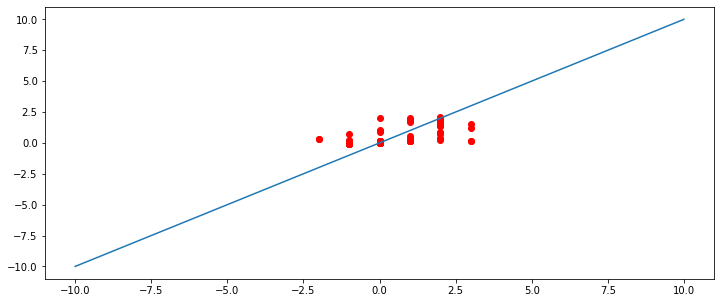

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
113.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _sum

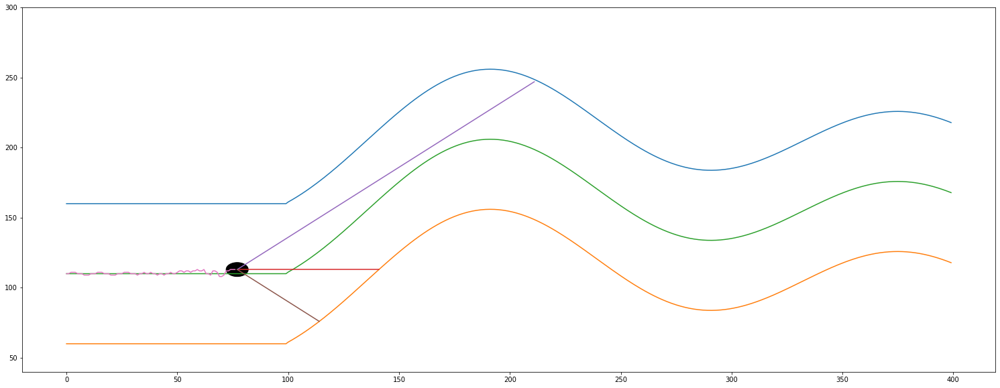

------------------------------ IF i % 3 == 2 ------------------------------
# i =  77
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  64
Sensor from left wall =  136
Sensor from right wall =  38
most távolsagra van a felső faltól =  48.0
most távolsagra van az alsó faltól =  52.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  77
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  2.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  2.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  78
			 len(self.sensor_left)   =  78
			 len(self.sensor_center) =  78
			 len(self.sensor_right)  =  78
			 self.x                  =  77
			 ----

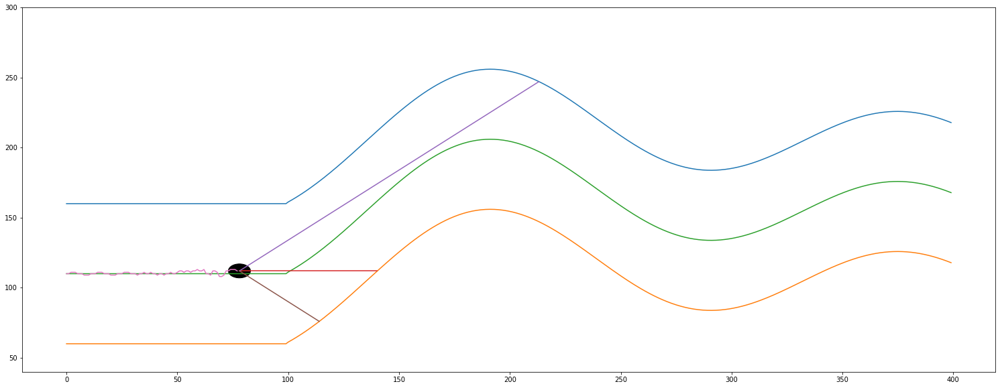

------------------------------ IF i % 3 == 0 ------------------------------
# i =  78
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (79, 3)
y.shape =  (79, 1)
i       =  78
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  78
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1.]
(26, 4)
(26, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.,  5

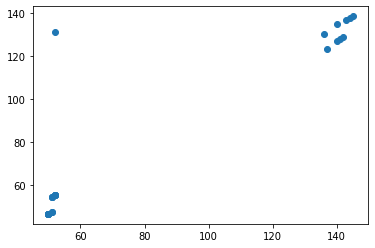

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99810429 0.84578929]]


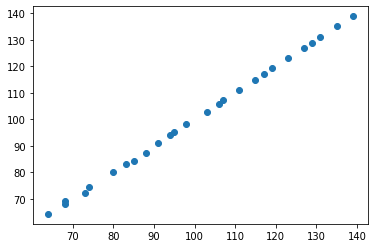

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.9787504  0.76432701]]


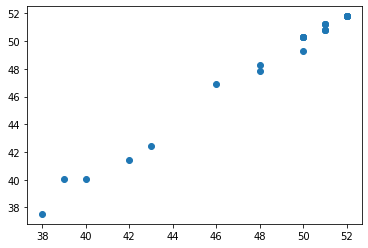

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.34674867]]
-------- 1 y up ->  center =  [[2.11191843]]
-------- 1 y up ->  right  =  [[2.84978897]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[136  -3]]
		 _X_center =  [[63 -3]]
		 _X_right  =  [[37 -3]]
		 predicted_left   =  [[140.22286318]]
		 predicted_center =  [[60.61122749]]
		 predicted_right  =  [[35.02749518]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.88923351 -4.45739751]]
		 regression_center.coef_ =  [[0.99810429 0.84578929]]
		 regression_right.coef_  =  [[0.9

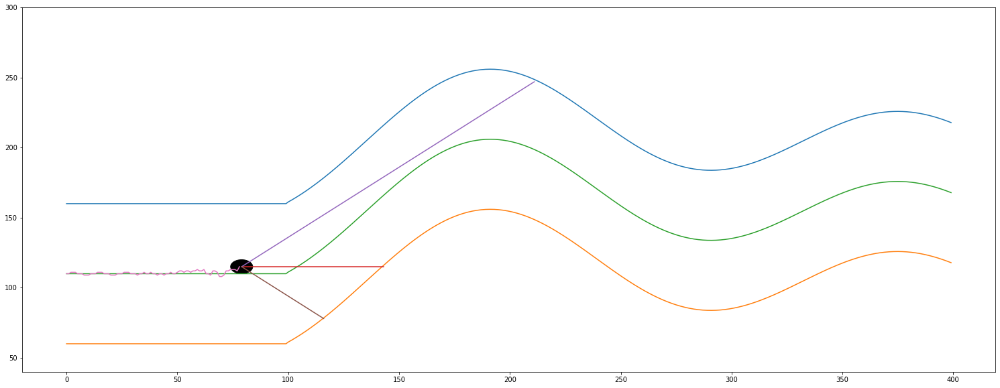

------------------------------ IF i % 3 == 1 ------------------------------
# i =  79
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[133  65  38]]
actual predicted =  [[0.770984]]
actual self.y_distance[-1] =  5.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0]
len(self.y_distance_real)      =  20
len(self.y_distance_predicted) =  20


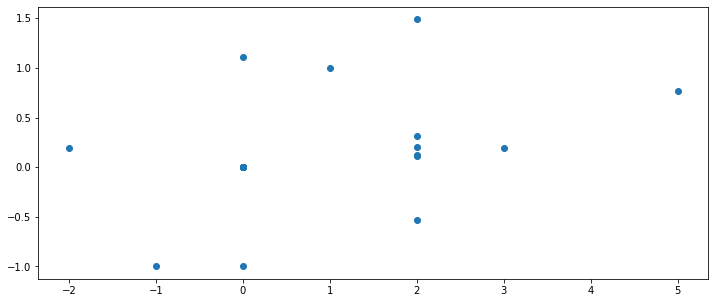

(80, 1)
(80, 1)


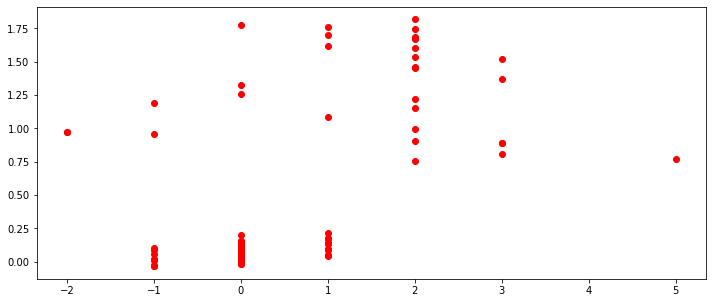

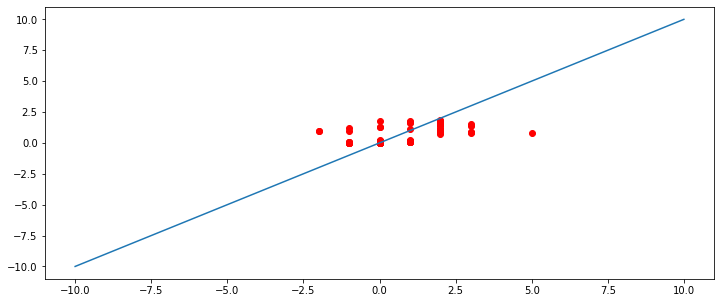

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
115.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas

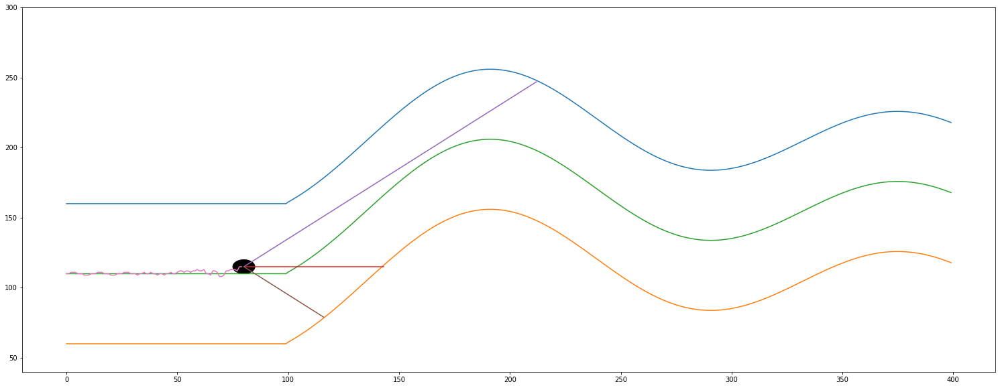

------------------------------ IF i % 3 == 2 ------------------------------
# i =  80
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  63
Sensor from left wall =  134
Sensor from right wall =  37
most távolsagra van a felső faltól =  46.0
most távolsagra van az alsó faltól =  54.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  80
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  4.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  4.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  81
			 len(self.sensor_left)   =  81
			 len(self.sensor_center) =  81
			 len(self.sensor_right)  =  81
			 self.x                  =  80
			 ---

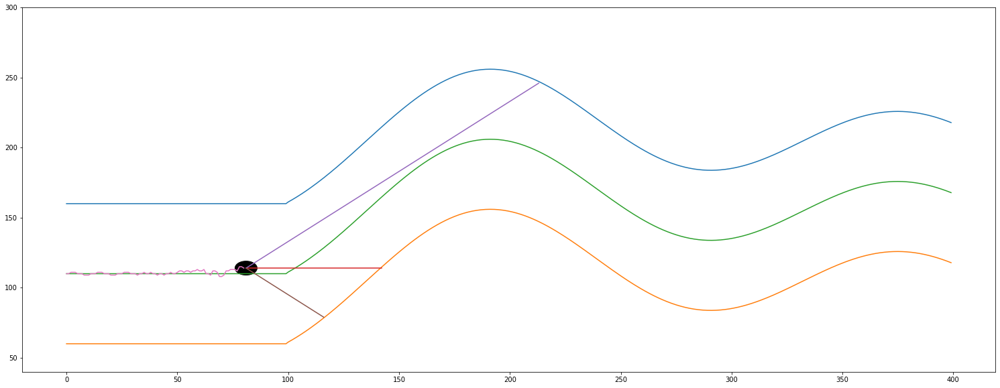

------------------------------ IF i % 3 == 0 ------------------------------
# i =  81
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (82, 3)
y.shape =  (82, 1)
i       =  81
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  81
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(27, 4)
(27, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 108.

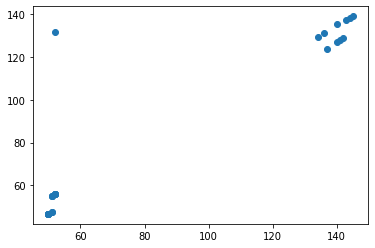

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99883574 0.8557102 ]]


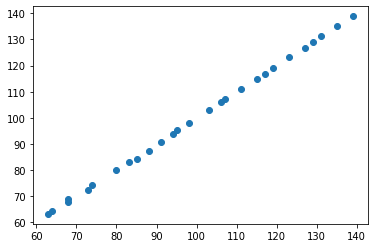

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97087658 0.74994613]]


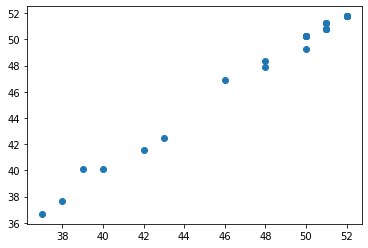

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[1.96180204]]
-------- 1 y up ->  center =  [[2.03905551]]
-------- 1 y up ->  right  =  [[3.22167558]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[133  -3]]
		 _X_center =  [[62 -3]]
		 _X_right  =  [[36 -3]]
		 predicted_left   =  [[138.50927025]]
		 predicted_center =  [[59.54519462]]
		 predicted_right  =  [[34.20257119]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.8937582  -4.64284632]]
		 regression_center.coef_ =  [[0.99883574 0.8557102 ]]
		 regression_right.coef_  =  [[0.9

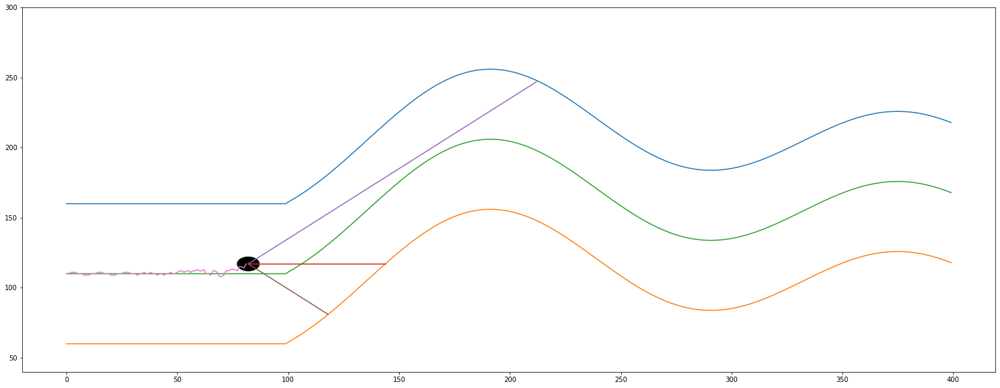

------------------------------ IF i % 3 == 1 ------------------------------
# i =  82
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[131  63  37]]
actual predicted =  [[1.76086254]]
actual self.y_distance[-1] =  7.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0]
len(self.y_distance_real)      =  21
len(self.y_distance_predicted) =  21


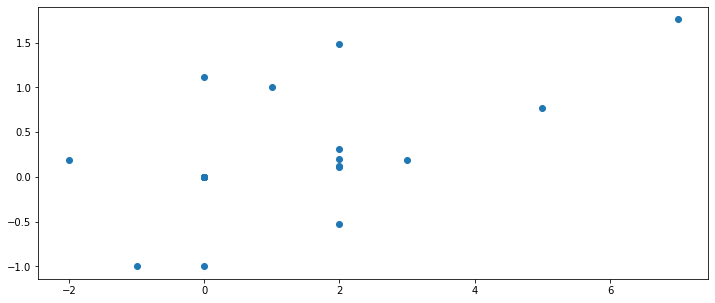

(83, 1)
(83, 1)


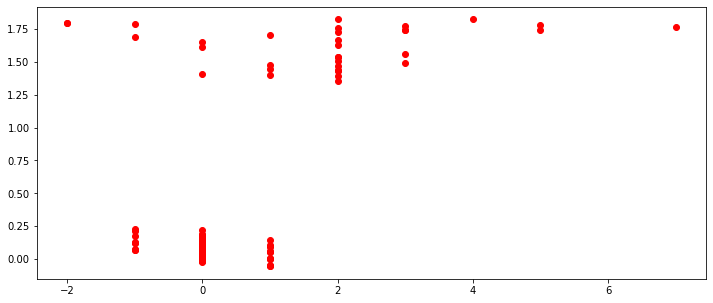

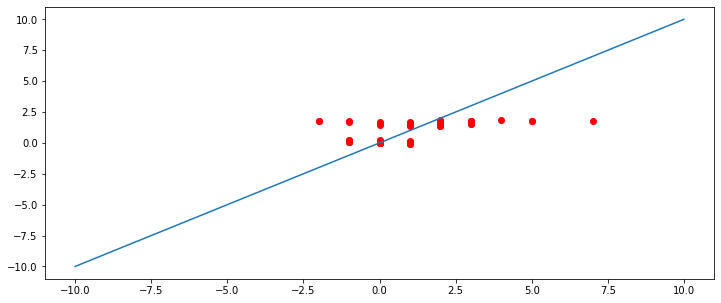

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
117.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary

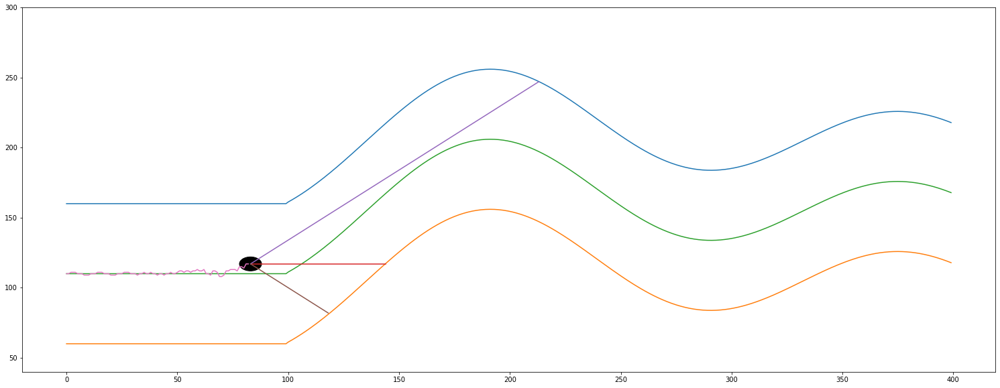

------------------------------ IF i % 3 == 2 ------------------------------
# i =  83
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  63
Sensor from left wall =  130
Sensor from right wall =  37
most távolsagra van a felső faltól =  42.0
most távolsagra van az alsó faltól =  58.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  83
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  8.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  8.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  84
			 len(self.sensor_left)   =  84
			 len(self.sensor_center) =  84
			 len(self.sensor_right)  =  84
			 self.x                  =  83
			 -----

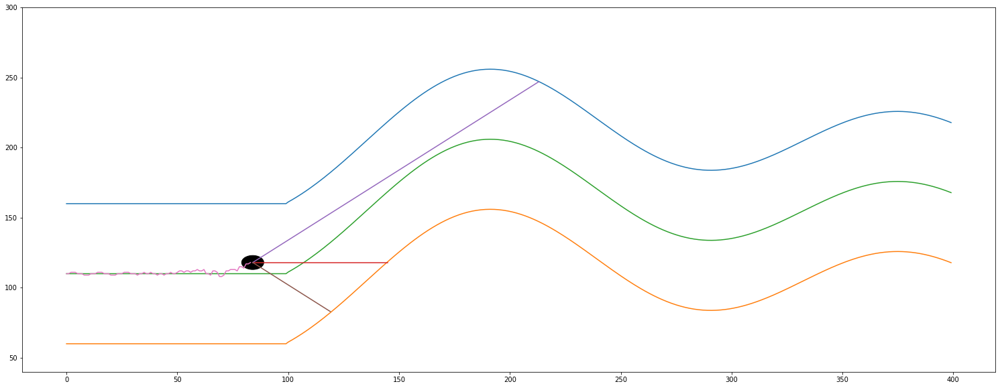

------------------------------ IF i % 3 == 0 ------------------------------
# i =  84
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (85, 3)
y.shape =  (85, 1)
i       =  84
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  84
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(28, 4)
(28, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  51., 

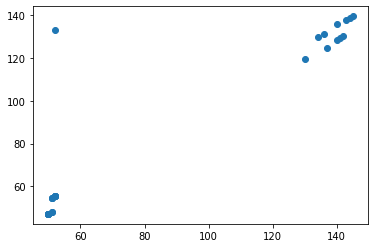

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99876188 0.85683333]]


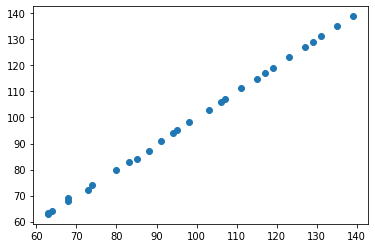

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97393703 0.74348426]]


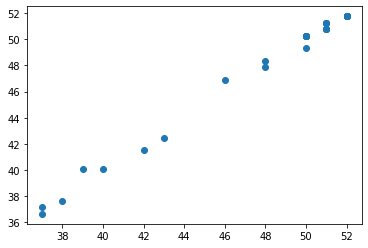

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.00499877]]
-------- 1 y up ->  center =  [[2.04849213]]
-------- 1 y up ->  right  =  [[3.06534766]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[130  -3]]
		 _X_center =  [[62 -3]]
		 _X_right  =  [[36 -3]]
		 predicted_left   =  [[135.36240118]]
		 predicted_center =  [[59.54563354]]
		 predicted_right  =  [[34.1792067]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.902856   -4.22224457]]
		 regression_center.coef_ =  [[0.99876188 0.85683333]]
		 regression_right.coef_  =  [[0.97

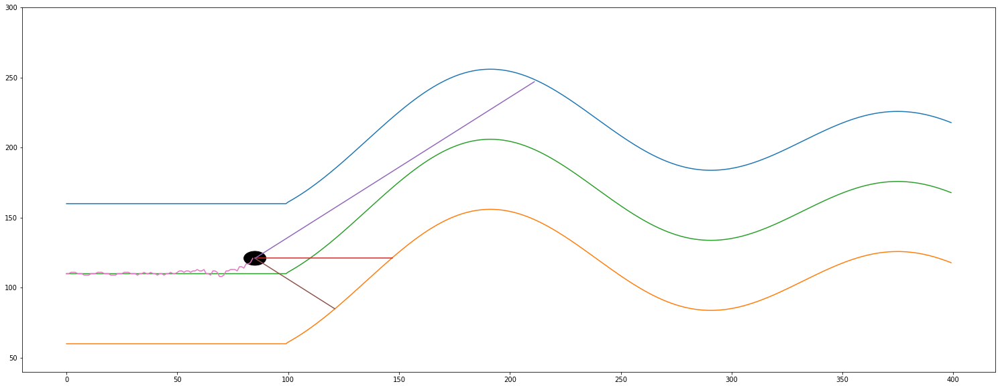

------------------------------ IF i % 3 == 1 ------------------------------
# i =  85
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[127  63  37]]
actual predicted =  [[3.00028952]]
actual self.y_distance[-1] =  11.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0]
len(self.y_distance_real)      =  22
len(self.y_distance_predicted) =  22


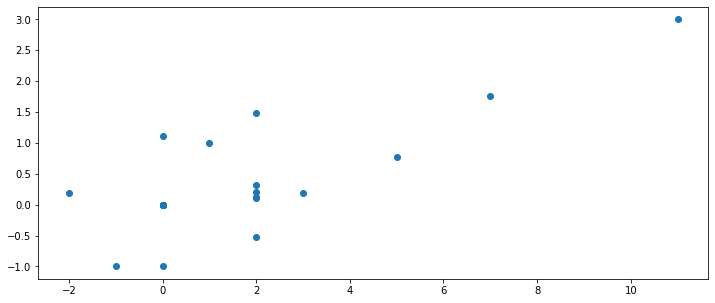

(86, 1)
(86, 1)


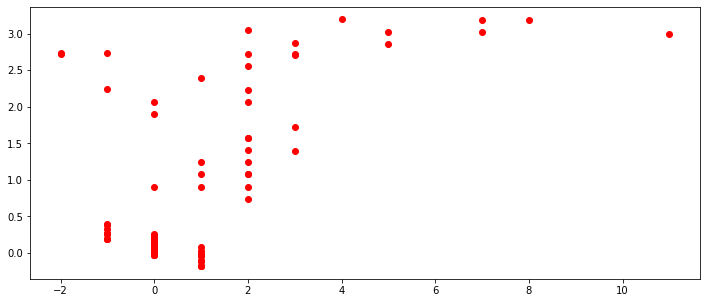

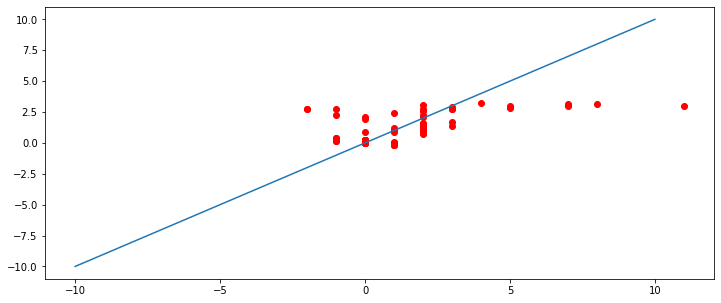

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
121.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken

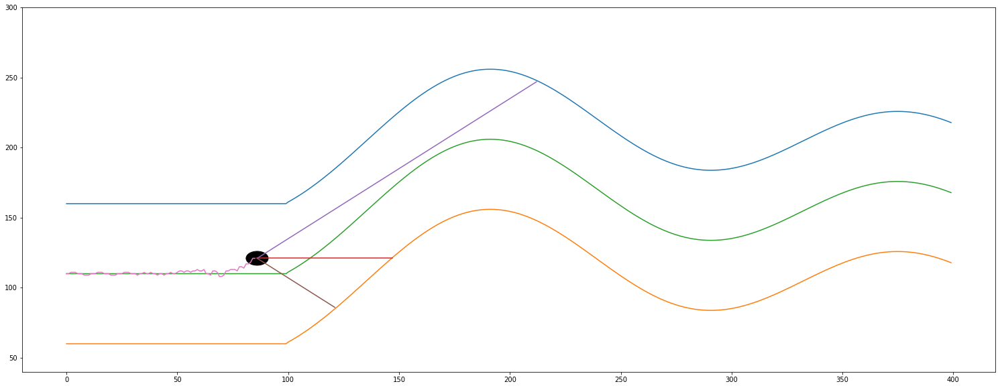

------------------------------ IF i % 3 == 2 ------------------------------
# i =  86
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  63
Sensor from left wall =  126
Sensor from right wall =  37
most távolsagra van a felső faltól =  38.0
most távolsagra van az alsó faltól =  62.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  86
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  12.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  12.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  87
			 len(self.sensor_left)   =  87
			 len(self.sensor_center) =  87
			 len(self.sensor_right)  =  87
			 self.x                  =  86
			 ----

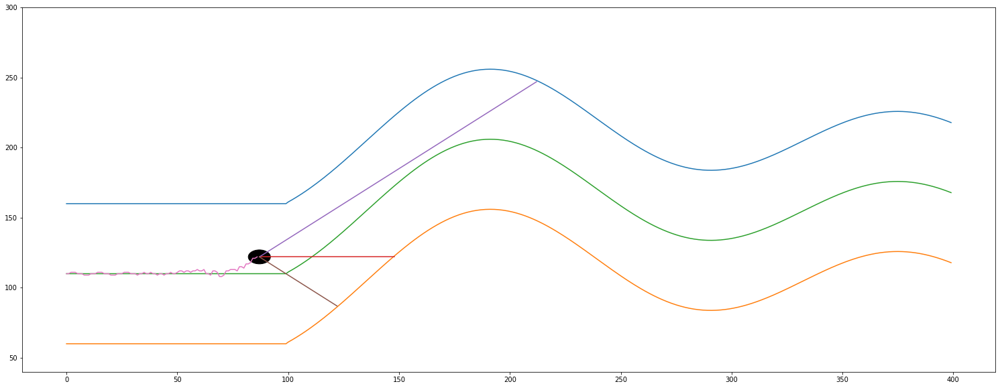

------------------------------ IF i % 3 == 0 ------------------------------
# i =  87
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (88, 3)
y.shape =  (88, 1)
i       =  87
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  87
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(29, 4)
(29, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.,  5

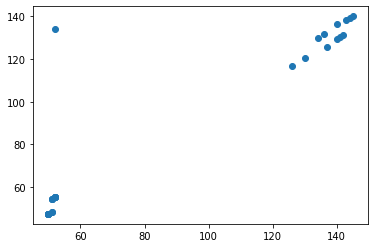

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99870777 0.85765623]]


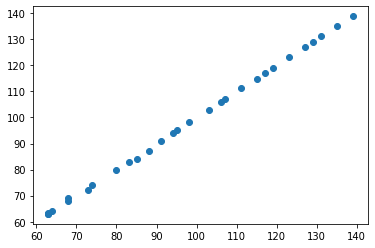

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.9758001  0.73955054]]


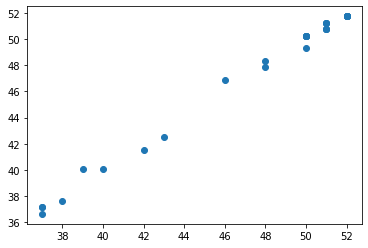

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.09960197]]
-------- 1 y up ->  center =  [[2.0554062]]
-------- 1 y up ->  right  =  [[2.97018188]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[126  -3]]
		 _X_center =  [[62 -3]]
		 _X_right  =  [[36 -3]]
		 predicted_left   =  [[131.32995461]]
		 predicted_center =  [[59.54595513]]
		 predicted_right  =  [[34.16498339]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.90932891 -3.89105984]]
		 regression_center.coef_ =  [[0.99870777 0.85765623]]
		 regression_right.coef_  =  [[0.97

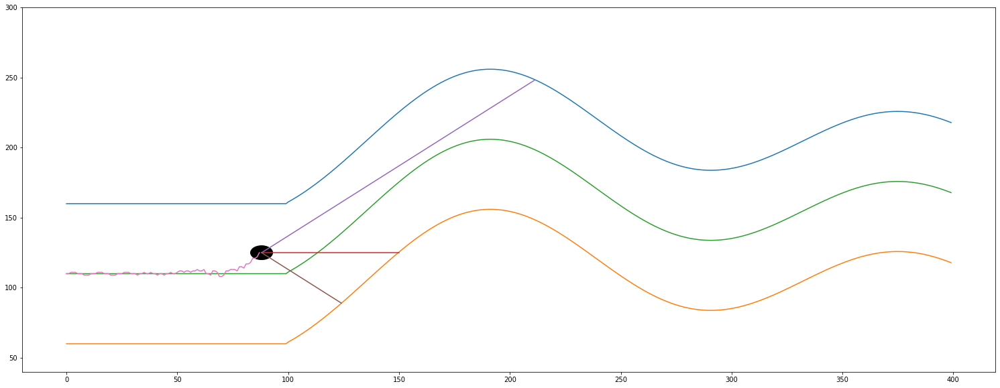

------------------------------ IF i % 3 == 1 ------------------------------
# i =  88
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[124  63  37]]
actual predicted =  [[4.57366307]]
actual self.y_distance[-1] =  15.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0]
len(self.y_distance_real)      =  23
len(self.y_distance_predicted) =  23


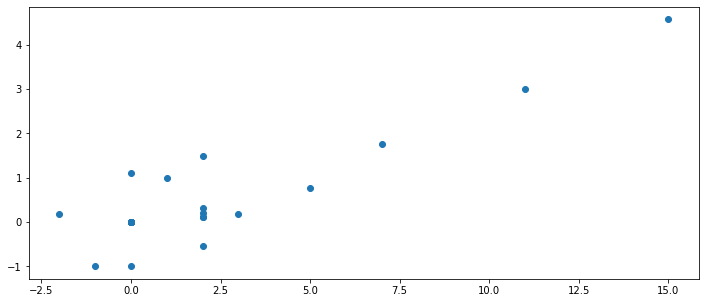

(89, 1)
(89, 1)


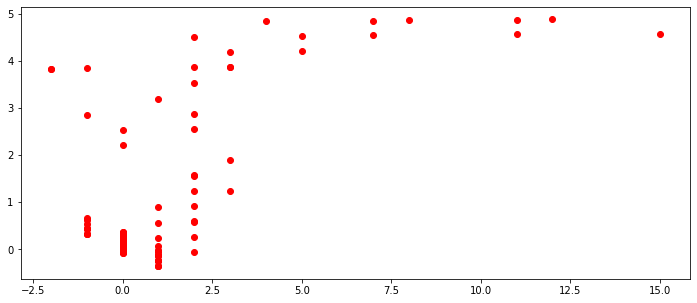

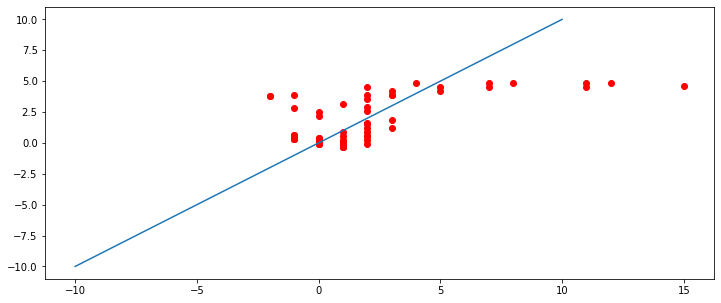

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
125.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp

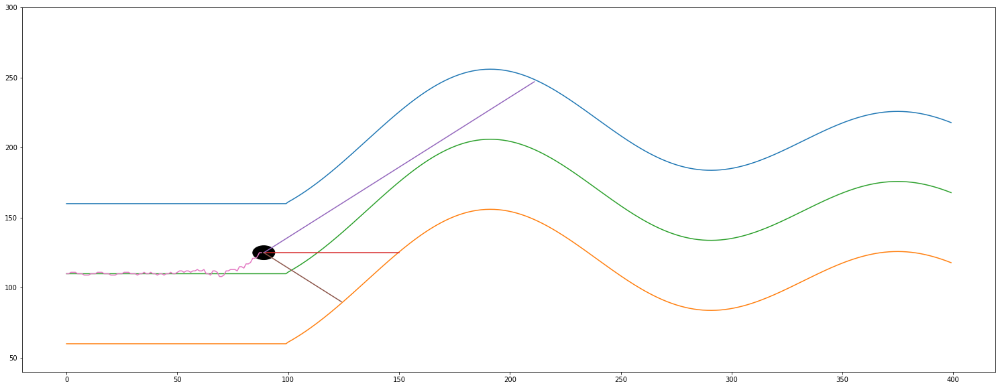

------------------------------ IF i % 3 == 2 ------------------------------
# i =  89
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  61
Sensor from left wall =  124
Sensor from right wall =  36
most távolsagra van a felső faltól =  36.0
most távolsagra van az alsó faltól =  64.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  89
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  14.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  14.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  90
			 len(self.sensor_left)   =  90
			 len(self.sensor_center) =  90
			 len(self.sensor_right)  =  90
			 self.x                  =  89
			 --

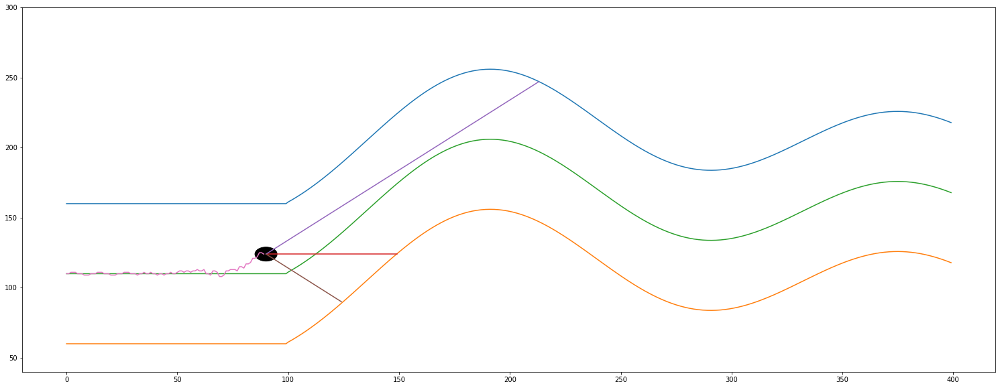

------------------------------ IF i % 3 == 0 ------------------------------
# i =  90
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (91, 3)
y.shape =  (91, 1)
i       =  90
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  90
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(30, 4)
(30, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([110.

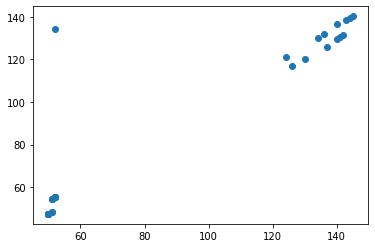

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.9992016  0.86648037]]


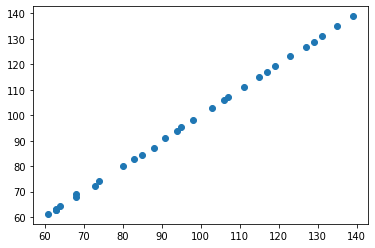

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97187126 0.72676996]]


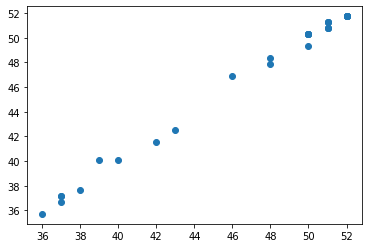

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[1.93679656]]
-------- 1 y up ->  center =  [[2.00875512]]
-------- 1 y up ->  right  =  [[3.14933723]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[124  -3]]
		 _X_center =  [[60 -3]]
		 _X_right  =  [[35 -3]]
		 predicted_left   =  [[129.99592081]]
		 predicted_center =  [[57.49572827]]
		 predicted_right  =  [[33.28588021]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.91112192 -3.9977821 ]]
		 regression_center.coef_ =  [[0.9992016  0.86648037]]
		 regression_right.coef_  =  [[0.9

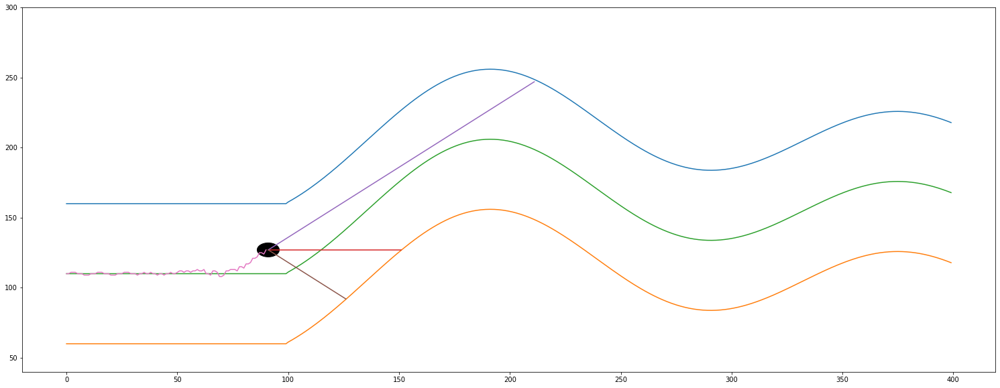

------------------------------ IF i % 3 == 1 ------------------------------
# i =  91
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[121  61  36]]
actual predicted =  [[6.72340609]]
actual self.y_distance[-1] =  17.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0]
len(self.y_distance_real)      =  24
len(self.y_distance_predicted) =  24


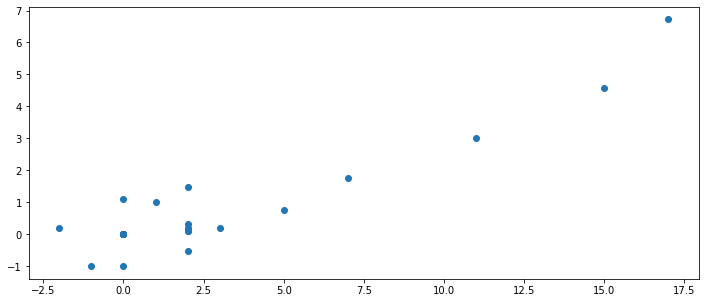

(92, 1)
(92, 1)


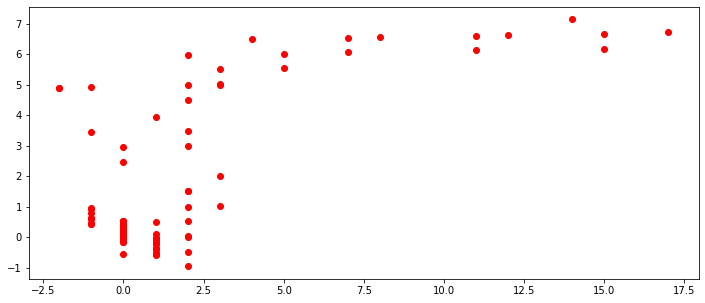

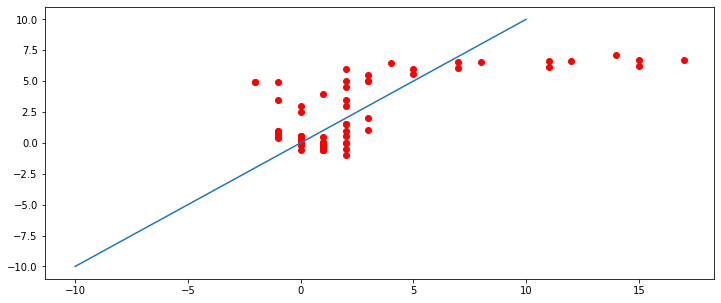

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
127.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         = 

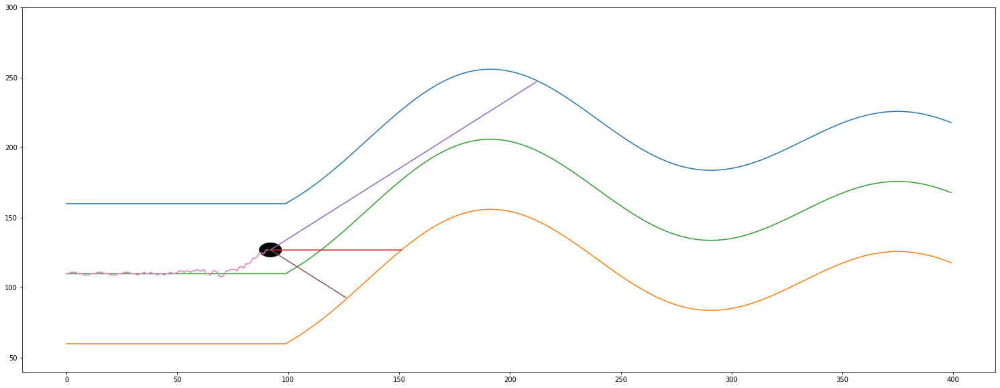

------------------------------ IF i % 3 == 2 ------------------------------
# i =  92
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  60
Sensor from left wall =  122
Sensor from right wall =  35
most távolsagra van a felső faltól =  34.0
most távolsagra van az alsó faltól =  66.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  92
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  16.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  16.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  93
			 len(self.sensor_left)   =  93
			 len(self.sensor_center) =  93
			 len(self.sensor_right)  =  93
			 self.x                  =  92
			 -

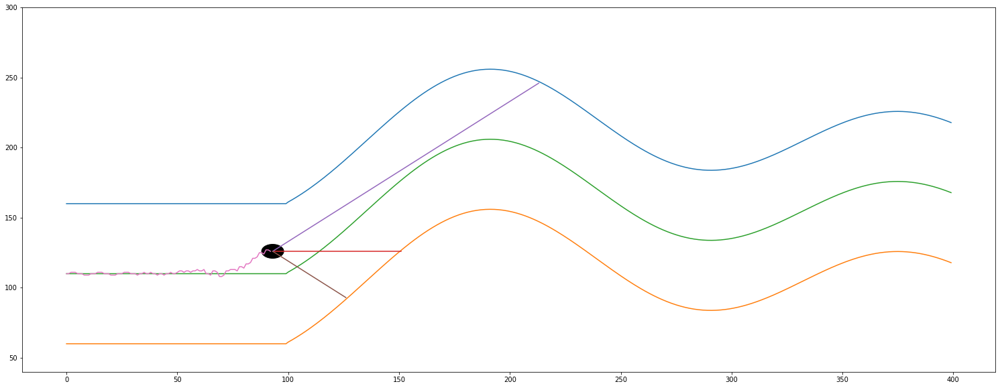

------------------------------ IF i % 3 == 0 ------------------------------
# i =  93
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (94, 3)
y.shape =  (94, 1)
i       =  93
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  93
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(31, 4)
(31, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), array([

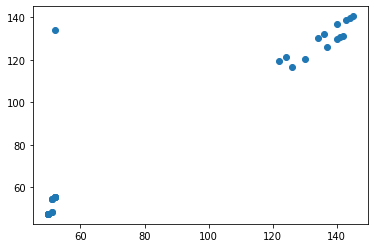

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99784569 0.8435831 ]]


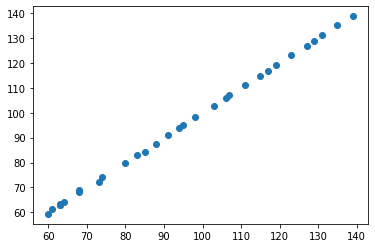

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.96928328 0.71899886]]


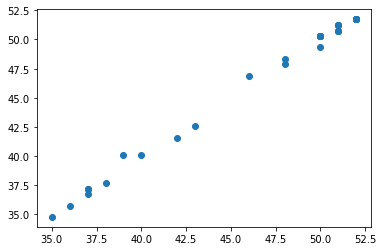

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[1.81562635]]
-------- 1 y up ->  center =  [[2.13684344]]
-------- 1 y up ->  right  =  [[3.26734926]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[121  -3]]
		 _X_center =  [[59 -3]]
		 _X_right  =  [[34 -3]]
		 predicted_left   =  [[127.64027871]]
		 predicted_center =  [[56.63756129]]
		 predicted_right  =  [[32.37770193]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.91245639 -4.08247136]]
		 regression_center.coef_ =  [[0.99784569 0.8435831 ]]
		 regression_right.coef_  =  [[0.9

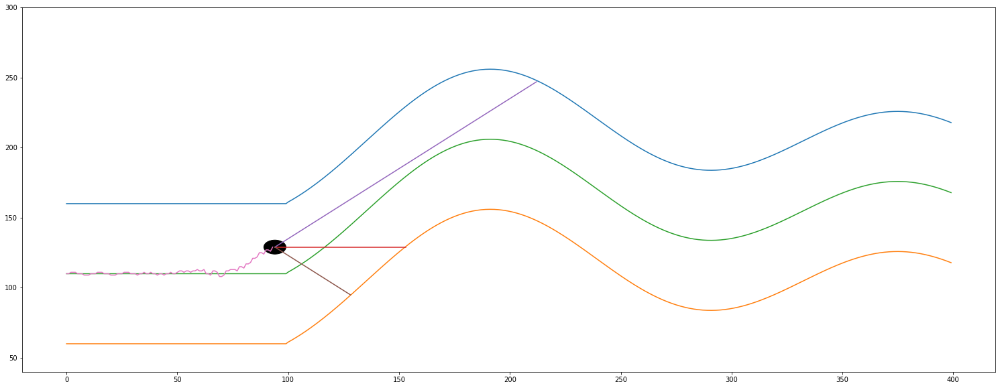

------------------------------ IF i % 3 == 1 ------------------------------
# i =  94
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[119  60  35]]
actual predicted =  [[8.98850234]]
actual self.y_distance[-1] =  19.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0]
len(self.y_distance_real)      =  25
len(self.y_distance_predicted) =  25


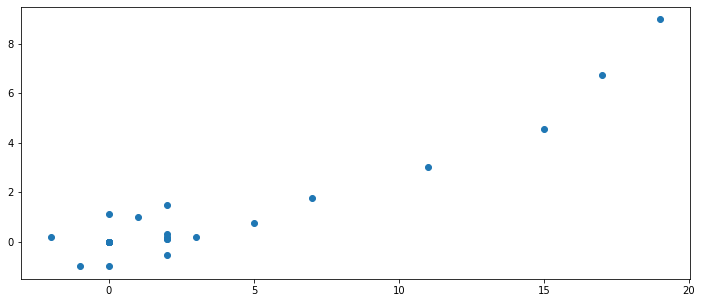

(95, 1)
(95, 1)


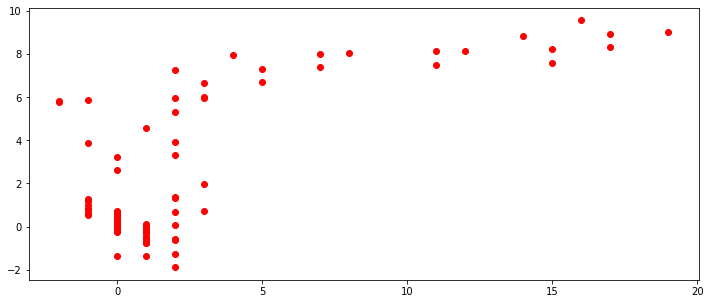

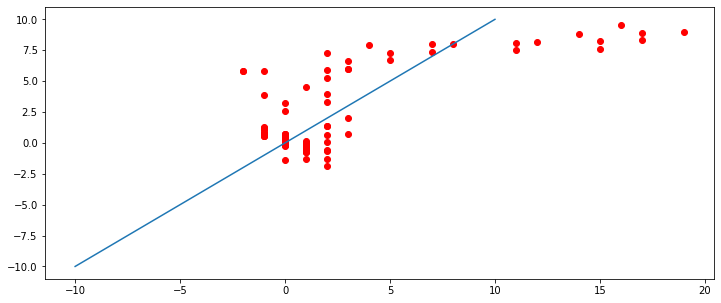

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
129.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0]
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit

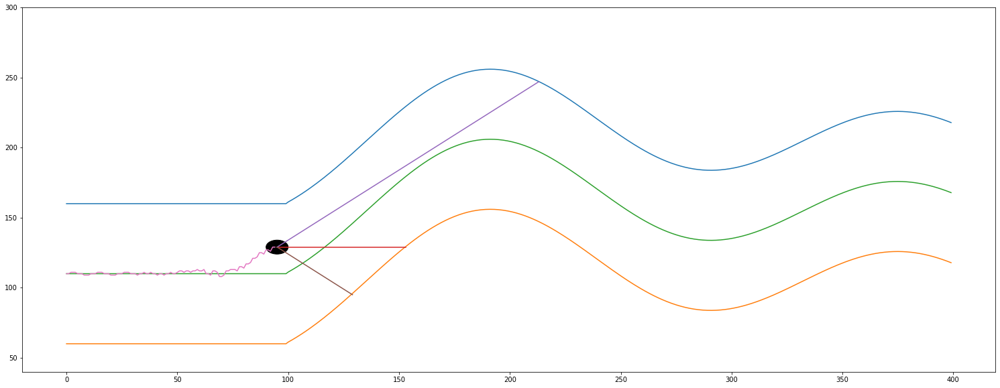

------------------------------ IF i % 3 == 2 ------------------------------
# i =  95
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  60
Sensor from left wall =  118
Sensor from right wall =  35
most távolsagra van a felső faltól =  30.0
most távolsagra van az alsó faltól =  70.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  95
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  20.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  20.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  96
			 len(self.sensor_left)   =  96
			 len(self.sensor_center) =  96
			 len(self.sensor_right)  =  96
			 self.x                  =  95
			 ---

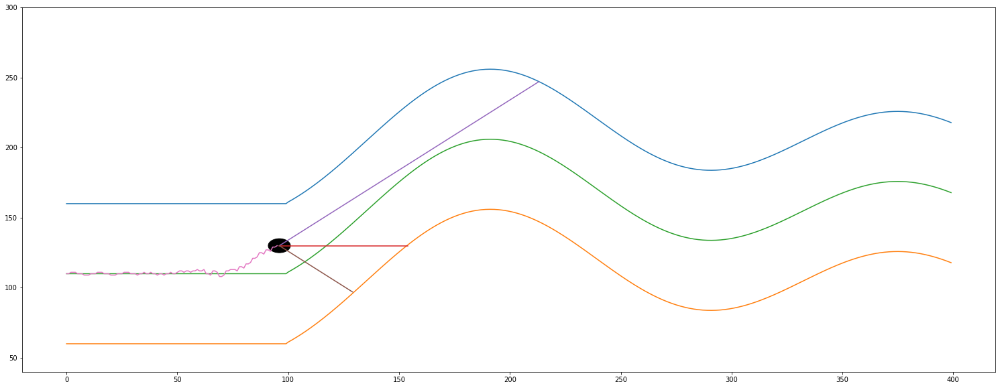

------------------------------ IF i % 3 == 0 ------------------------------
# i =  96
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (97, 3)
y.shape =  (97, 1)
i       =  96
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  96
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(32, 4)
(32, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]), arr

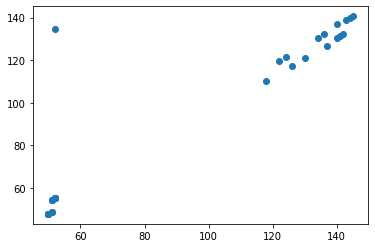

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99786562 0.8432164 ]]


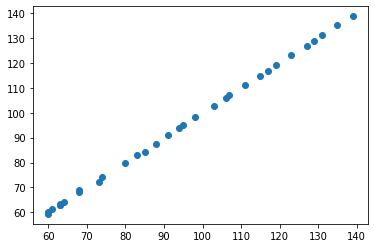

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97979548 0.68308026]]


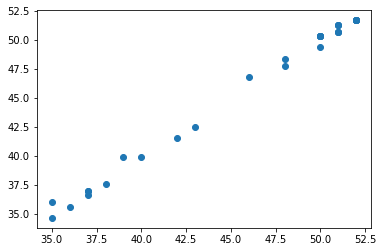

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.00325935]]
-------- 1 y up ->  center =  [[2.13426348]]
-------- 1 y up ->  right  =  [[2.71917762]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[118  -3]]
		 _X_center =  [[59 -3]]
		 _X_right  =  [[34 -3]]
		 predicted_left   =  [[124.46666023]]
		 predicted_center =  [[56.63760362]]
		 predicted_right  =  [[32.32010757]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.91618098 -3.81755656]]
		 regression_center.coef_ =  [[0.99786562 0.8432164 ]]
		 regression_right.coef_  =  [[0.9

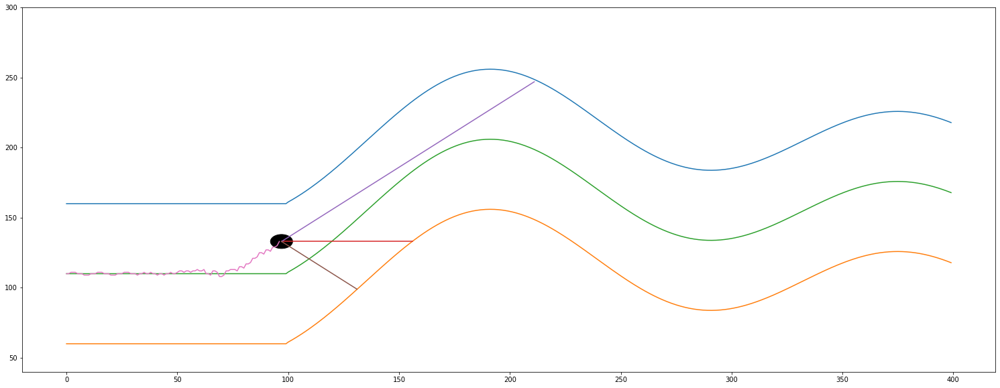

------------------------------ IF i % 3 == 1 ------------------------------
# i =  97
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[115  60  35]]
actual predicted =  [[10.79961417]]
actual self.y_distance[-1] =  23.0
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0]
len(self.y_distance_real)      =  26
len(self.y_distance_predicted) =  26


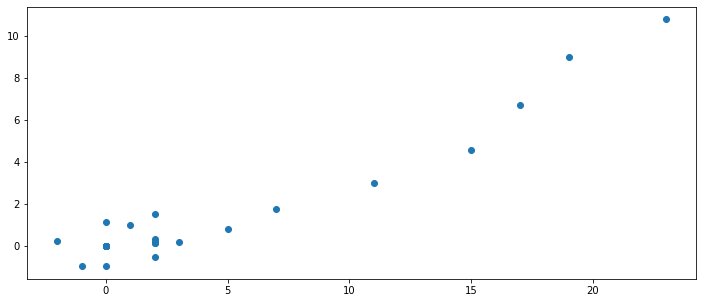

(98, 1)
(98, 1)


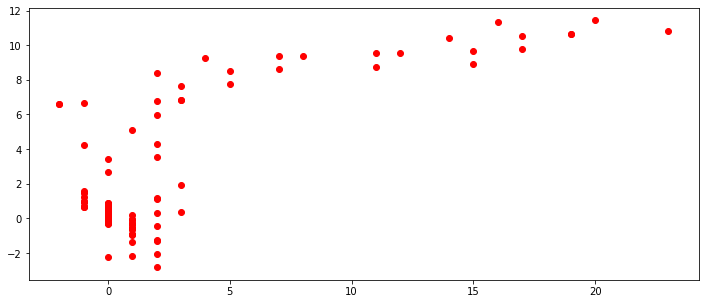

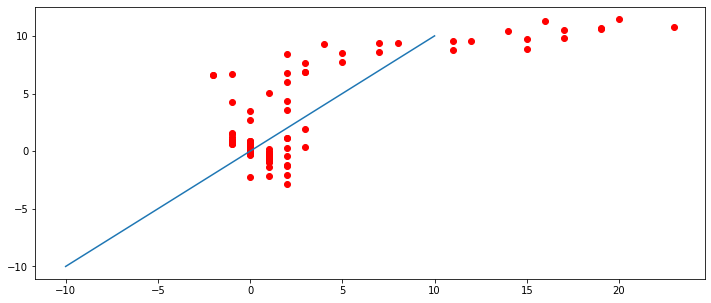

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
133.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0]
# 		 ----------------- Summary -----------------
#

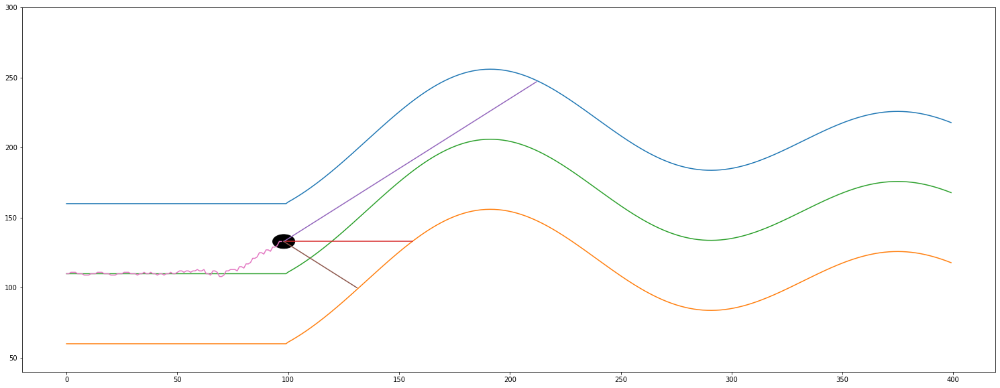

------------------------------ IF i % 3 == 2 ------------------------------
# i =  98
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  60
Sensor from left wall =  114
Sensor from right wall =  35
most távolsagra van a felső faltól =  26.0
most távolsagra van az alsó faltól =  74.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  98
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  24.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  24.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  99
			 len(self.sensor_left)   =  99
			 len(self.sensor_center) =  99
			 len(self.sensor_right)  =  99
			 self.x                  =  98
			 ----

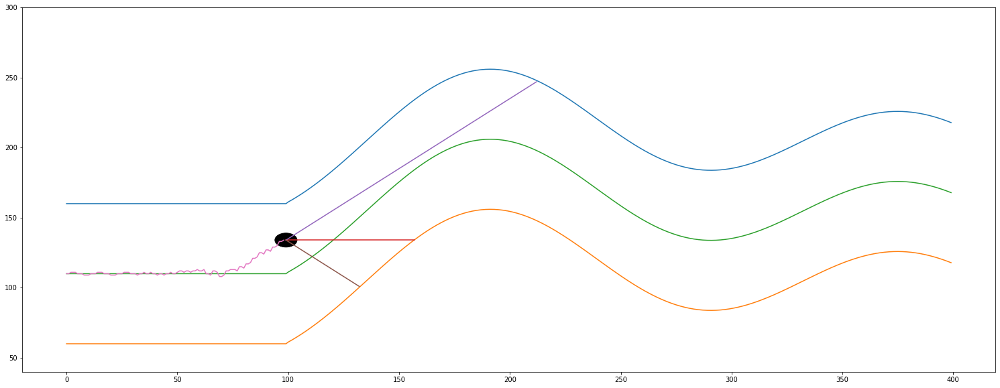

------------------------------ IF i % 3 == 0 ------------------------------
# i =  99
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (100, 3)
y.shape =  (100, 1)
i       =  99
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  99
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(33, 4)
(33, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.,  52.]

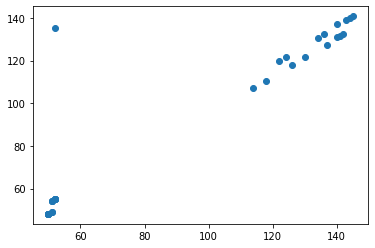

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99788128 0.84292815]]


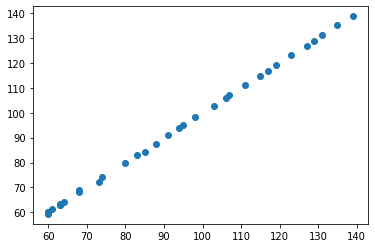

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.98021466 0.68177634]]


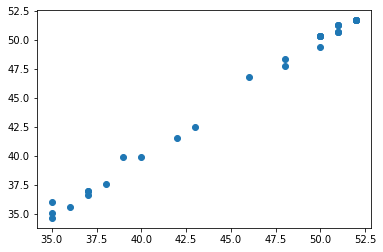

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.20351446]]
-------- 1 y up ->  center =  [[2.1322354]]
-------- 1 y up ->  right  =  [[2.69757595]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[114  -3]]
		 _X_center =  [[59 -3]]
		 _X_right  =  [[34 -3]]
		 predicted_left   =  [[120.41758154]]
		 predicted_center =  [[56.6376369]]
		 predicted_right  =  [[32.31755433]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.9187831  -3.59789432]]
		 regression_center.coef_ =  [[0.99788128 0.84292815]]
		 regression_right.coef_  =  [[0.980

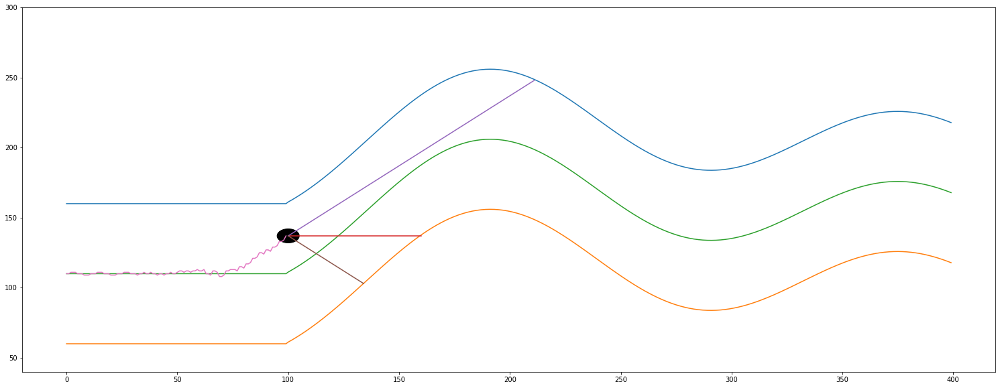

------------------------------ IF i % 3 == 1 ------------------------------
# i =  100
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[112  61  35]]
actual predicted =  [[12.7261195]]
actual self.y_distance[-1] =  25.818148516678605
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605]
len(self.y_distance_real)      =  27
len(self.y_distance_predicted) =  27


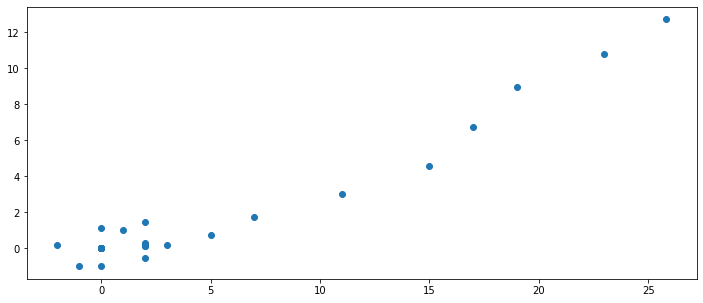

(101, 1)
(101, 1)


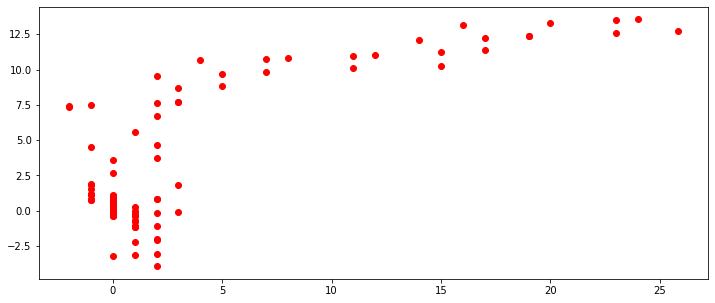

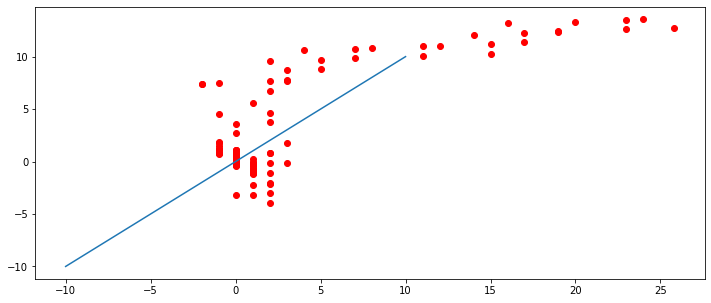

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
137.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0]
# 		 ----------------- Summar

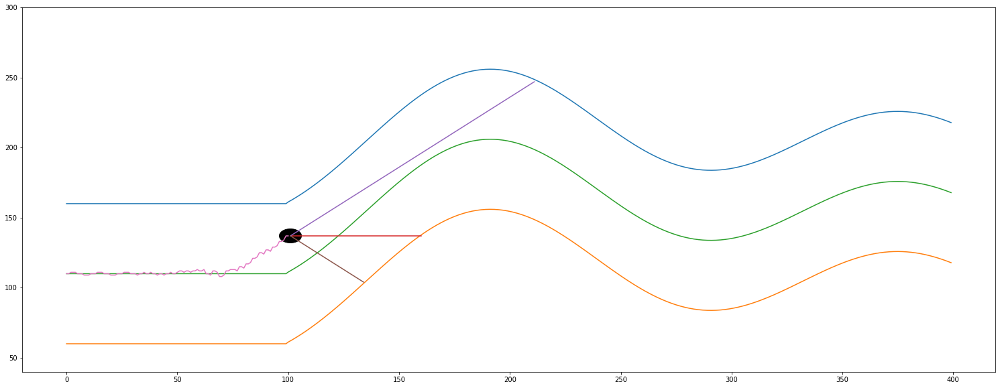

------------------------------ IF i % 3 == 2 ------------------------------
# i =  101
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  59
Sensor from left wall =  112
Sensor from right wall =  34
most távolsagra van a felső faltól =  26.073810289961955
most távolsagra van az alsó faltól =  73.92618971003806
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  101
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  23.926189710038045
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  23.926189710038045
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  102
			 len(self.sensor_left)   =  102
			 len(self.sensor_center) =  102
			 len(self.s

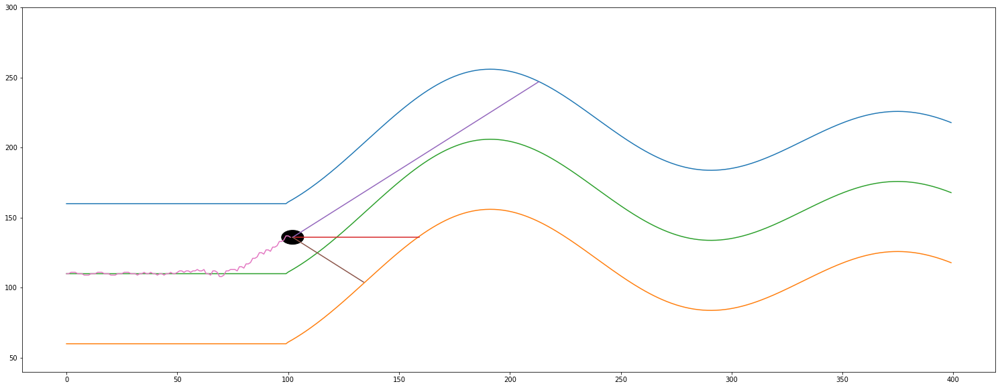

------------------------------ IF i % 3 == 0 ------------------------------
# i =  102
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (103, 3)
y.shape =  (103, 1)
i       =  102
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  102
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(34, 4)
(34, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 112.

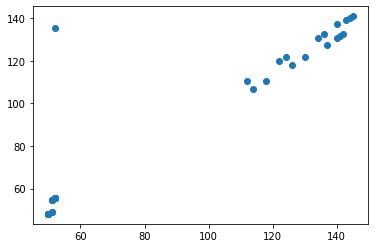

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99833258 0.8524998 ]]


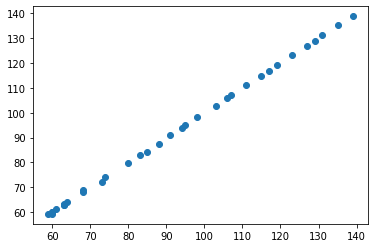

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97781596 0.67190329]]


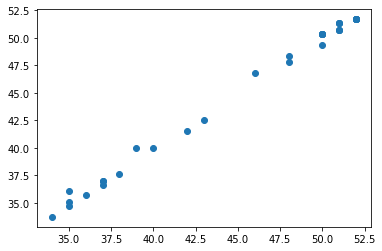

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.16193875]]
-------- 1 y up ->  center =  [[2.09153872]]
-------- 1 y up ->  right  =  [[2.80354199]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[112  -3]]
		 _X_center =  [[58 -3]]
		 _X_right  =  [[33 -3]]
		 predicted_left   =  [[118.76892392]]
		 predicted_center =  [[55.58649645]]
		 predicted_right  =  [[31.40603958]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.9192265  -3.64321091]]
		 regression_center.coef_ =  [[0.99833258 0.8524998 ]]
		 regression_right.coef_  =  [[0.9

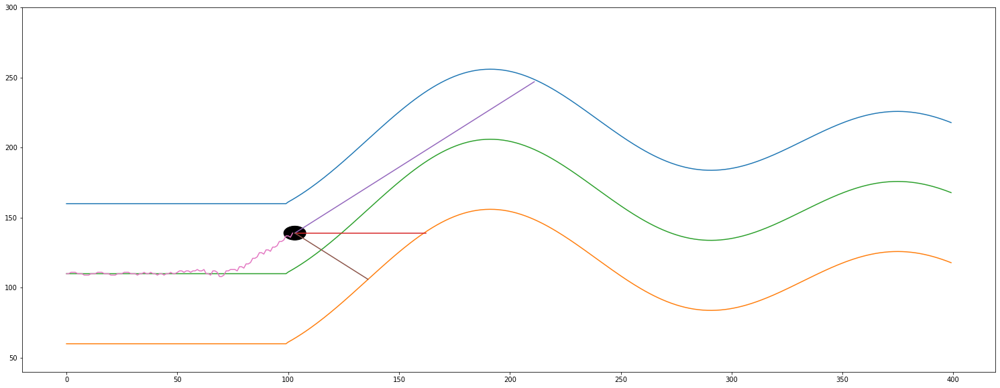

------------------------------ IF i % 3 == 1 ------------------------------
# i =  103
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[109  60  34]]
actual predicted =  [[15.42819769]]
actual self.y_distance[-1] =  25.06326743730733
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733]
len(self.y_dista

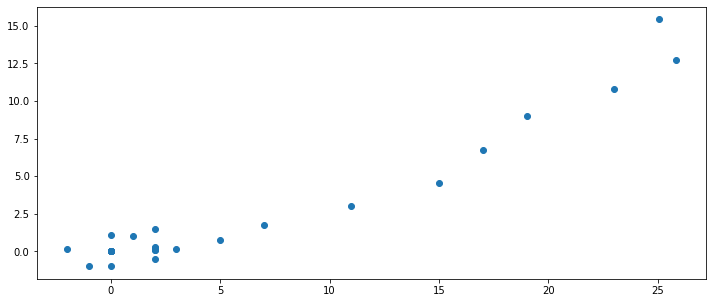

(104, 1)
(104, 1)


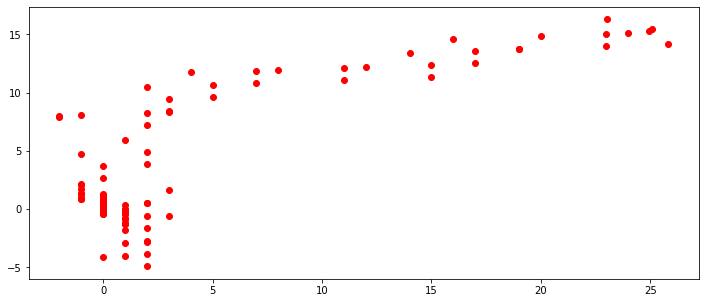

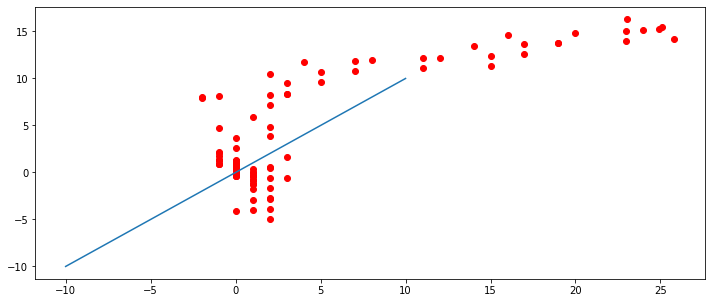

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
139.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0]
# 		 ---

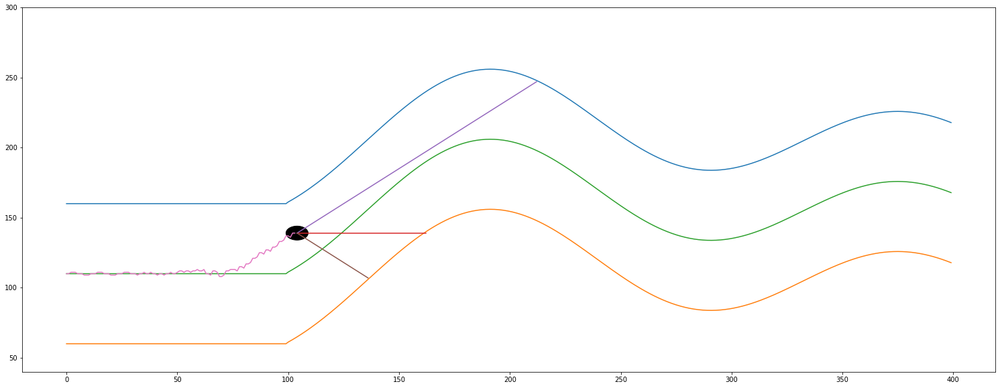

------------------------------ IF i % 3 == 2 ------------------------------
# i =  104
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  58
Sensor from left wall =  110
Sensor from right wall =  33
most távolsagra van a felső faltól =  26.90706152640314
most távolsagra van az alsó faltól =  73.09293847359686
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  104
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  23.09293847359686
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  23.09293847359686
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  105
			 len(self.sensor_left)   =  105
			 len(self.sensor_center) =  105
			 len(self.sen

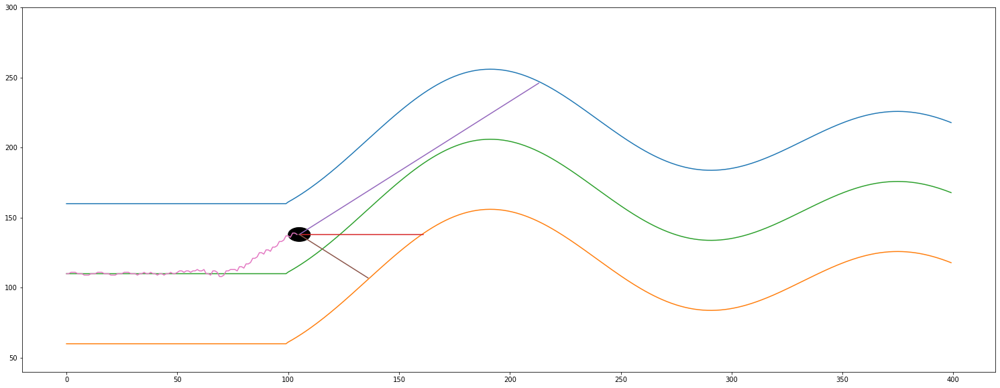

------------------------------ IF i % 3 == 0 ------------------------------
# i =  105
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (106, 3)
y.shape =  (106, 1)
i       =  105
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  105
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(35, 4)
(35, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  50., 

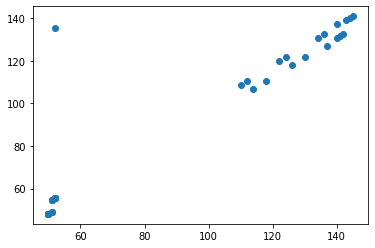

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99871211 0.86030626]]


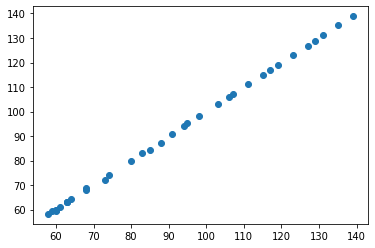

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97605643 0.66520757]]


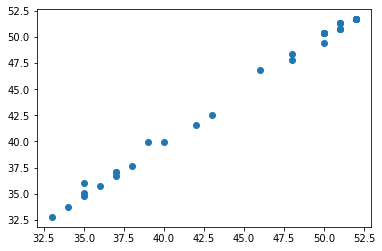

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.13323932]]
-------- 1 y up ->  center =  [[2.05731391]]
-------- 1 y up ->  right  =  [[2.88127204]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[109  -3]]
		 _X_center =  [[57 -3]]
		 _X_right  =  [[32 -3]]
		 predicted_left   =  [[116.15727992]]
		 predicted_center =  [[54.543967]]
		 predicted_right  =  [[30.47819093]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.91953258 -3.67863051]]
		 regression_center.coef_ =  [[0.99871211 0.86030626]]
		 regression_right.coef_  =  [[0.976

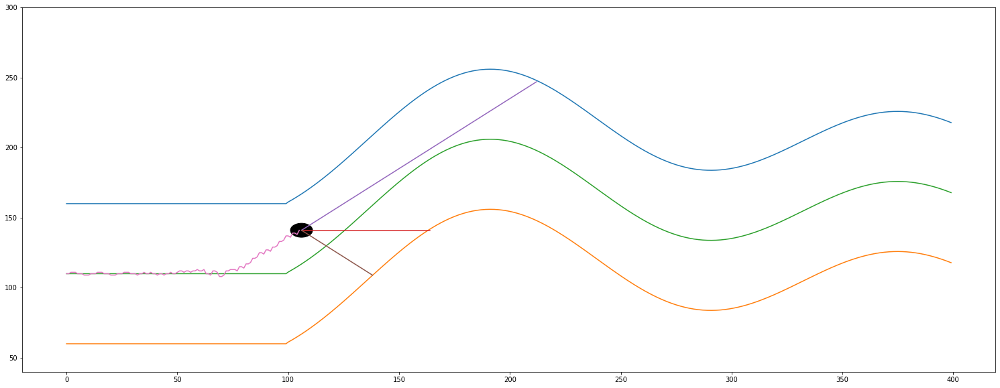

------------------------------ IF i % 3 == 1 ------------------------------
# i =  106
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[107  59  33]]
actual predicted =  [[17.69848873]]
actual self.y_distance[-1] =  24.07639228755039
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735968

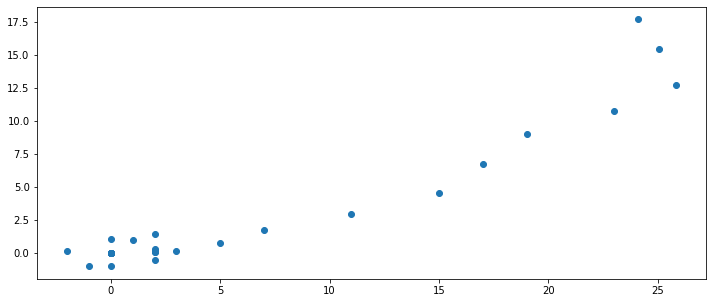

(107, 1)
(107, 1)


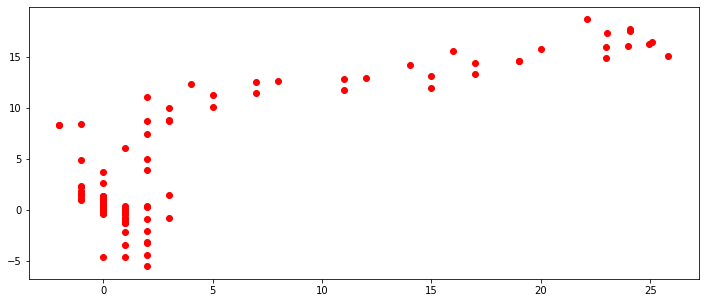

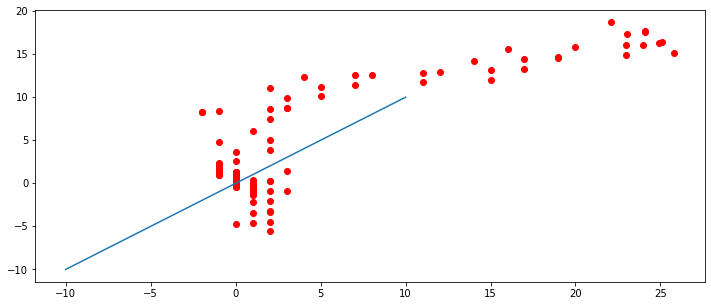

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
141.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

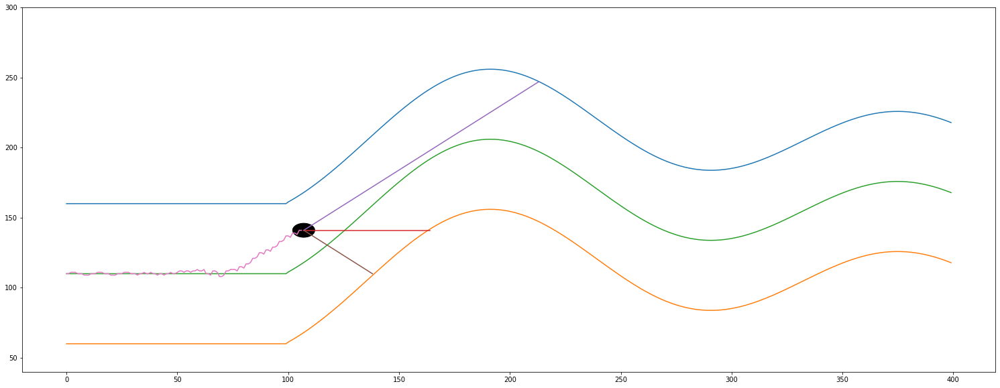

------------------------------ IF i % 3 == 2 ------------------------------
# i =  107
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  59
Sensor from left wall =  106
Sensor from right wall =  33
most távolsagra van a felső faltól =  25.968983108538055
most távolsagra van az alsó faltól =  74.03101689146195
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  107
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  24.031016891461945
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  24.031016891461945
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  108
			 len(self.sensor_left)   =  108
			 len(self.sensor_center) =  108
			 len(self.se

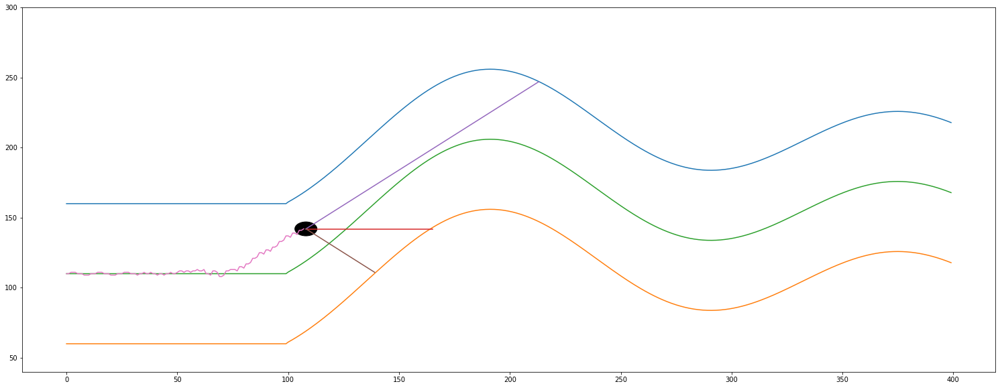

------------------------------ IF i % 3 == 0 ------------------------------
# i =  108
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (109, 3)
y.shape =  (109, 1)
i       =  108
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  108
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(36, 4)
(36, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111.,  5

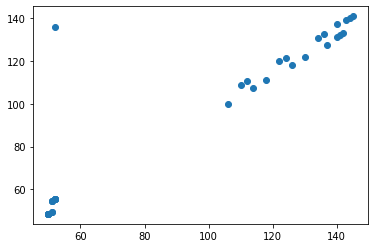

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99869163 0.86074768]]


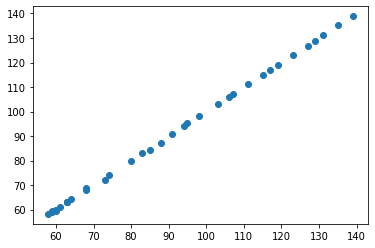

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97698945 0.66155321]]


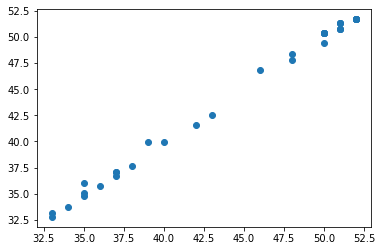

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.37105742]]
-------- 1 y up ->  center =  [[2.06001704]]
-------- 1 y up ->  right  =  [[2.83301374]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[106  -3]]
		 _X_center =  [[58 -3]]
		 _X_right  =  [[32 -3]]
		 predicted_left   =  [[113.05812702]]
		 predicted_center =  [[55.54244931]]
		 predicted_right  =  [[30.47347395]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92077704 -3.50137012]]
		 regression_center.coef_ =  [[0.99869163 0.86074768]]
		 regression_right.coef_  =  [[0.9

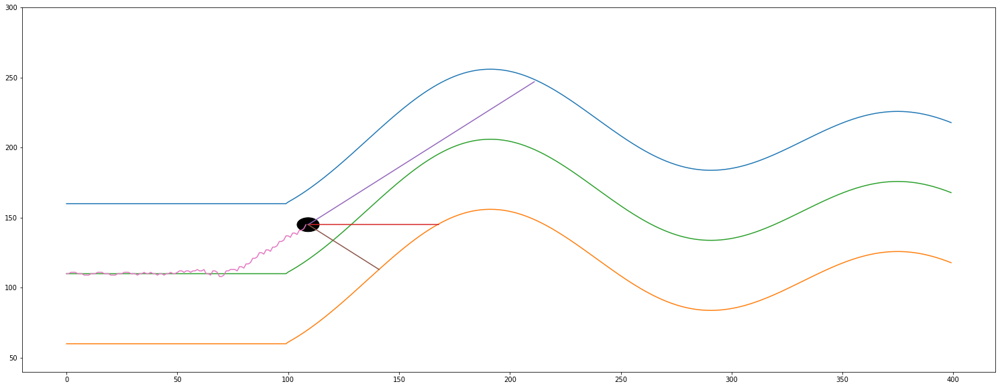

------------------------------ IF i % 3 == 1 ------------------------------
# i =  109
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[103  60  33]]
actual predicted =  [[18.66807342]]
actual self.y_distance[-1] =  24.868417992882485
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

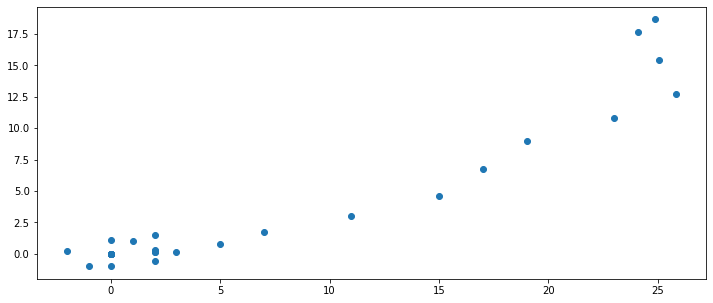

(110, 1)
(110, 1)


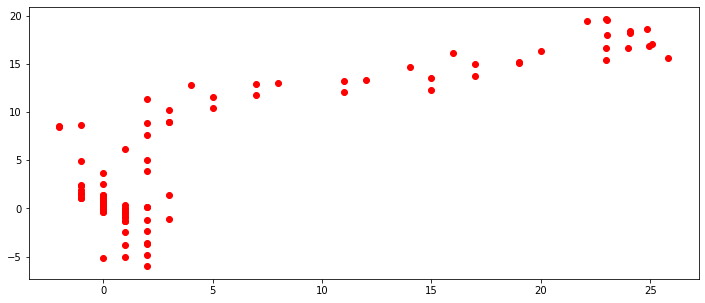

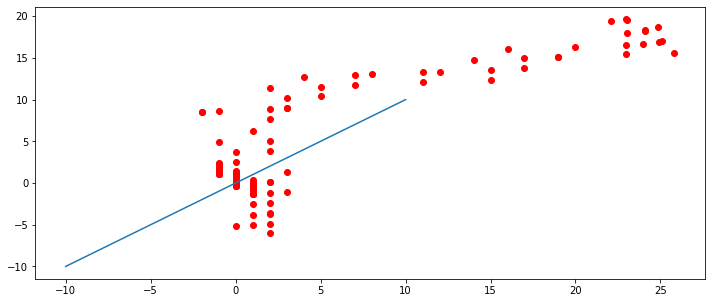

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
145.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

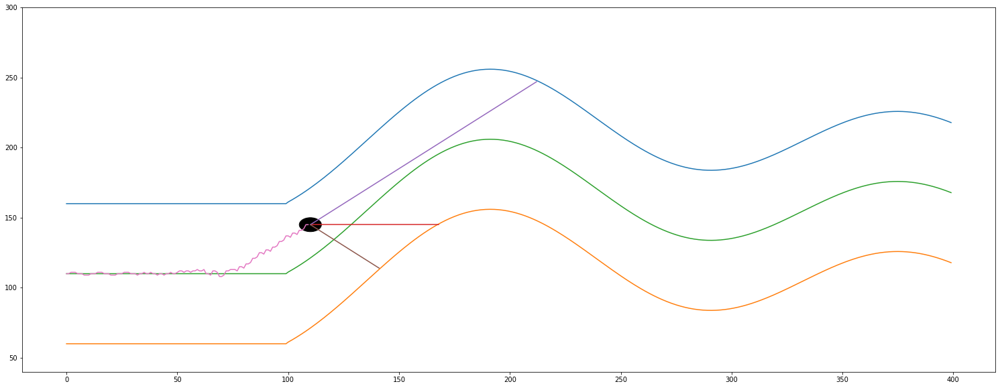

------------------------------ IF i % 3 == 2 ------------------------------
# i =  110
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  60
Sensor from left wall =  102
Sensor from right wall =  33
most távolsagra van a felső faltól =  25.247764208329443
most távolsagra van az alsó faltól =  74.75223579167057
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  110
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  24.752235791670557
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  24.752235791670557
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  111
			 len(self.sensor_left)   =  111
			 len(self.sensor_center) =  111
			 len(self.sen

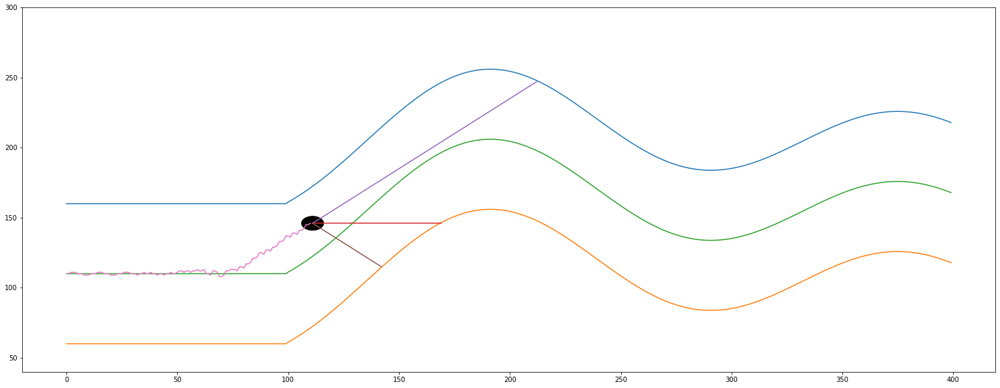

------------------------------ IF i % 3 == 0 ------------------------------
# i =  111
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (112, 3)
y.shape =  (112, 1)
i       =  111
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  111
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1.]
(37, 4)
(37, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array([111

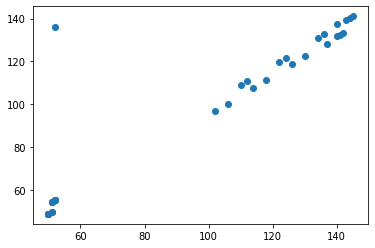

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99867375 0.86114602]]


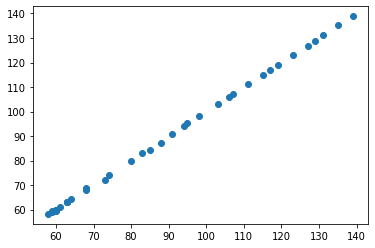

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97769465 0.65879121]]


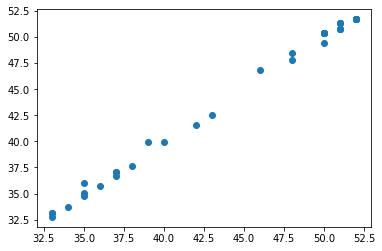

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.60636468]]
-------- 1 y up ->  center =  [[2.06240333]]
-------- 1 y up ->  right  =  [[2.79653963]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[102  -3]]
		 _X_center =  [[59 -3]]
		 _X_right  =  [[32 -3]]
		 predicted_left   =  [[109.08020602]]
		 predicted_center =  [[56.54089663]]
		 predicted_right  =  [[30.46990881]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92146452 -3.35148112]]
		 regression_center.coef_ =  [[0.99867375 0.86114602]]
		 regression_right.coef_  =  [[0.9

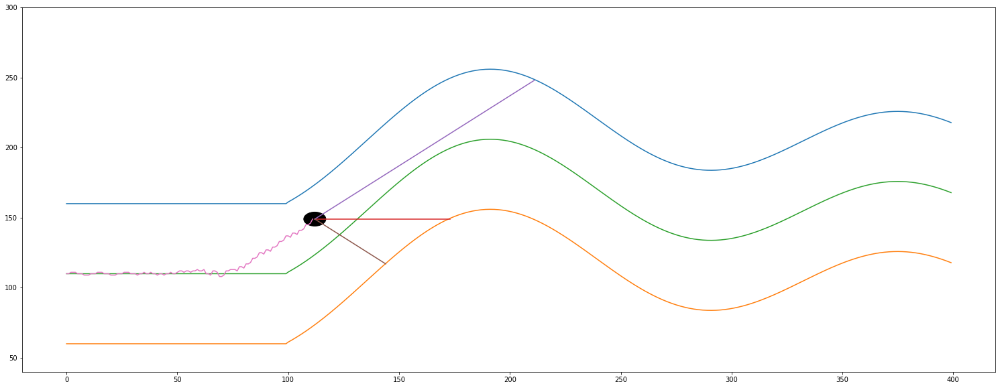

------------------------------ IF i % 3 == 1 ------------------------------
# i =  112
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[100  62  33]]
actual predicted =  [[19.43903556]]
actual self.y_distance[-1] =  25.45294930146352
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735968

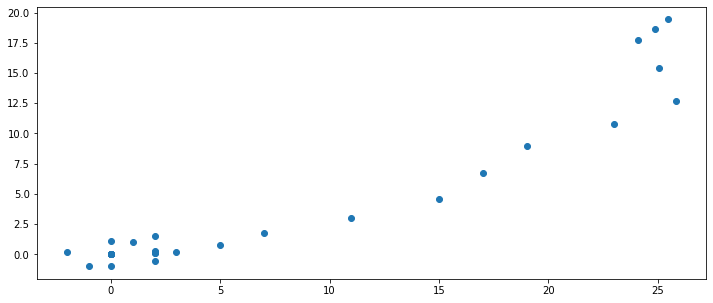

(113, 1)
(113, 1)


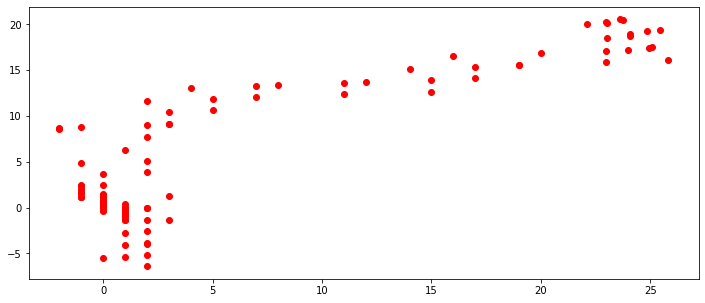

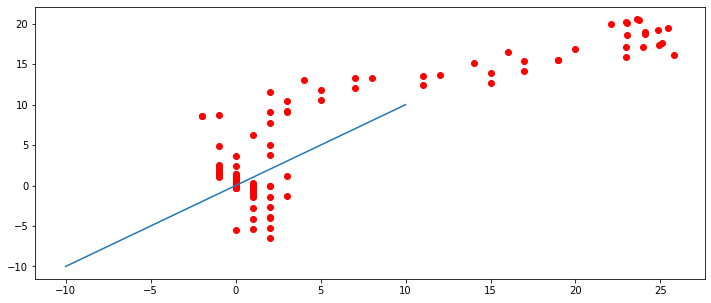

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
149.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

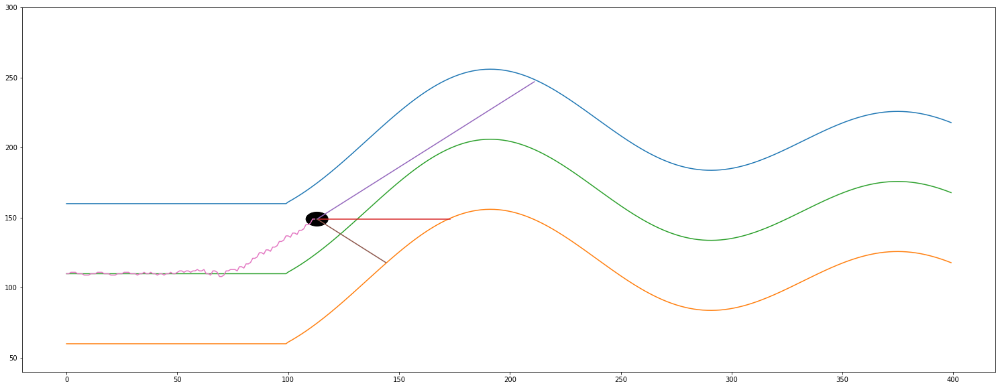

------------------------------ IF i % 3 == 2 ------------------------------
# i =  113
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  60
Sensor from left wall =  100
Sensor from right wall =  32
most távolsagra van a felső faltól =  26.728924091668205
most távolsagra van az alsó faltól =  73.2710759083318
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  113
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  23.271075908331795
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  23.271075908331795
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  114
			 len(self.sensor_left)   =  114
			 len(self.sensor_center) =  114
			 len(self.se

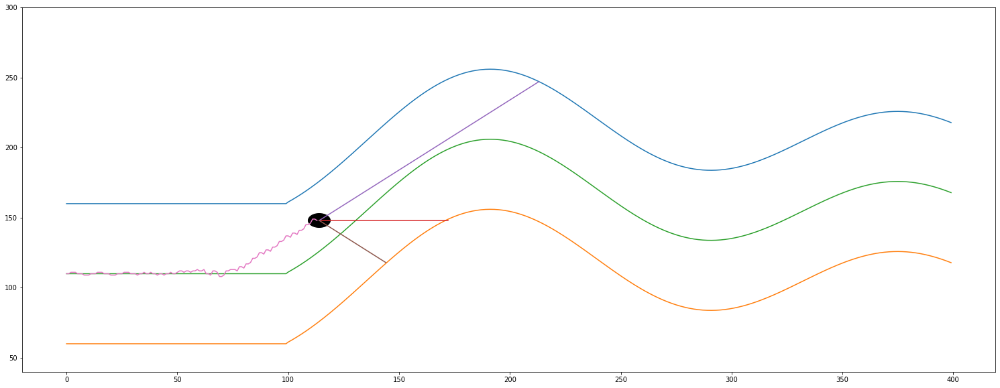

------------------------------ IF i % 3 == 0 ------------------------------
# i =  114
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (115, 3)
y.shape =  (115, 1)
i       =  114
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  114
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1.]
(38, 4)
(38, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), array(

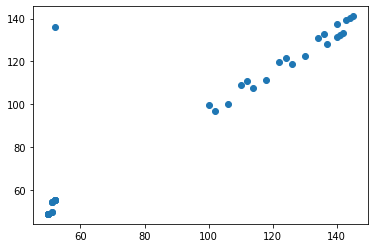

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99894497 0.86808789]]


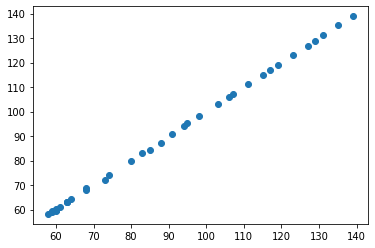

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97649239 0.65294577]]


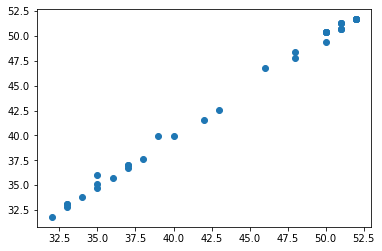

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.60389476]]
-------- 1 y up ->  center =  [[2.03887837]]
-------- 1 y up ->  right  =  [[2.84798345]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[100  -3]]
		 _X_center =  [[59 -3]]
		 _X_right  =  [[31 -3]]
		 predicted_left   =  [[107.27818173]]
		 predicted_center =  [[56.5053351]]
		 predicted_right  =  [[29.53097213]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92149057 -3.36168024]]
		 regression_center.coef_ =  [[0.99894497 0.86808789]]
		 regression_right.coef_  =  [[0.97

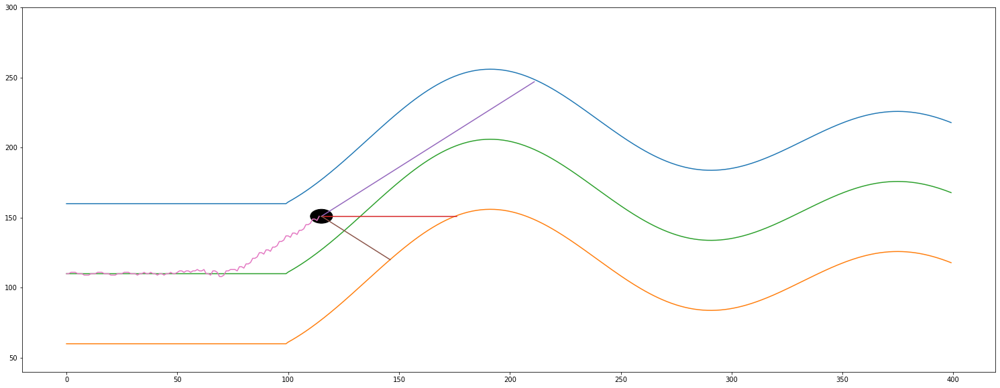

------------------------------ IF i % 3 == 1 ------------------------------
# i =  115
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[97 62 32]]
actual predicted =  [[21.27886997]]
actual self.y_distance[-1] =  23.84617200900857
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359686, 

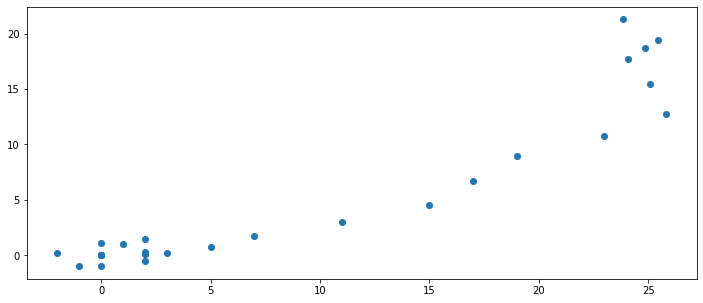

(116, 1)
(116, 1)


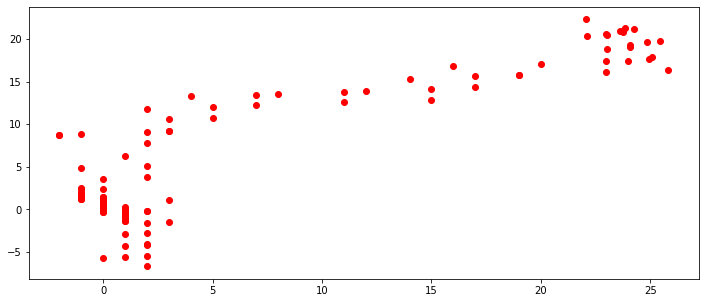

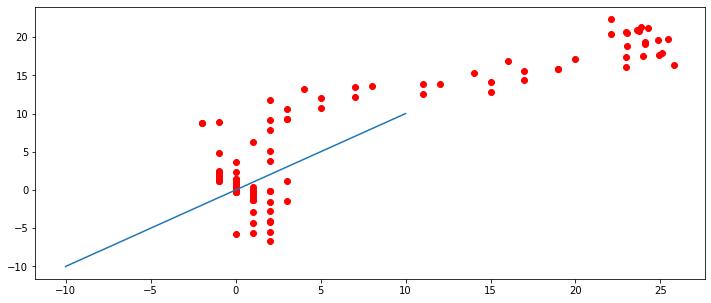

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
151.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

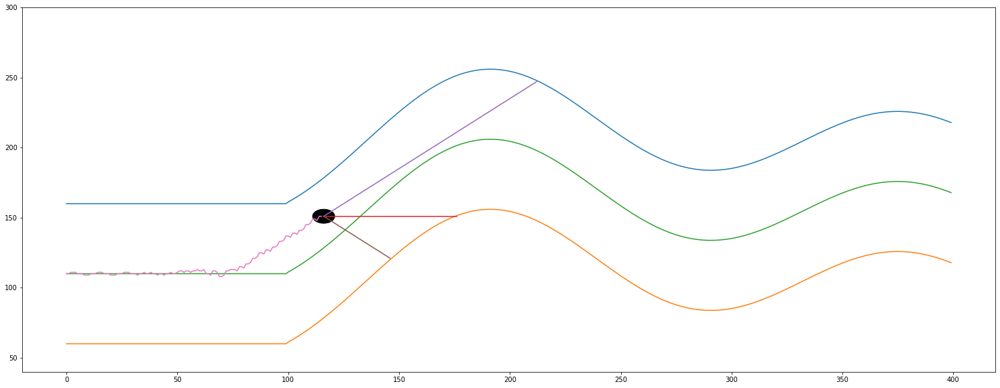

------------------------------ IF i % 3 == 2 ------------------------------
# i =  116
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  60
Sensor from left wall =  98
Sensor from right wall =  31
most távolsagra van a felső faltól =  28.39544982058476
most távolsagra van az alsó faltól =  71.60455017941524
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  116
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  21.60455017941524
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  21.60455017941524
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  117
			 len(self.sensor_left)   =  117
			 len(self.sensor_center) =  117
			 len(self.sens

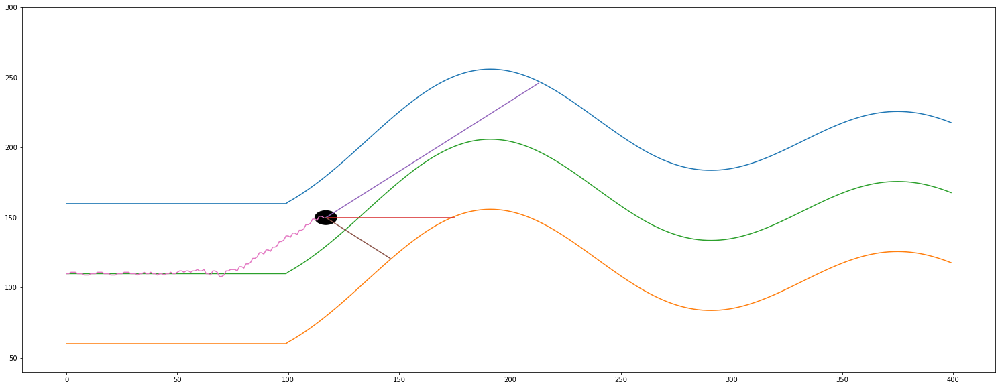

------------------------------ IF i % 3 == 0 ------------------------------
# i =  117
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (118, 3)
y.shape =  (118, 1)
i       =  117
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  117
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.]
(39, 4)
(39, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.]), ar

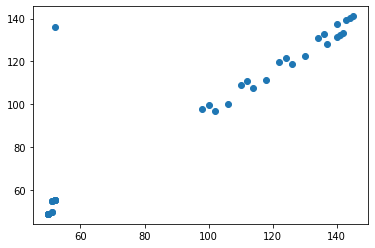

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99917549 0.87398798]]


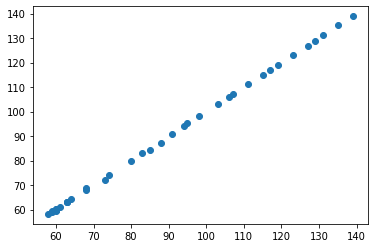

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97561147 0.64897284]]


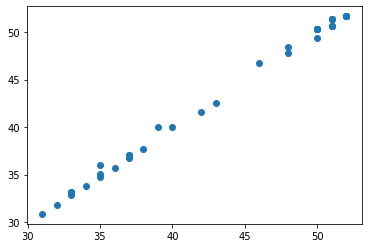

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.60325948]]
-------- 1 y up ->  center =  [[2.01888381]]
-------- 1 y up ->  right  =  [[2.8856777]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[97 -3]]
		 _X_center =  [[59 -3]]
		 _X_right  =  [[30 -3]]
		 predicted_left   =  [[104.53469277]]
		 predicted_center =  [[56.47511032]]
		 predicted_right  =  [[28.58251893]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92149726 -3.36692398]]
		 regression_center.coef_ =  [[0.99917549 0.87398798]]
		 regression_right.coef_  =  [[0.9756

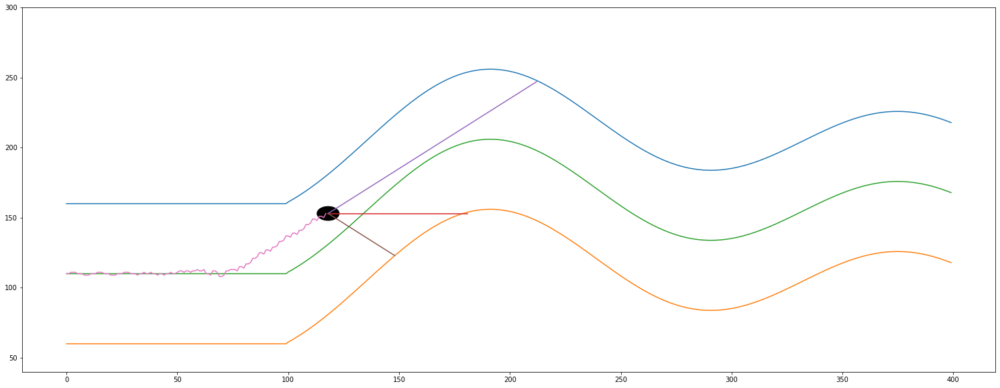

------------------------------ IF i % 3 == 1 ------------------------------
# i =  118
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[95 64 31]]
actual predicted =  [[22.52384335]]
actual self.y_distance[-1] =  22.06669786887022
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359686, 

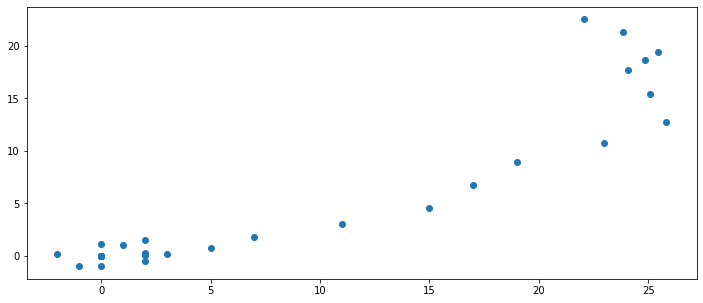

(119, 1)
(119, 1)


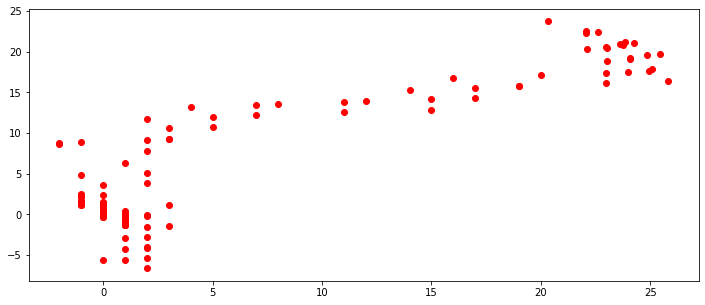

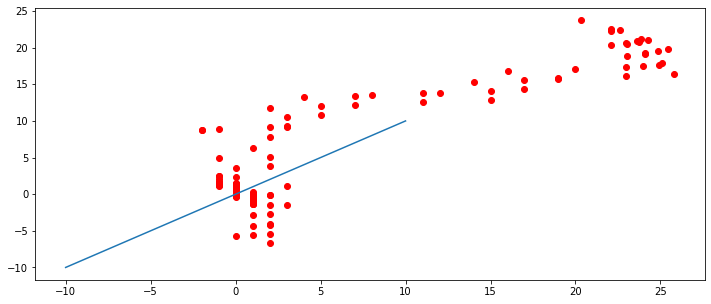

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
153.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

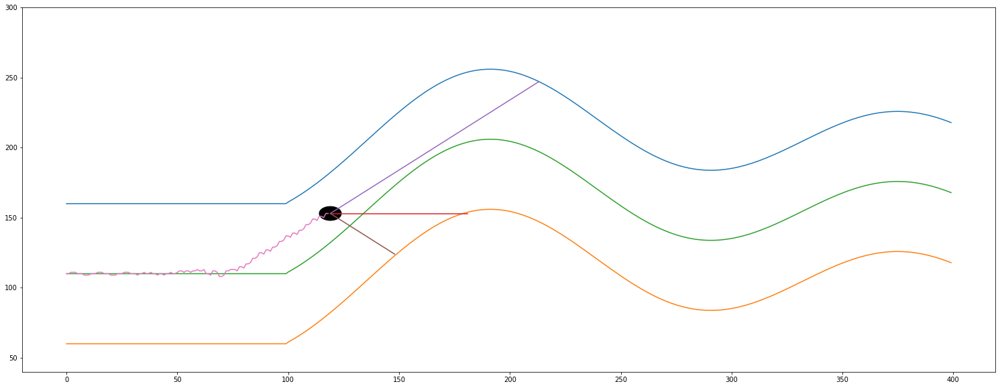

------------------------------ IF i % 3 == 2 ------------------------------
# i =  119
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  66
Sensor from left wall =  94
Sensor from right wall =  31
most távolsagra van a felső faltól =  28.227959784430993
most távolsagra van az alsó faltól =  71.772040215569
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  119
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  21.772040215569007
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  21.772040215569007
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  120
			 len(self.sensor_left)   =  120
			 len(self.sensor_center) =  120
			 len(self.senso

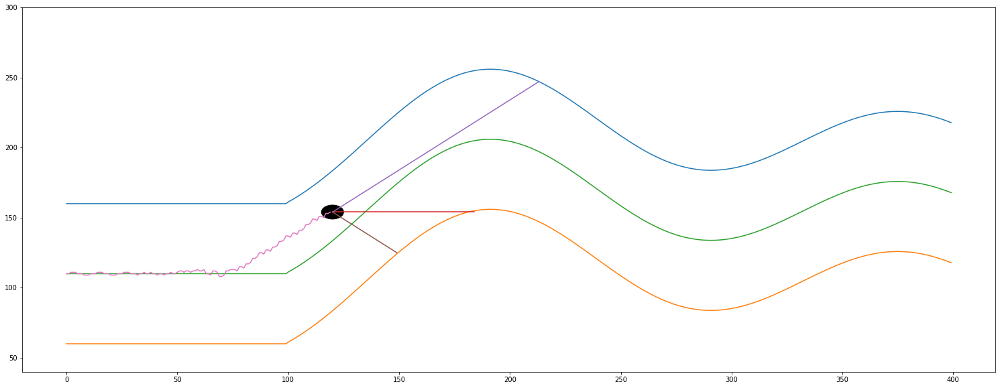

------------------------------ IF i % 3 == 0 ------------------------------
# i =  120
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (121, 3)
y.shape =  (121, 1)
i       =  120
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  120
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.]
(40, 4)
(40, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  51.])

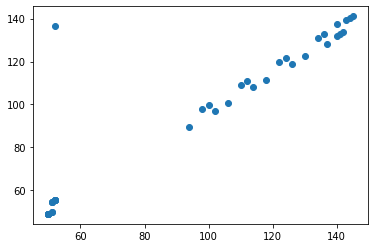

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99744408 0.92436102]]


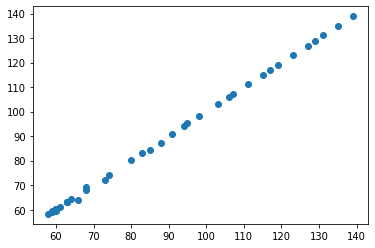

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97654457 0.64472253]]


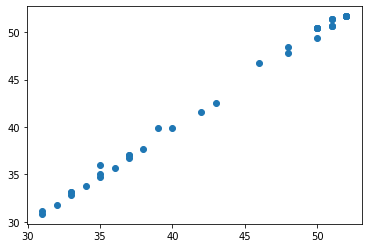

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.84815013]]
-------- 1 y up ->  center =  [[2.26853134]]
-------- 1 y up ->  right  =  [[2.8374738]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[94 -3]]
		 _X_center =  [[65 -3]]
		 _X_right  =  [[30 -3]]
		 predicted_left   =  [[101.53142679]]
		 predicted_center =  [[62.40750825]]
		 predicted_right  =  [[28.57837609]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92143302 -3.24750156]]
		 regression_center.coef_ =  [[0.99744408 0.92436102]]
		 regression_right.coef_  =  [[0.9765

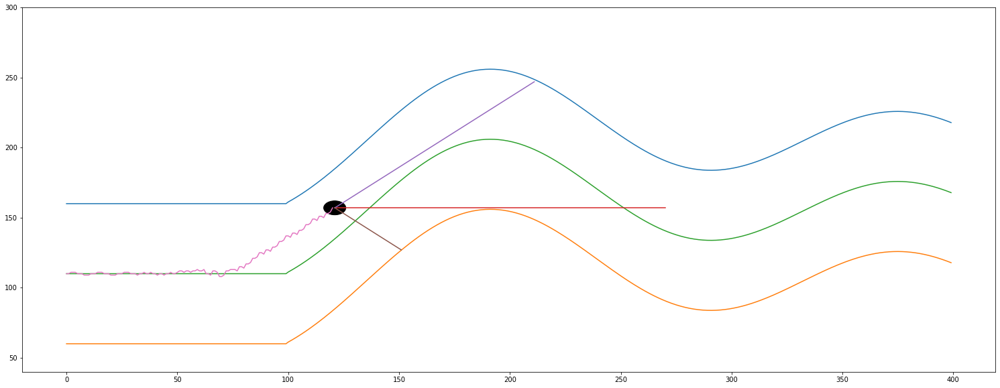

------------------------------ IF i % 3 == 1 ------------------------------
# i =  121
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 91 150  31]]
actual predicted =  [[18.94481145]]
actual self.y_distance[-1] =  22.135384730491353
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

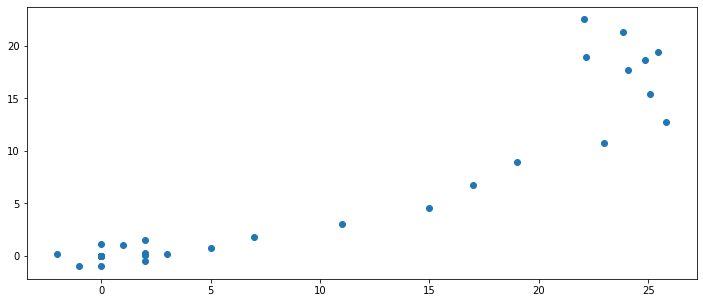

(122, 1)
(122, 1)


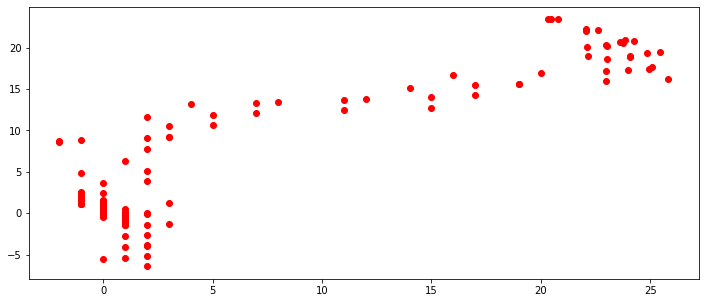

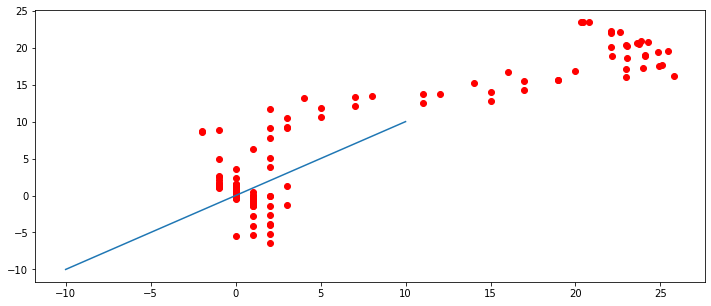

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
157.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

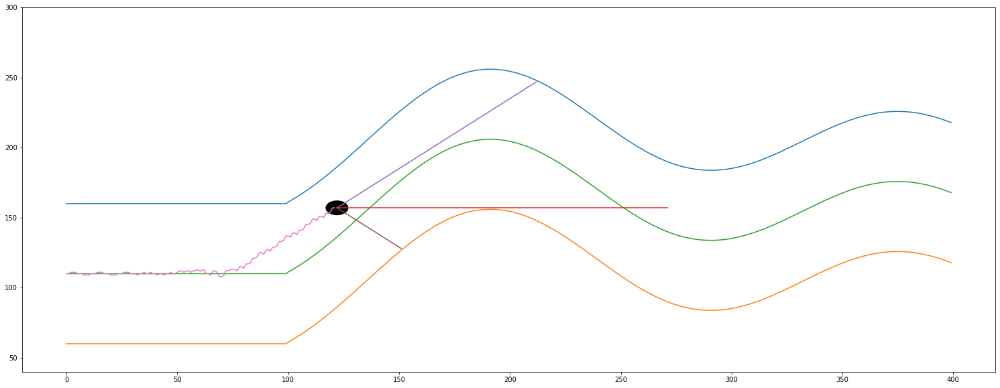

------------------------------ IF i % 3 == 2 ------------------------------
# i =  122
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor from left wall =  90
Sensor from right wall =  31
most távolsagra van a felső faltól =  28.20489143234215
most távolsagra van az alsó faltól =  71.79510856765786
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  122
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  21.79510856765785
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  21.79510856765785
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  123
			 len(self.sensor_left)   =  123
			 len(self.sensor_center) =  123
			 len(self.sensor_right)  =  123
			 s

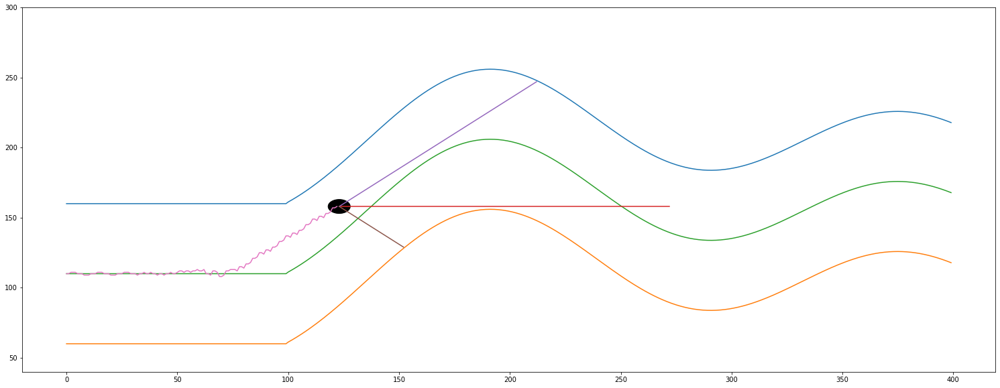

------------------------------ IF i % 3 == 0 ------------------------------
# i =  123
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (124, 3)
y.shape =  (124, 1)
i       =  123
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  123
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1.]
(41, 4)
(41, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.,  5

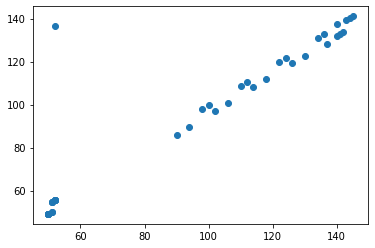

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99573564 0.90538122]]


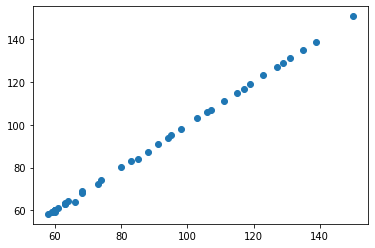

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.97727993 0.64137291]]


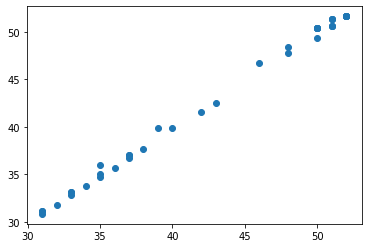

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.07992765]]
-------- 1 y up ->  center =  [[2.37749739]]
-------- 1 y up ->  right  =  [[2.79948494]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[90 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[30 -3]]
		 predicted_left   =  [[97.64610723]]
		 predicted_center =  [[147.12058289]]
		 predicted_right  =  [[28.57511116]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92110852 -3.14688034]]
		 regression_center.coef_ =  [[0.99573564 0.90538122]]
		 regression_right.coef_  =  [[0.9

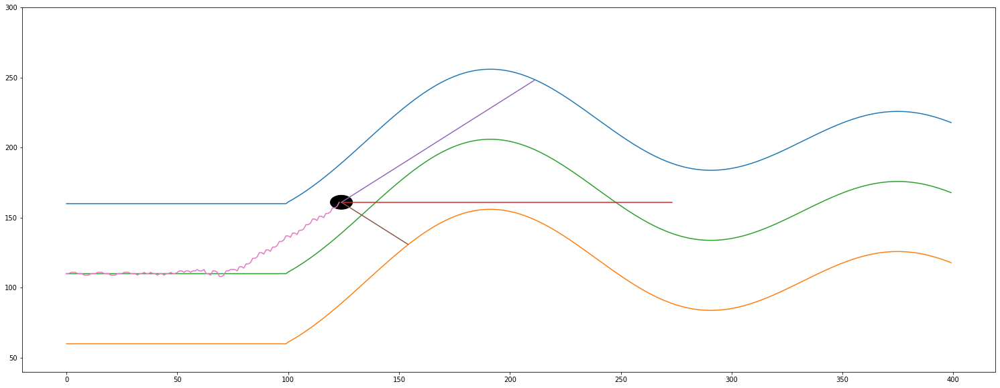

------------------------------ IF i % 3 == 1 ------------------------------
# i =  124
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 88 150  31]]
actual predicted =  [[20.15010576]]
actual self.y_distance[-1] =  22.075133697473802
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

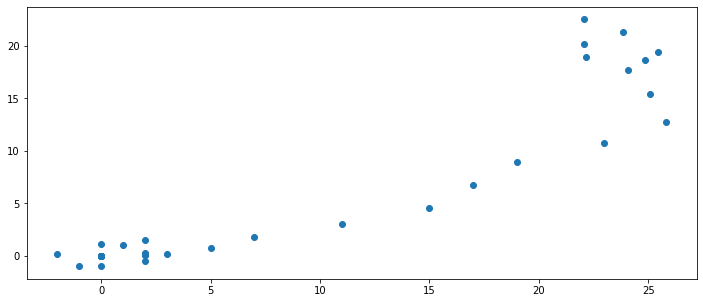

(125, 1)
(125, 1)


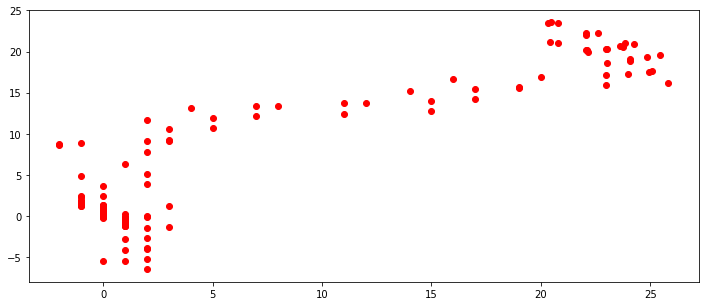

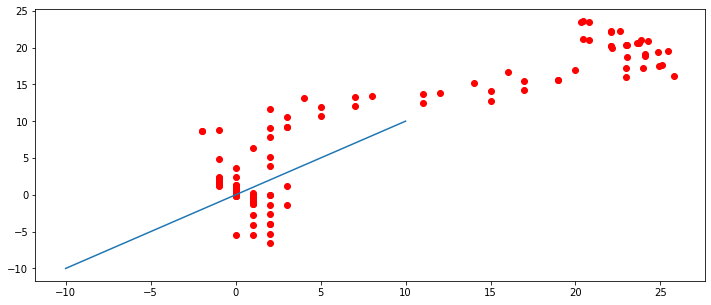

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
161.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

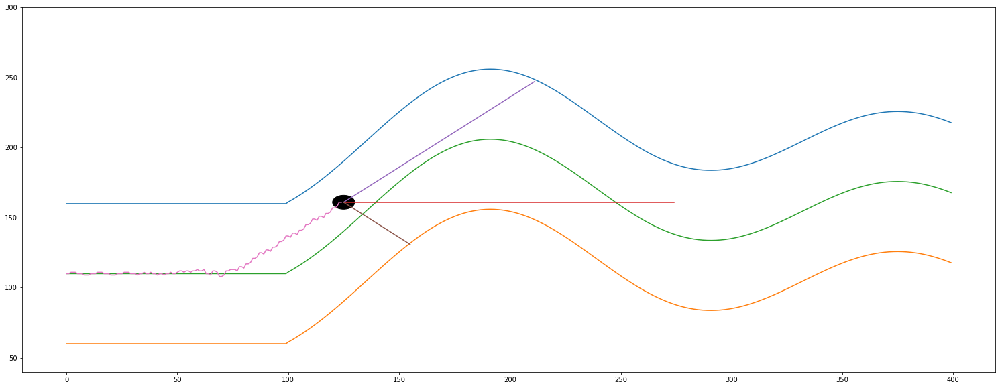

------------------------------ IF i % 3 == 2 ------------------------------
# i =  125
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor from left wall =  88
Sensor from right wall =  30
most távolsagra van a felső faltól =  30.302711336892486
most távolsagra van az alsó faltól =  69.69728866310751
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  125
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  19.697288663107514
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  19.697288663107514
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  126
			 len(self.sensor_left)   =  126
			 len(self.sensor_center) =  126
			 len(self.sensor_right)  =  126


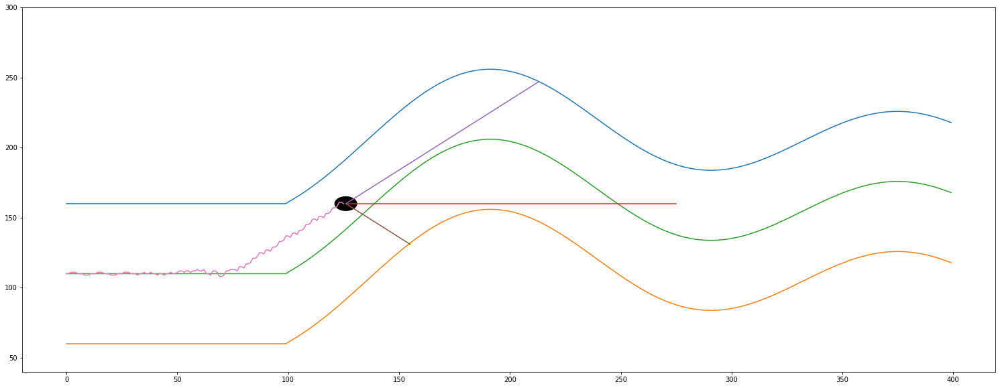

------------------------------ IF i % 3 == 0 ------------------------------
# i =  126
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (127, 3)
y.shape =  (127, 1)
i       =  126
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  126
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1.]
(42, 4)
(42, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 114.

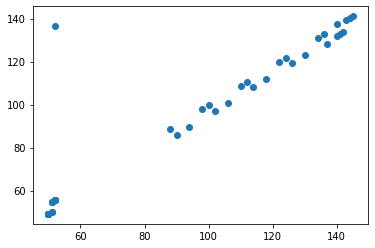

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99755704 0.88037072]]


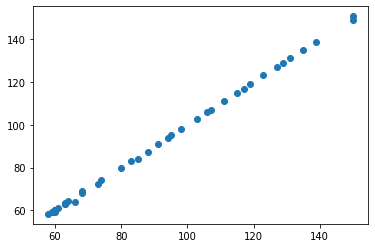

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.98082187 0.66210045]]


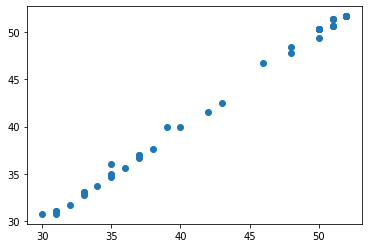

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.07271193]]
-------- 1 y up ->  center =  [[2.21625987]]
-------- 1 y up ->  right  =  [[2.65257857]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[88 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[30 -3]]
		 predicted_left   =  [[95.74734606]]
		 predicted_center =  [[147.33077636]]
		 predicted_right  =  [[28.44801106]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92118482 -3.13288873]]
		 regression_center.coef_ =  [[0.99755704 0.88037072]]
		 regression_right.coef_  =  [[0.9

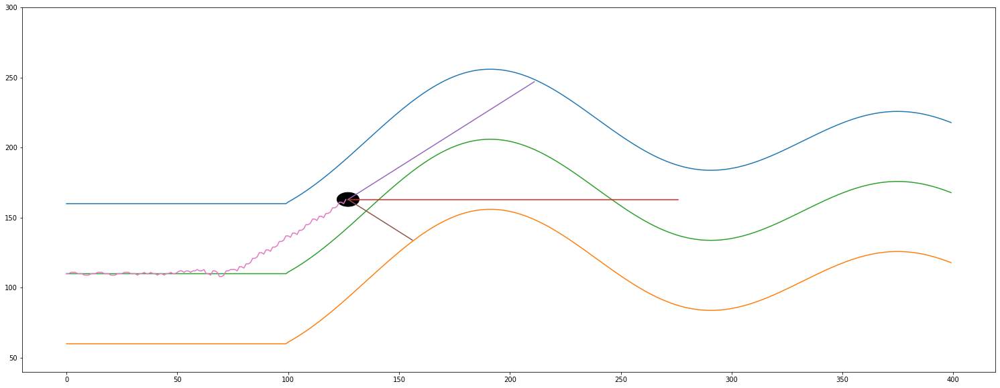

------------------------------ IF i % 3 == 1 ------------------------------
# i =  127
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 85 150  30]]
actual predicted =  [[21.49743313]]
actual self.y_distance[-1] =  19.910665326710273
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

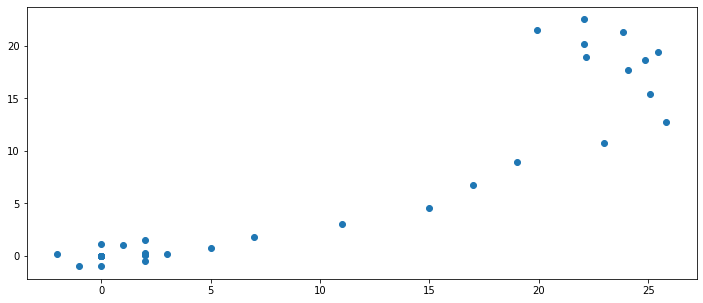

(128, 1)
(128, 1)


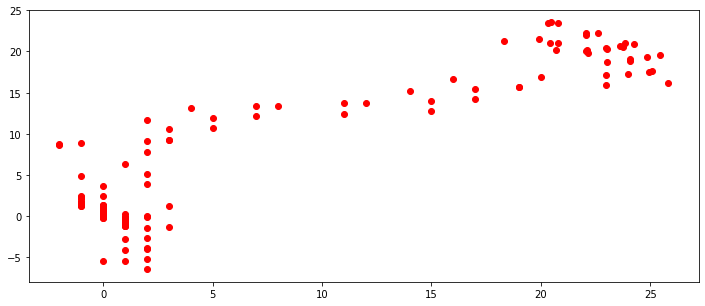

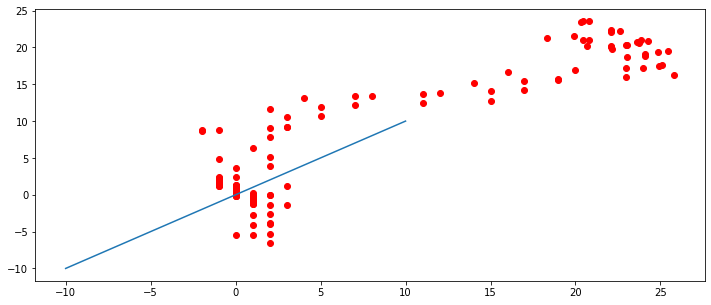

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
163.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

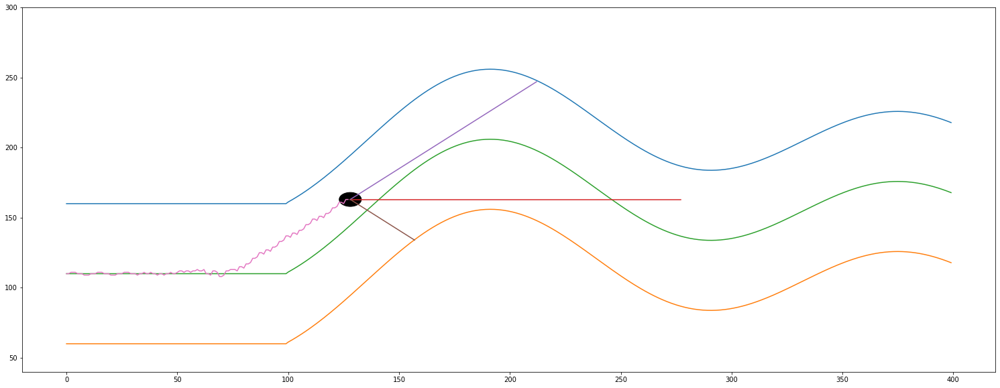

------------------------------ IF i % 3 == 2 ------------------------------
# i =  128
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor from left wall =  86
Sensor from right wall =  29
most távolsagra van a felső faltól =  32.496145495145555
most távolsagra van az alsó faltól =  67.50385450485444
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  128
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  17.503854504854445
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  17.503854504854445
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  129
			 len(self.sensor_left)   =  129
			 len(self.sensor_center) =  129
			 len(self.sensor_right)  =  129

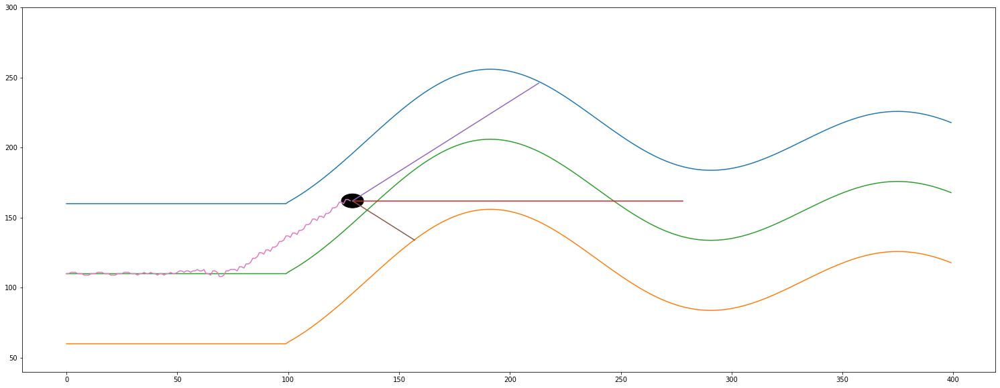

------------------------------ IF i % 3 == 0 ------------------------------
# i =  129
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (130, 3)
y.shape =  (130, 1)
i       =  129
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  129
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.]
(43, 4)
(43, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  51., 

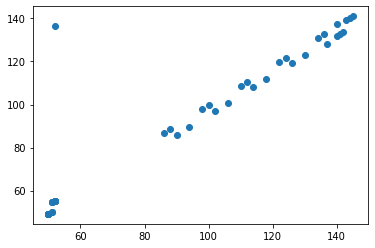

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99890362 0.86188026]]


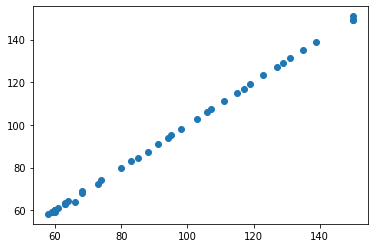

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.98402748 0.67947032]]


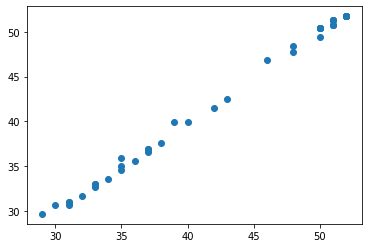

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.06215501]]
-------- 1 y up ->  center =  [[2.09705562]]
-------- 1 y up ->  right  =  [[2.51962226]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[85 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[29 -3]]
		 predicted_left   =  [[92.91762746]]
		 predicted_center =  [[147.48617416]]
		 predicted_right  =  [[27.35451036]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92129645 -3.11664271]]
		 regression_center.coef_ =  [[0.99890362 0.86188026]]
		 regression_right.coef_  =  [[0.9

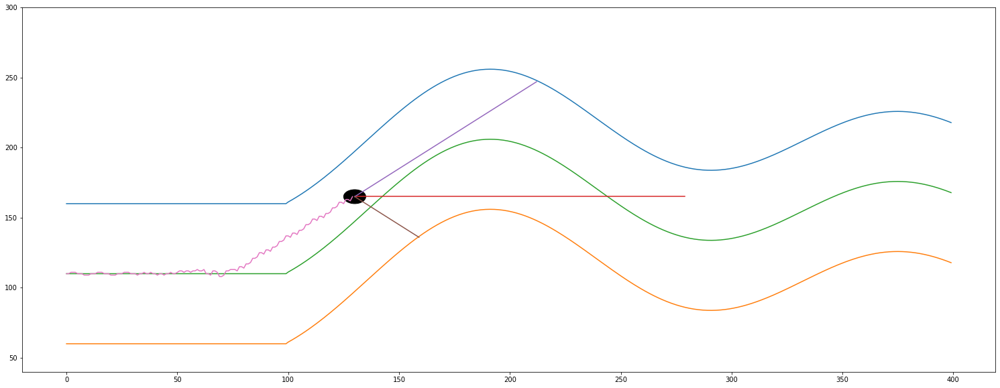

------------------------------ IF i % 3 == 1 ------------------------------
# i =  130
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 83 150  30]]
actual predicted =  [[20.56247915]]
actual self.y_distance[-1] =  17.668277100031162
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

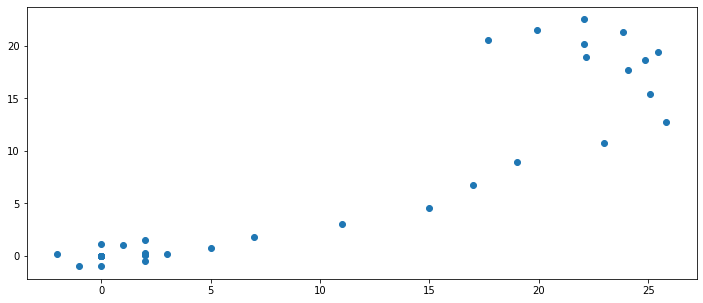

(131, 1)
(131, 1)


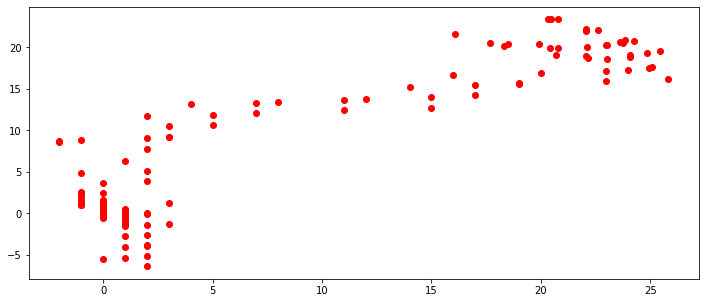

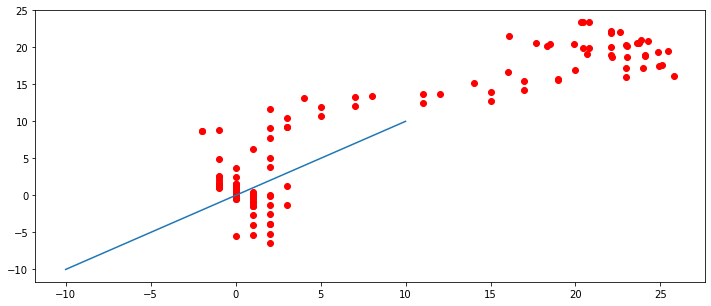

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
165.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

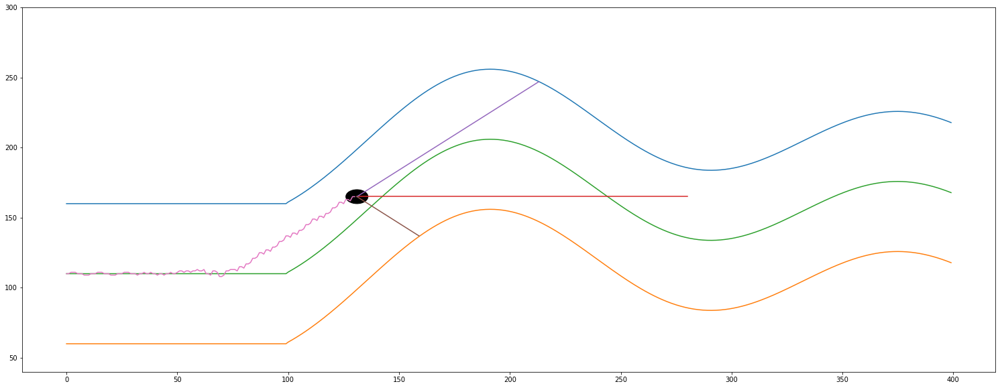

------------------------------ IF i % 3 == 2 ------------------------------
# i =  131
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor from left wall =  82
Sensor from right wall =  30
most távolsagra van a felső faltól =  32.758427570499094
most távolsagra van az alsó faltól =  67.2415724295009
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  131
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  17.241572429500906
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  17.241572429500906
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  132
			 len(self.sensor_left)   =  132
			 len(self.sensor_center) =  132
			 len(self.sensor_right)  =  132
		

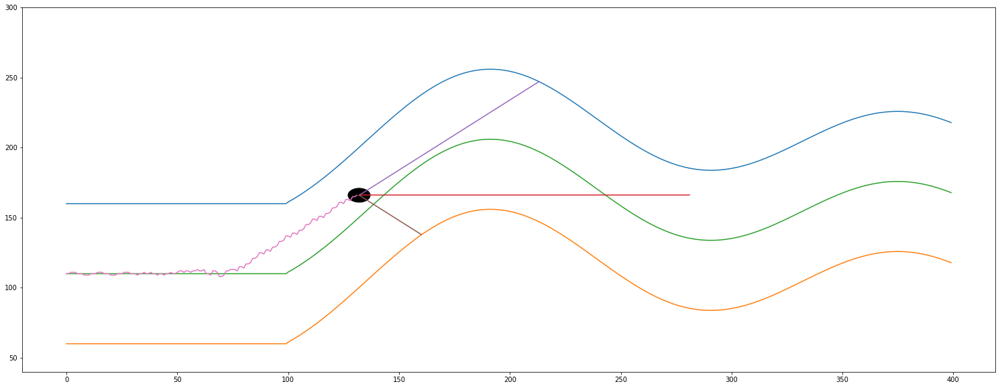

------------------------------ IF i % 3 == 0 ------------------------------
# i =  132
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (133, 3)
y.shape =  (133, 1)
i       =  132
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  132
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.]
(44, 4)
(44, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.,  5

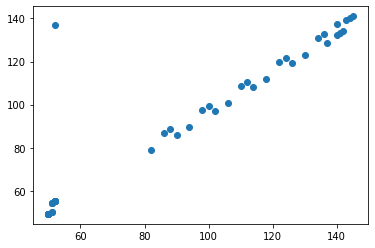

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99762428 0.84036915]]


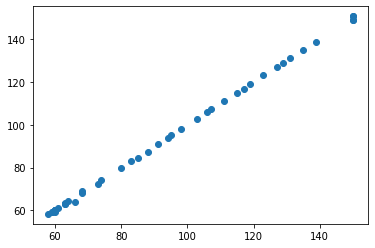

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.98432294 0.67789892]]


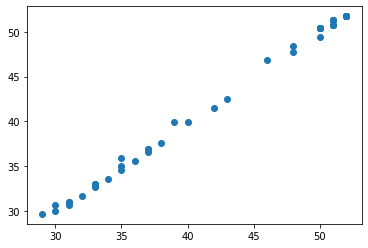

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.28029591]]
-------- 1 y up ->  center =  [[2.17138411]]
-------- 1 y up ->  right  =  [[2.50425786]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[82 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[29 -3]]
		 predicted_left   =  [[90.00743568]]
		 predicted_center =  [[147.45592487]]
		 predicted_right  =  [[27.35370463]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92061581 -3.03931484]]
		 regression_center.coef_ =  [[0.99762428 0.84036915]]
		 regression_right.coef_  =  [[0.9

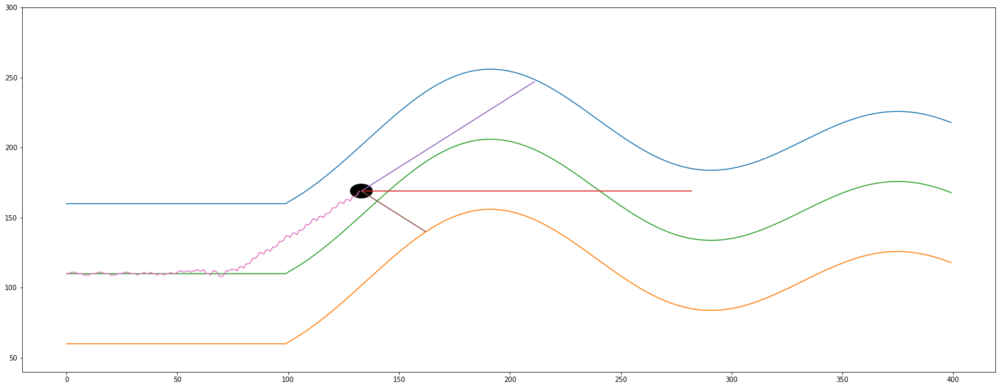

------------------------------ IF i % 3 == 1 ------------------------------
# i =  133
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 79 150  30]]
actual predicted =  [[19.82539054]]
actual self.y_distance[-1] =  17.375584587536707
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

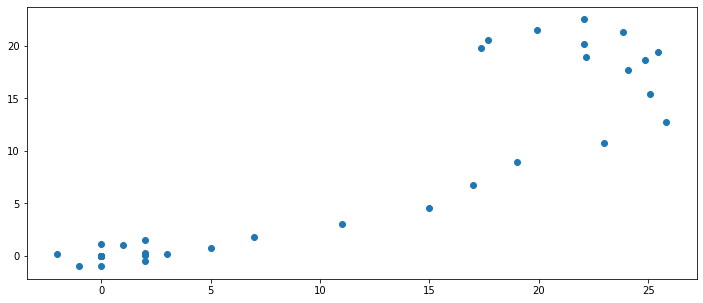

(134, 1)
(134, 1)


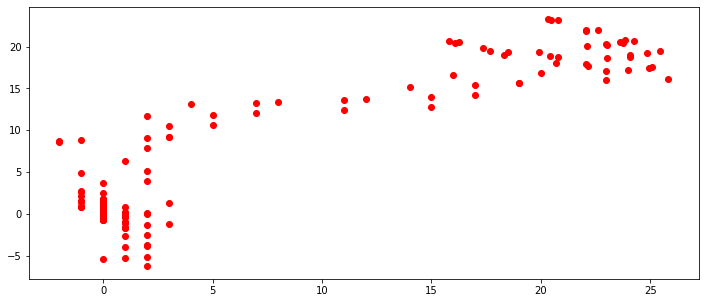

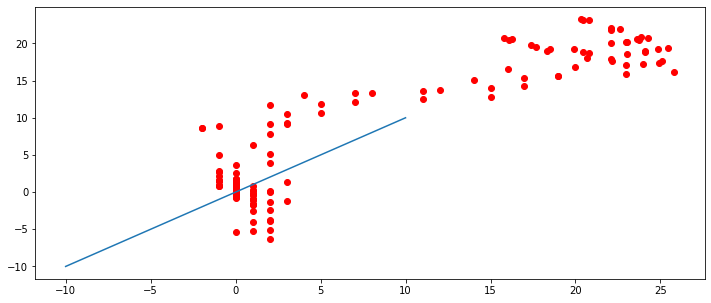

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
169.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

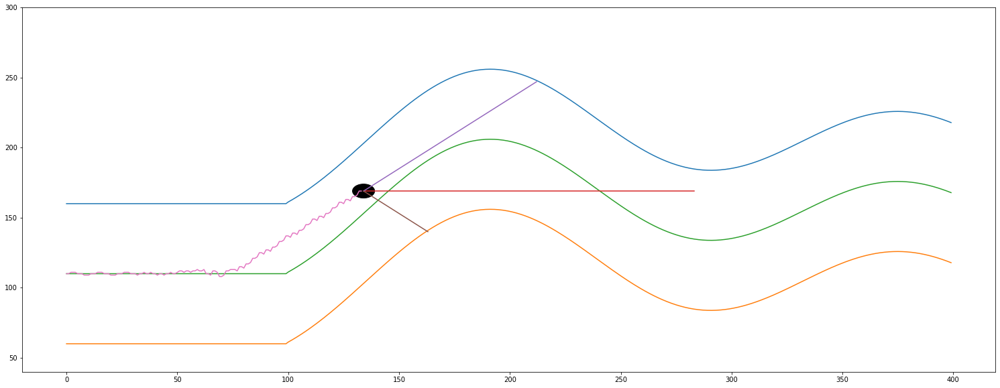

------------------------------ IF i % 3 == 2 ------------------------------
# i =  134
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor from left wall =  78
Sensor from right wall =  30
most távolsagra van a felső faltól =  33.06156259886828
most távolsagra van az alsó faltól =  66.93843740113172
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  134
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  16.938437401131722
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  16.938437401131722
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  135
			 len(self.sensor_left)   =  135
			 len(self.sensor_center) =  135
			 len(self.sensor_right)  =  135
			

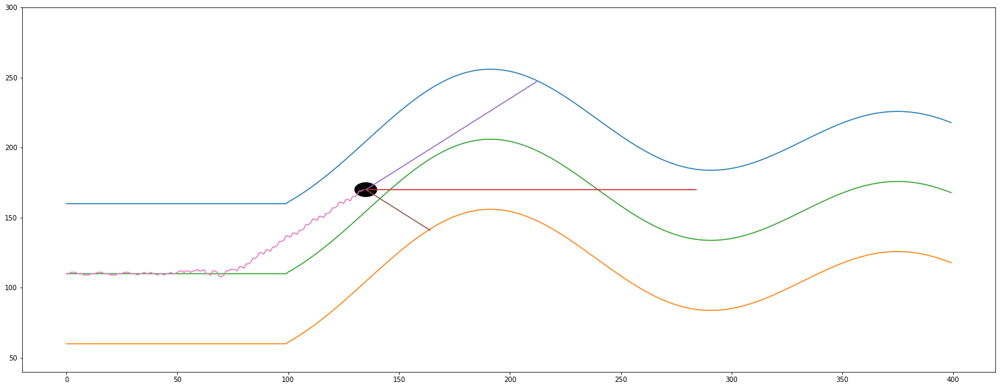

------------------------------ IF i % 3 == 0 ------------------------------
# i =  135
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (136, 3)
y.shape =  (136, 1)
i       =  135
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  135
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(45, 4)
(45, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([110.

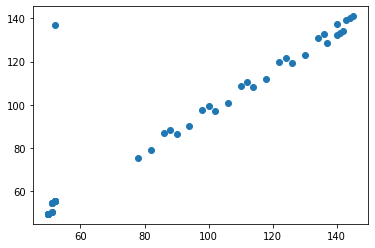

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99662833 0.82362306]]


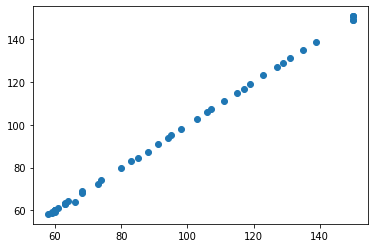

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.98794736 0.65692188]]


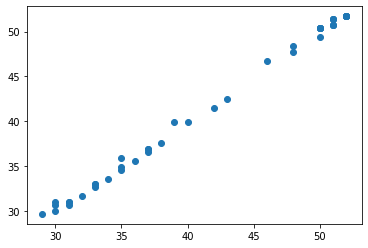

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.47614096]]
-------- 1 y up ->  center =  [[2.22924779]]
-------- 1 y up ->  right  =  [[2.31238484]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[78 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[30 -3]]
		 predicted_left   =  [[86.21043223]]
		 predicted_center =  [[147.43237623]]
		 predicted_right  =  [[28.33517072]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.91987361 -2.97600591]]
		 regression_center.coef_ =  [[0.99662833 0.82362306]]
		 regression_right.coef_  =  [[0.9

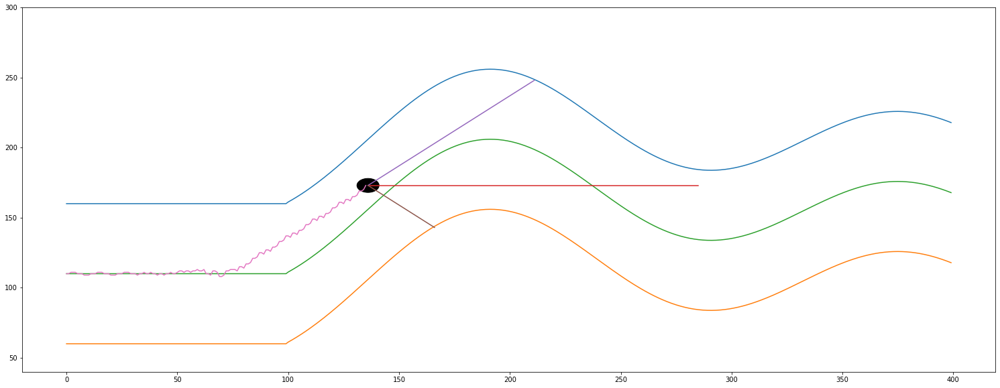

------------------------------ IF i % 3 == 1 ------------------------------
# i =  136
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 76 150  31]]
actual predicted =  [[18.3394685]]
actual self.y_distance[-1] =  17.061248885332077
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735968

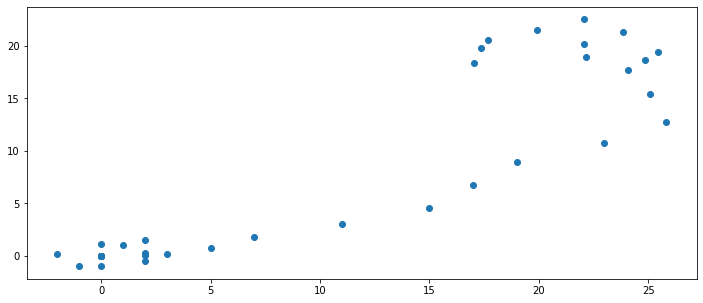

(137, 1)
(137, 1)


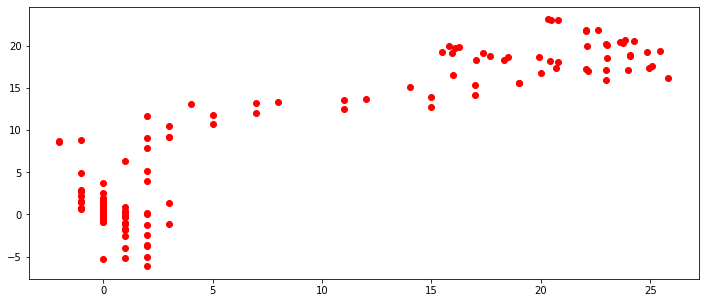

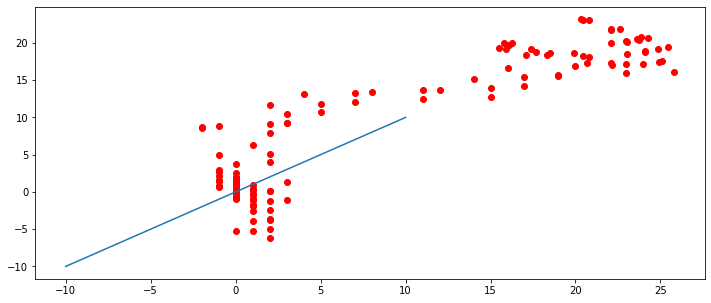

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
173.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

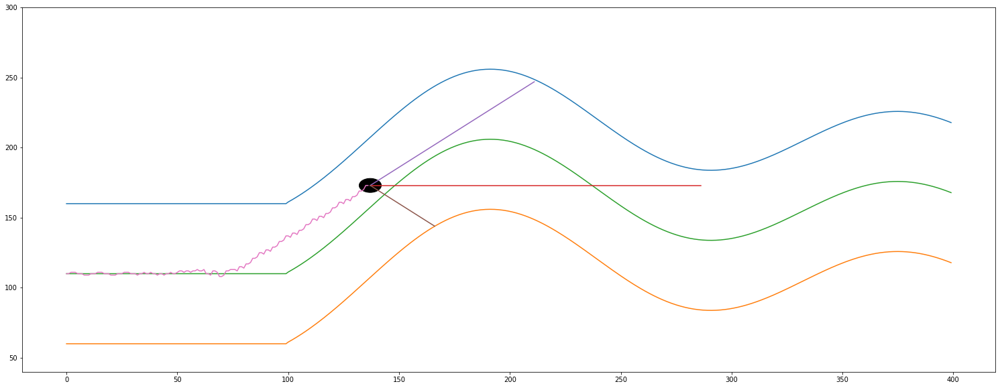

------------------------------ IF i % 3 == 2 ------------------------------
# i =  137
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor from left wall =  76
Sensor from right wall =  30
most távolsagra van a felső faltól =  35.37660352763322
most távolsagra van az alsó faltól =  64.62339647236678
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  137
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  14.623396472366778
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  14.623396472366778
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  138
			 len(self.sensor_left)   =  138
			 len(self.sensor_center) =  138
			 len(self.sensor_right)  =  138
	

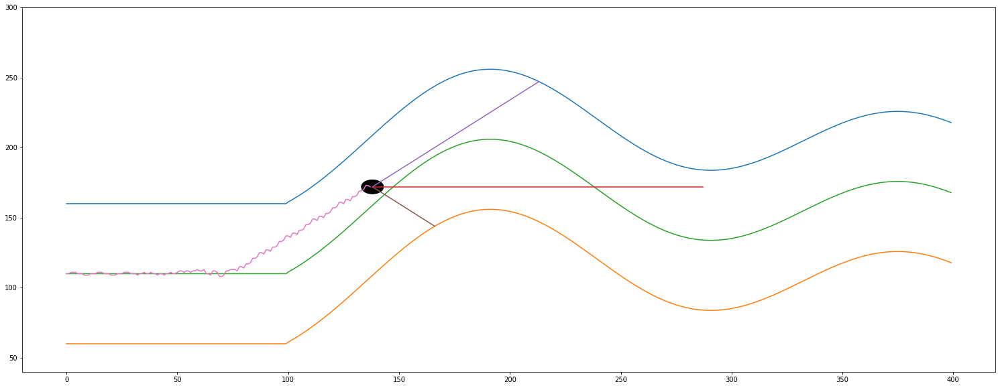

------------------------------ IF i % 3 == 0 ------------------------------
# i =  138
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (139, 3)
y.shape =  (139, 1)
i       =  138
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  138
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(46, 4)
(46, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), array([

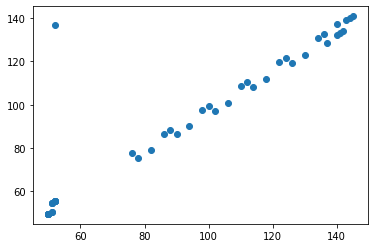

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99766888 0.80384106]]


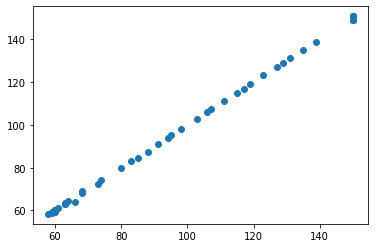

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.98673811 0.64900259]]


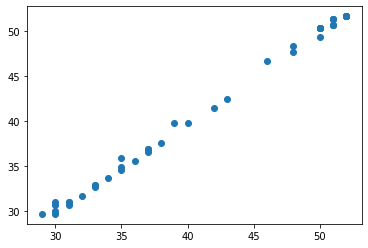

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.43345492]]
-------- 1 y up ->  center =  [[2.13166233]]
-------- 1 y up ->  right  =  [[2.36117555]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[76 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[29 -3]]
		 predicted_left   =  [[84.23277615]]
		 predicted_center =  [[147.56896067]]
		 predicted_right  =  [[27.39383215]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.9203311  -2.94362222]]
		 regression_center.coef_ =  [[0.99766888 0.80384106]]
		 regression_right.coef_  =  [[0.9

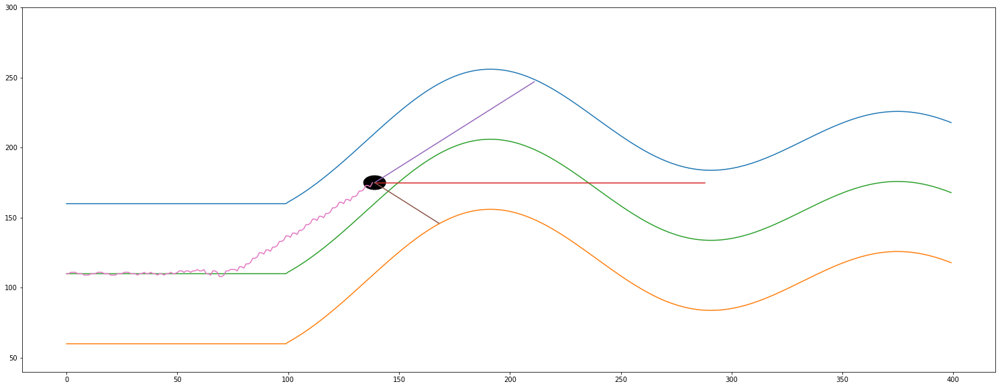

------------------------------ IF i % 3 == 1 ------------------------------
# i =  139
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 73 150  30]]
actual predicted =  [[19.06934643]]
actual self.y_distance[-1] =  14.754693048129894
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

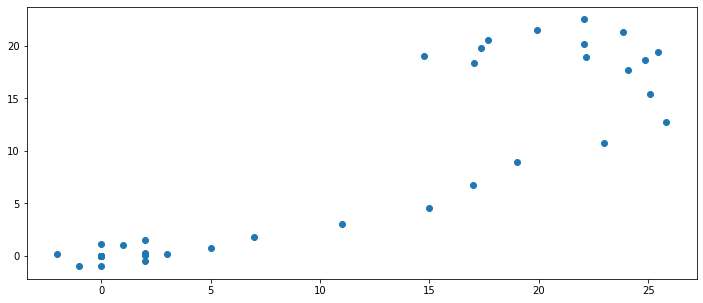

(140, 1)
(140, 1)


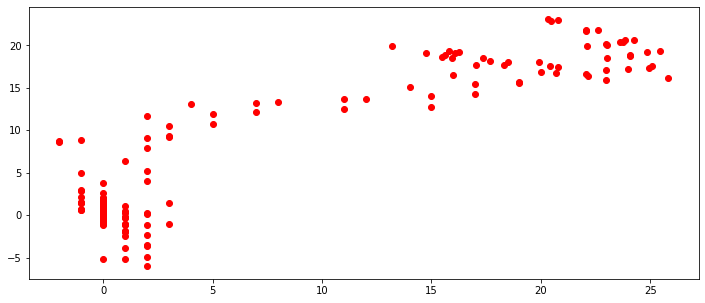

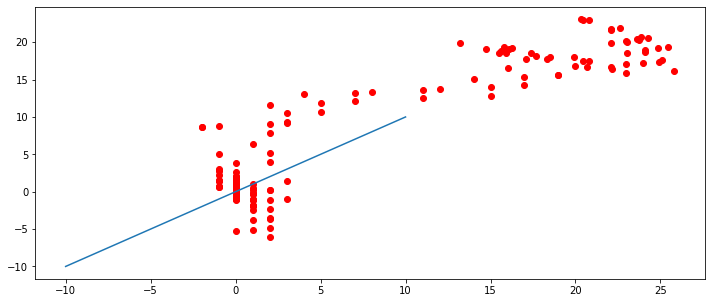

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
175.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

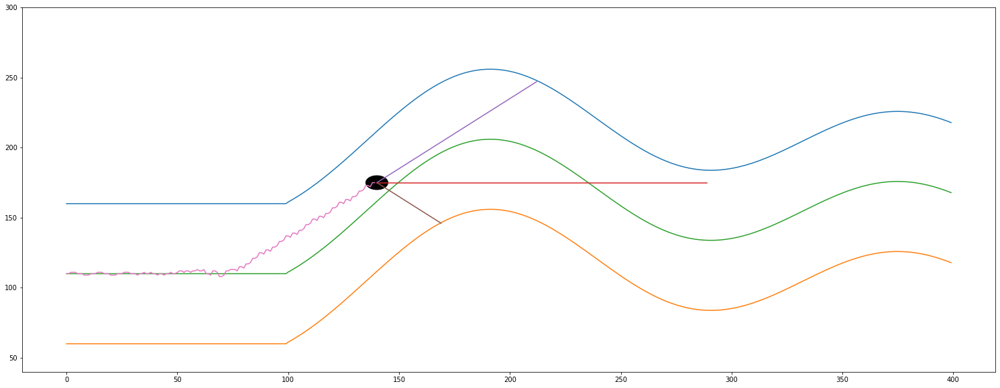

------------------------------ IF i % 3 == 2 ------------------------------
# i =  140
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor from left wall =  74
Sensor from right wall =  29
most távolsagra van a felső faltól =  37.673937826949754
most távolsagra van az alsó faltól =  62.326062173050246
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  140
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  12.326062173050246
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  12.326062173050246
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  141
			 len(self.sensor_left)   =  141
			 len(self.sensor_center) =  141
			 len(self.sensor_right)  =  14

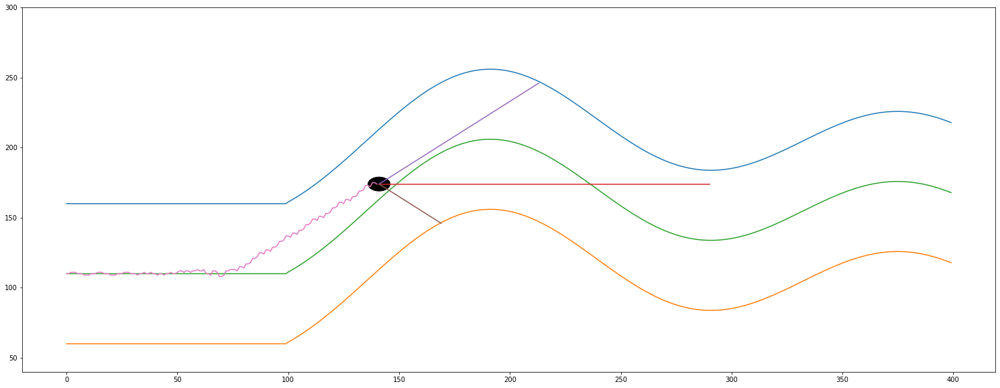

------------------------------ IF i % 3 == 0 ------------------------------
# i =  141
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (142, 3)
y.shape =  (142, 1)
i       =  141
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  141
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(47, 4)
(47, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]), arr

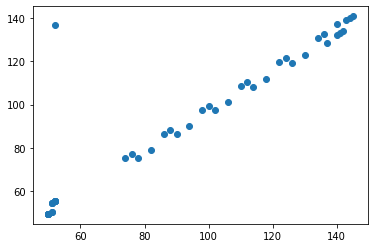

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99851097 0.78783193]]


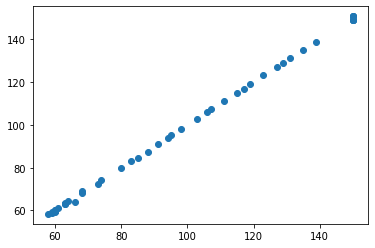

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.9888944  0.66312395]]


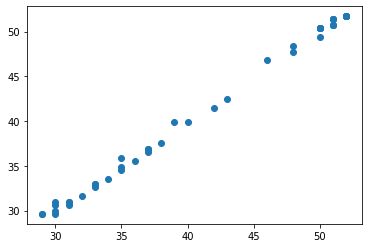

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.38583095]]
-------- 1 y up ->  center =  [[2.05268864]]
-------- 1 y up ->  right  =  [[2.27417389]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[73 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[29 -3]]
		 predicted_left   =  [[81.33062079]]
		 predicted_center =  [[147.67949537]]
		 predicted_right  =  [[27.31072119]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92084151 -2.91105022]]
		 regression_center.coef_ =  [[0.99851097 0.78783193]]
		 regression_right.coef_  =  [[0.9

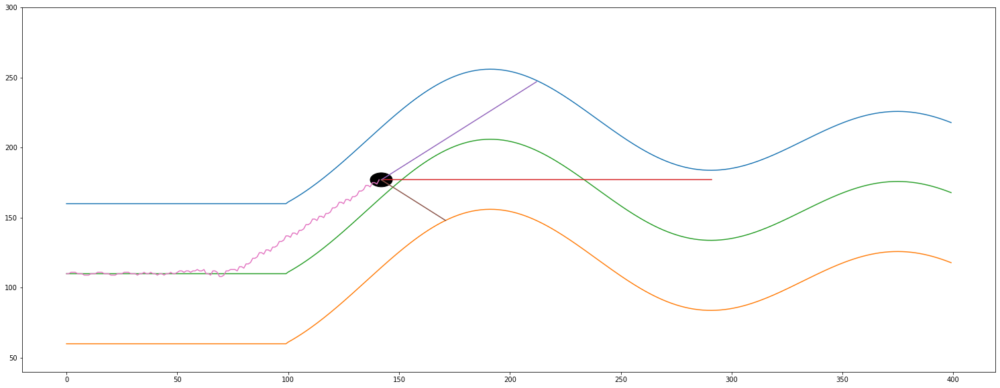

------------------------------ IF i % 3 == 1 ------------------------------
# i =  142
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 71 150  30]]
actual predicted =  [[18.3881251]]
actual self.y_distance[-1] =  12.485810347753755
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735968

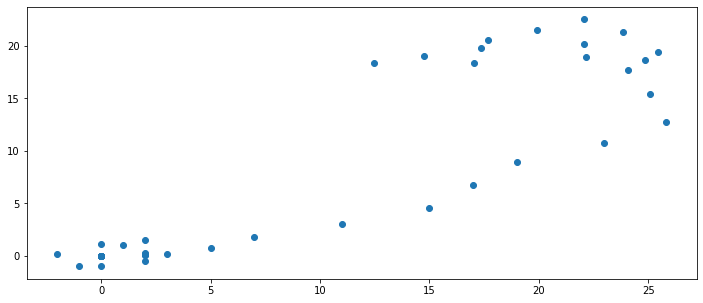

(143, 1)
(143, 1)


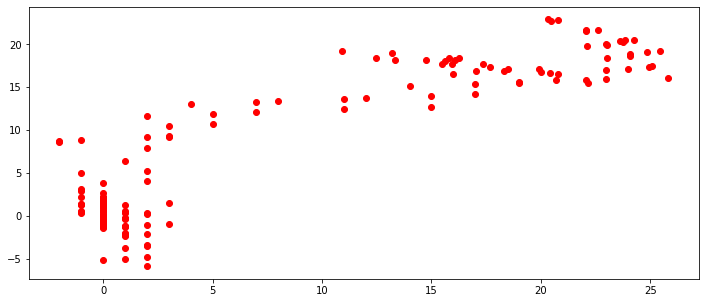

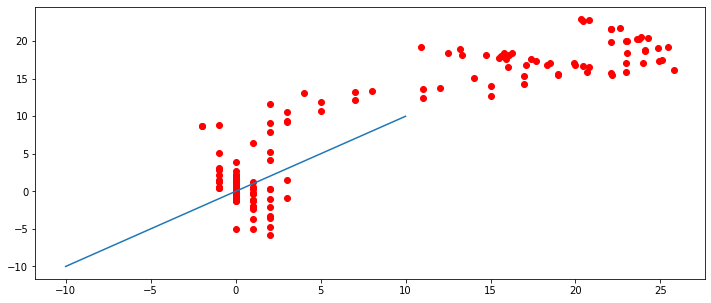

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
177.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

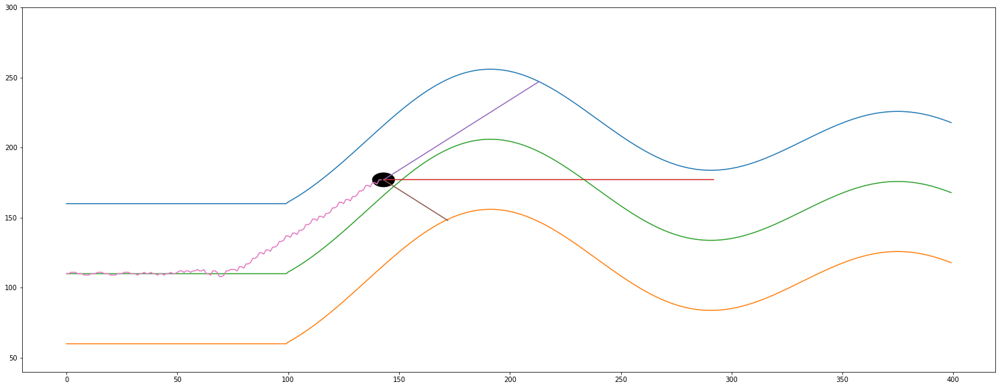

------------------------------ IF i % 3 == 2 ------------------------------
# i =  143
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor from left wall =  70
Sensor from right wall =  30
most távolsagra van a felső faltól =  37.92358131177332
most távolsagra van az alsó faltól =  62.07641868822668
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  143
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  12.076418688226681
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  12.076418688226681
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  144
			 len(self.sensor_left)   =  144
			 len(self.sensor_center) =  144
			 len(self.sensor_right)  =  144
		

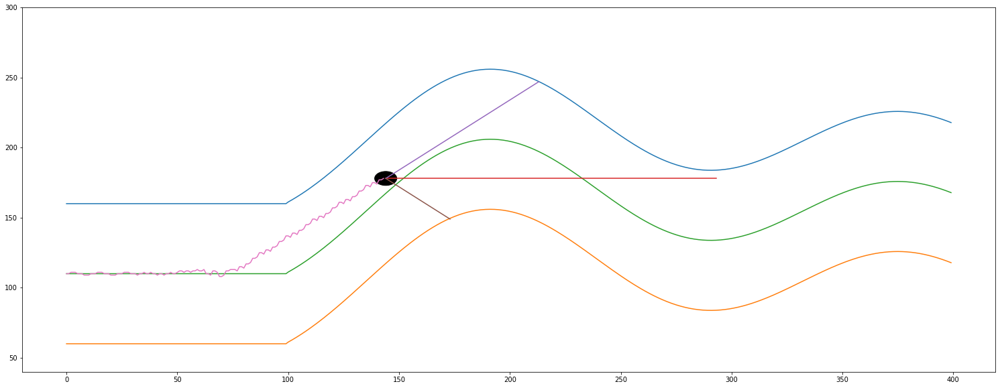

------------------------------ IF i % 3 == 0 ------------------------------
# i =  144
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (145, 3)
y.shape =  (145, 1)
i       =  144
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  144
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(48, 4)
(48, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50.]),

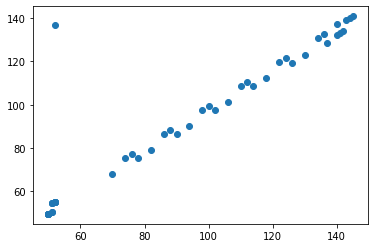

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99770062 0.7703543 ]]


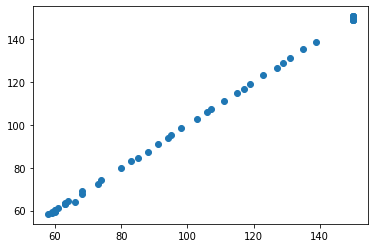

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99170045 0.64393135]]


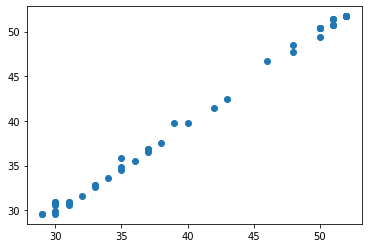

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.54811797]]
-------- 1 y up ->  center =  [[2.09593178]]
-------- 1 y up ->  right  =  [[2.12261129]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[70 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[30 -3]]
		 predicted_left   =  [[78.49543343]]
		 predicted_center =  [[147.67190746]]
		 predicted_right  =  [[28.30619888]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92005648 -2.86585451]]
		 regression_center.coef_ =  [[0.99770062 0.7703543 ]]
		 regression_right.coef_  =  [[0.9

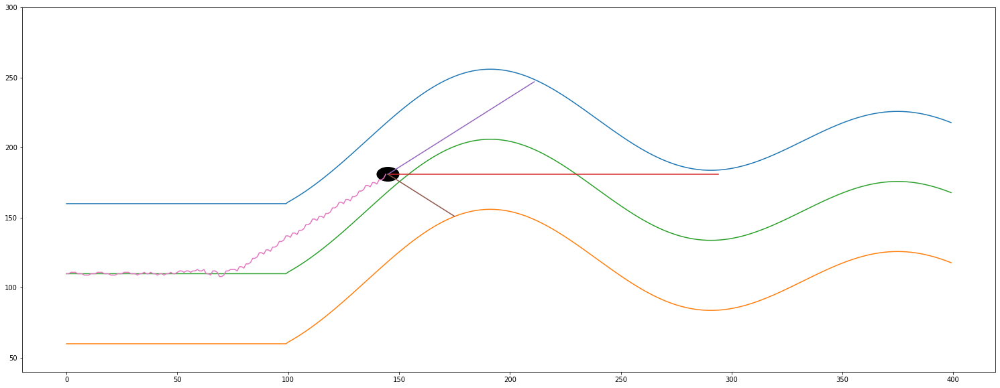

------------------------------ IF i % 3 == 1 ------------------------------
# i =  145
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 67 150  31]]
actual predicted =  [[16.89369703]]
actual self.y_distance[-1] =  12.28466727085862
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735968

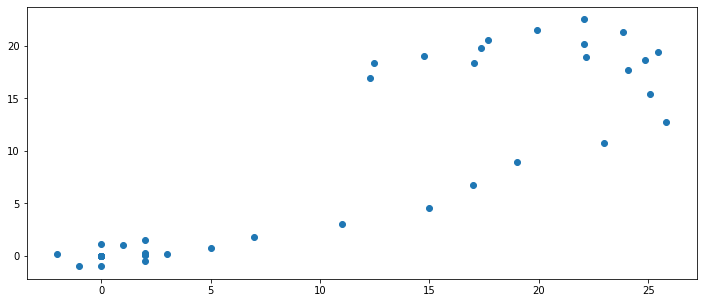

(146, 1)
(146, 1)


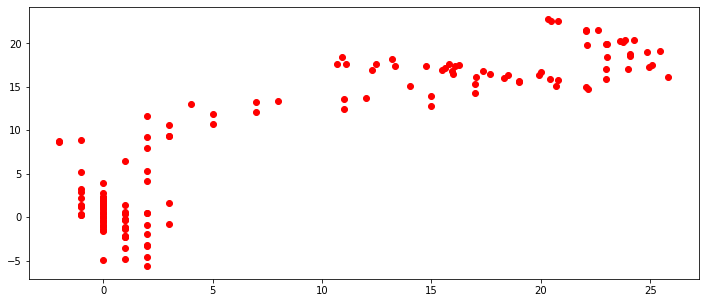

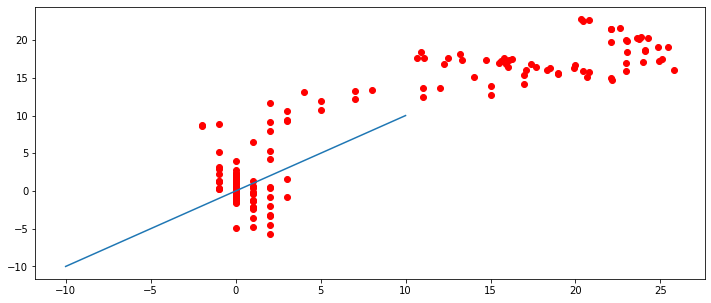

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
181.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

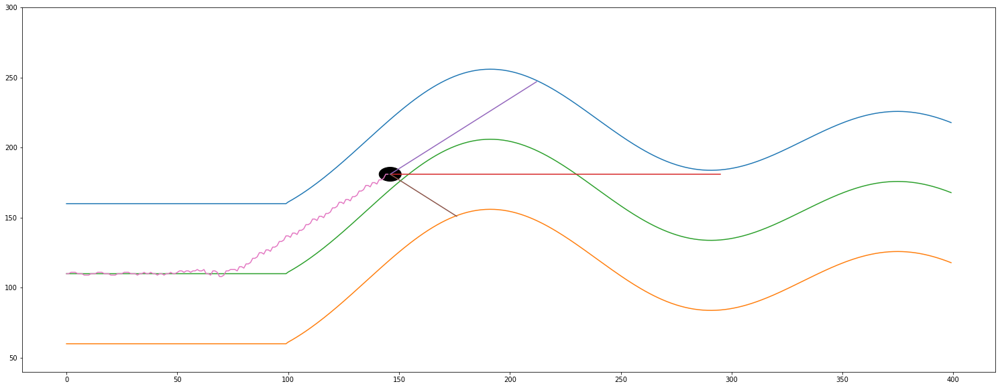

------------------------------ IF i % 3 == 2 ------------------------------
# i =  146
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor from left wall =  66
Sensor from right wall =  31
most távolsagra van a felső faltól =  38.09547624028835
most távolsagra van az alsó faltól =  61.904523759711665
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  146
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  11.904523759711651
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  11.904523759711651
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  147
			 len(self.sensor_left)   =  147
			 len(self.sensor_center) =  147
			 len(self.sensor_right)  =  147
		

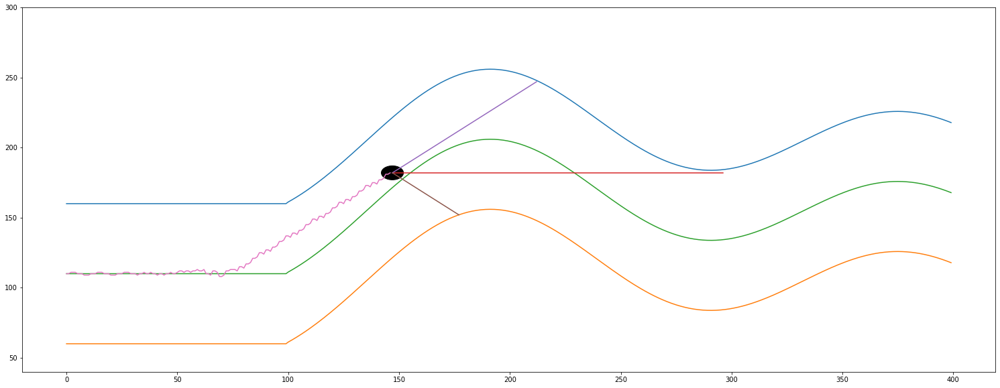

------------------------------ IF i % 3 == 0 ------------------------------
# i =  147
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (148, 3)
y.shape =  (148, 1)
i       =  147
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  147
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(49, 4)
(49, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,  50

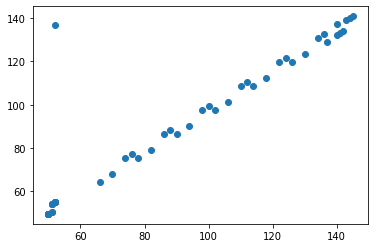

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.99702856 0.75585906]]


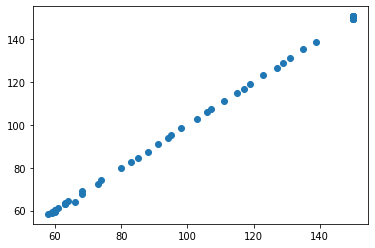

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99388937 0.6273928 ]]


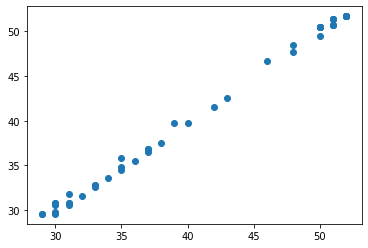

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.6815836]]
-------- 1 y up ->  center =  [[2.13179586]]
-------- 1 y up ->  right  =  [[2.0012475]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[66 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[31 -3]]
		 predicted_left   =  [[74.76503262]]
		 predicted_center =  [[147.66561437]]
		 predicted_right  =  [[29.30835753]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.91935163 -2.83139834]]
		 regression_center.coef_ =  [[0.99702856 0.75585906]]
		 regression_right.coef_  =  [[0.993

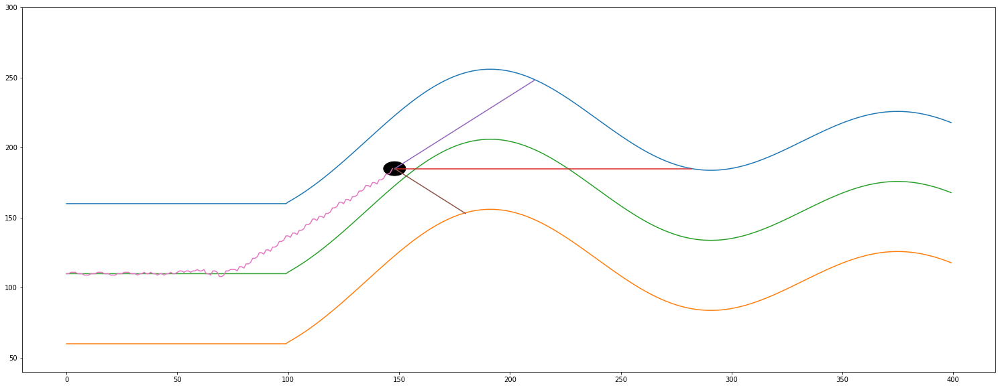

------------------------------ IF i % 3 == 1 ------------------------------
# i =  148
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 64 135  33]]
actual predicted =  [[15.87071475]]
actual self.y_distance[-1] =  12.181204222360122
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

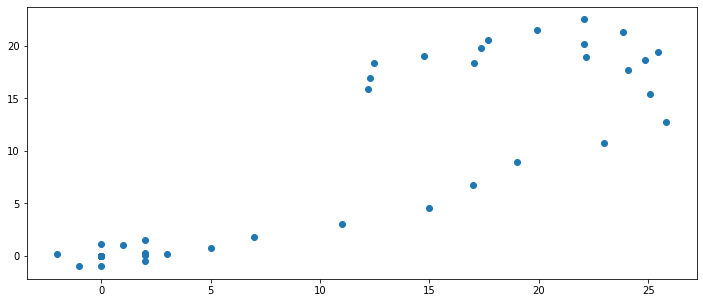

(149, 1)
(149, 1)


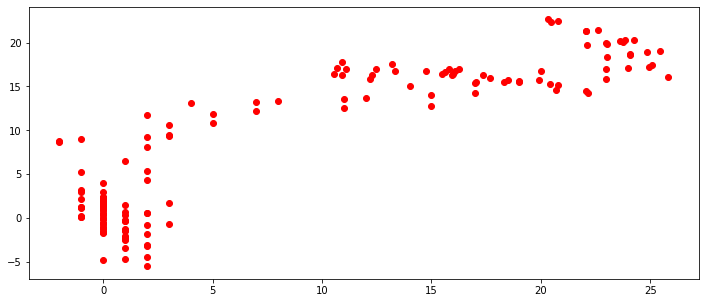

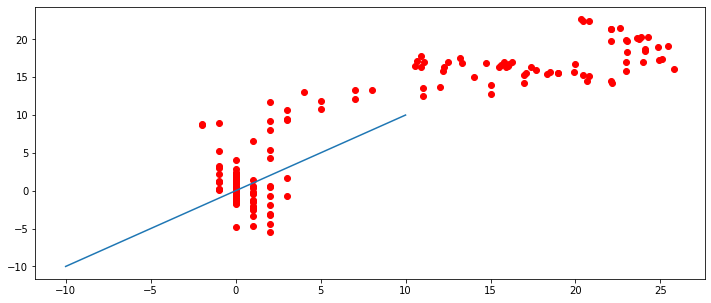

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
185.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

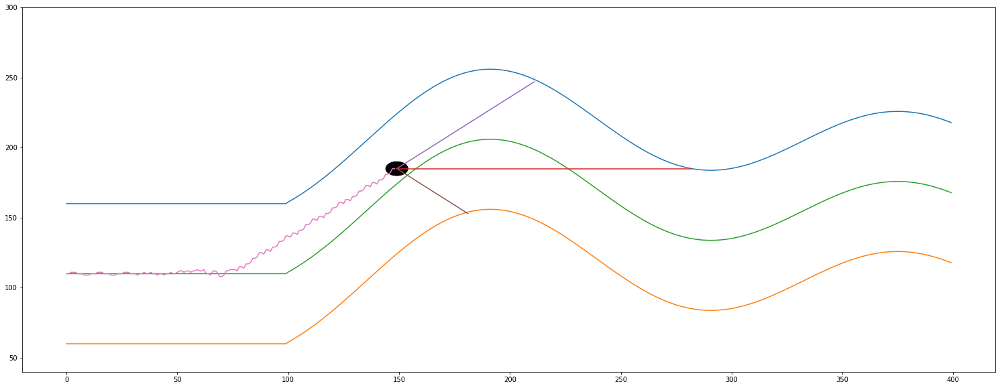

------------------------------ IF i % 3 == 2 ------------------------------
# i =  149
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  139
Sensor from left wall =  64
Sensor from right wall =  32
most távolsagra van a felső faltól =  40.15979071109382
most távolsagra van az alsó faltól =  59.84020928890618
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  149
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  9.84020928890618
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  9.84020928890618
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  150
			 len(self.sensor_left)   =  150
			 len(self.sensor_center) =  150
			 len(self.sensor

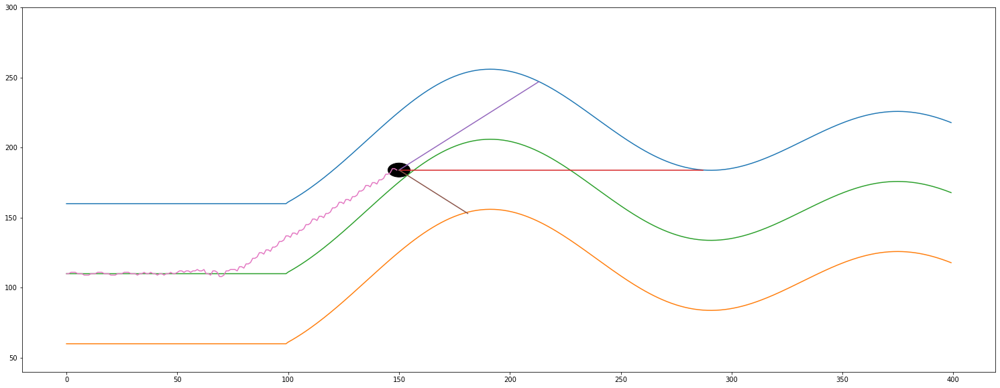

------------------------------ IF i % 3 == 0 ------------------------------
# i =  150
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (151, 3)
y.shape =  (151, 1)
i       =  150
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  150
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(50, 4)
(50, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 116.,

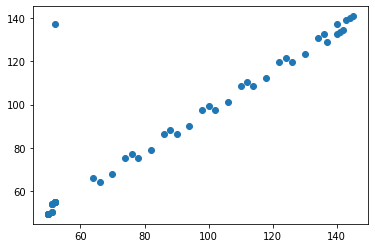

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1.00050429 0.63993949]]


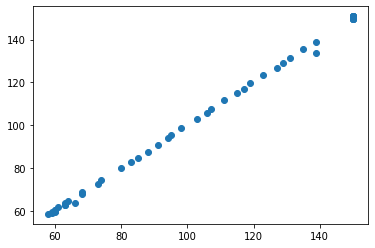

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99503408 0.63870886]]


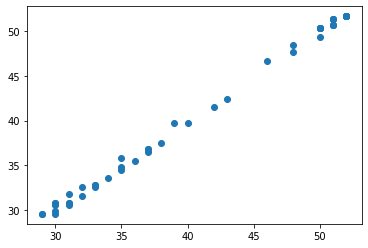

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.58484941]]
-------- 1 y up ->  center =  [[1.79047914]]
-------- 1 y up ->  right  =  [[1.95605469]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[64 -3]]
		 _X_center =  [[138  -3]]
		 _X_right  =  [[32 -3]]
		 predicted_left   =  [[72.71069025]]
		 predicted_center =  [[136.29980834]]
		 predicted_right  =  [[30.2472756]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92041138 -2.78498101]]
		 regression_center.coef_ =  [[1.00050429 0.63993949]]
		 regression_right.coef_  =  [[0.99

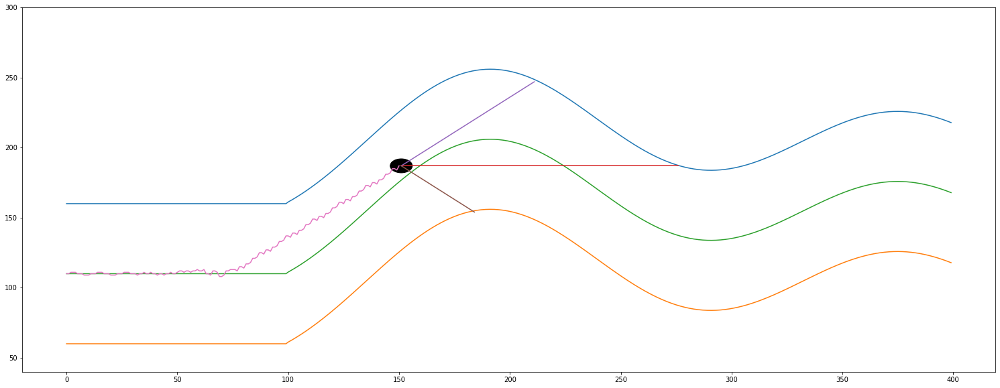

------------------------------ IF i % 3 == 1 ------------------------------
# i =  151
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 61 126  34]]
actual predicted =  [[15.54866499]]
actual self.y_distance[-1] =  10.204936924602578
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

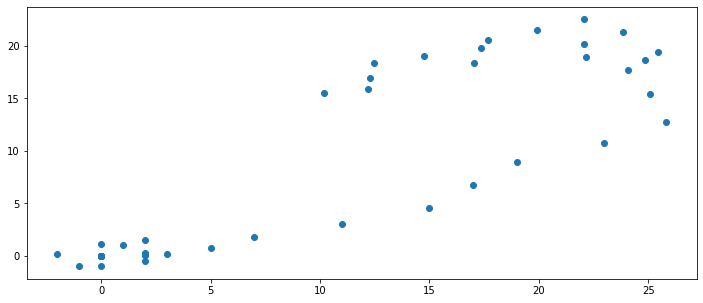

(152, 1)
(152, 1)


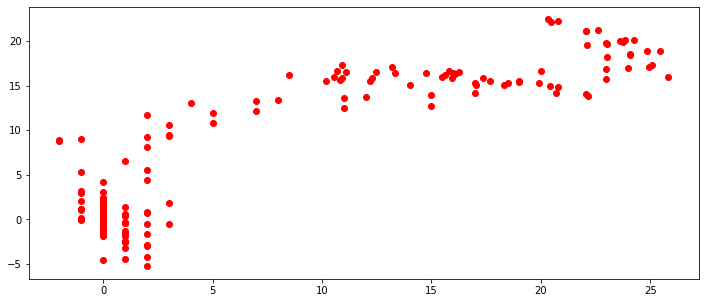

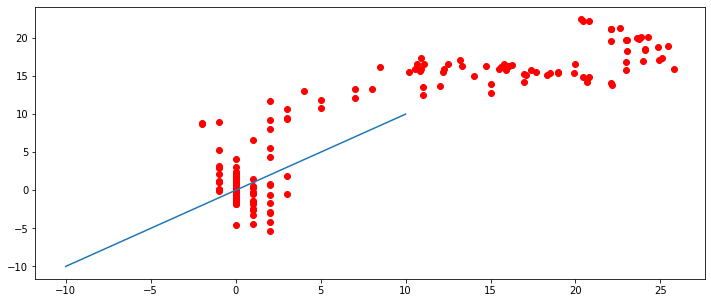

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
187.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

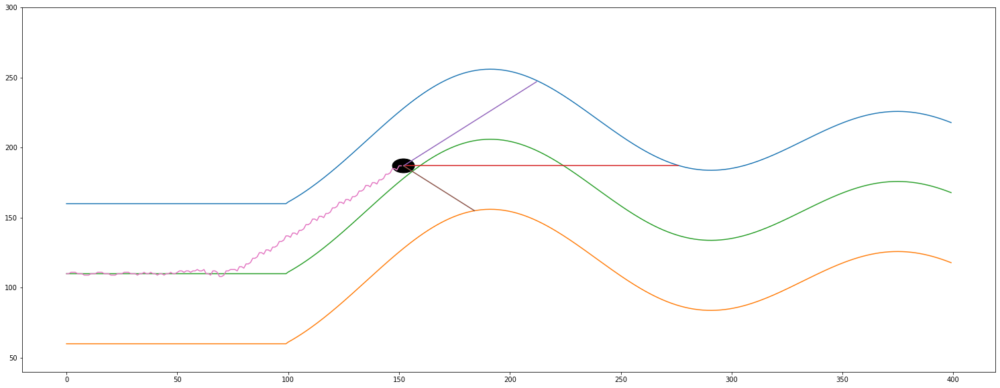

------------------------------ IF i % 3 == 2 ------------------------------
# i =  152
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  128
Sensor from left wall =  62
Sensor from right wall =  33
most távolsagra van a felső faltól =  42.087216367906166
most távolsagra van az alsó faltól =  57.912783632093834
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  152
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  7.912783632093834
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  7.912783632093834
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  153
			 len(self.sensor_left)   =  153
			 len(self.sensor_center) =  153
			 len(self.s

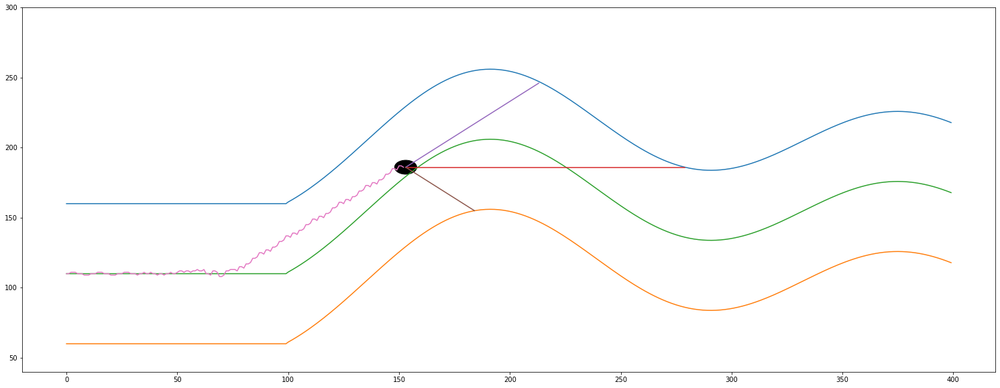

------------------------------ IF i % 3 == 0 ------------------------------
# i =  153
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (154, 3)
y.shape =  (154, 1)
i       =  153
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  153
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(51, 4)
(51, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52., 1

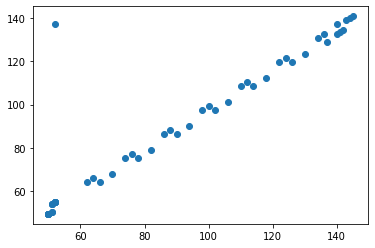

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1.00196172 0.57459312]]


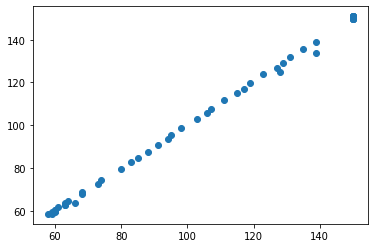

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99408964 0.62937259]]


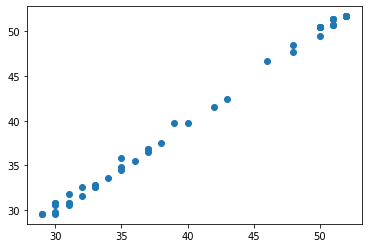

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.48519529]]
-------- 1 y up ->  center =  [[1.64735903]]
-------- 1 y up ->  right  =  [[1.99334082]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[61 -3]]
		 _X_center =  [[127  -3]]
		 _X_right  =  [[32 -3]]
		 predicted_left   =  [[69.73674291]]
		 predicted_center =  [[125.59616337]]
		 predicted_right  =  [[30.29262944]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92150312 -2.74034012]]
		 regression_center.coef_ =  [[1.00196172 0.57459312]]
		 regression_right.coef_  =  [[0.9

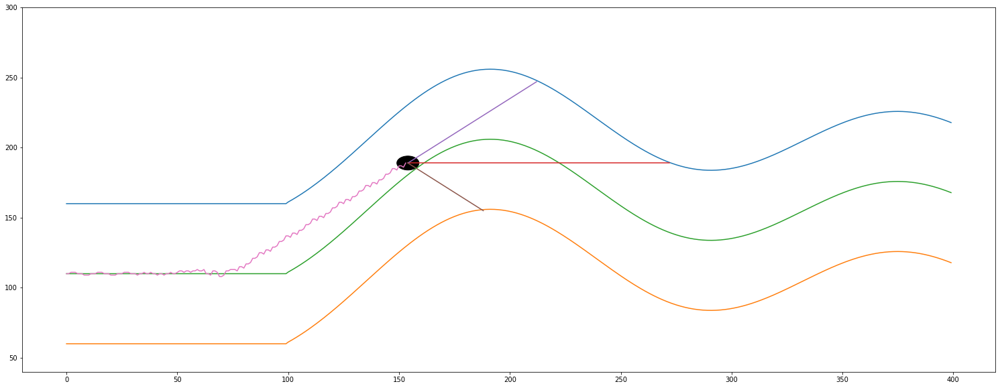

------------------------------ IF i % 3 == 1 ------------------------------
# i =  154
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 59 119  35]]
actual predicted =  [[14.87765861]]
actual self.y_distance[-1] =  8.384661495956038
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735968

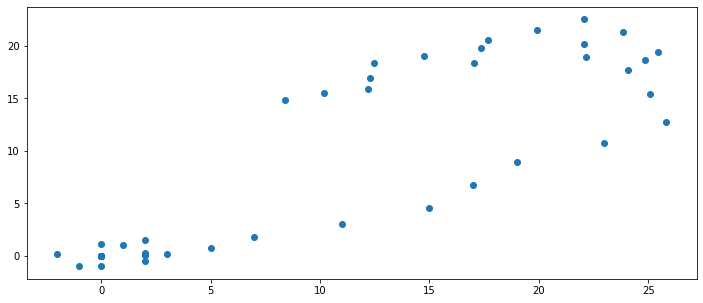

(155, 1)
(155, 1)


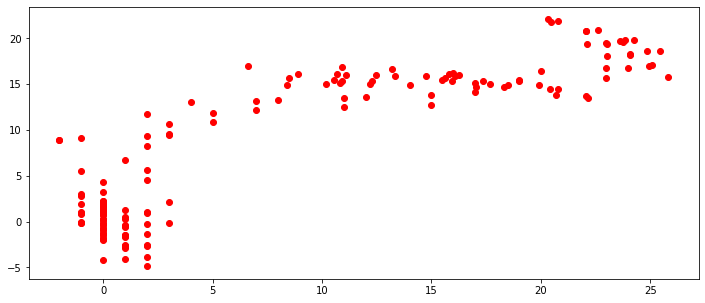

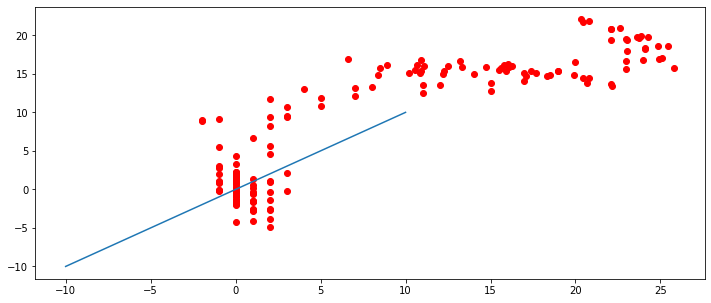

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
189.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

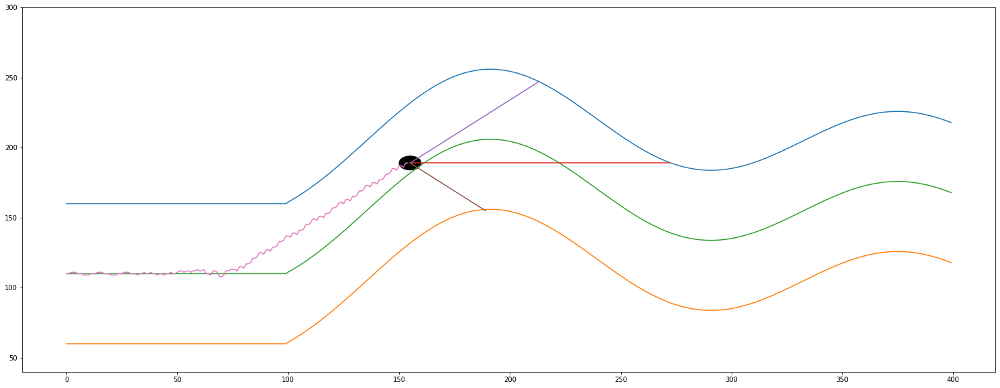

------------------------------ IF i % 3 == 2 ------------------------------
# i =  155
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  117
Sensor from left wall =  58
Sensor from right wall =  36
most távolsagra van a felső faltól =  41.84926143683808
most távolsagra van az alsó faltól =  58.15073856316192
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  155
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  8.150738563161923
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  8.150738563161923
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  156
			 len(self.sensor_left)   =  156
			 len(self.sensor_center) =  156
			 len(self.senso

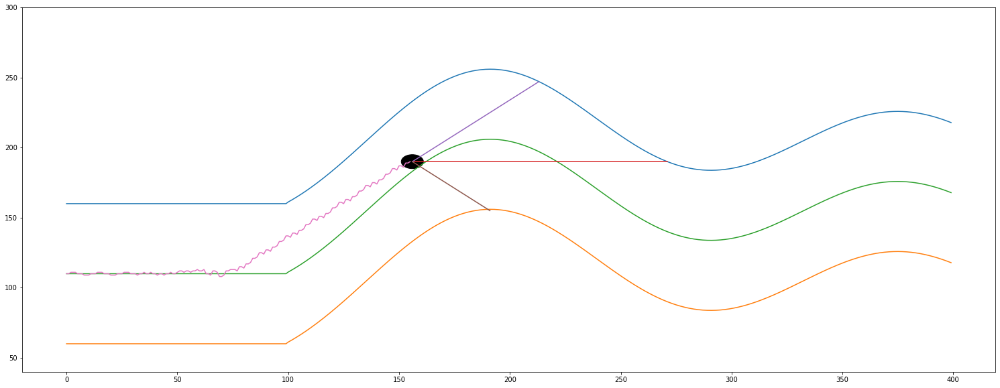

------------------------------ IF i % 3 == 0 ------------------------------
# i =  156
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (157, 3)
y.shape =  (157, 1)
i       =  156
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  156
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(52, 4)
(52, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,  52

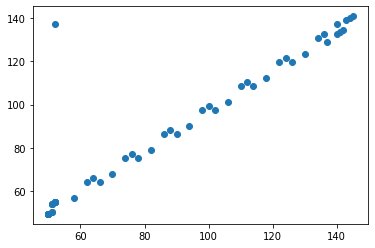

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1.00138873 0.53848824]]


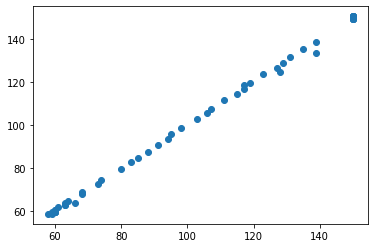

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99381204 0.63330639]]


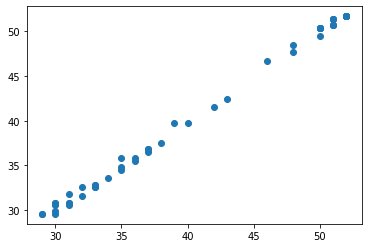

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.57372628]]
-------- 1 y up ->  center =  [[1.63185305]]
-------- 1 y up ->  right  =  [[2.01222727]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[58 -3]]
		 _X_center =  [[116  -3]]
		 _X_right  =  [[36 -3]]
		 predicted_left   =  [[66.9477648]]
		 predicted_center =  [[114.63760434]]
		 predicted_right  =  [[34.26242304]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92097569 -2.71960603]]
		 regression_center.coef_ =  [[1.00138873 0.53848824]]
		 regression_right.coef_  =  [[0.99

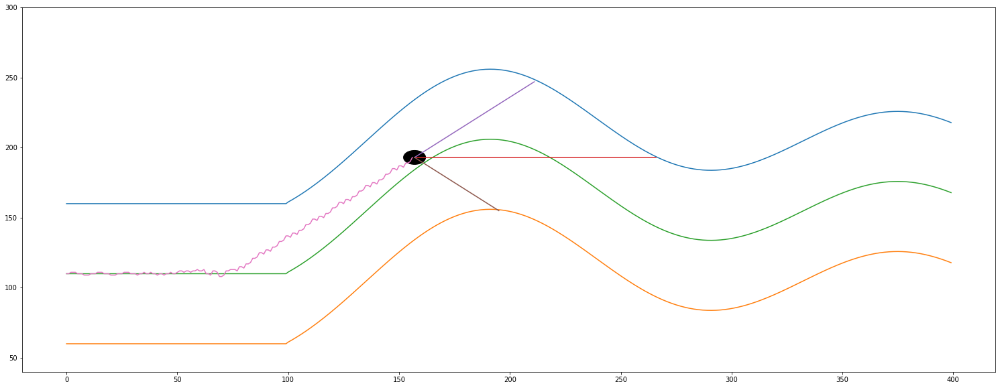

------------------------------ IF i % 3 == 1 ------------------------------
# i =  157
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 55 110  39]]
actual predicted =  [[11.73666895]]
actual self.y_distance[-1] =  8.74816615638315
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359686

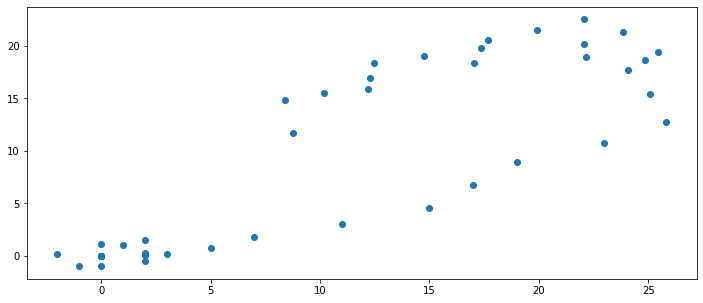

(158, 1)
(158, 1)


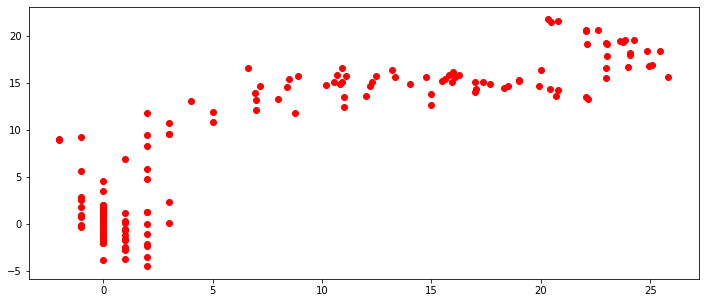

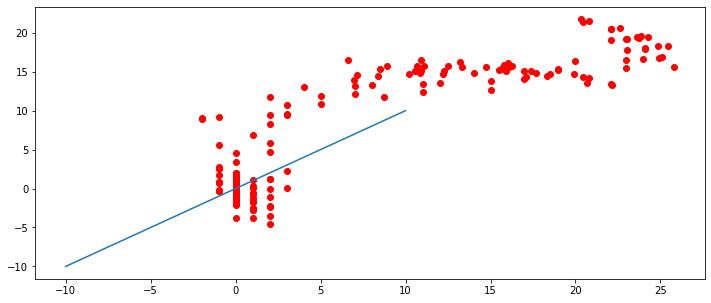

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
193.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

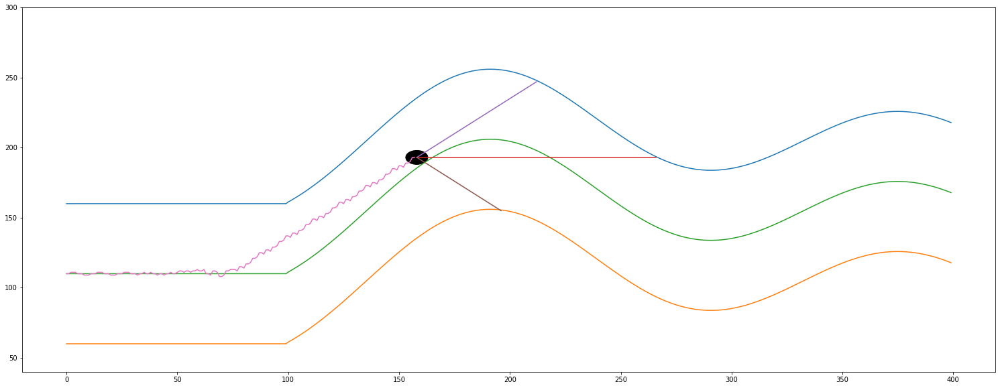

------------------------------ IF i % 3 == 2 ------------------------------
# i =  158
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  108
Sensor from left wall =  54
Sensor from right wall =  40
most távolsagra van a felső faltól =  41.41853616733414
most távolsagra van az alsó faltól =  58.58146383266586
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  158
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  8.581463832665861
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  8.581463832665861
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  159
			 len(self.sensor_left)   =  159
			 len(self.sensor_center) =  159
			 len(self.sensor

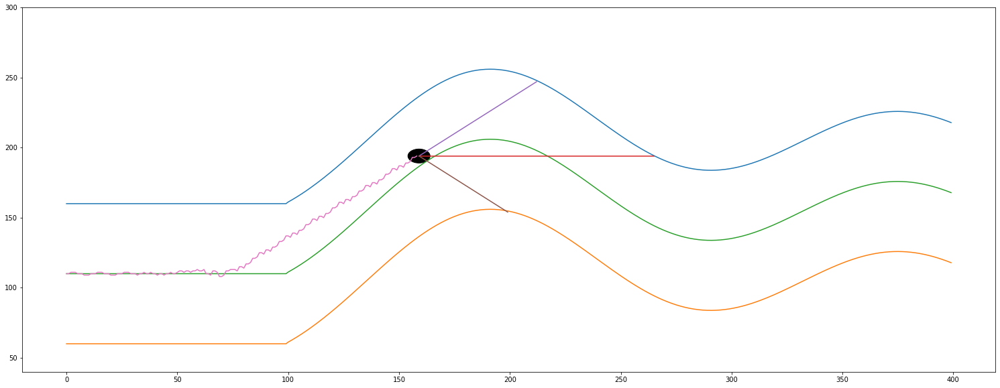

------------------------------ IF i % 3 == 0 ------------------------------
# i =  159
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (160, 3)
y.shape =  (160, 1)
i       =  159
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  159
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(53, 4)
(53, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([109.,

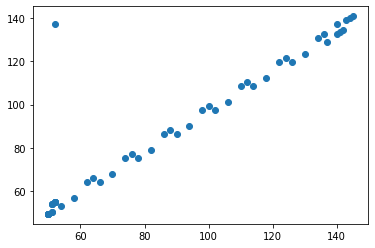

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1.00112606 0.50553038]]


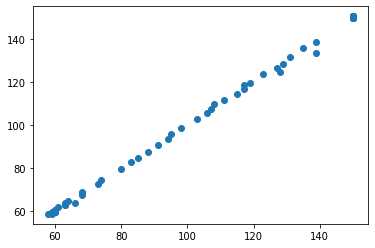

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99374293 0.63741821]]


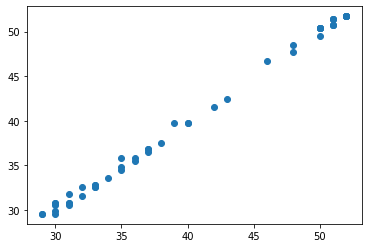

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.63170558]]
-------- 1 y up ->  center =  [[1.59193204]]
-------- 1 y up ->  right  =  [[2.0231941]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[54 -3]]
		 _X_center =  [[107  -3]]
		 _X_right  =  [[41 -3]]
		 predicted_left   =  [[63.25157373]]
		 predicted_center =  [[105.68917265]]
		 predicted_right  =  [[39.22323833]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92061151 -2.70686456]]
		 regression_center.coef_ =  [[1.00112606 0.50553038]]
		 regression_right.coef_  =  [[0.99

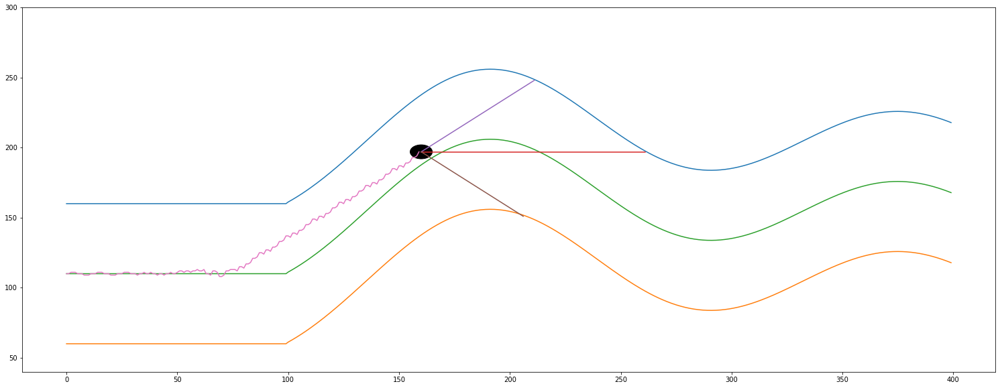

------------------------------ IF i % 3 == 1 ------------------------------
# i =  160
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 52 102  47]]
actual predicted =  [[4.83086978]]
actual self.y_distance[-1] =  9.321952441913226
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359686

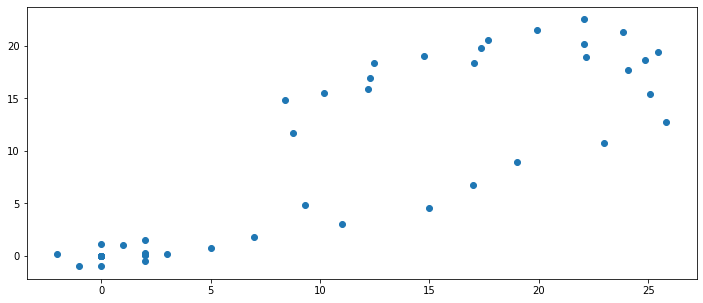

(161, 1)
(161, 1)


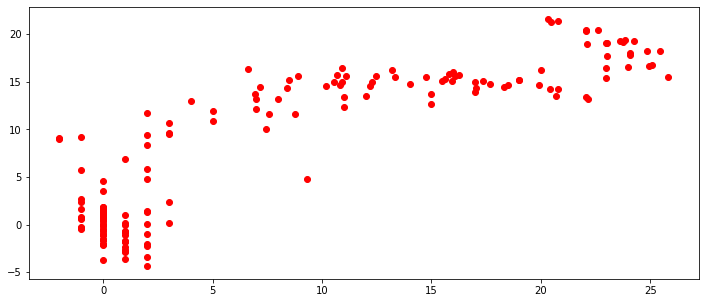

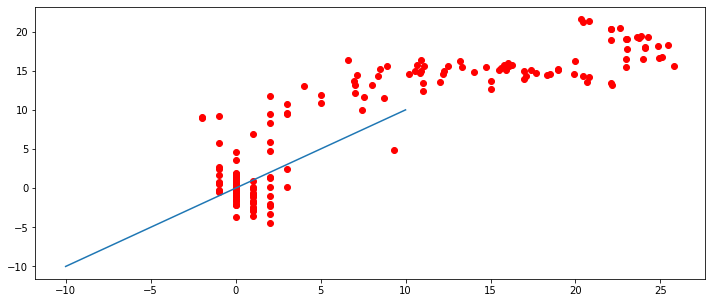

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
197.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

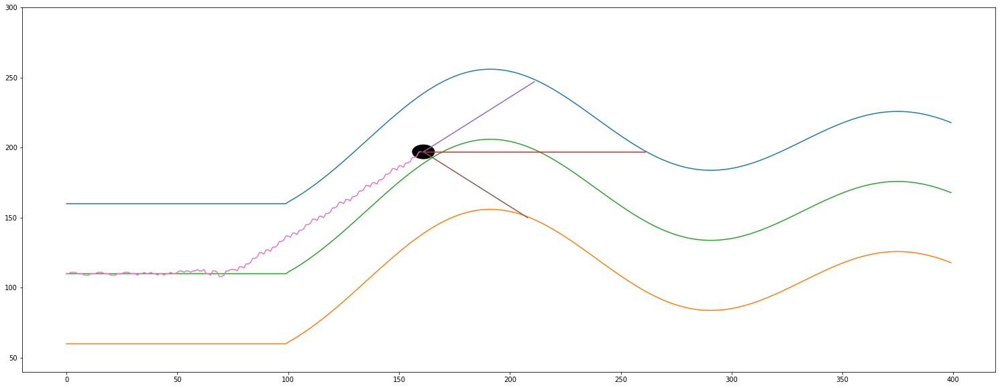

------------------------------ IF i % 3 == 2 ------------------------------
# i =  161
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  102
Sensor from left wall =  52
Sensor from right wall =  46
most távolsagra van a felső faltól =  42.76902782313368
most távolsagra van az alsó faltól =  57.23097217686632
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  161
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  7.230972176866317
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  7.230972176866317
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  162
			 len(self.sensor_left)   =  162
			 len(self.sensor_center) =  162
			 len(self.sens

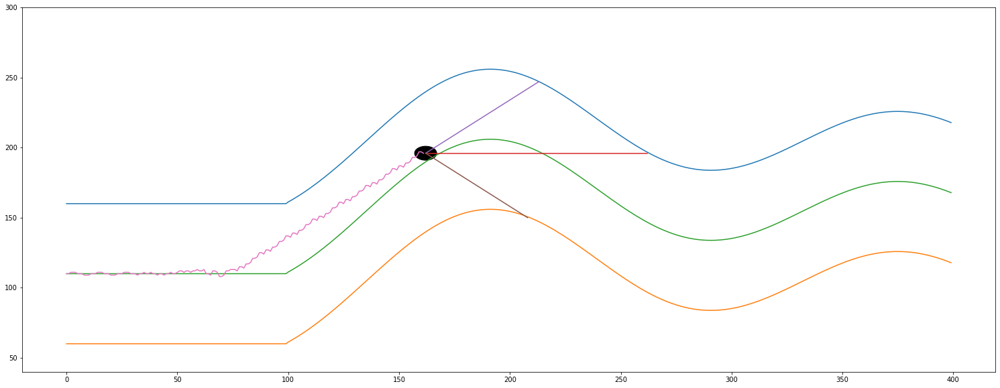

------------------------------ IF i % 3 == 0 ------------------------------
# i =  162
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (163, 3)
y.shape =  (163, 1)
i       =  162
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  162
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(54, 4)
(54, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), array([1

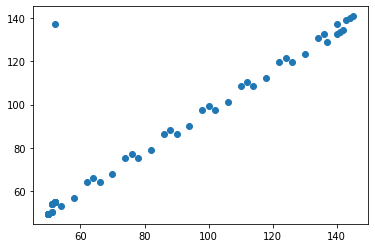

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1.00114809 0.48133265]]


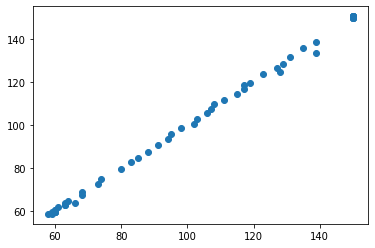

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.9911804  0.66340015]]


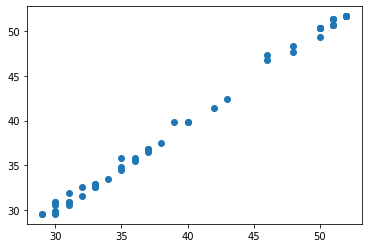

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.47907177]]
-------- 1 y up ->  center =  [[1.58974487]]
-------- 1 y up ->  right  =  [[2.12370215]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[52 -3]]
		 _X_center =  [[101  -3]]
		 _X_right  =  [[47 -3]]
		 predicted_left   =  [[61.12071776]]
		 predicted_center =  [[99.77922352]]
		 predicted_right  =  [[45.06439989]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92233294 -2.65066649]]
		 regression_center.coef_ =  [[1.00114809 0.48133265]]
		 regression_right.coef_  =  [[0.99

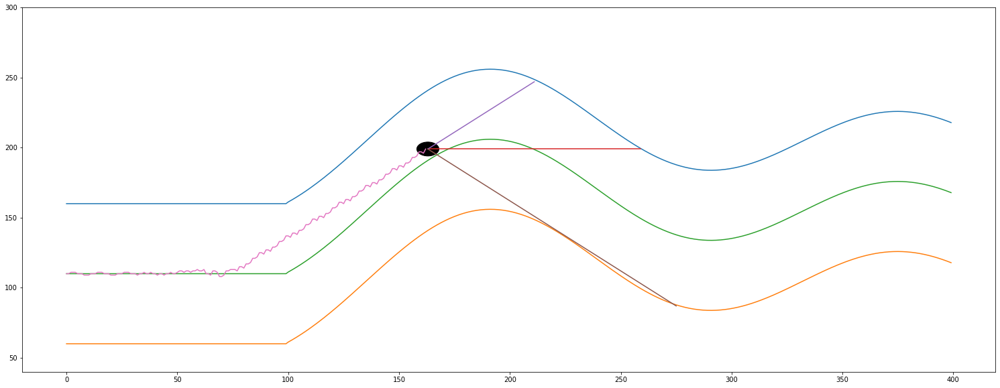

------------------------------ IF i % 3 == 1 ------------------------------
# i =  163
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 49  97 113]]
actual predicted =  [[-57.25298323]]
actual self.y_distance[-1] =  8.130968715561153
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

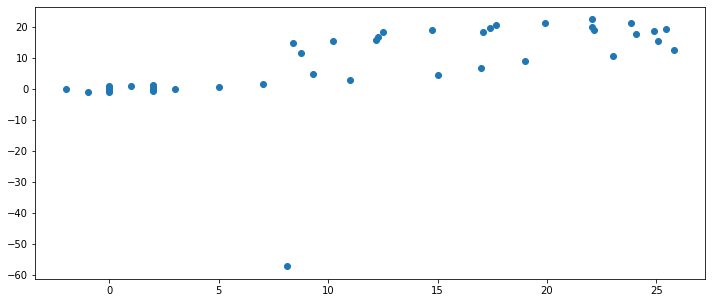

(164, 1)
(164, 1)


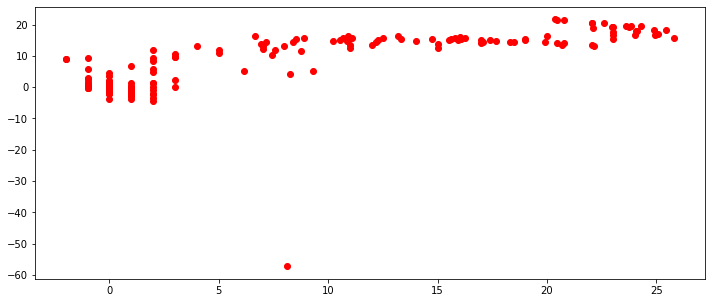

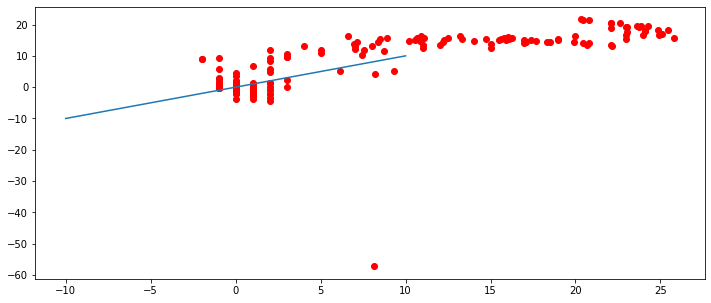

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
199.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

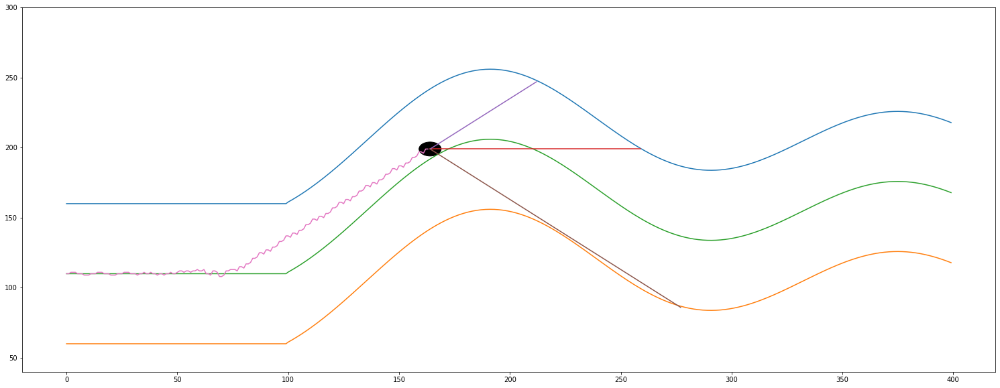

------------------------------ IF i % 3 == 2 ------------------------------
# i =  164
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  97
Sensor from left wall =  50
Sensor from right wall =  112
most távolsagra van a felső faltól =  43.876362473433716
most távolsagra van az alsó faltól =  56.123637526566284
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  164
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  6.123637526566284
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  6.123637526566284
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  165
			 len(self.sensor_left)   =  165
			 len(self.sensor_center) =  165
			 len(self.s

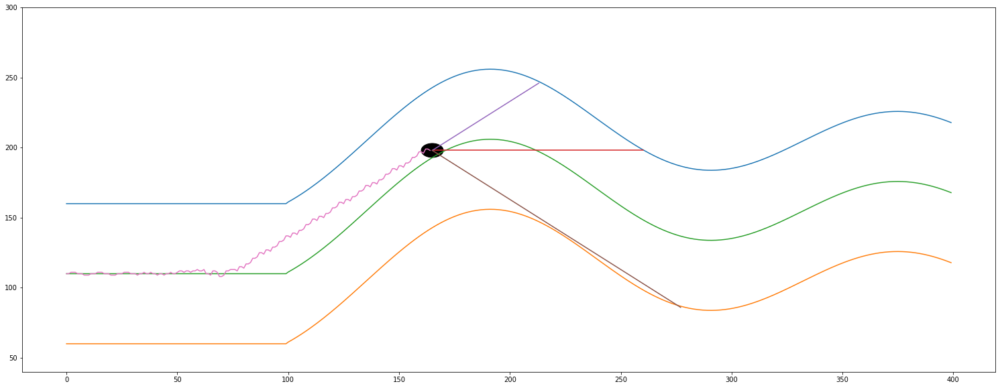

------------------------------ IF i % 3 == 0 ------------------------------
# i =  165
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (166, 3)
y.shape =  (166, 1)
i       =  165
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  165
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.]
(55, 4)
(55, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]), arr

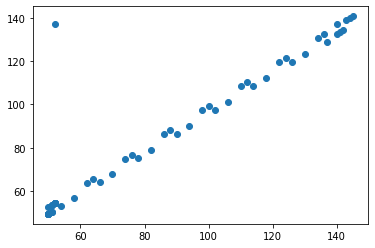

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1.0010659 0.4587804]]


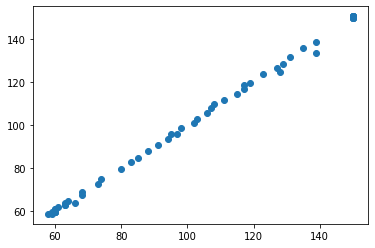

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.98501209 0.66736152]]


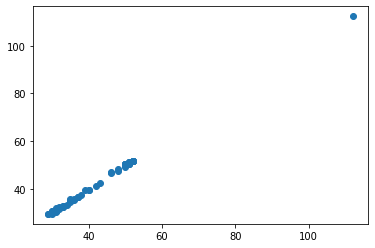

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.32868643]]
-------- 1 y up ->  center =  [[1.59790346]]
-------- 1 y up ->  right  =  [[2.3656369]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[49 -3]]
		 _X_center =  [[96 -3]]
		 _X_right  =  [[113  -3]]
		 predicted_left   =  [[58.07455189]]
		 predicted_center =  [[94.86404216]]
		 predicted_right  =  [[110.01754496]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92402902 -2.59811816]]
		 regression_center.coef_ =  [[1.0010659 0.4587804]]
		 regression_right.coef_  =  [[0.9850

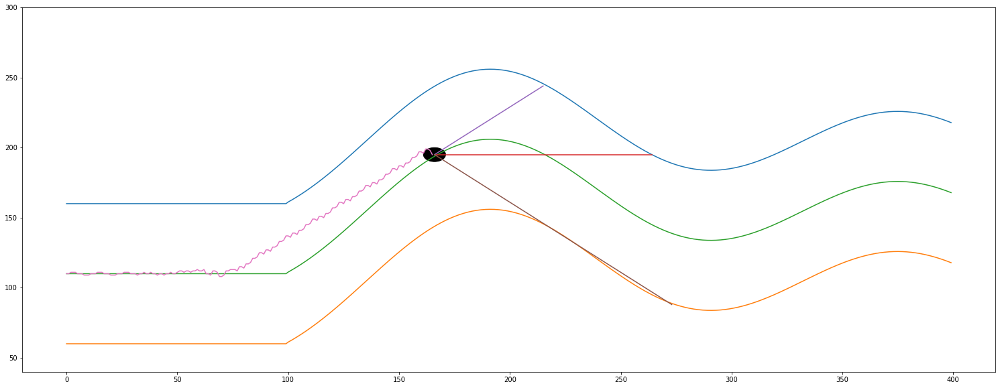

------------------------------ IF i % 3 == 1 ------------------------------
# i =  166
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 50  99 108]]
actual predicted =  [[-17.93547023]]
actual self.y_distance[-1] =  1.198358639975254
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

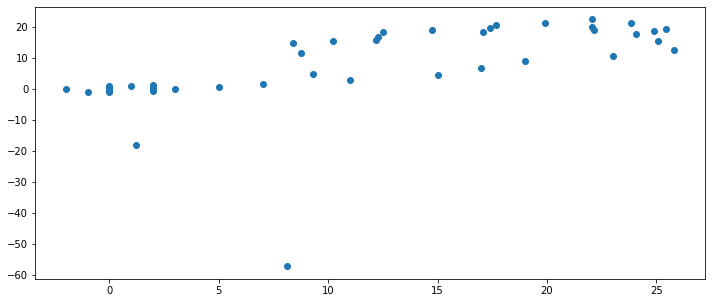

(167, 1)
(167, 1)


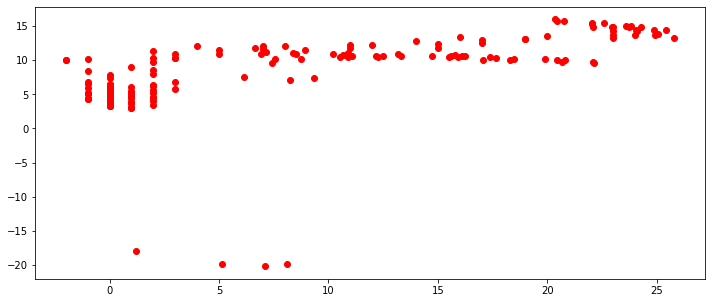

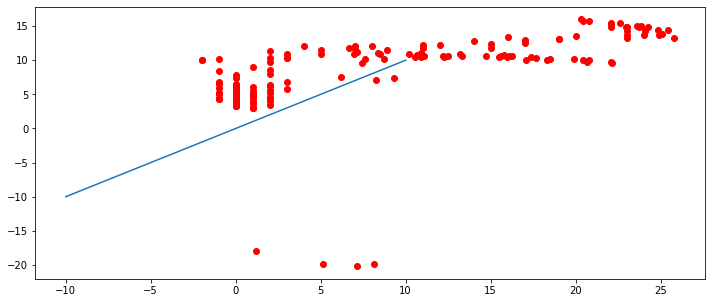

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
195.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

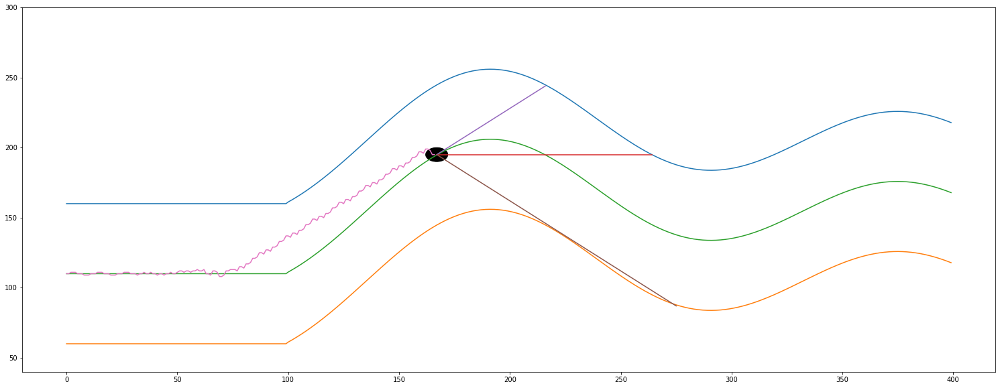

------------------------------ IF i % 3 == 2 ------------------------------
# i =  167
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  96
Sensor from left wall =  49
Sensor from right wall =  111
most távolsagra van a felső faltól =  48.71805096570682
most távolsagra van az alsó faltól =  51.28194903429318
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  167
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.2819490342931772
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.2819490342931772
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  168
			 len(self.sensor_left)   =  168
			 len(self.sensor_center) =  168
			 len(self.sen

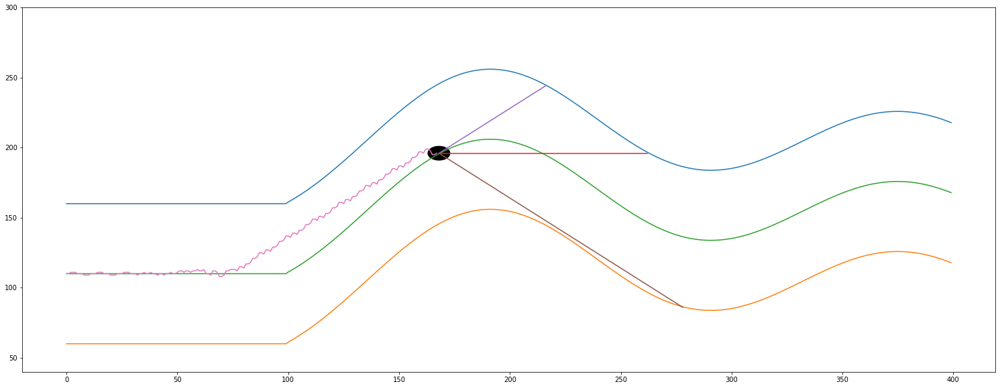

------------------------------ IF i % 3 == 0 ------------------------------
# i =  168
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (169, 3)
y.shape =  (169, 1)
i       =  168
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  168
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.]
(56, 4)
(56, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51.]),

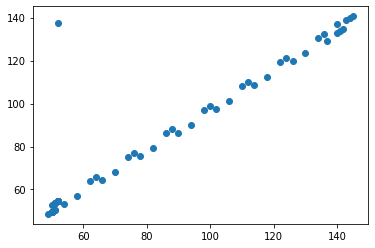

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1.00116512 0.41052703]]


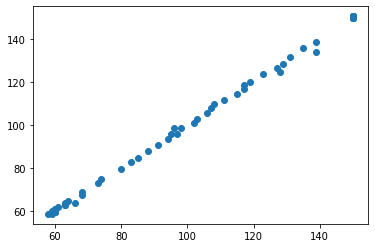

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99591992 0.71246425]]


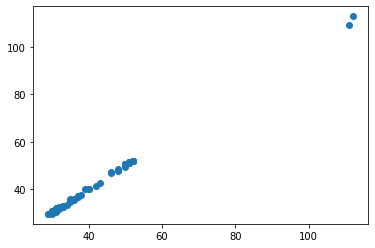

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.36138735]]
-------- 1 y up ->  center =  [[1.49158833]]
-------- 1 y up ->  right  =  [[1.99148044]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[49 -3]]
		 _X_center =  [[95 -3]]
		 _X_right  =  [[111  -3]]
		 predicted_left   =  [[58.06848531]]
		 predicted_center =  [[93.95900108]]
		 predicted_right  =  [[108.69281474]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92381545 -2.59098904]]
		 regression_center.coef_ =  [[1.00116512 0.41052703]]
		 regression_right.coef_  =  [[0.9

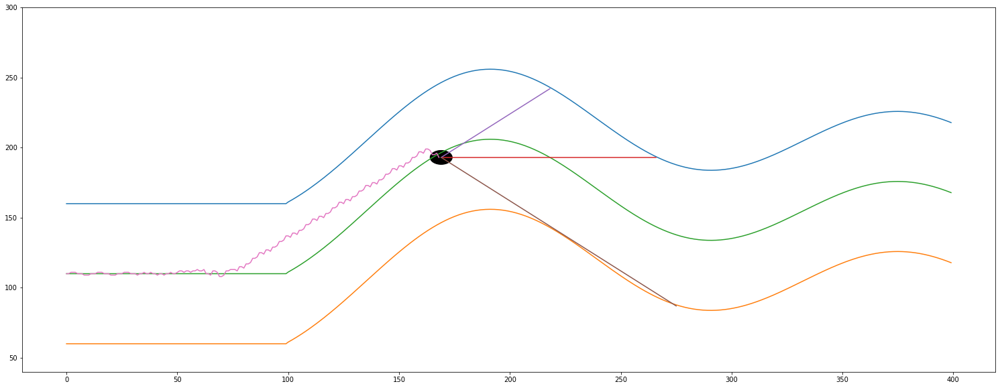

------------------------------ IF i % 3 == 1 ------------------------------
# i =  169
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 50  98 107]]
actual predicted =  [[-11.1625038]]
actual self.y_distance[-1] =  -3.45477287179105
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735968

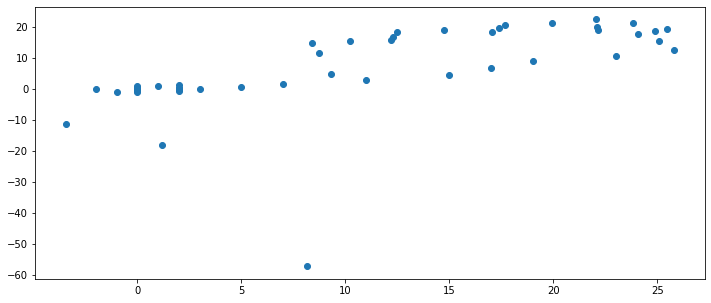

(170, 1)
(170, 1)


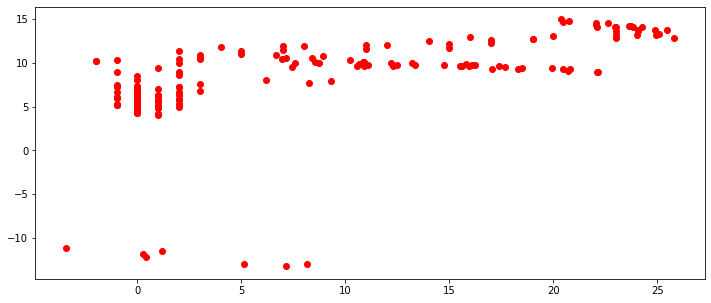

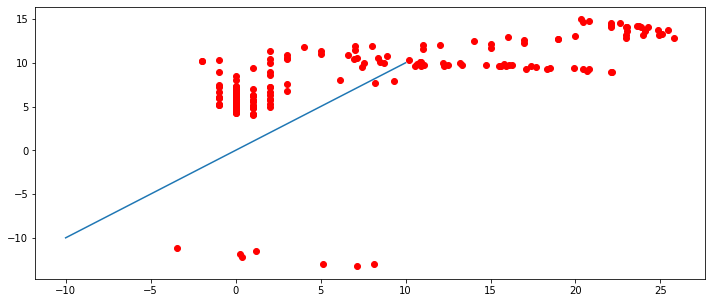

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
193.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

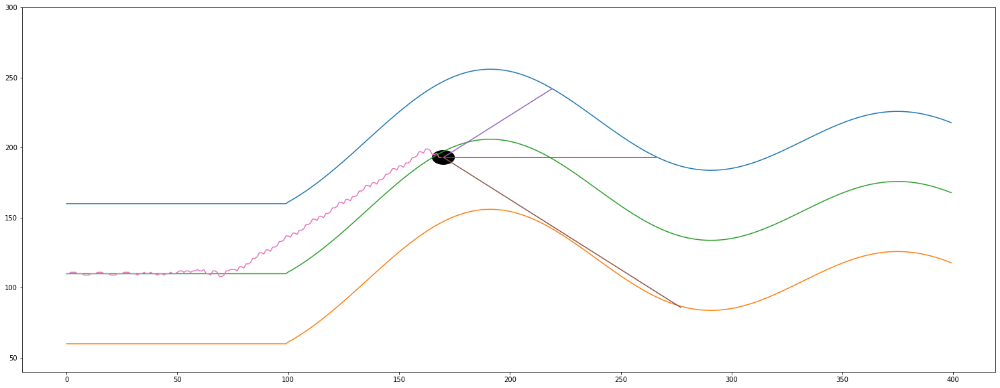

------------------------------ IF i % 3 == 2 ------------------------------
# i =  170
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  96
Sensor from left wall =  49
Sensor from right wall =  109
most távolsagra van a felső faltól =  53.273716619077106
most távolsagra van az alsó faltól =  46.726283380922894
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  170
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -3.2737166190771063
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -3.2737166190771063
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  171
			 len(self.sensor_left)   =  171
			 len(self.sensor_center) =  171
			 len(self.

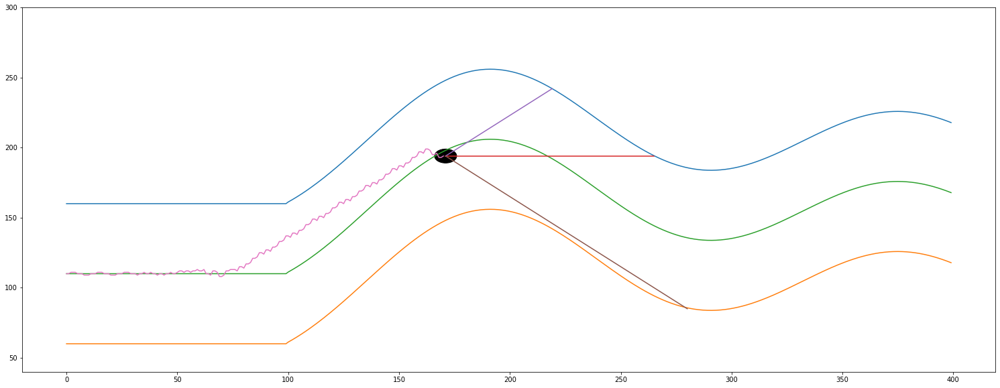

------------------------------ IF i % 3 == 0 ------------------------------
# i =  171
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (172, 3)
y.shape =  (172, 1)
i       =  171
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  171
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1.]
(57, 4)
(57, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,  51

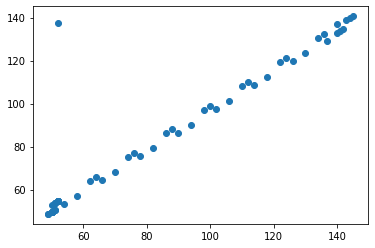

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1.00124807 0.38287274]]


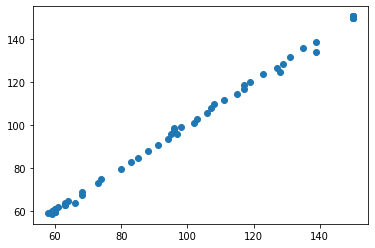

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.9974953  0.71906723]]


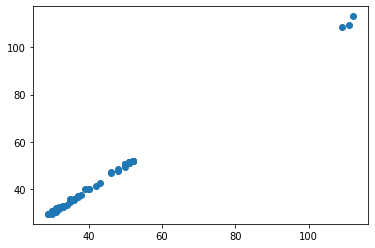

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.39059343]]
-------- 1 y up ->  center =  [[1.42807949]]
-------- 1 y up ->  right  =  [[1.93762026]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[49 -3]]
		 _X_center =  [[95 -3]]
		 _X_right  =  [[110  -3]]
		 predicted_left   =  [[58.06306708]]
		 predicted_center =  [[94.01390677]]
		 predicted_right  =  [[107.78833905]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92362472 -2.58462183]]
		 regression_center.coef_ =  [[1.00124807 0.38287274]]
		 regression_right.coef_  =  [[0.9

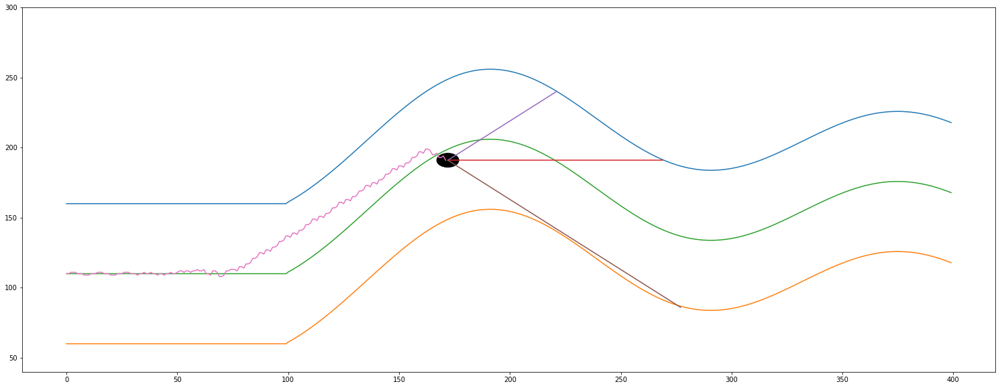

------------------------------ IF i % 3 == 1 ------------------------------
# i =  172
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 50  98 106]]
actual predicted =  [[-9.01642008]]
actual self.y_distance[-1] =  -7.809573885023099
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

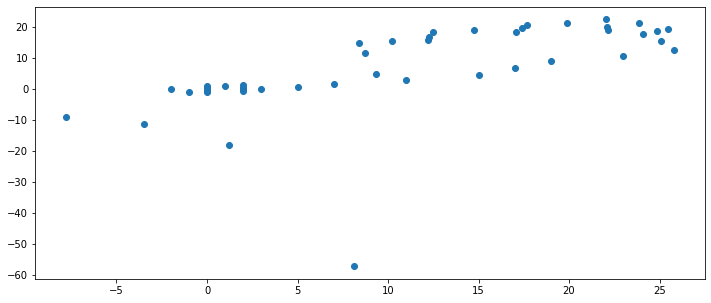

(173, 1)
(173, 1)


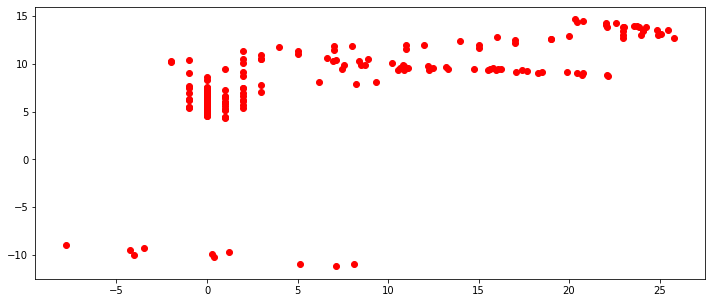

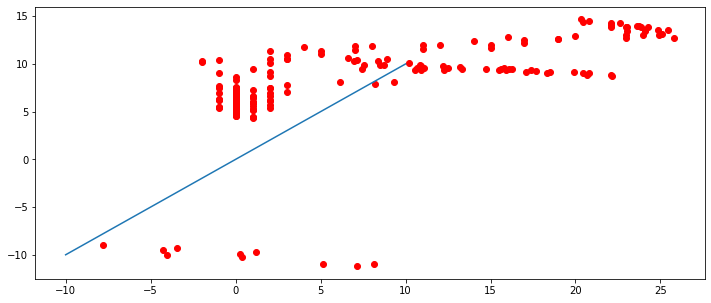

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
191.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

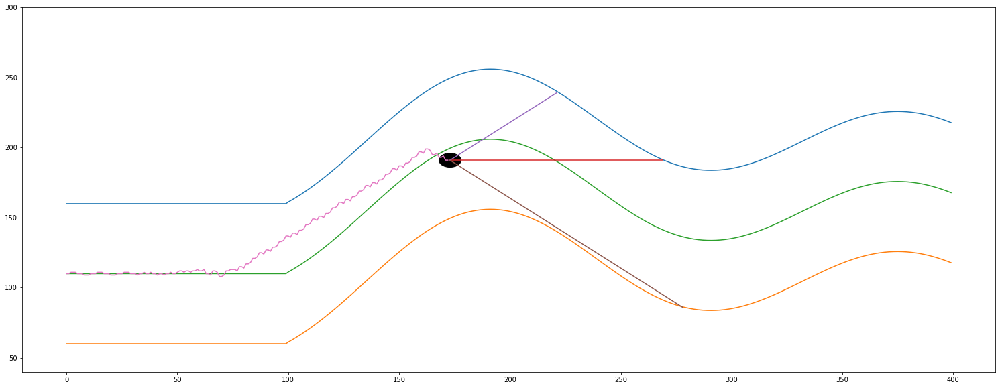

------------------------------ IF i % 3 == 2 ------------------------------
# i =  173
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  99
Sensor from left wall =  50
Sensor from right wall =  105
most távolsagra van a felső faltól =  59.525302359199316
most távolsagra van az alsó faltól =  40.474697640800684
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  173
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -9.525302359199316
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -9.525302359199316
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  174
			 len(self.sensor_left)   =  174
			 len(self.sensor_center) =  174
			 len(self.

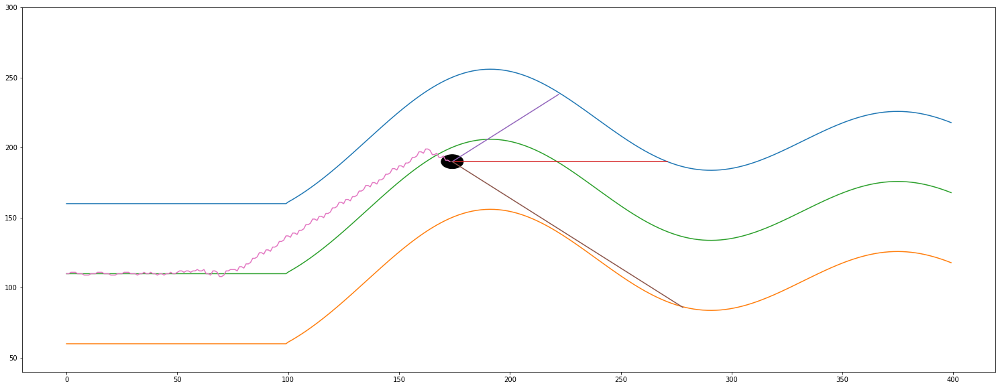

------------------------------ IF i % 3 == 0 ------------------------------
# i =  174
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (175, 3)
y.shape =  (175, 1)
i       =  174
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  174
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1.]
(58, 4)
(58, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 120.,

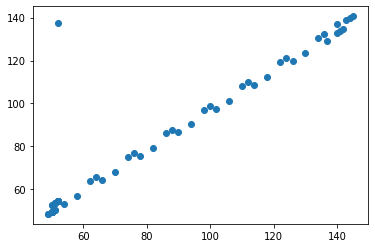

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1.00114495 0.34464992]]


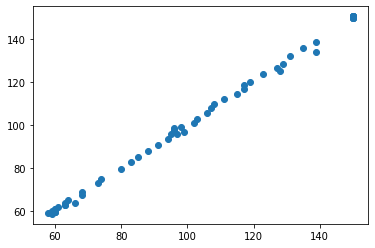

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.9968348  0.72288276]]


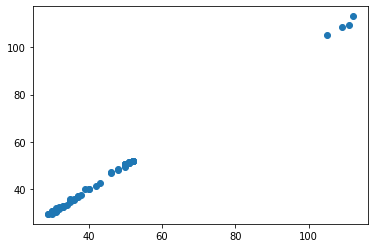

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.26509285]]
-------- 1 y up ->  center =  [[1.43829545]]
-------- 1 y up ->  right  =  [[1.9666369]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[49 -3]]
		 _X_center =  [[98 -3]]
		 _X_right  =  [[105  -3]]
		 predicted_left   =  [[57.81071431]]
		 predicted_center =  [[97.17075559]]
		 predicted_right  =  [[102.74592461]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.9250852  -2.53538302]]
		 regression_center.coef_ =  [[1.00114495 0.34464992]]
		 regression_right.coef_  =  [[0.99

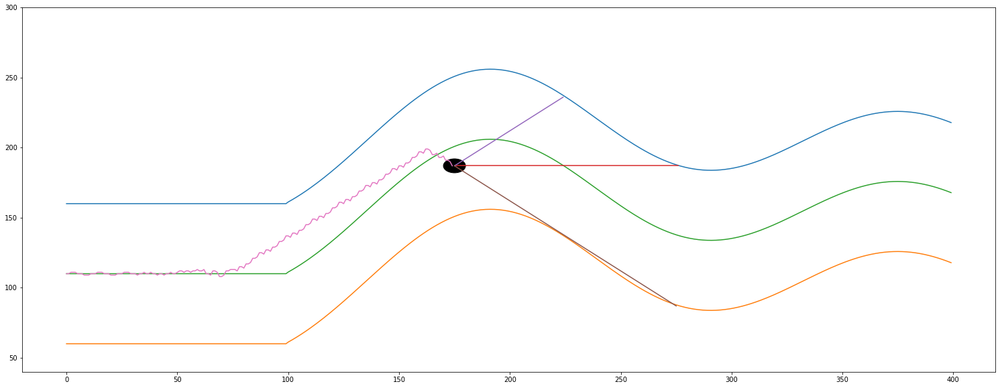

------------------------------ IF i % 3 == 1 ------------------------------
# i =  175
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 50 102 101]]
actual predicted =  [[-7.78970711]]
actual self.y_distance[-1] =  -13.849637706687048
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

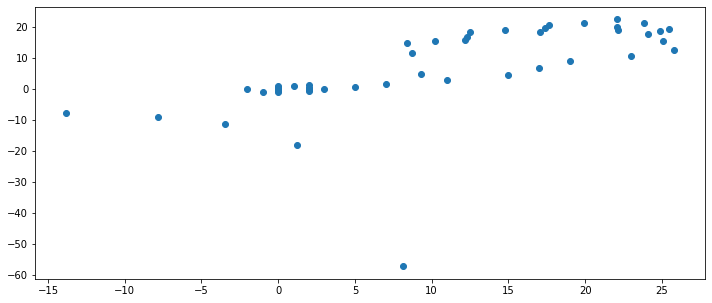

(176, 1)
(176, 1)


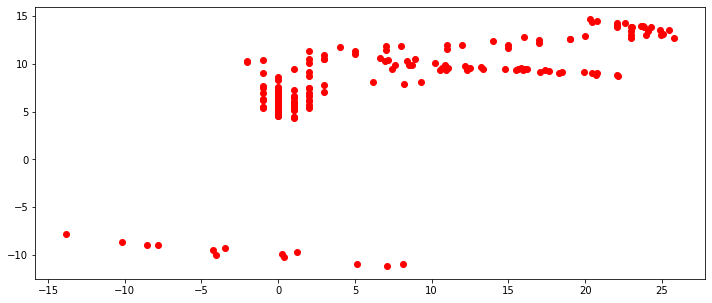

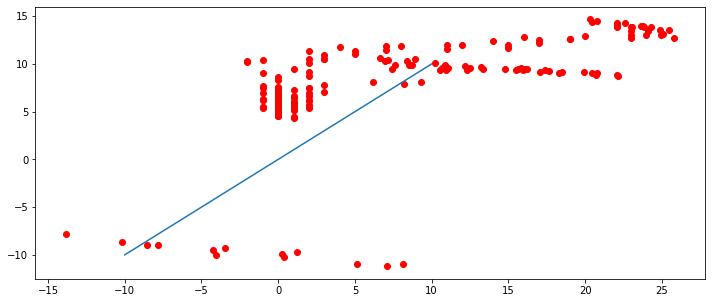

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
187.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

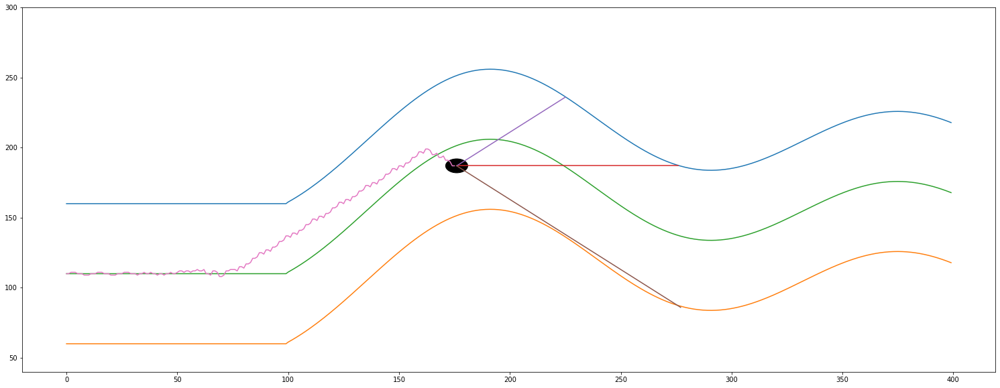

------------------------------ IF i % 3 == 2 ------------------------------
# i =  176
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  104
Sensor from left wall =  50
Sensor from right wall =  100
most távolsagra van a felső faltól =  65.45725522040692
most távolsagra van az alsó faltól =  34.54274477959308
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  176
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -15.457255220406921
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -15.457255220406921
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  177
			 len(self.sensor_left)   =  177
			 len(self.sensor_center) =  177
			 len(sel

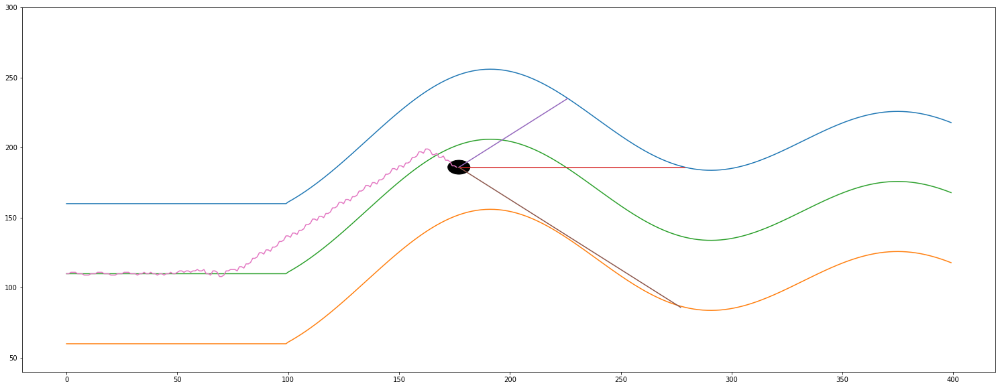

------------------------------ IF i % 3 == 0 ------------------------------
# i =  177
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (178, 3)
y.shape =  (178, 1)
i       =  177
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  177
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.]
(59, 4)
(59, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51., 1

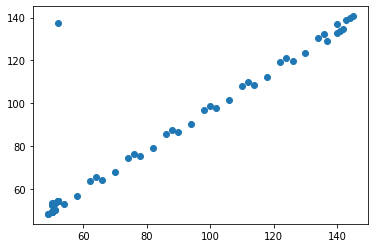

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[1.00120838 0.29236623]]


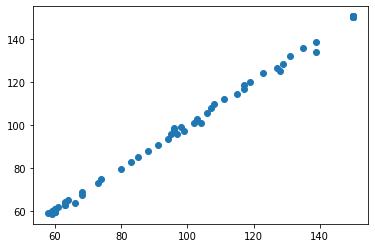

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99418316 0.73936396]]


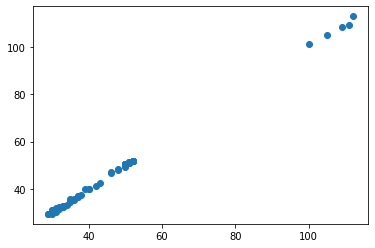

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.11810735]]
-------- 1 y up ->  center =  [[1.43201093]]
-------- 1 y up ->  right  =  [[2.08312615]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[50 -3]]
		 _X_center =  [[103  -3]]
		 _X_right  =  [[101  -3]]
		 predicted_left   =  [[58.43546946]]
		 predicted_center =  [[102.38580103]]
		 predicted_right  =  [[98.54398599]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.9267957  -2.47609319]]
		 regression_center.coef_ =  [[1.00120838 0.29236623]]
		 regression_right.coef_  =  [[0

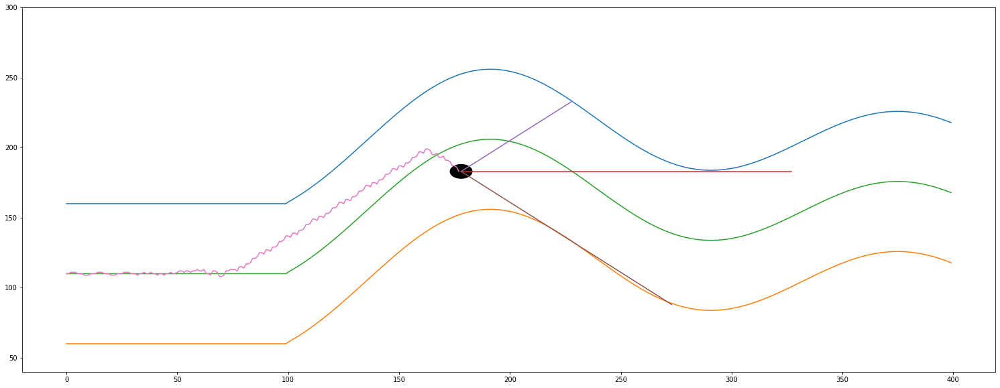

------------------------------ IF i % 3 == 1 ------------------------------
# i =  178
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 51 150  96]]
actual predicted =  [[-10.33569256]]
actual self.y_distance[-1] =  -19.561171257332603
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735

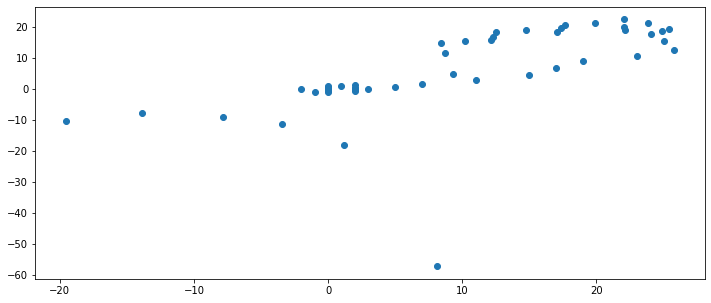

(179, 1)
(179, 1)


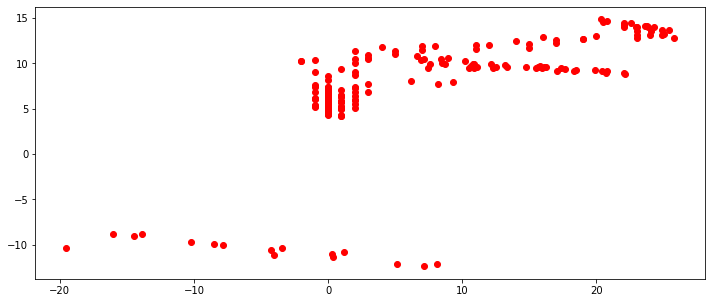

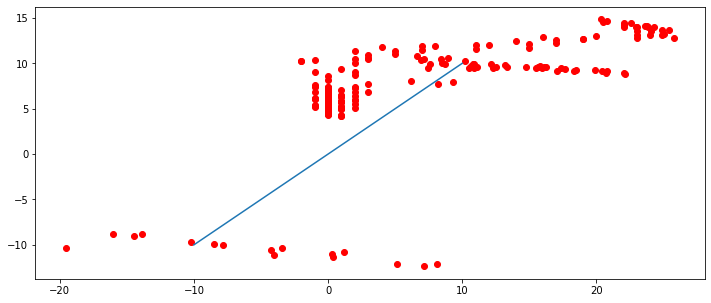

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
183.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

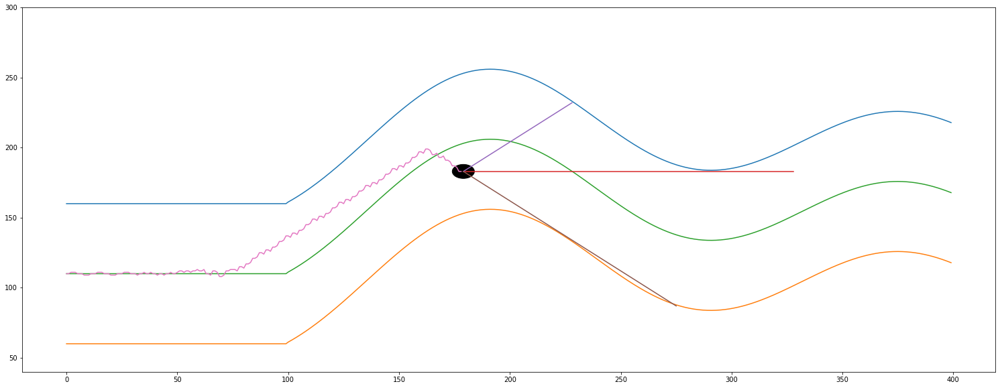

------------------------------ IF i % 3 == 2 ------------------------------
# i =  179
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  109
Sensor from left wall =  50
Sensor from right wall =  99
most távolsagra van a felső faltól =  69.05668636644177
most távolsagra van az alsó faltól =  30.943313633558233
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  179
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -19.056686366441767
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -19.056686366441767
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  180
			 len(self.sensor_left)   =  180
			 len(self.sensor_center) =  180
			 len(self.

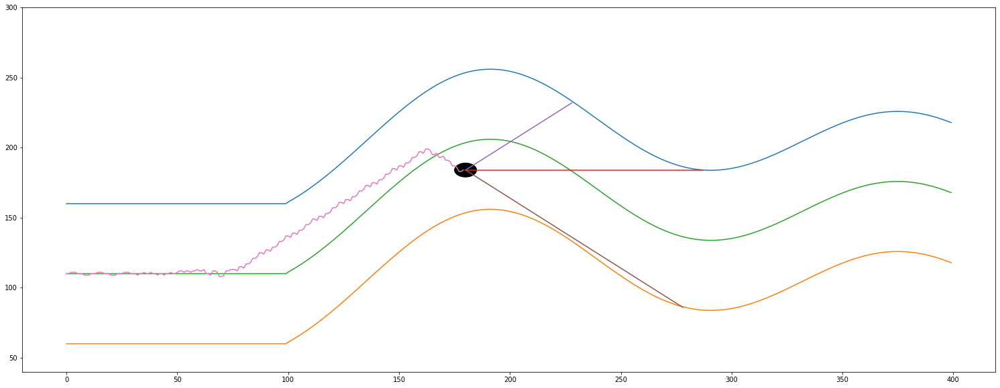

------------------------------ IF i % 3 == 0 ------------------------------
# i =  180
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (181, 3)
y.shape =  (181, 1)
i       =  180
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  180
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.]
(60, 4)
(60, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,  51

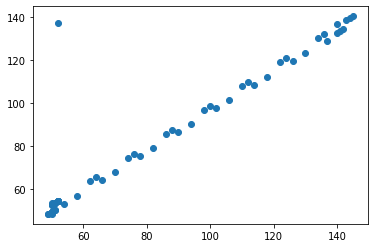

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.9686786  -0.36972265]]


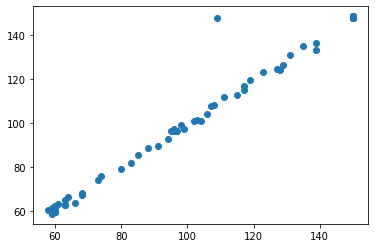

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99690677 0.76522316]]


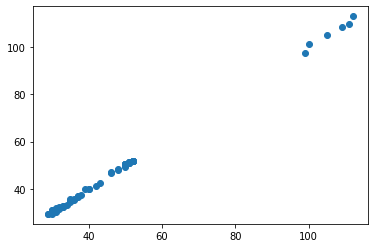

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.22554865]]
-------- 1 y up ->  center =  [[3.32177554]]
-------- 1 y up ->  right  =  [[2.00792404]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[49 -3]]
		 _X_center =  [[108  -3]]
		 _X_right  =  [[99 -3]]
		 predicted_left   =  [[57.48385171]]
		 predicted_center =  [[108.4492765]]
		 predicted_right  =  [[96.64389514]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92610529 -2.45131229]]
		 regression_center.coef_ =  [[ 0.9686786  -0.36972265]]
		 regression_right.coef_  =  [[0.

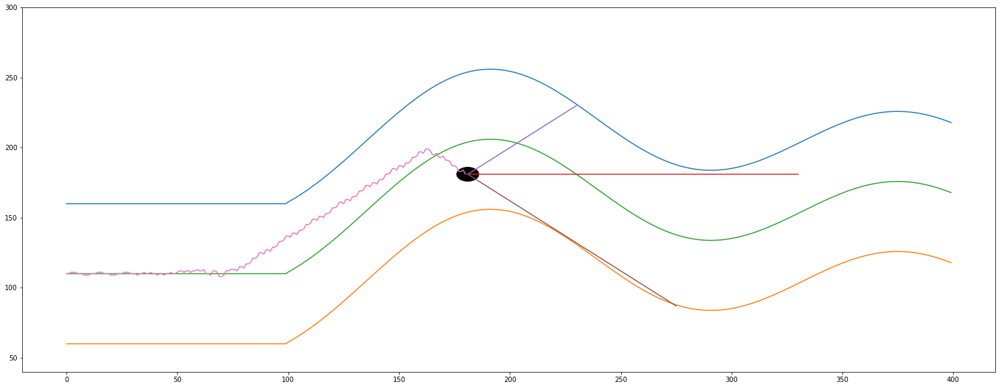

------------------------------ IF i % 3 == 1 ------------------------------
# i =  181
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 50 150  95]]
actual predicted =  [[-11.44976077]]
actual self.y_distance[-1] =  -22.93313786364942
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

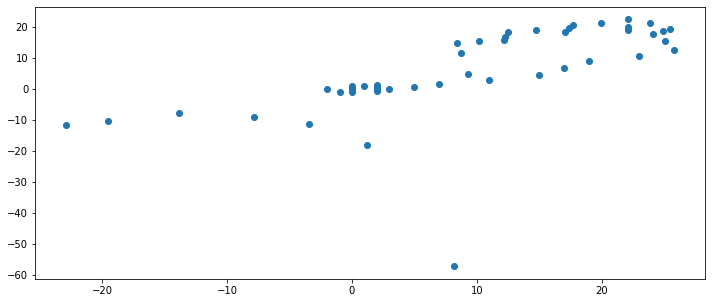

(182, 1)
(182, 1)


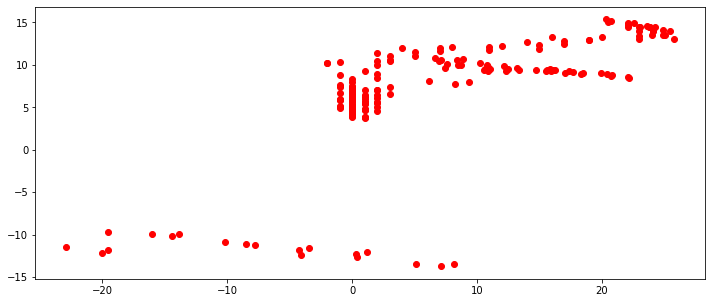

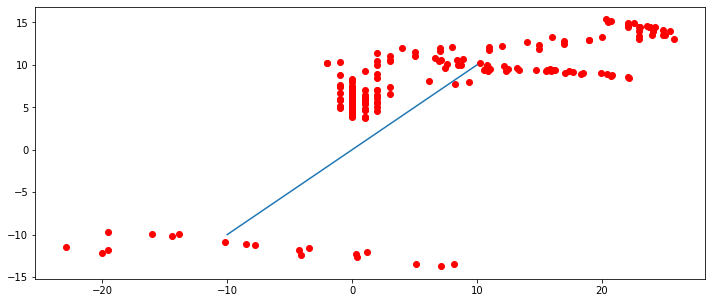

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
181.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

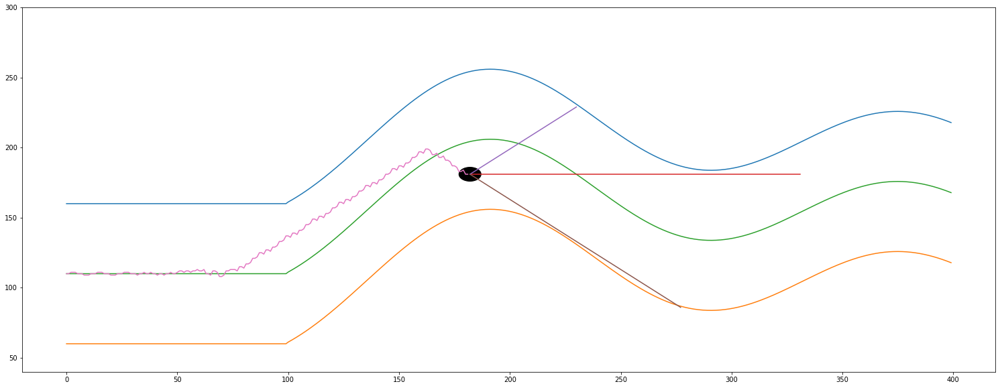

------------------------------ IF i % 3 == 2 ------------------------------
# i =  182
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor from left wall =  49
Sensor from right wall =  97
most távolsagra van a felső faltól =  72.3135050251075
most távolsagra van az alsó faltól =  27.686494974892497
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  182
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -22.313505025107503
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -22.313505025107503
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  183
			 len(self.sensor_left)   =  183
			 len(self.sensor_center) =  183
			 len(self.sensor_right)  =  183
	

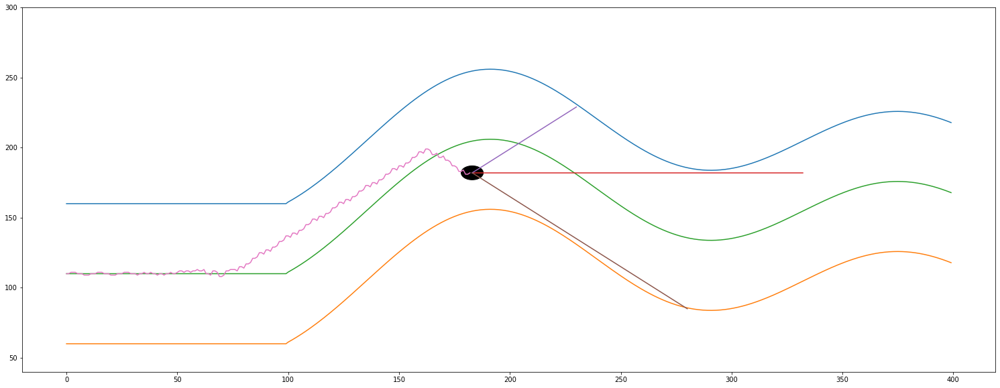

------------------------------ IF i % 3 == 0 ------------------------------
# i =  183
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (184, 3)
y.shape =  (184, 1)
i       =  183
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  183
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1.]
(61, 4)
(61, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([110.,

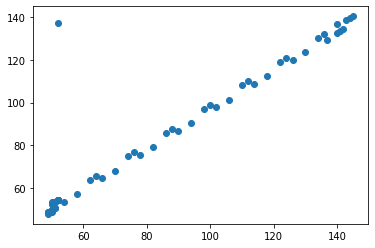

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97039023 -0.33488532]]


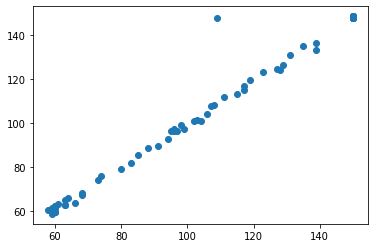

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99736766 0.76968333]]


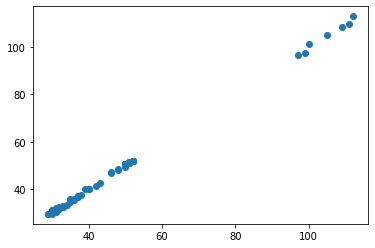

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.31890691]]
-------- 1 y up ->  center =  [[3.22234122]]
-------- 1 y up ->  right  =  [[1.99536721]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[48 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[98 -3]]
		 predicted_left   =  [[56.53768809]]
		 predicted_center =  [[149.15002689]]
		 predicted_right  =  [[95.66129656]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92549783 -2.43009577]]
		 regression_center.coef_ =  [[ 0.97039023 -0.33488532]]
		 regression_right.coef_  =  [[0

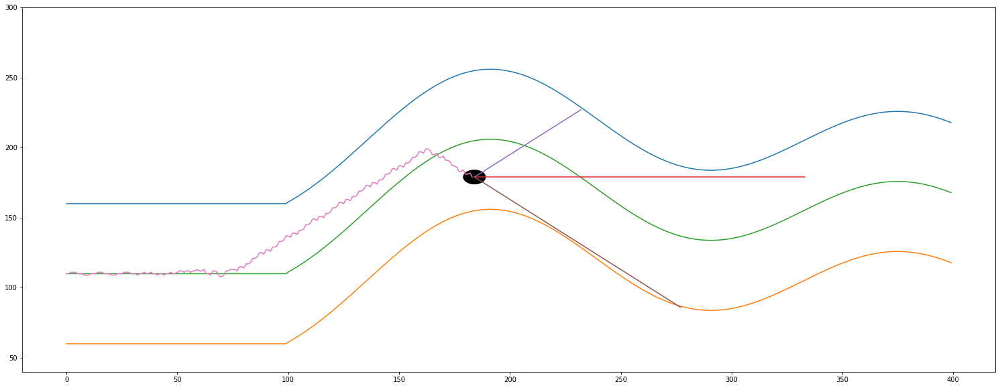

------------------------------ IF i % 3 == 1 ------------------------------
# i =  184
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 49 150  94]]
actual predicted =  [[-12.61686811]]
actual self.y_distance[-1] =  -25.9573730387705
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

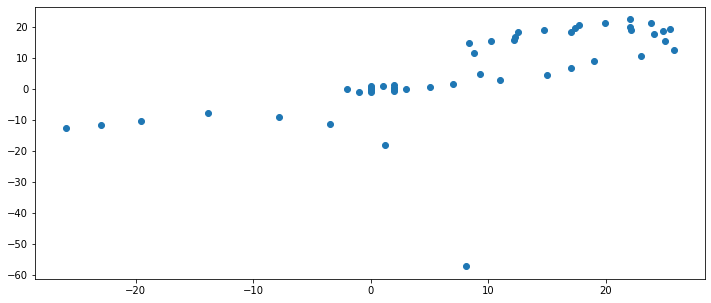

(185, 1)
(185, 1)


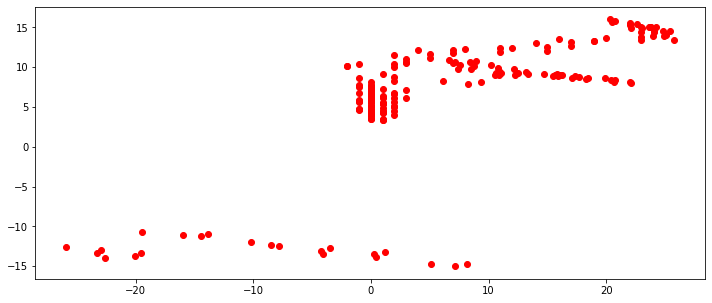

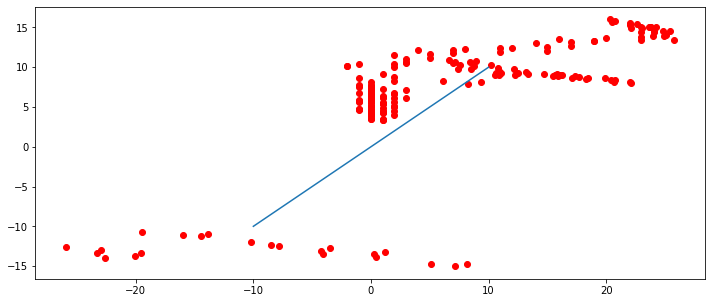

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
179.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

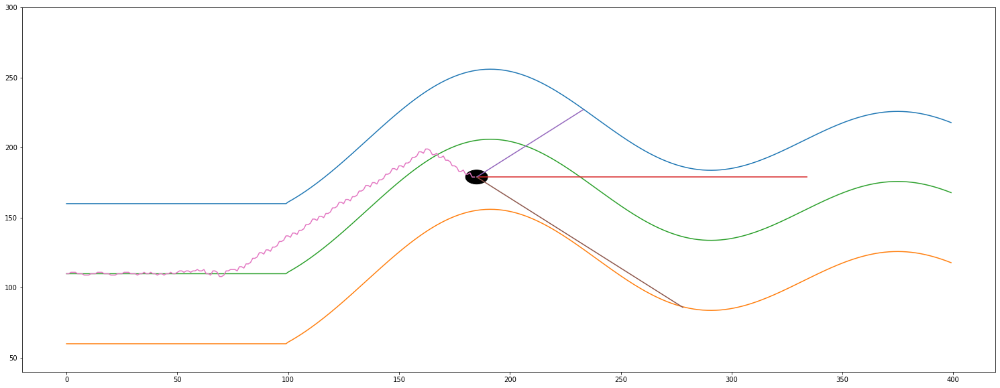

------------------------------ IF i % 3 == 2 ------------------------------
# i =  185
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor from left wall =  49
Sensor from right wall =  93
most távolsagra van a felső faltól =  77.22052499225327
most távolsagra van az alsó faltól =  22.779475007746726
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  185
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -27.220524992253274
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -27.220524992253274
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  186
			 len(self.sensor_left)   =  186
			 len(self.sensor_center) =  186
			 len(self.sensor_right)  =  18

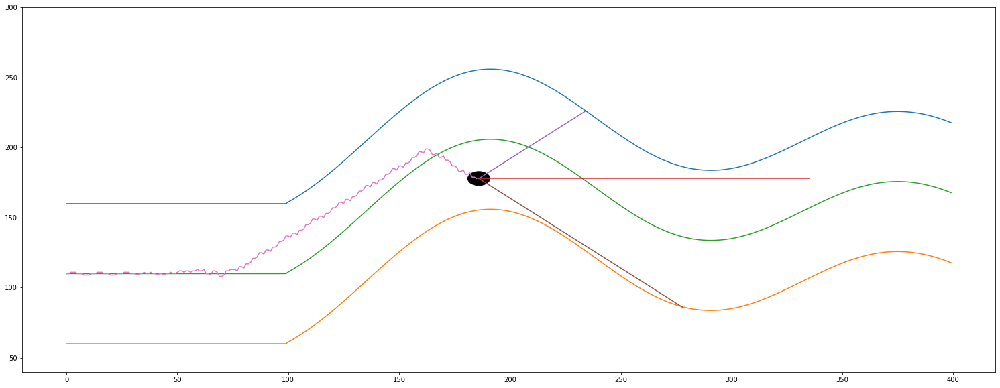

------------------------------ IF i % 3 == 0 ------------------------------
# i =  186
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (187, 3)
y.shape =  (187, 1)
i       =  186
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  186
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1.]
(62, 4)
(62, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), array([1

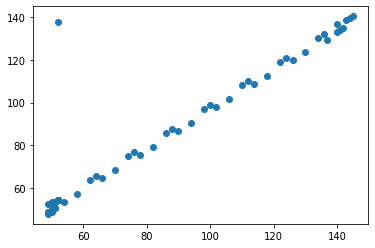

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97150153 -0.36043691]]


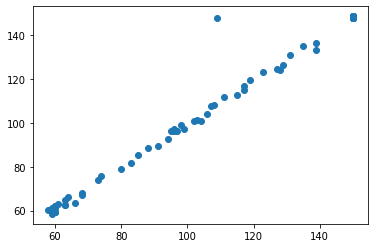

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99706853 0.77296422]]


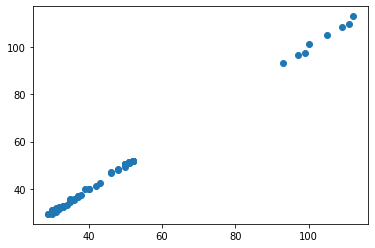

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.18598144]]
-------- 1 y up ->  center =  [[3.10866618]]
-------- 1 y up ->  right  =  [[2.00950354]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[49 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[93 -3]]
		 predicted_left   =  [[57.17687649]]
		 predicted_center =  [[149.30414166]]
		 predicted_right  =  [[90.64795103]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92708945 -2.37265041]]
		 regression_center.coef_ =  [[ 0.97150153 -0.36043691]]
		 regression_right.coef_  =  [[0

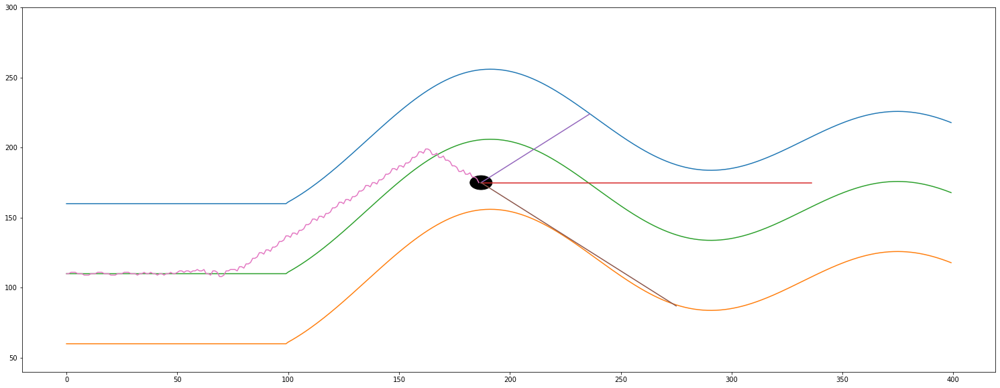

------------------------------ IF i % 3 == 1 ------------------------------
# i =  187
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 50 150  89]]
actual predicted =  [[-12.42232163]]
actual self.y_distance[-1] =  -30.628672086741744
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735

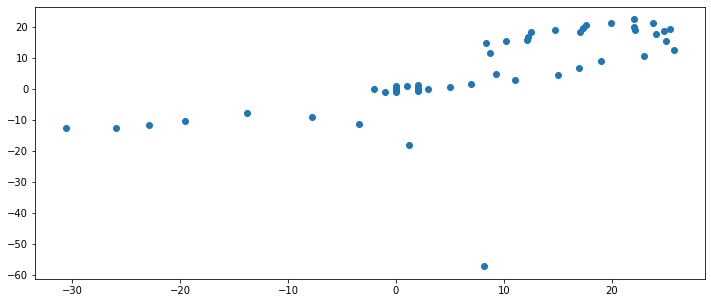

(188, 1)
(188, 1)


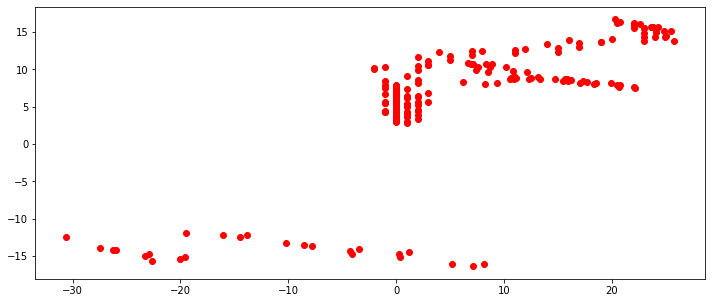

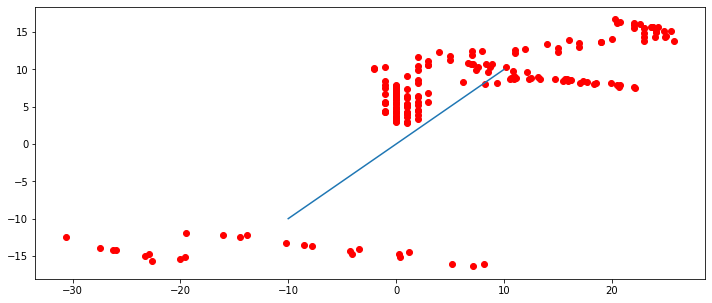

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
175.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

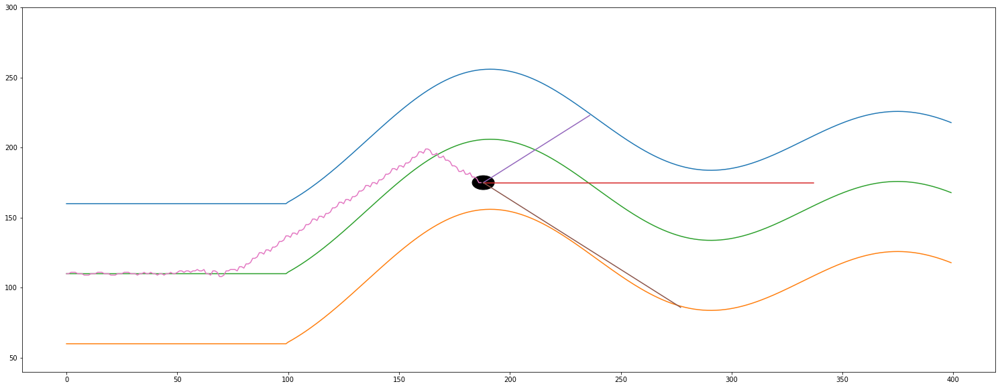

------------------------------ IF i % 3 == 2 ------------------------------
# i =  188
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor from left wall =  50
Sensor from right wall =  88
most távolsagra van a felső faltól =  81.77354263400463
most távolsagra van az alsó faltól =  18.226457365995373
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  188
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -31.773542634004627
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -31.773542634004627
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  189
			 len(self.sensor_left)   =  189
			 len(self.sensor_center) =  189
			 len(self.sensor_right)  =  1

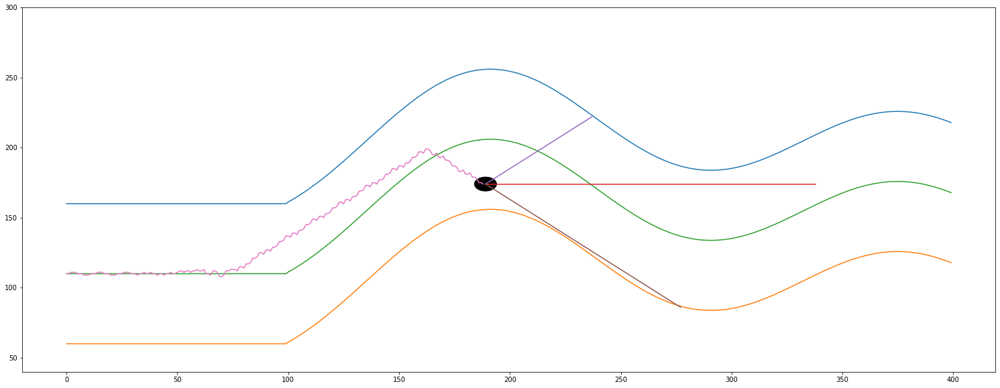

------------------------------ IF i % 3 == 0 ------------------------------
# i =  189
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (190, 3)
y.shape =  (190, 1)
i       =  189
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  189
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(63, 4)
(63, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), arra

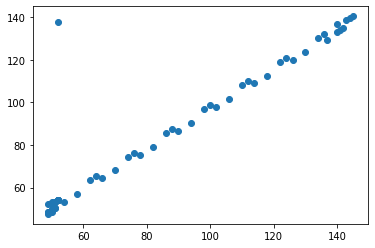

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97247174 -0.38274451]]


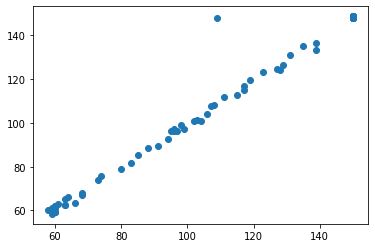

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99563842 0.79024228]]


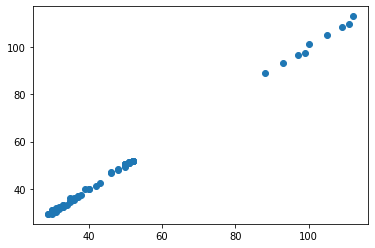

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.10034737]]
-------- 1 y up ->  center =  [[3.00942319]]
-------- 1 y up ->  right  =  [[2.07708745]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[49 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[89 -3]]
		 predicted_left   =  [[56.99242847]]
		 predicted_center =  [[149.43869019]]
		 predicted_right  =  [[86.53229951]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92811481 -2.33564261]]
		 regression_center.coef_ =  [[ 0.97247174 -0.38274451]]
		 regression_right.coef_  =  [[0

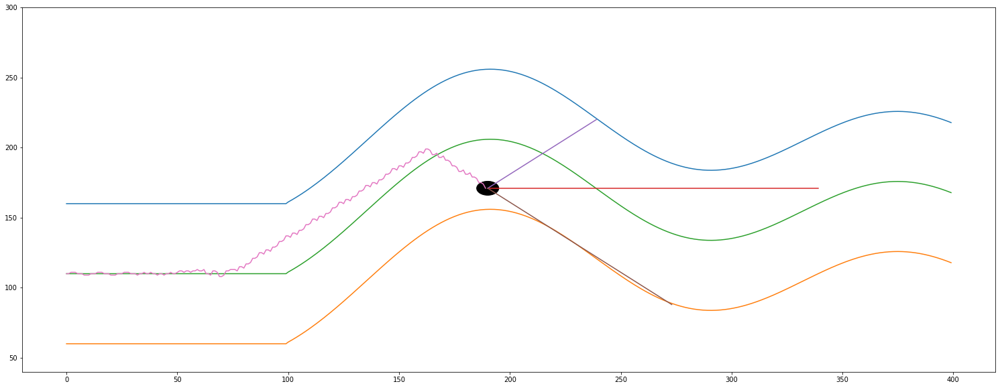

------------------------------ IF i % 3 == 1 ------------------------------
# i =  190
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 50 150  84]]
actual predicted =  [[-12.14454217]]
actual self.y_distance[-1] =  -34.94484864853618
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

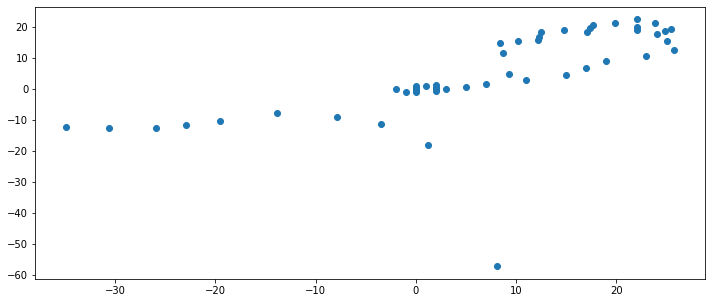

(191, 1)
(191, 1)


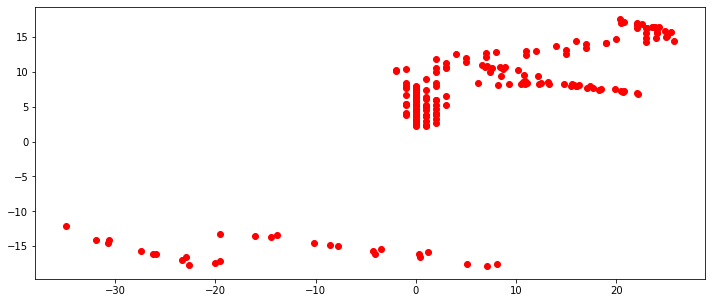

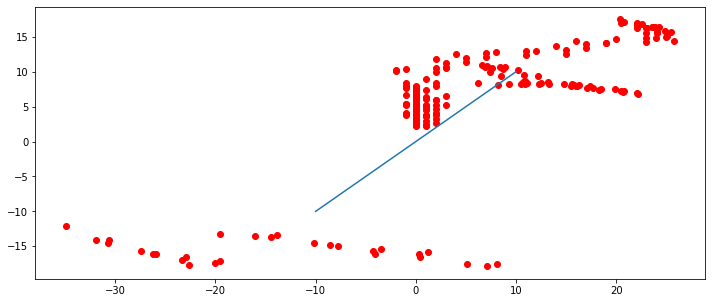

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
171.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

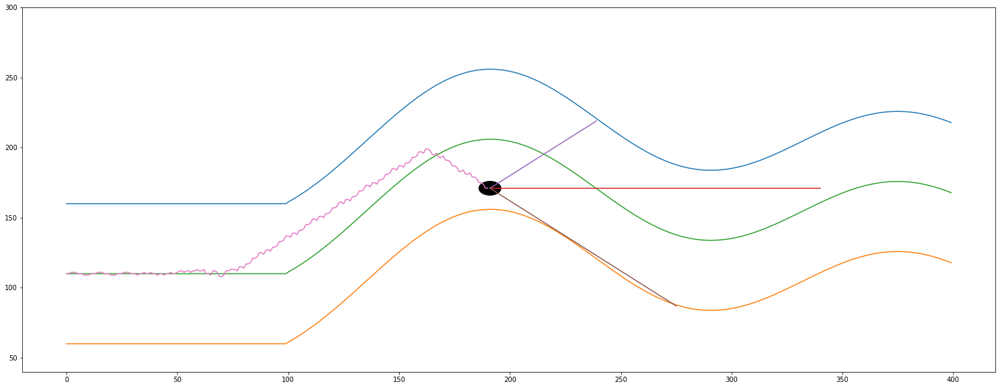

------------------------------ IF i % 3 == 2 ------------------------------
# i =  191
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor from left wall =  49
Sensor from right wall =  87
most távolsagra van a felső faltól =  83.97138560037499
most távolsagra van az alsó faltól =  16.028614399625013
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  191
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -33.97138560037499
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -33.97138560037499
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  192
			 len(self.sensor_left)   =  192
			 len(self.sensor_center) =  192
			 len(self.sensor_right)  =  192
	

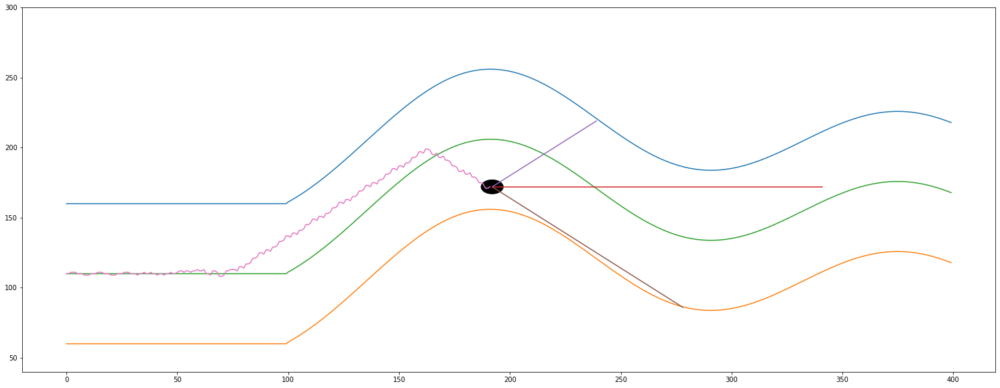

------------------------------ IF i % 3 == 0 ------------------------------
# i =  192
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (193, 3)
y.shape =  (193, 1)
i       =  192
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  192
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(64, 4)
(64, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.]), 

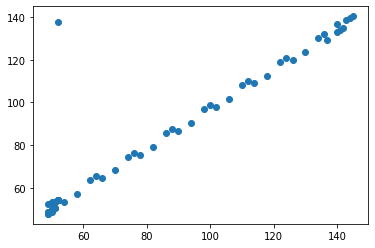

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97380829 -0.35126377]]


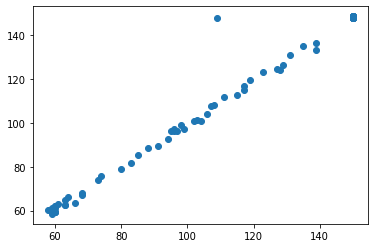

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99696354 0.81102922]]


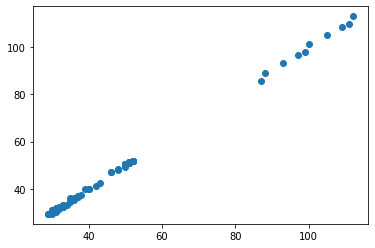

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.18986488]]
-------- 1 y up ->  center =  [[2.93613963]]
-------- 1 y up ->  right  =  [[2.05323356]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[48 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[87 -3]]
		 predicted_left   =  [[56.04152216]]
		 predicted_center =  [[149.43863031]]
		 predicted_right  =  [[84.54798129]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92754051 -2.31431333]]
		 regression_center.coef_ =  [[ 0.97380829 -0.35126377]]
		 regression_right.coef_  =  [[0

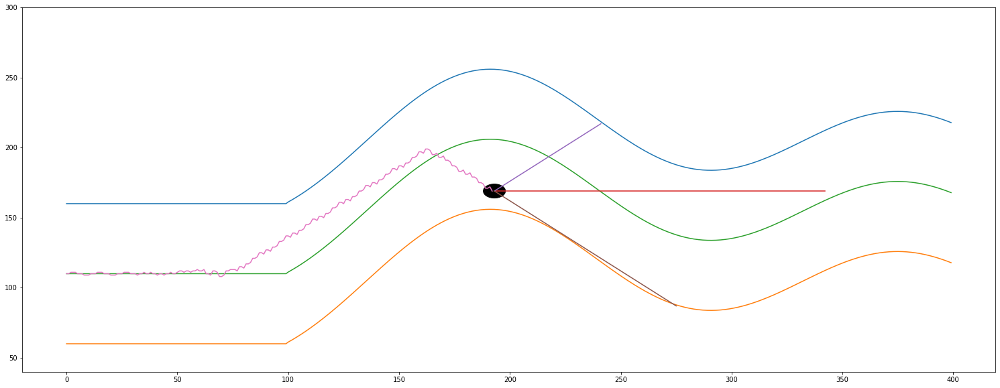

------------------------------ IF i % 3 == 1 ------------------------------
# i =  193
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 49 150  83]]
actual predicted =  [[-13.3173637]]
actual self.y_distance[-1] =  -36.906763596777694
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

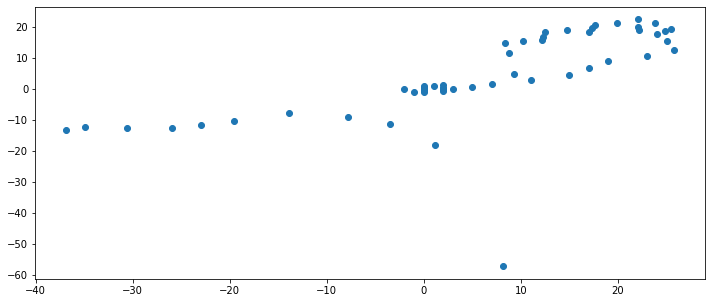

(194, 1)
(194, 1)


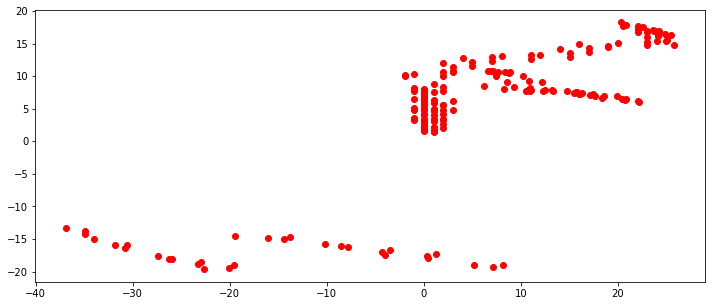

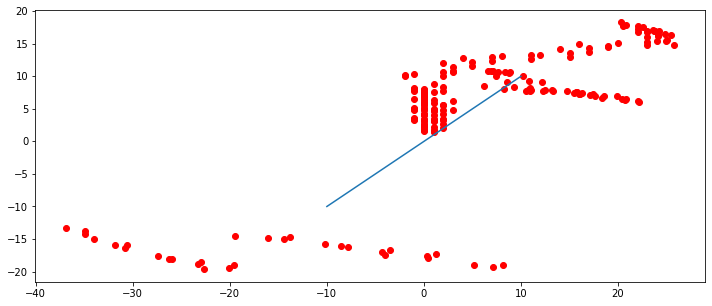

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
169.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

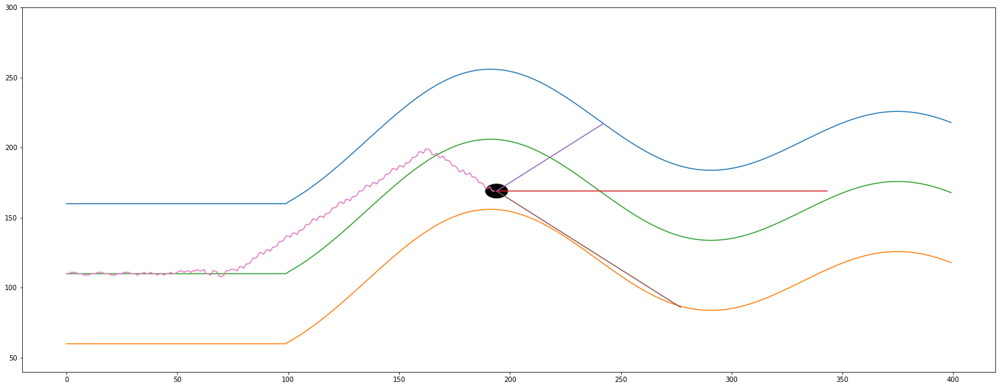

------------------------------ IF i % 3 == 2 ------------------------------
# i =  194
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor from left wall =  48
Sensor from right wall =  85
most távolsagra van a felső faltól =  85.81593175548227
most távolsagra van az alsó faltól =  14.184068244517732
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  194
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -35.81593175548227
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -35.81593175548227
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  195
			 len(self.sensor_left)   =  195
			 len(self.sensor_center) =  195
			 len(self.sensor_right)  =  195
		

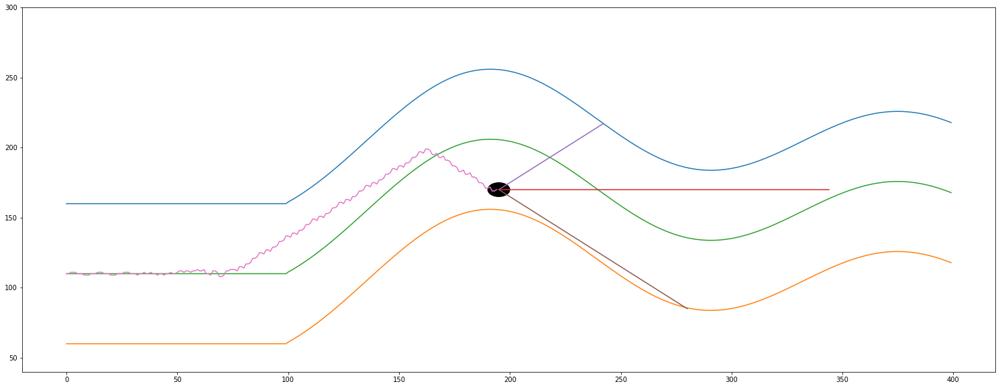

------------------------------ IF i % 3 == 0 ------------------------------
# i =  195
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (196, 3)
y.shape =  (196, 1)
i       =  195
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  195
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(65, 4)
(65, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124.,  52.

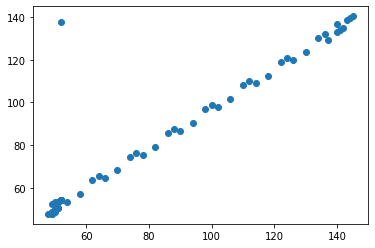

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97499317 -0.3233556 ]]


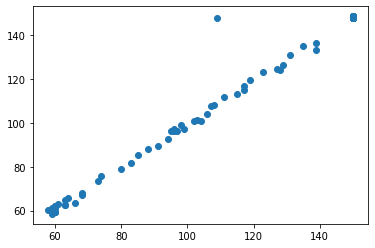

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99714986 0.81403381]]


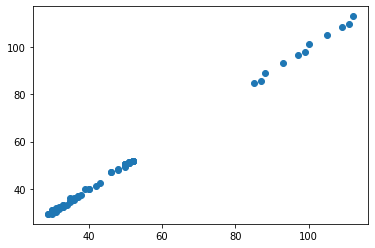

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.20813429]]
-------- 1 y up ->  center =  [[2.87117263]]
-------- 1 y up ->  right  =  [[2.05004337]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[48 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[86 -3]]
		 predicted_left   =  [[56.0368707]]
		 predicted_center =  [[149.43857722]]
		 predicted_right  =  [[83.55164608]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.9274233  -2.30996029]]
		 regression_center.coef_ =  [[ 0.97499317 -0.3233556 ]]
		 regression_right.coef_  =  [[0.

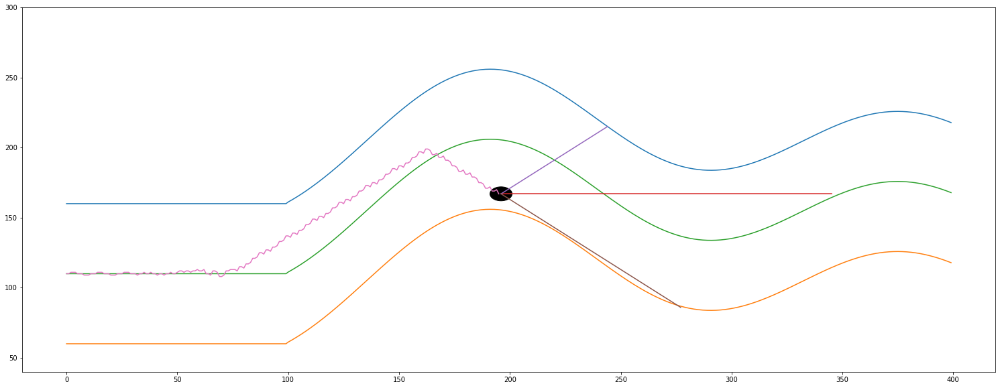

------------------------------ IF i % 3 == 1 ------------------------------
# i =  196
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 49 150  82]]
actual predicted =  [[-14.4077985]]
actual self.y_distance[-1] =  -38.51832398205735
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

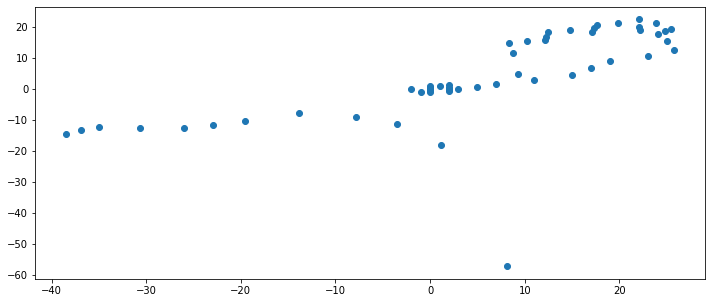

(197, 1)
(197, 1)


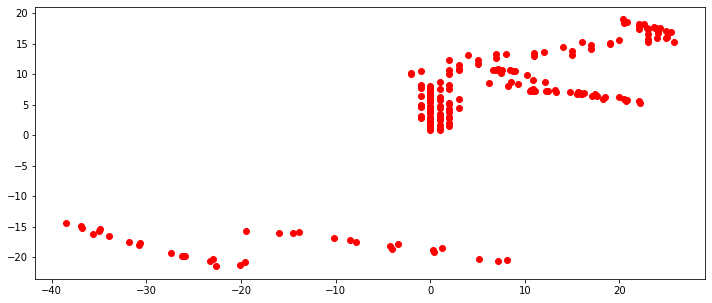

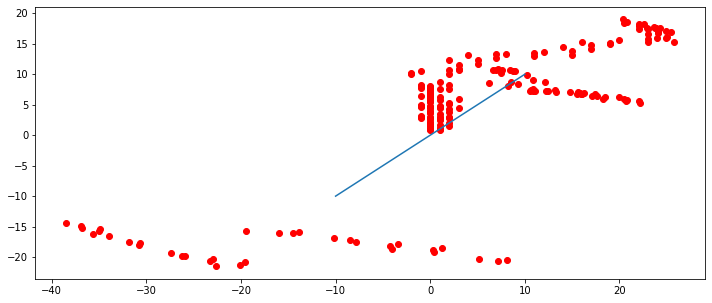

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
167.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

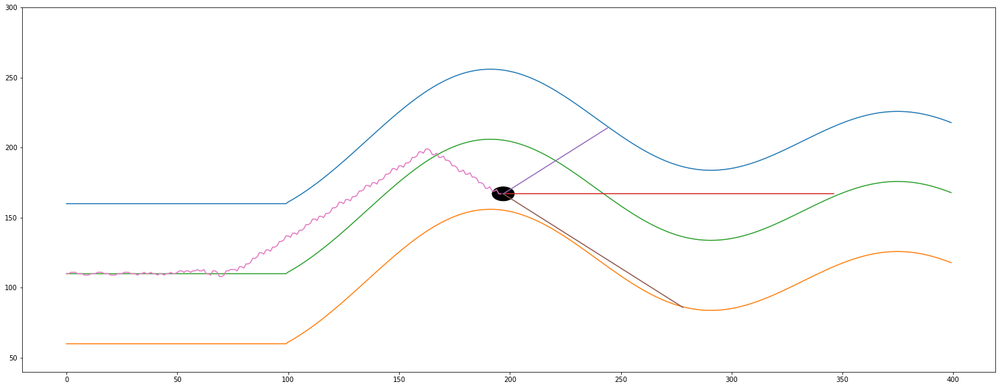

------------------------------ IF i % 3 == 2 ------------------------------
# i =  197
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor from left wall =  48
Sensor from right wall =  81
most távolsagra van a felső faltól =  89.312098126635
most távolsagra van az alsó faltól =  10.687901873365007
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  197
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -39.31209812663499
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -39.31209812663499
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  198
			 len(self.sensor_left)   =  198
			 len(self.sensor_center) =  198
			 len(self.sensor_right)  =  198
		

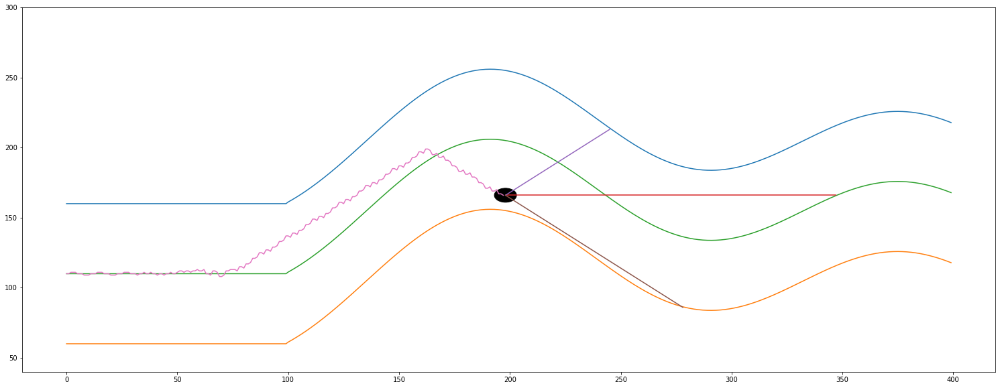

------------------------------ IF i % 3 == 0 ------------------------------
# i =  198
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (199, 3)
y.shape =  (199, 1)
i       =  198
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  198
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(66, 4)
(66, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 124., 

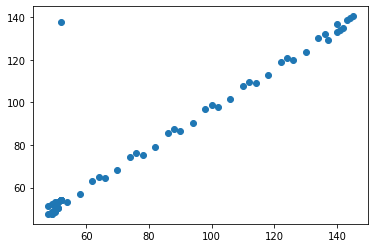

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.9757286  -0.34230695]]


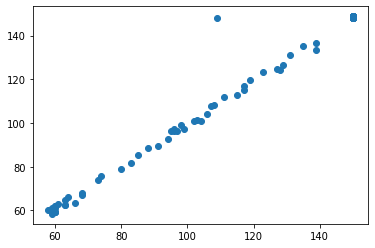

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99699043 0.81685943]]


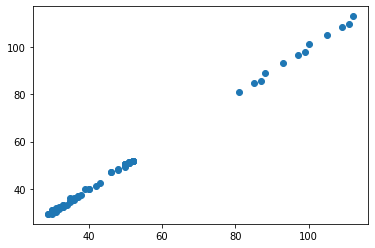

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.09603543]]
-------- 1 y up ->  center =  [[2.79386294]]
-------- 1 y up ->  right  =  [[2.05792784]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[48 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[81 -3]]
		 predicted_left   =  [[55.78469277]]
		 predicted_center =  [[149.54665256]]
		 predicted_right  =  [[78.54972449]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92880105 -2.25875195]]
		 regression_center.coef_ =  [[ 0.9757286  -0.34230695]]
		 regression_right.coef_  =  [[0

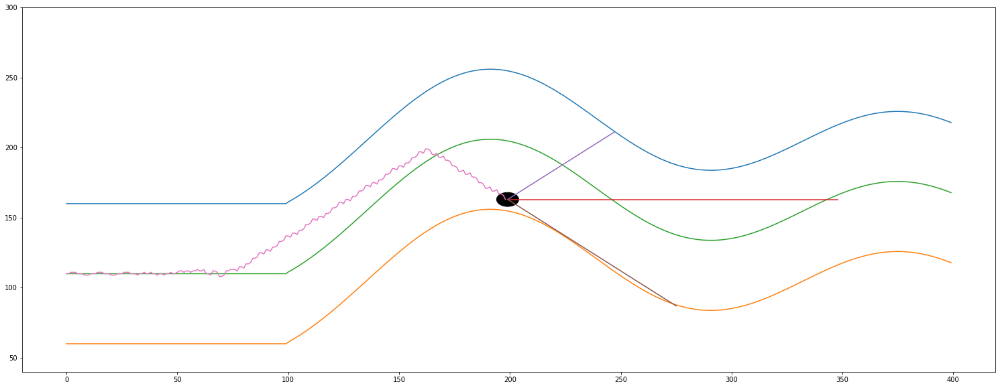

------------------------------ IF i % 3 == 1 ------------------------------
# i =  199
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 49 150  77]]
actual predicted =  [[-13.54120444]]
actual self.y_distance[-1] =  -41.78645203242286
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

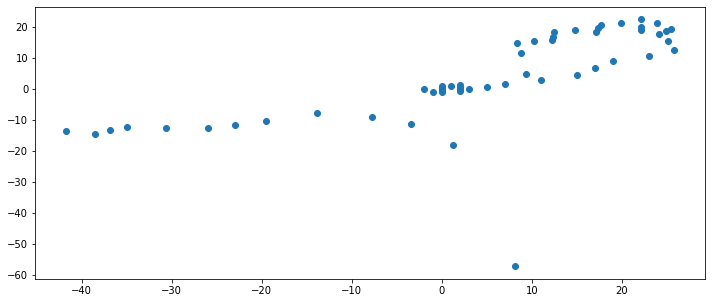

(200, 1)
(200, 1)


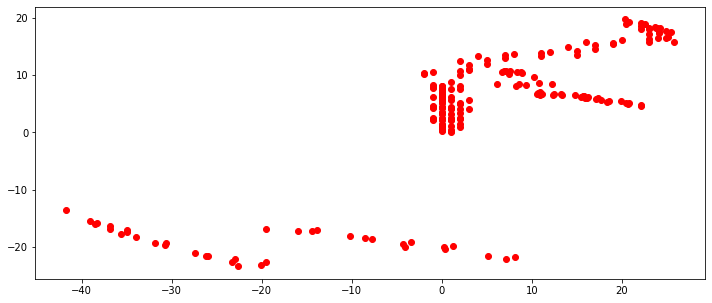

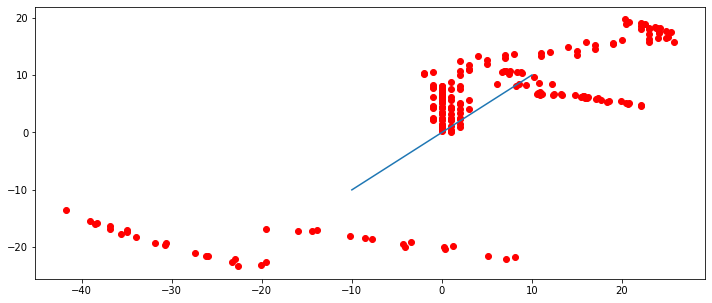

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
163.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

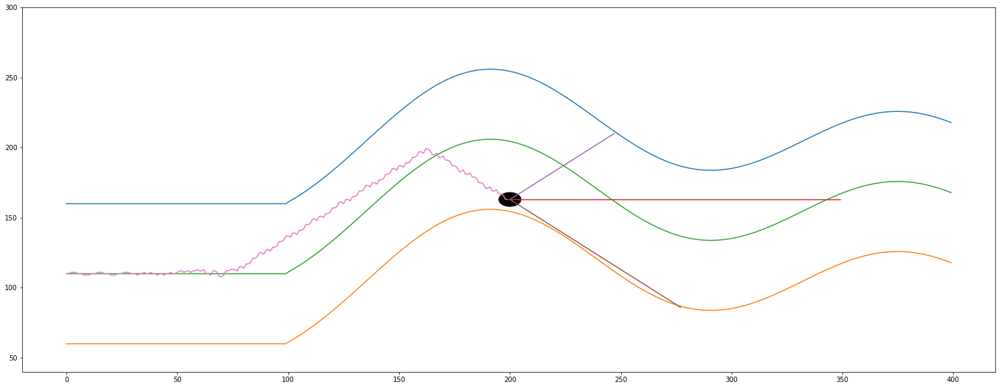

------------------------------ IF i % 3 == 2 ------------------------------
# i =  200
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor from left wall =  49
Sensor from right wall =  76
most távolsagra van a felső faltól =  92.46779997358041
most távolsagra van az alsó faltól =  7.532200026419588
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  200
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -42.46779997358041
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -42.46779997358041
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  201
			 len(self.sensor_left)   =  201
			 len(self.sensor_center) =  201
			 len(self.sensor_right)  =  201


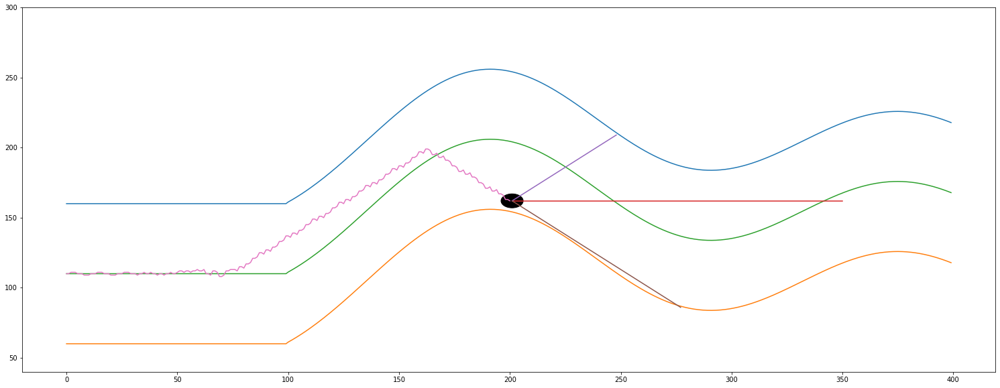

------------------------------ IF i % 3 == 0 ------------------------------
# i =  201
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (202, 3)
y.shape =  (202, 1)
i       =  201
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  201
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(67, 4)
(67, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50., 12

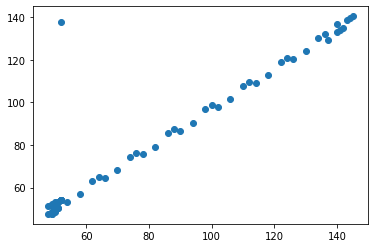

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97638329 -0.35917764]]


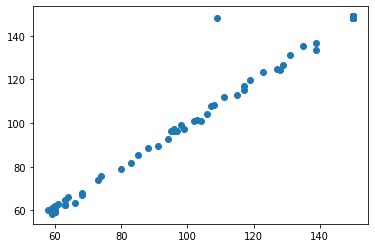

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99616633 0.8337105 ]]


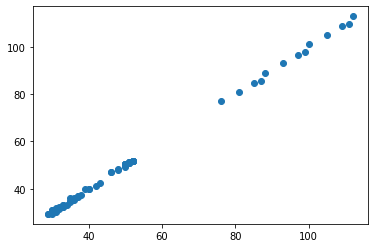

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.02477952]]
-------- 1 y up ->  center =  [[2.72504109]]
-------- 1 y up ->  right  =  [[2.09868337]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[48 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[77 -3]]
		 predicted_left   =  [[55.62439525]]
		 predicted_center =  [[149.64286232]]
		 predicted_right  =  [[74.47248236]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92967683 -2.22620123]]
		 regression_center.coef_ =  [[ 0.97638329 -0.35917764]]
		 regression_right.coef_  =  [[0

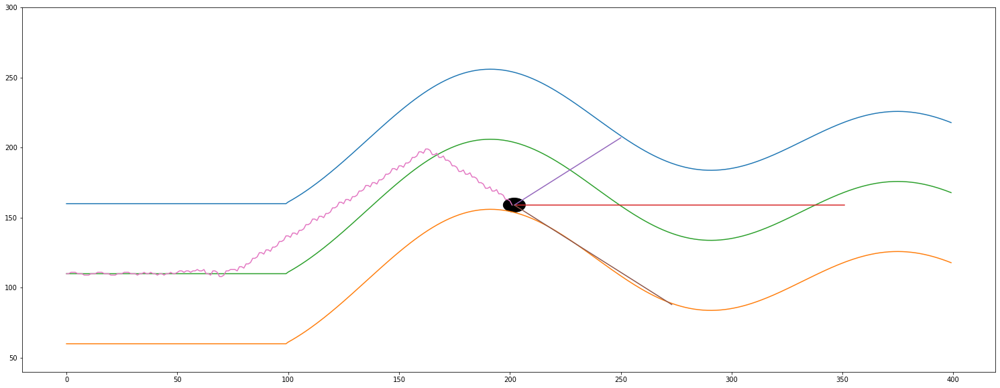

------------------------------ IF i % 3 == 1 ------------------------------
# i =  202
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 49 150  72]]
actual predicted =  [[-12.53819733]]
actual self.y_distance[-1] =  -44.721024506312574
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735

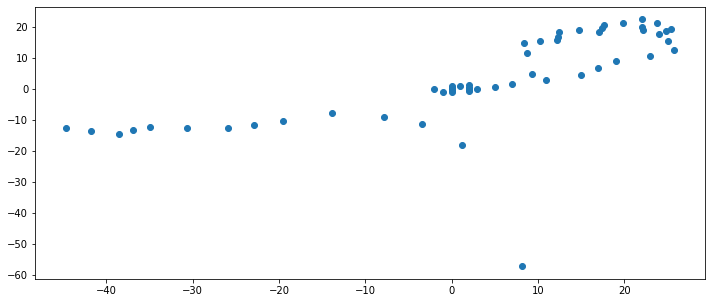

(203, 1)
(203, 1)


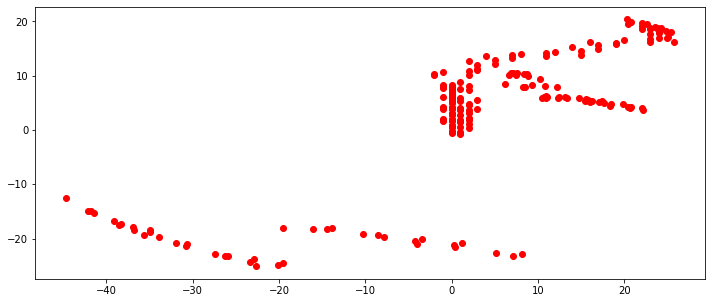

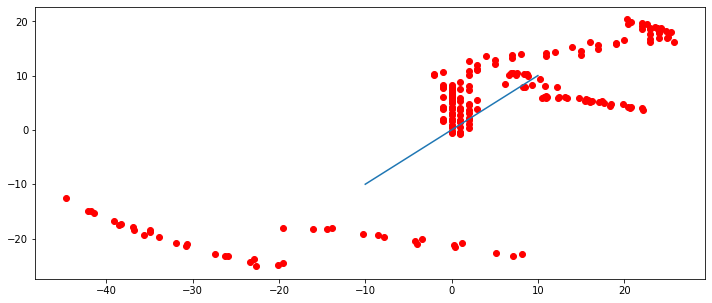

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
159.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

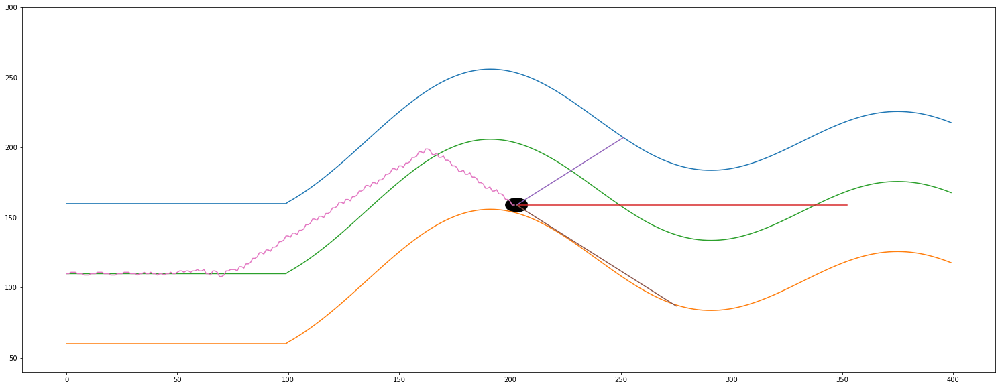

------------------------------ IF i % 3 == 2 ------------------------------
# i =  203
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor from left wall =  48
Sensor from right wall =  75
most távolsagra van a felső faltól =  93.29388037723231
most távolsagra van az alsó faltól =  6.706119622767687
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  203
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -43.29388037723231
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -43.29388037723231
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  204
			 len(self.sensor_left)   =  204
			 len(self.sensor_center) =  204
			 len(self.sensor_right)  =  204
		

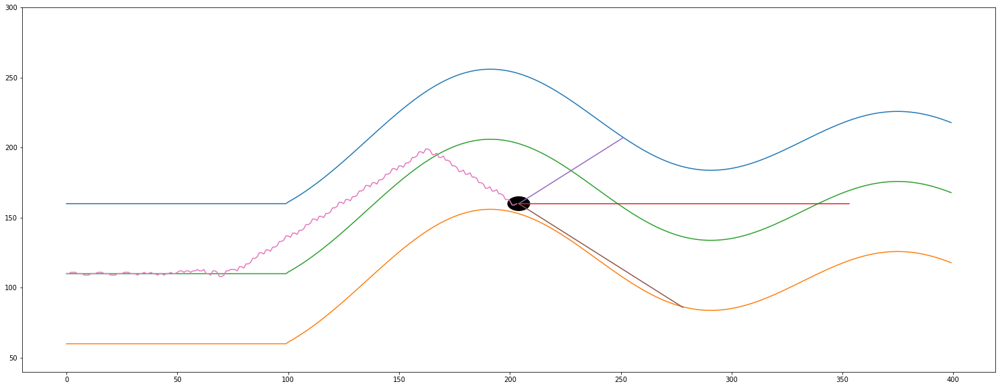

------------------------------ IF i % 3 == 0 ------------------------------
# i =  204
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (205, 3)
y.shape =  (205, 1)
i       =  204
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  204
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(68, 4)
(68, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111.,  50.

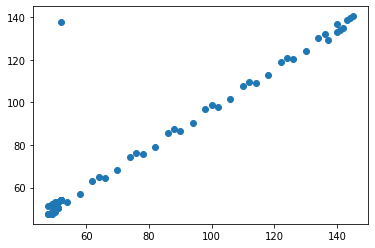

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97735207 -0.33362382]]


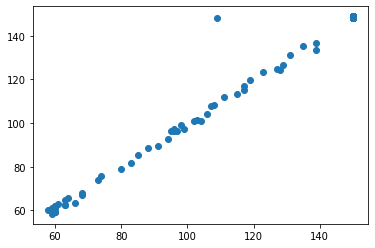

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99684528 0.85136382]]


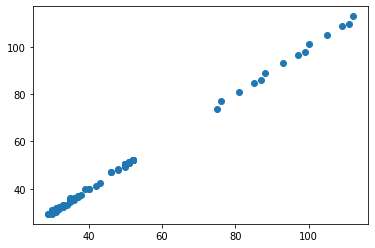

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.0457894]]
-------- 1 y up ->  center =  [[2.67471239]]
-------- 1 y up ->  right  =  [[2.09928341]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[48 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[75 -3]]
		 predicted_left   =  [[55.61830169]]
		 predicted_center =  [[149.63466568]]
		 predicted_right  =  [[72.46037916]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92954378 -2.22098862]]
		 regression_center.coef_ =  [[ 0.97735207 -0.33362382]]
		 regression_right.coef_  =  [[0.

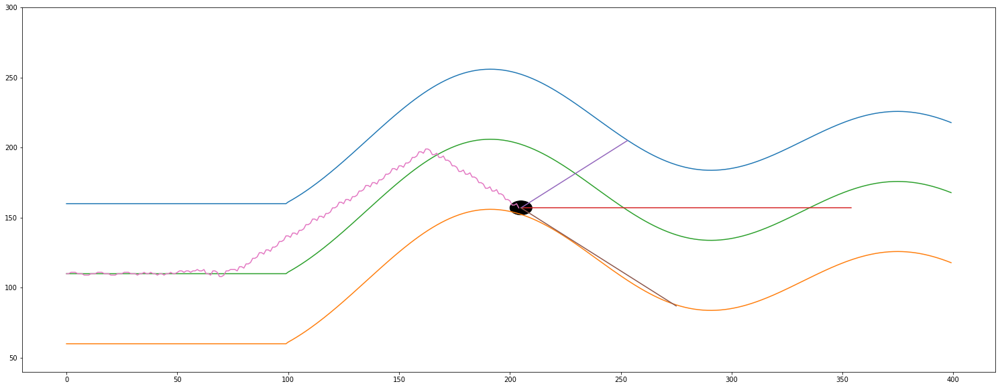

------------------------------ IF i % 3 == 1 ------------------------------
# i =  205
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 49 150  71]]
actual predicted =  [[-13.39362851]]
actual self.y_distance[-1] =  -45.334782994906874
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735

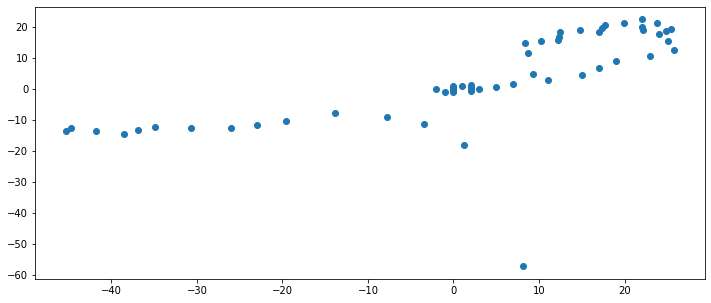

(206, 1)
(206, 1)


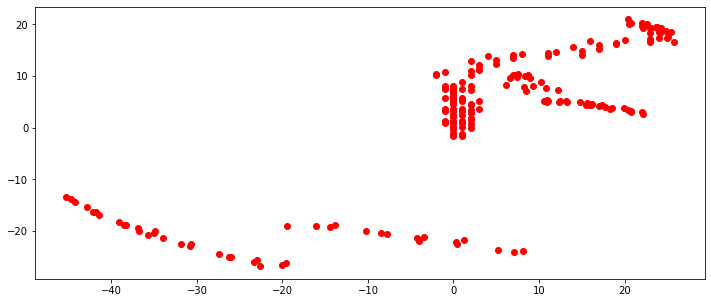

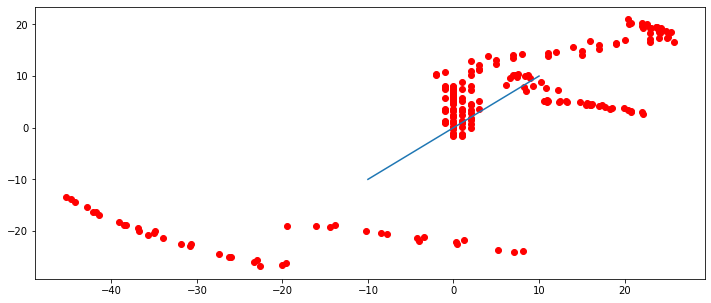

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
157.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

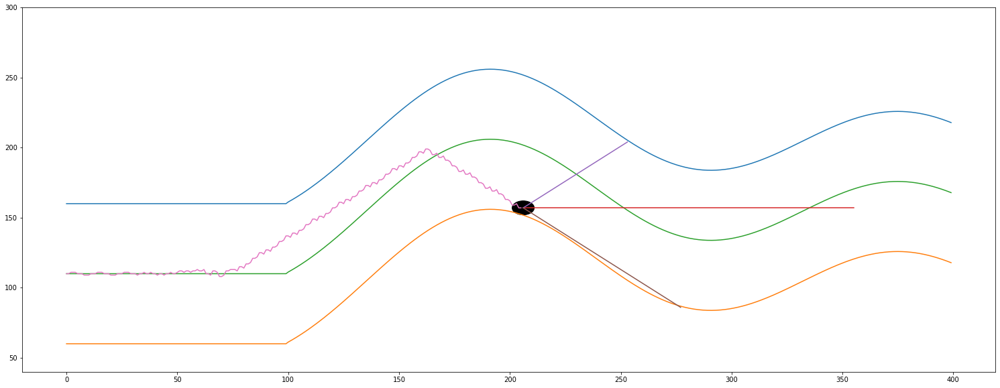

------------------------------ IF i % 3 == 2 ------------------------------
# i =  206
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor from left wall =  48
Sensor from right wall =  73
most távolsagra van a felső faltól =  93.80401104124252
most távolsagra van az alsó faltól =  6.195988958757482
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  206
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -43.80401104124252
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -43.80401104124252
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  207
			 len(self.sensor_left)   =  207
			 len(self.sensor_center) =  207
			 len(self.sensor_right)  =  207
			

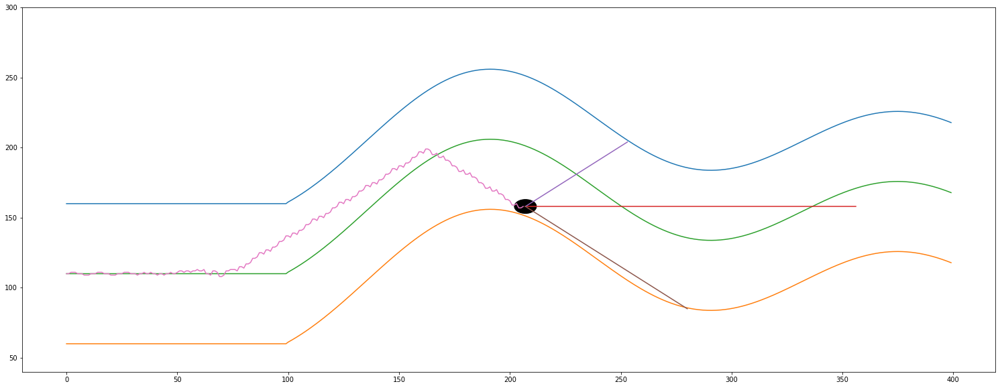

------------------------------ IF i % 3 == 0 ------------------------------
# i =  207
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (208, 3)
y.shape =  (208, 1)
i       =  207
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  207
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(69, 4)
(69, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([111., 

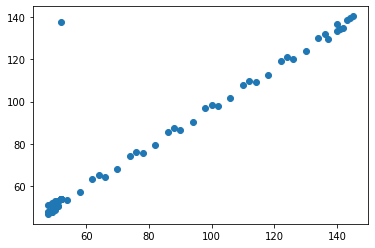

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97822435 -0.31061525]]


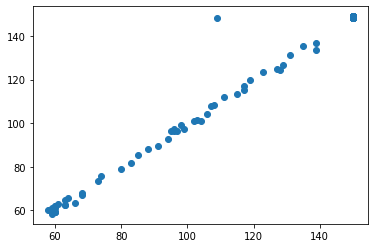

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99691121 0.85315856]]


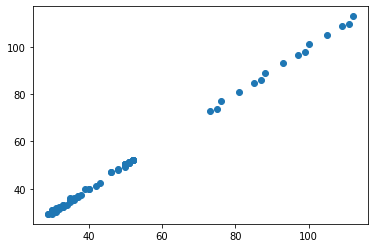

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.11966028]]
-------- 1 y up ->  center =  [[2.62939657]]
-------- 1 y up ->  right  =  [[2.0995027]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[47 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[74 -3]]
		 predicted_left   =  [[54.66859057]]
		 predicted_center =  [[149.62728545]]
		 predicted_right  =  [[71.46138709]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.92906903 -2.20293878]]
		 regression_center.coef_ =  [[ 0.97822435 -0.31061525]]
		 regression_right.coef_  =  [[0.

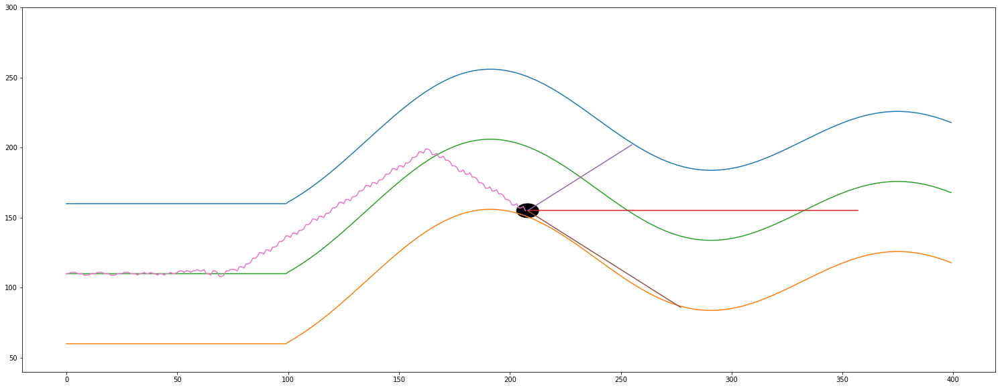

------------------------------ IF i % 3 == 1 ------------------------------
# i =  208
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 48 150  70]]
actual predicted =  [[-14.04177264]]
actual self.y_distance[-1] =  -45.643216059628685
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735

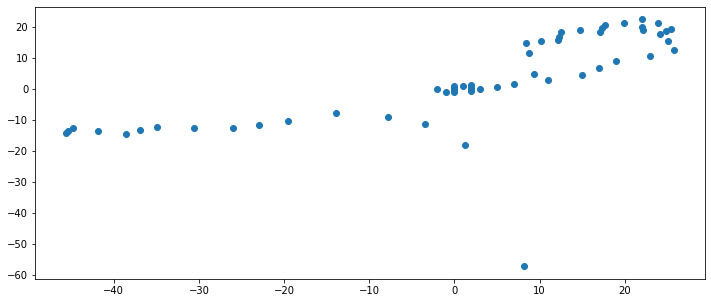

(209, 1)
(209, 1)


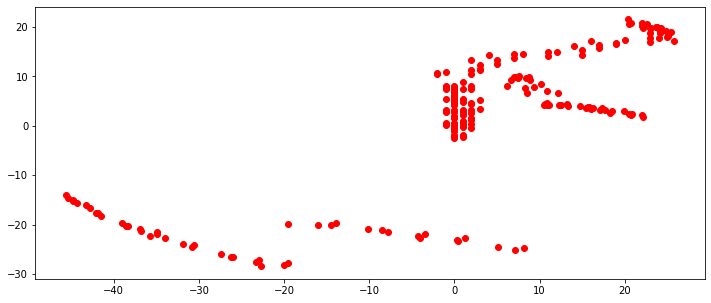

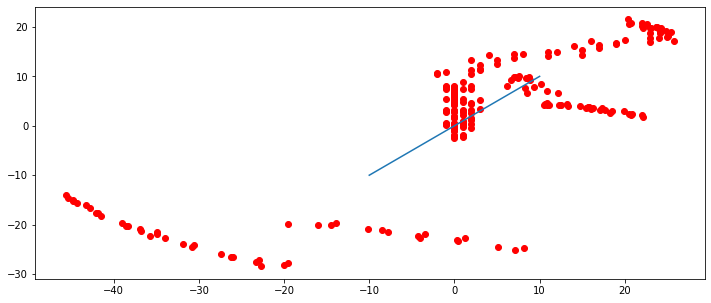

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
155.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

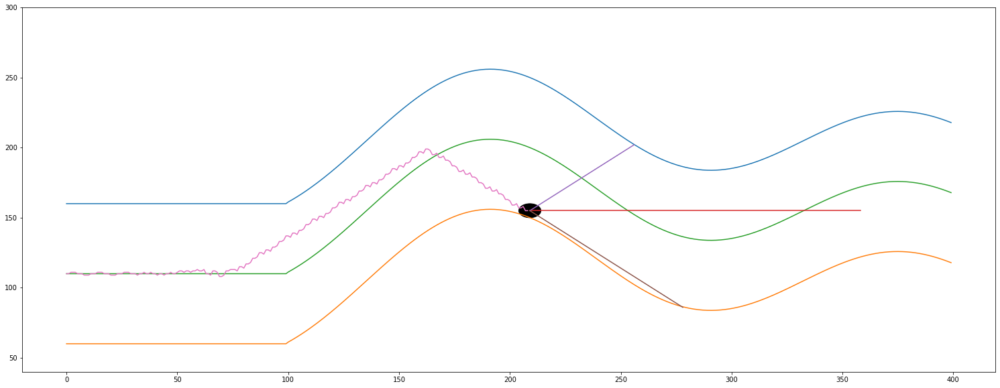

------------------------------ IF i % 3 == 2 ------------------------------
# i =  209
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor from left wall =  48
Sensor from right wall =  69
most távolsagra van a felső faltól =  96.01456528690949
most távolsagra van az alsó faltól =  3.9854347130905126
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  209
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -46.01456528690949
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -46.01456528690949
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  210
			 len(self.sensor_left)   =  210
			 len(self.sensor_center) =  210
			 len(self.sensor_right)  =  210


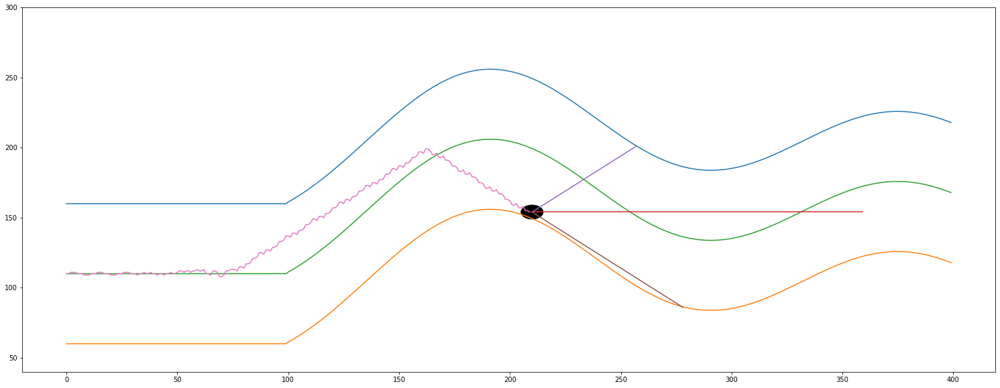

------------------------------ IF i % 3 == 0 ------------------------------
# i =  210
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (211, 3)
y.shape =  (211, 1)
i       =  210
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  210
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(70, 4)
(70, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array([11

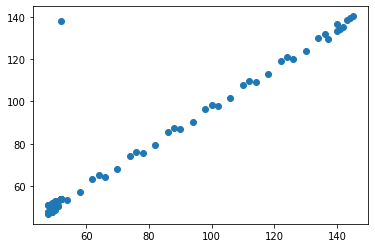

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97874258 -0.32524385]]


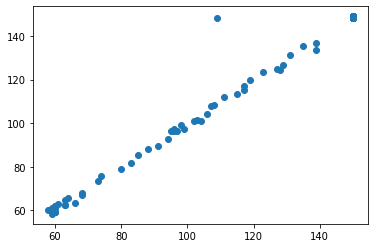

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99683035 0.85569387]]


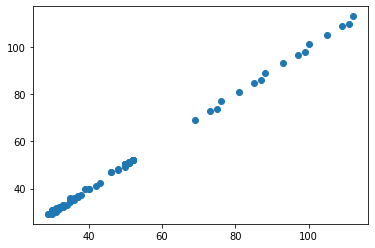

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.02800086]]
-------- 1 y up ->  center =  [[2.57362023]]
-------- 1 y up ->  right  =  [[2.10360382]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[48 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[69 -3]]
		 predicted_left   =  [[55.37969633]]
		 predicted_center =  [[149.70723978]]
		 predicted_right  =  [[66.46529194]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93022301 -2.15780349]]
		 regression_center.coef_ =  [[ 0.97874258 -0.32524385]]
		 regression_right.coef_  =  [[0

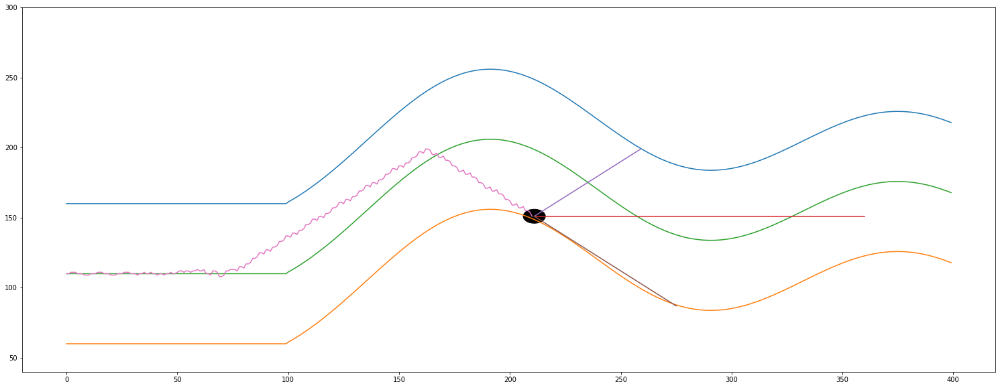

------------------------------ IF i % 3 == 1 ------------------------------
# i =  211
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 49 150  65]]
actual predicted =  [[-12.73202124]]
actual self.y_distance[-1] =  -47.664414371443655
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735

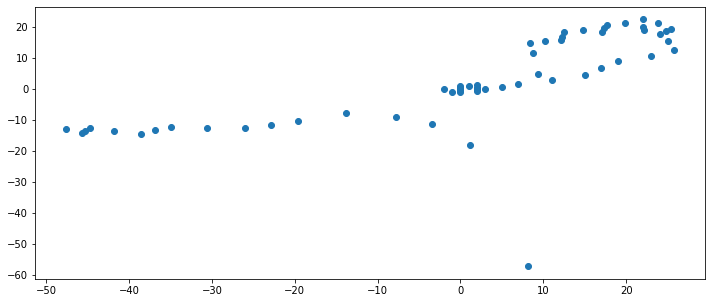

(212, 1)
(212, 1)


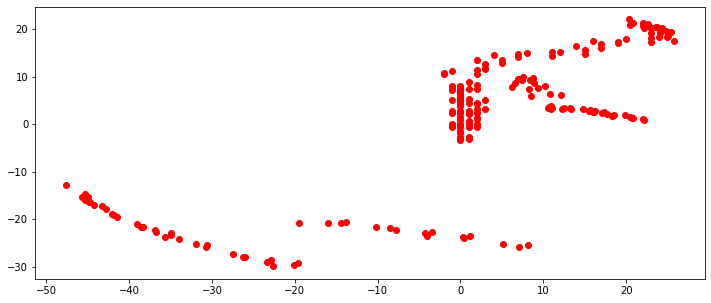

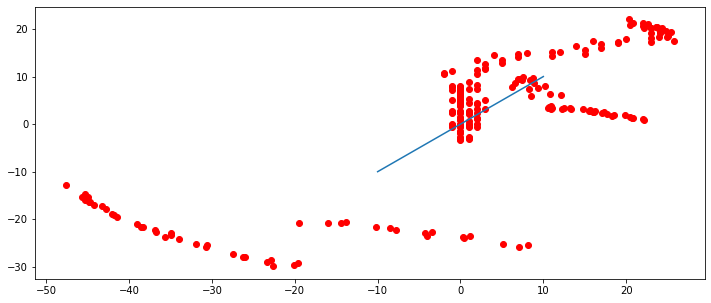

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
151.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

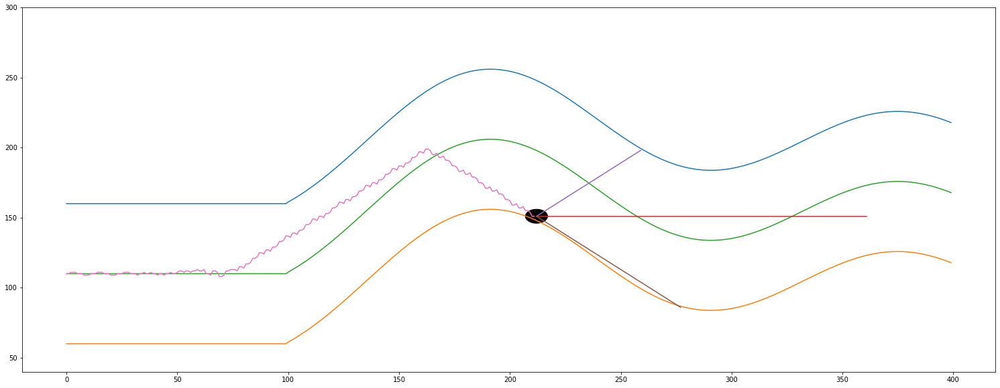

------------------------------ IF i % 3 == 2 ------------------------------
# i =  212
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor from left wall =  49
Sensor from right wall =  64
most távolsagra van a felső faltól =  97.94446449926414
most távolsagra van az alsó faltól =  2.055535500735857
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  212
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -47.94446449926414
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -47.94446449926414
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  213
			 len(self.sensor_left)   =  213
			 len(self.sensor_center) =  213
			 len(self.sensor_right)  =  213


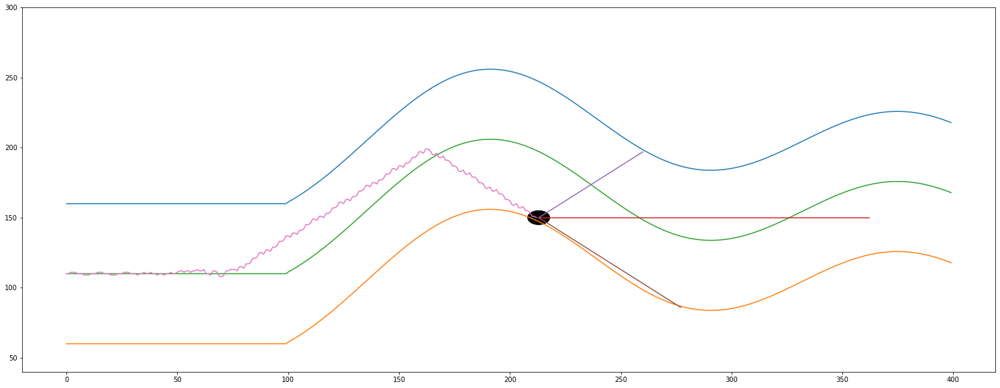

------------------------------ IF i % 3 == 0 ------------------------------
# i =  213
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (214, 3)
y.shape =  (214, 1)
i       =  213
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  213
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(71, 4)
(71, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), array

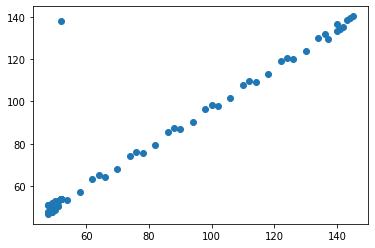

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97921051 -0.33845259]]


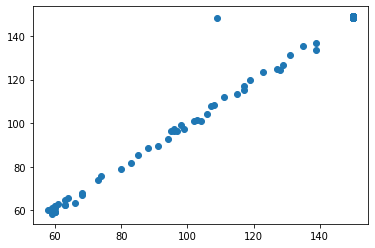

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99643346 0.87191357]]


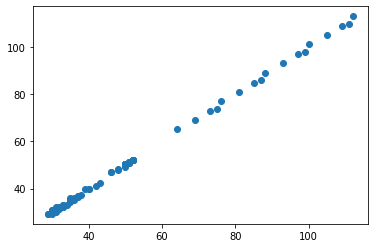

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.97100593]]
-------- 1 y up ->  center =  [[2.5232576]]
-------- 1 y up ->  right  =  [[2.12373185]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[48 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[65 -3]]
		 predicted_left   =  [[55.24416414]]
		 predicted_center =  [[149.77943365]]
		 predicted_right  =  [[62.40781878]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93094057 -2.12973782]]
		 regression_center.coef_ =  [[ 0.97921051 -0.33845259]]
		 regression_right.coef_  =  [[0.

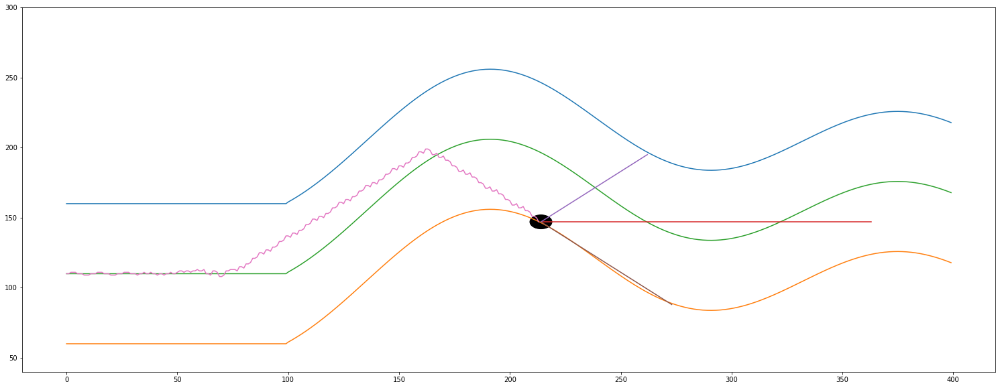

------------------------------ IF i % 3 == 1 ------------------------------
# i =  214
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 49 150  60]]
actual predicted =  [[-11.29759328]]
actual self.y_distance[-1] =  -49.41890028788734
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

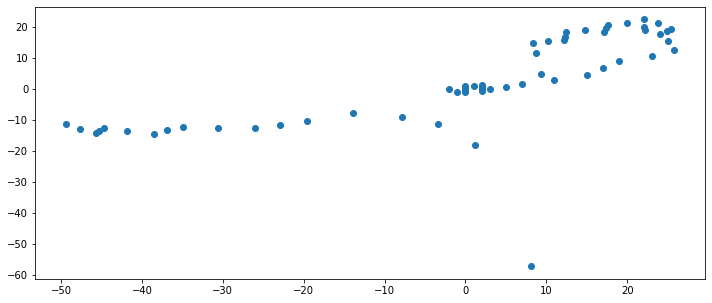

(215, 1)
(215, 1)


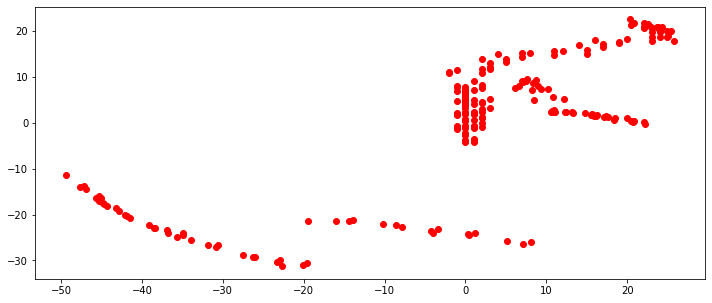

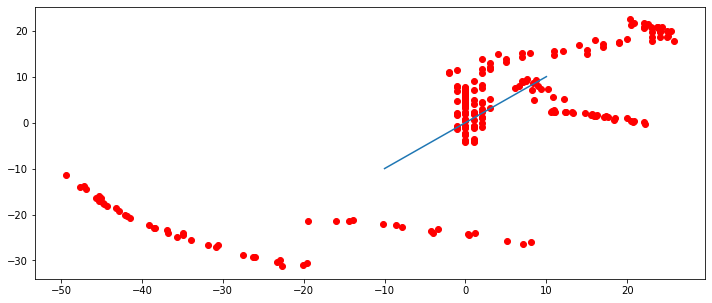

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
147.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

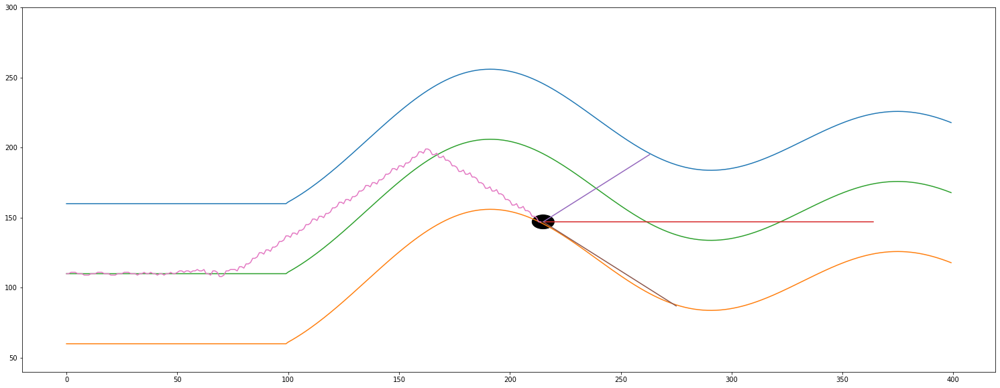

------------------------------ IF i % 3 == 2 ------------------------------
# i =  215
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor from left wall =  48
Sensor from right wall =  63
most távolsagra van a felső faltól =  97.6149995469602
most távolsagra van az alsó faltól =  2.385000453039794
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  215
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -47.614999546960206
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -47.614999546960206
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  216
			 len(self.sensor_left)   =  216
			 len(self.sensor_center) =  216
			 len(self.sensor_right)  =  216
	

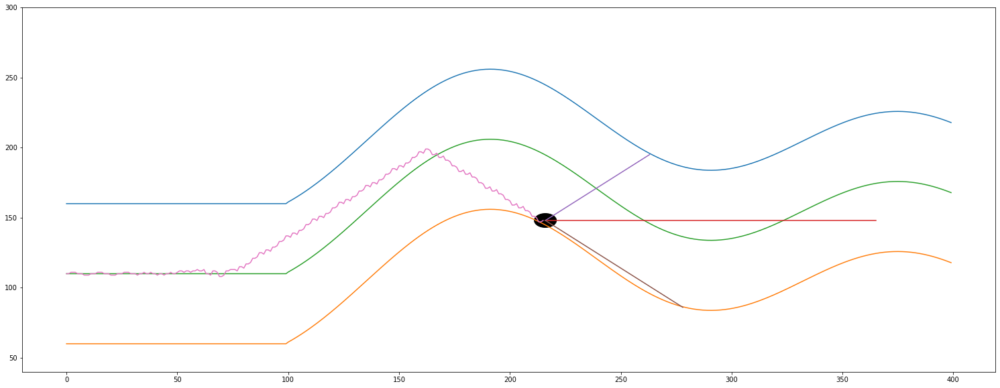

------------------------------ IF i % 3 == 0 ------------------------------
# i =  216
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (217, 3)
y.shape =  (217, 1)
i       =  216
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  216
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(72, 4)
(72, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.]), a

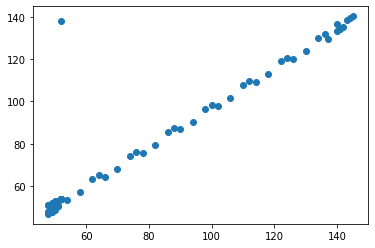

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97994692 -0.31717946]]


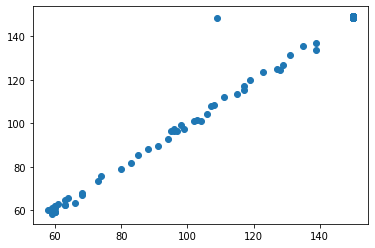

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99668624 0.88718598]]


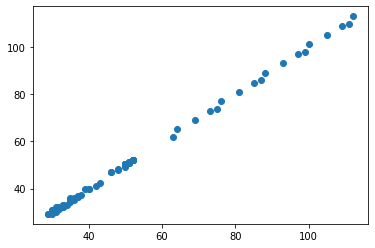

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.98978779]]
-------- 1 y up ->  center =  [[2.48688507]]
-------- 1 y up ->  right  =  [[2.14113193]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[48 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[63 -3]]
		 predicted_left   =  [[55.23813143]]
		 predicted_center =  [[149.76769395]]
		 predicted_right  =  [[60.38693488]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93082307 -2.12491485]]
		 regression_center.coef_ =  [[ 0.97994692 -0.31717946]]
		 regression_right.coef_  =  [[0

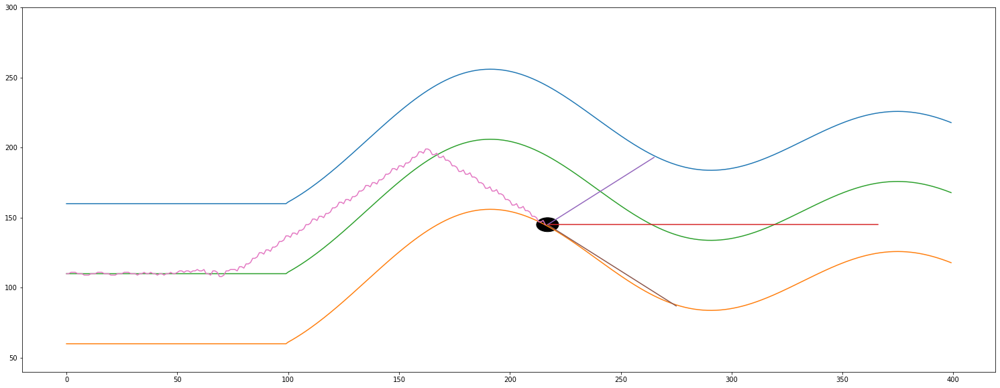

------------------------------ IF i % 3 == 1 ------------------------------
# i =  217
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 49 150  59]]
actual predicted =  [[-11.98260154]]
actual self.y_distance[-1] =  -48.929433558686924
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735

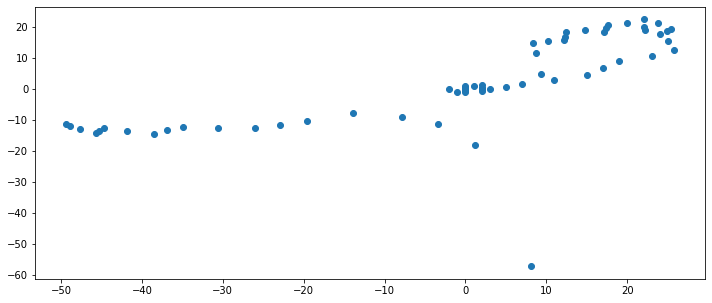

(218, 1)
(218, 1)


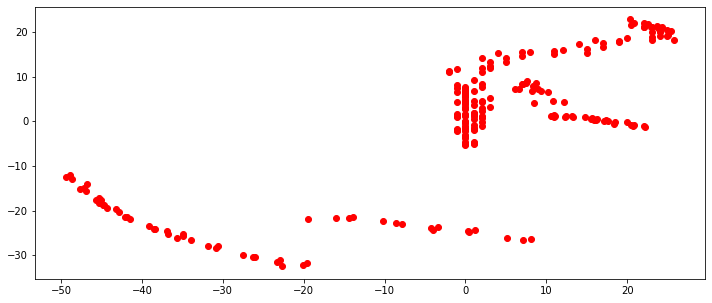

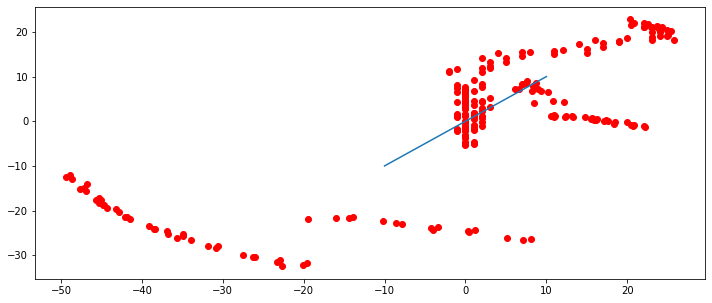

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
145.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

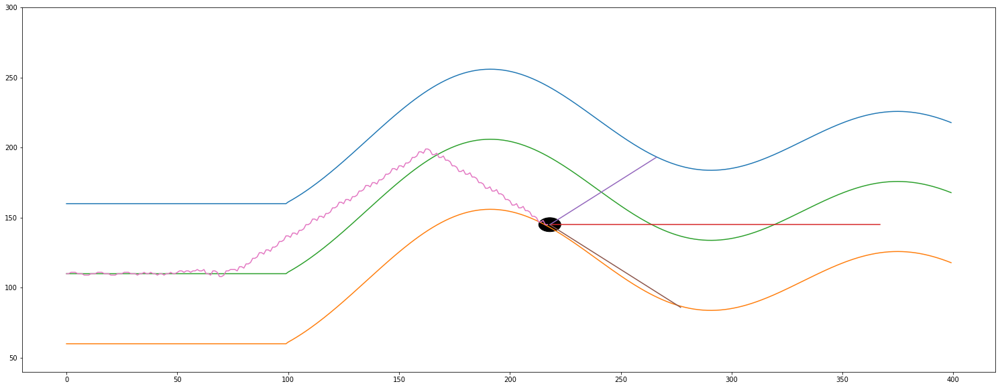

------------------------------ IF i % 3 == 2 ------------------------------
# i =  218
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor from left wall =  48
Sensor from right wall =  61
most távolsagra van a felső faltól =  97.04962894818865
most távolsagra van az alsó faltól =  2.950371051811345
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  218
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -47.049628948188655
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -47.049628948188655
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  219
			 len(self.sensor_left)   =  219
			 len(self.sensor_center) =  219
			 len(self.sensor_right)  =  219
	

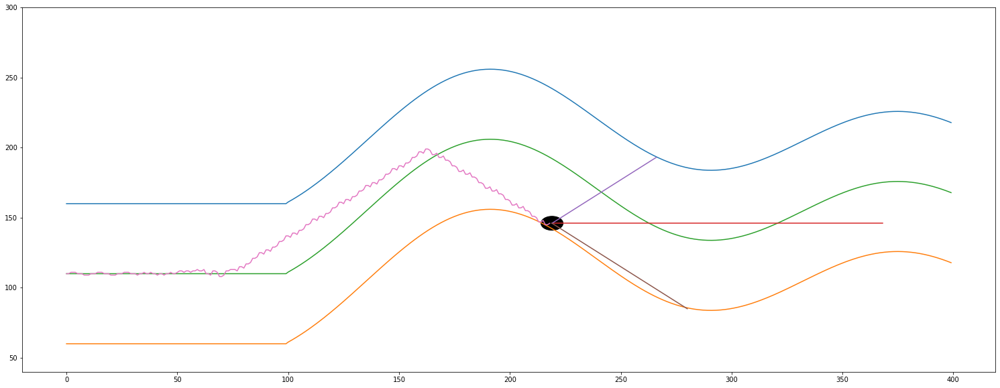

------------------------------ IF i % 3 == 0 ------------------------------
# i =  219
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (220, 3)
y.shape =  (220, 1)
i       =  219
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  219
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1.]
(73, 4)
(73, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126.,  51.

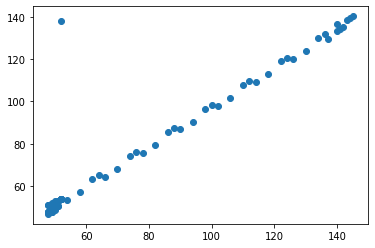

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98061776 -0.29780039]]


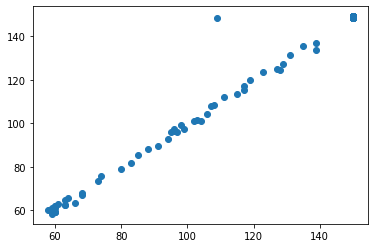

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99669713 0.88792526]]


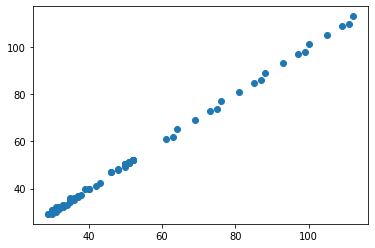

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[3.00718682]]
-------- 1 y up ->  center =  [[2.45375098]]
-------- 1 y up ->  right  =  [[2.14204415]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[48 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[62 -3]]
		 predicted_left   =  [[55.23254287]]
		 predicted_center =  [[149.7569995]]
		 predicted_right  =  [[59.3888681]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93071422 -2.12044697]]
		 regression_center.coef_ =  [[ 0.98061776 -0.29780039]]
		 regression_right.coef_  =  [[0.9

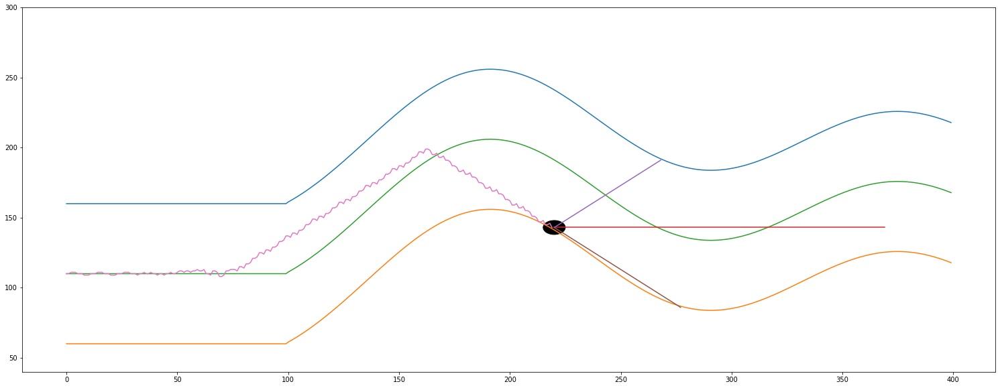

------------------------------ IF i % 3 == 1 ------------------------------
# i =  220
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 49 150  58]]
actual predicted =  [[-12.5915549]]
actual self.y_distance[-1] =  -48.220795088905504
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

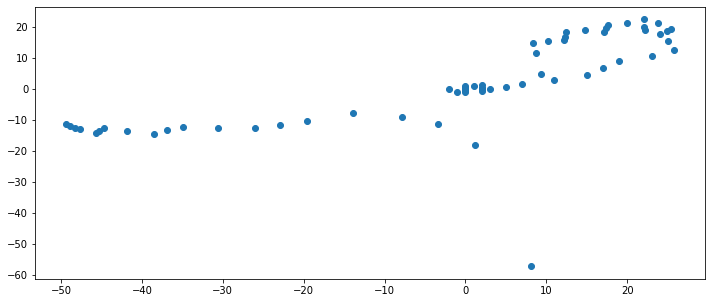

(221, 1)
(221, 1)


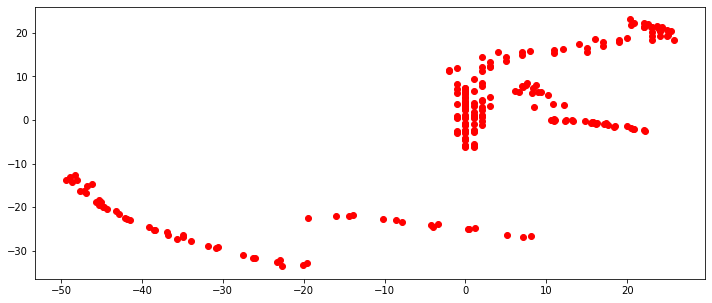

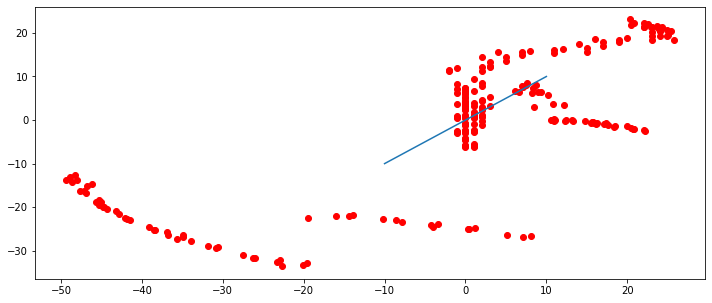

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
143.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

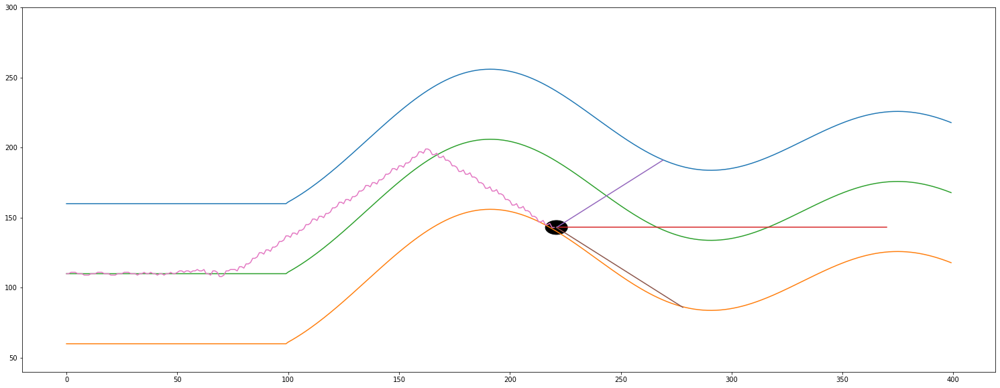

------------------------------ IF i % 3 == 2 ------------------------------
# i =  221
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor from left wall =  49
Sensor from right wall =  57
most távolsagra van a felső faltól =  98.27375578672863
most távolsagra van az alsó faltól =  1.7262442132713716
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  221
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -48.27375578672863
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -48.27375578672863
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  222
			 len(self.sensor_left)   =  222
			 len(self.sensor_center) =  222
			 len(self.sensor_right)  =  222


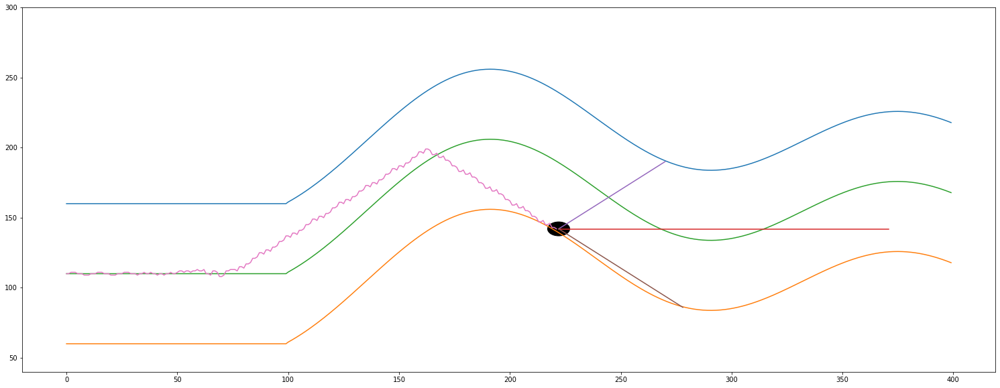

------------------------------ IF i % 3 == 0 ------------------------------
# i =  222
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (223, 3)
y.shape =  (223, 1)
i       =  222
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  222
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1.]
(74, 4)
(74, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 126., 

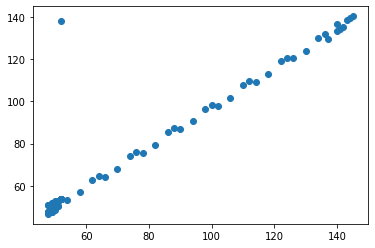

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98100013 -0.30943254]]


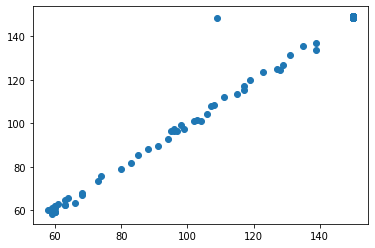

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99667495 0.89031923]]


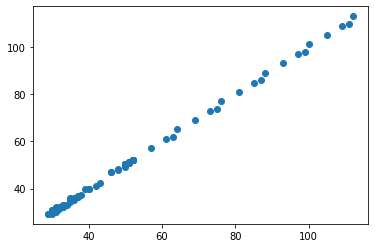

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.93507702]]
-------- 1 y up ->  center =  [[2.41174205]]
-------- 1 y up ->  right  =  [[2.14317959]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[49 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[57 -3]]
		 predicted_left   =  [[55.9791655]]
		 predicted_center =  [[149.81849214]]
		 predicted_right  =  [[54.39569985]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93164192 -2.08131913]]
		 regression_center.coef_ =  [[ 0.98100013 -0.30943254]]
		 regression_right.coef_  =  [[0.

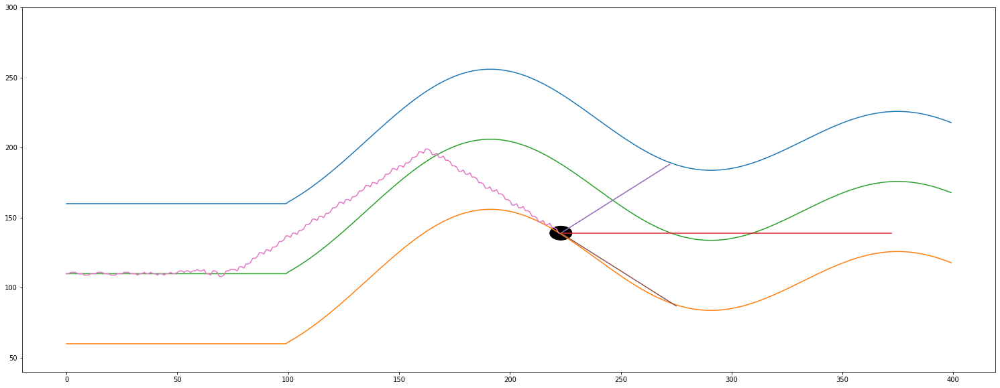

------------------------------ IF i % 3 == 1 ------------------------------
# i =  223
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 50 150  53]]
actual predicted =  [[-11.18537158]]
actual self.y_distance[-1] =  -49.31955090733706
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

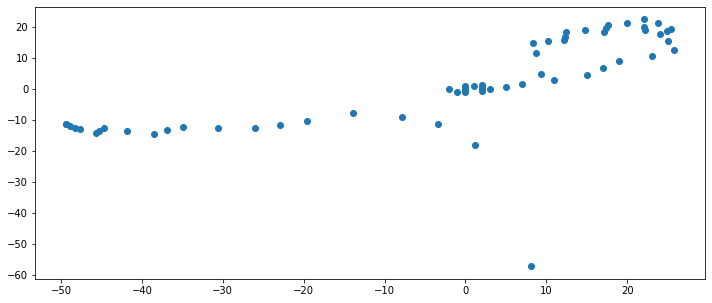

(224, 1)
(224, 1)


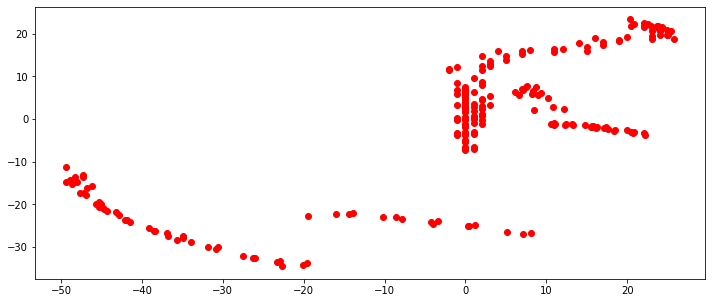

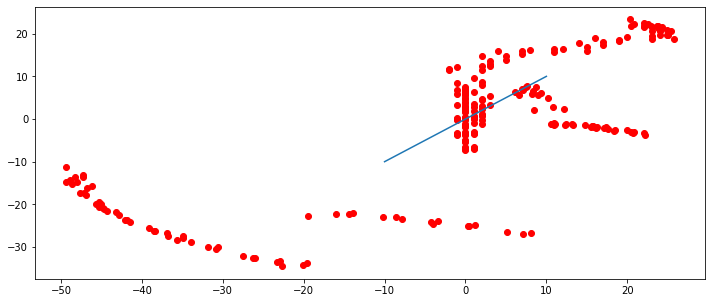

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
139.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

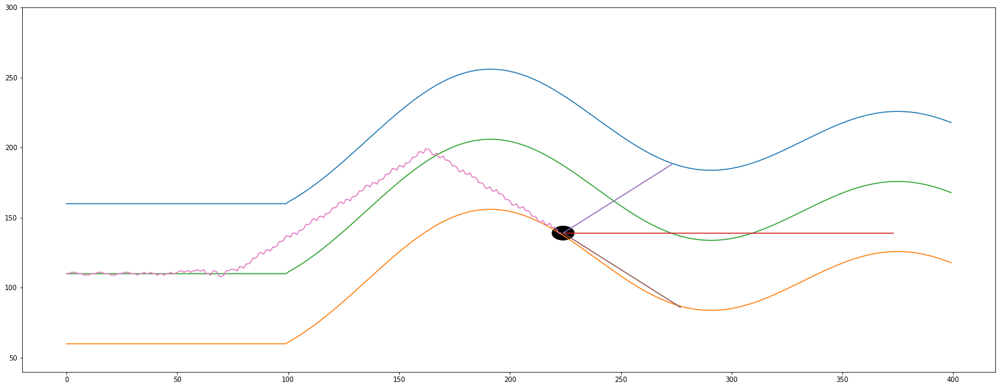

------------------------------ IF i % 3 == 2 ------------------------------
# i =  224
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor from left wall =  51
Sensor from right wall =  52
most távolsagra van a felső faltól =  99.31448559413343
most távolsagra van az alsó faltól =  0.6855144058665701
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  224
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -49.31448559413343
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -49.31448559413343
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  225
			 len(self.sensor_left)   =  225
			 len(self.sensor_center) =  225
			 len(self.sensor_right)  =  225

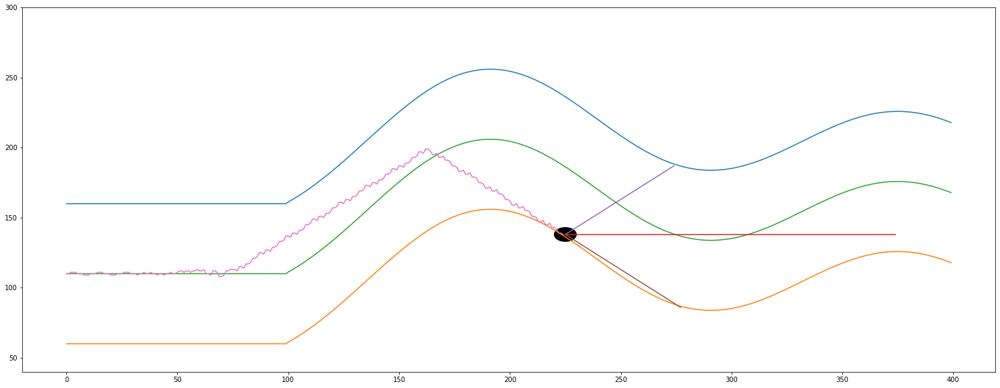

------------------------------ IF i % 3 == 0 ------------------------------
# i =  225
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (226, 3)
y.shape =  (226, 1)
i       =  225
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  225
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.]
(75, 4)
(75, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51., 12

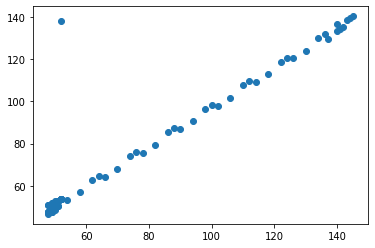

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98134916 -0.3200504 ]]


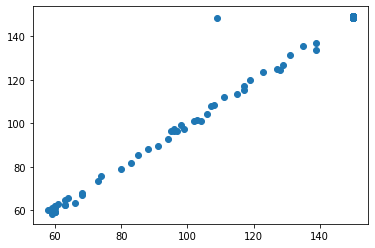

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99664935 0.90591622]]


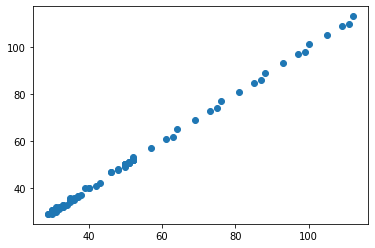

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.89486221]]
-------- 1 y up ->  center =  [[2.37339618]]
-------- 1 y up ->  right  =  [[2.14448999]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[50 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[53 -3]]
		 predicted_left   =  [[56.80550667]]
		 predicted_center =  [[149.87462283]]
		 predicted_right  =  [[50.34659134]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93215928 -2.0587099 ]]
		 regression_center.coef_ =  [[ 0.98134916 -0.3200504 ]]
		 regression_right.coef_  =  [[0

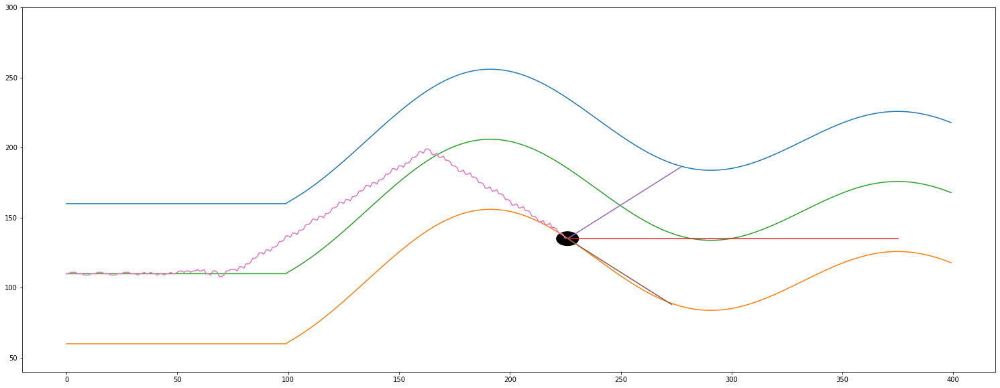

------------------------------ IF i % 3 == 1 ------------------------------
# i =  226
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 52 150  48]]
actual predicted =  [[-10.00229391]]
actual self.y_distance[-1] =  -50.25379868523683
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

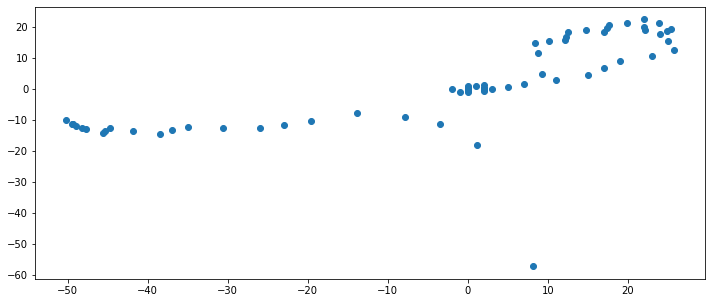

(227, 1)
(227, 1)


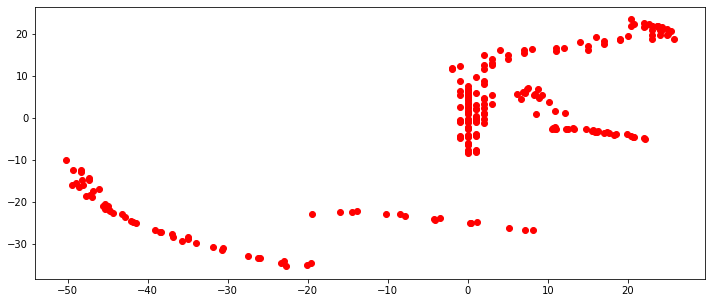

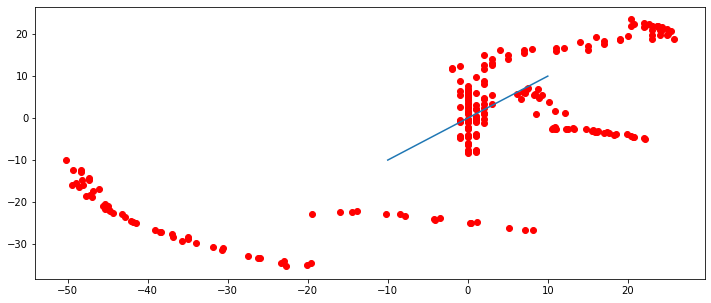

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
135.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

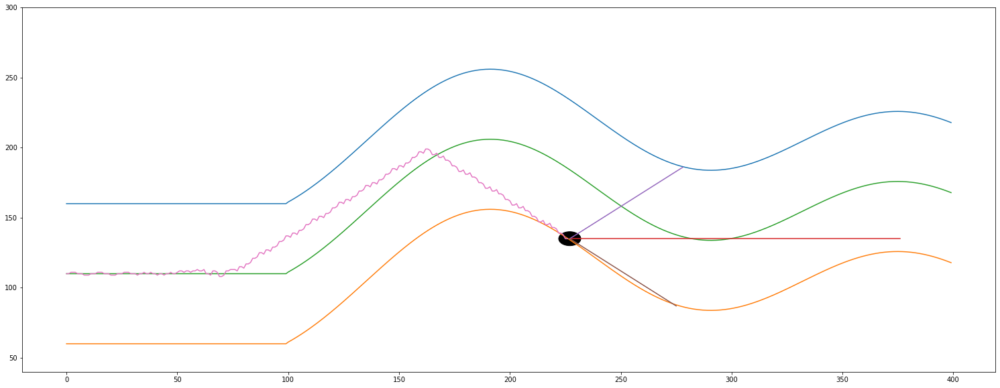

------------------------------ IF i % 3 == 2 ------------------------------
# i =  227
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  98.20036760380827
most távolsagra van az alsó faltól =  1.7996323961917255
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  227
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -48.200367603808274
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -48.200367603808274
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  228
			 len(self.sensor_left)   =  228
			 len(self.sensor_center) =  228
			 len(self.sensor_right)  =  228

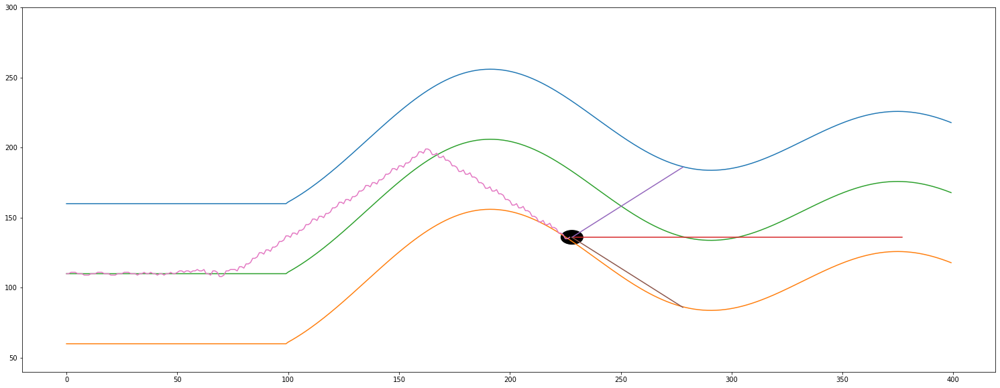

------------------------------ IF i % 3 == 0 ------------------------------
# i =  228
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (229, 3)
y.shape =  (229, 1)
i       =  228
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  228
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.]
(76, 4)
(76, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110.,  51.

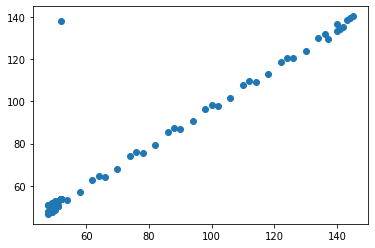

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98192899 -0.30199844]]


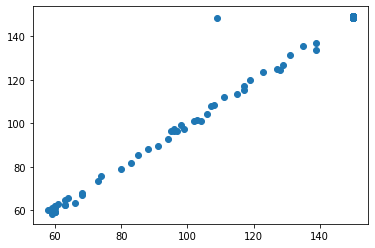

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.9965685  0.91924658]]


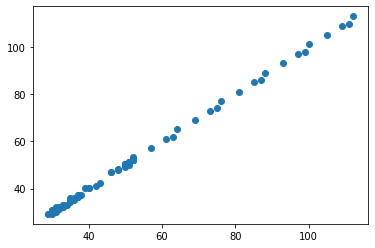

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.9219579]]
-------- 1 y up ->  center =  [[2.34608542]]
-------- 1 y up ->  right  =  [[2.17536775]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[51 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[51 -3]]
		 predicted_left   =  [[57.72682823]]
		 predicted_center =  [[149.86149834]]
		 predicted_right  =  [[48.3268064]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93200055 -2.05121075]]
		 regression_center.coef_ =  [[ 0.98192899 -0.30199844]]
		 regression_right.coef_  =  [[0.9

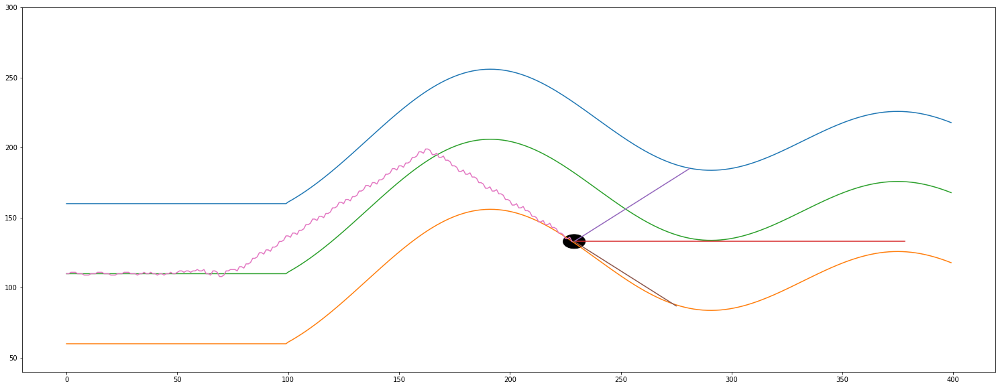

------------------------------ IF i % 3 == 1 ------------------------------
# i =  229
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 53 150  47]]
actual predicted =  [[-10.87573668]]
actual self.y_distance[-1] =  -49.052899324409424
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735

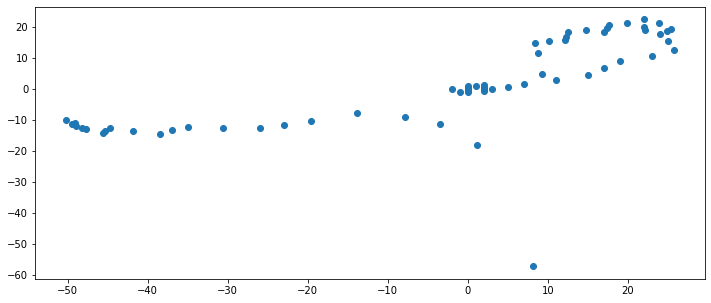

(230, 1)
(230, 1)


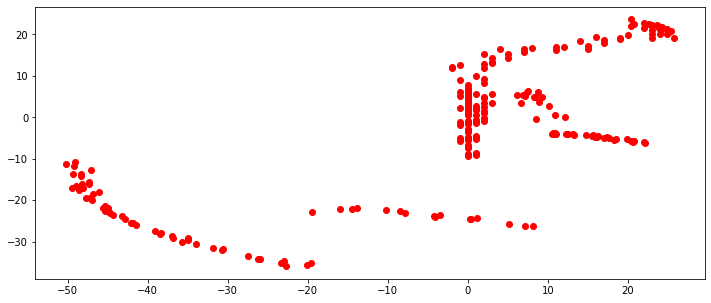

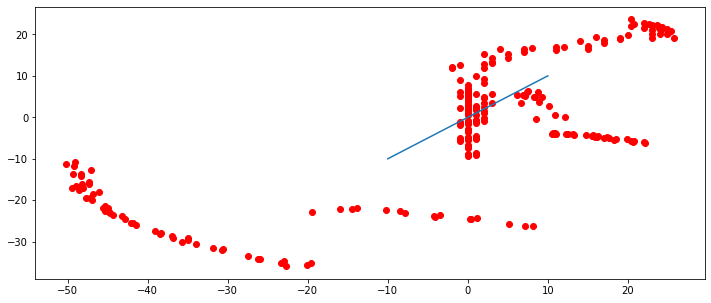

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
133.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

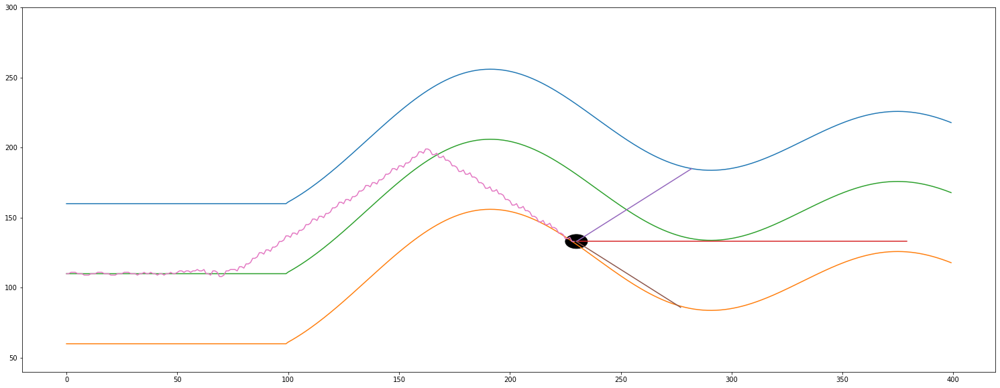

------------------------------ IF i % 3 == 2 ------------------------------
# i =  230
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor from left wall =  52
Sensor from right wall =  49
most távolsagra van a felső faltól =  96.96112194847137
most távolsagra van az alsó faltól =  3.038878051528627
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  230
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -46.96112194847137
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -46.96112194847137
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  231
			 len(self.sensor_left)   =  231
			 len(self.sensor_center) =  231
			 len(self.sensor_right)  =  231
			

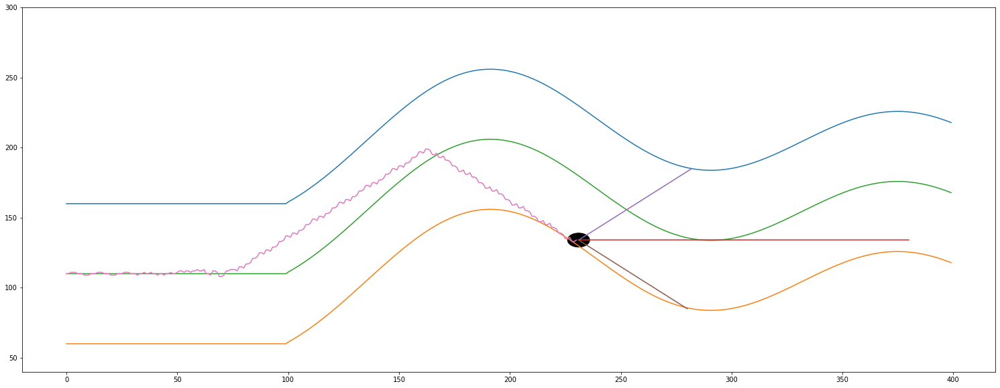

------------------------------ IF i % 3 == 0 ------------------------------
# i =  231
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (232, 3)
y.shape =  (232, 1)
i       =  231
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  231
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1.]
(77, 4)
(77, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([110., 

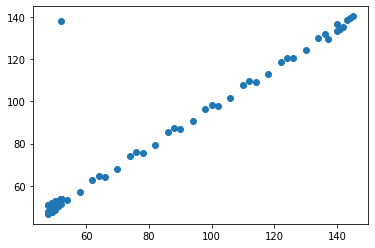

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98246203 -0.28540288]]


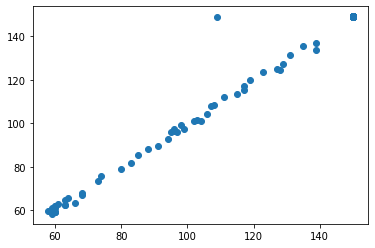

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99656994 0.91906681]]


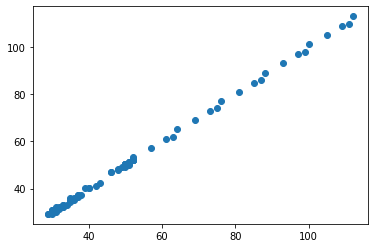

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.94996643]]
-------- 1 y up ->  center =  [[2.32097805]]
-------- 1 y up ->  right  =  [[2.17493295]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[52 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[50 -3]]
		 predicted_left   =  [[58.64710477]]
		 predicted_center =  [[149.84943271]]
		 predicted_right  =  [[47.33059288]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93183998 -2.0433248 ]]
		 regression_center.coef_ =  [[ 0.98246203 -0.28540288]]
		 regression_right.coef_  =  [[0

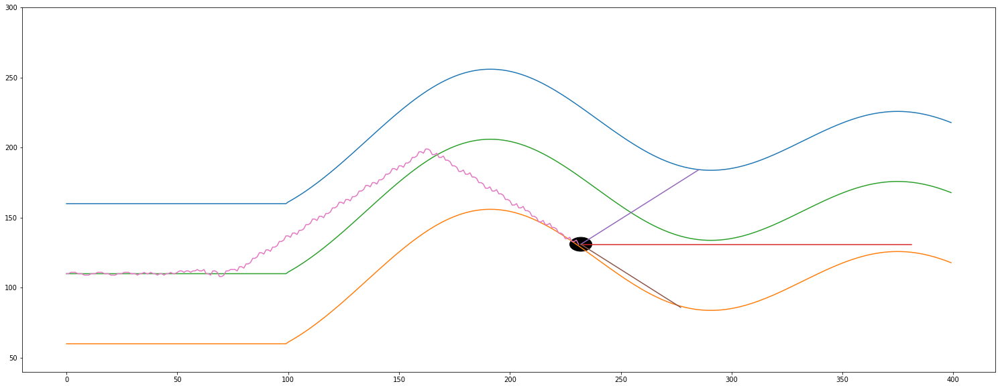

------------------------------ IF i % 3 == 1 ------------------------------
# i =  232
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 54 150  46]]
actual predicted =  [[-11.66970667]]
actual self.y_distance[-1] =  -47.74719628246356
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

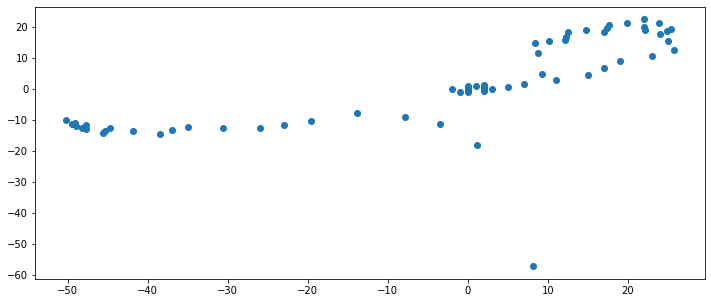

(233, 1)
(233, 1)


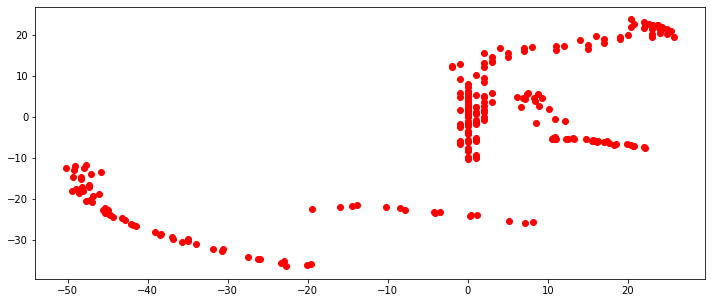

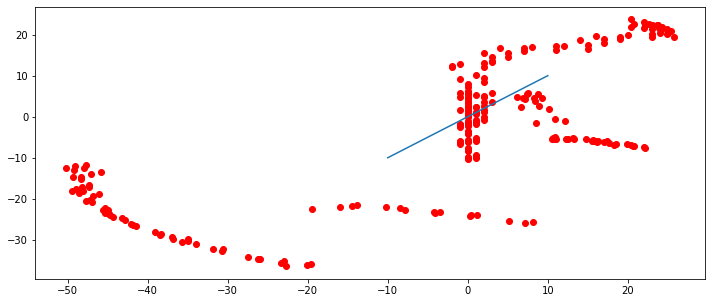

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
131.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

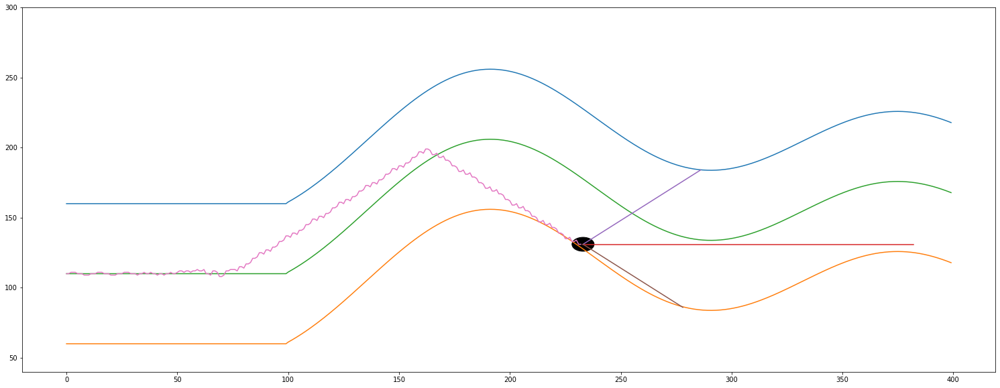

------------------------------ IF i % 3 == 2 ------------------------------
# i =  233
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor from left wall =  55
Sensor from right wall =  45
most távolsagra van a felső faltól =  97.62735551254764
most távolsagra van az alsó faltól =  2.372644487452348
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  233
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -47.62735551254764
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -47.62735551254764
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  234
			 len(self.sensor_left)   =  234
			 len(self.sensor_center) =  234
			 len(self.sensor_right)  =  234
	

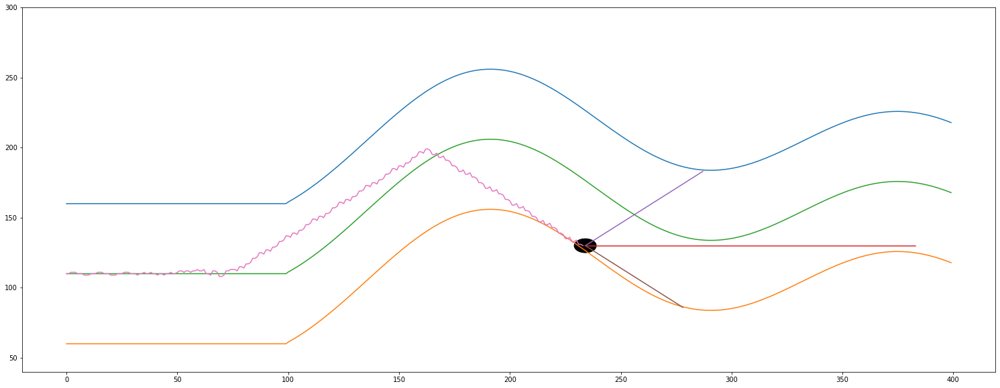

------------------------------ IF i % 3 == 0 ------------------------------
# i =  234
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (235, 3)
y.shape =  (235, 1)
i       =  234
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  234
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1.]
(78, 4)
(78, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array([11

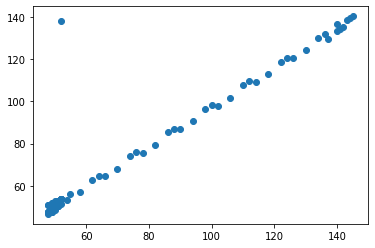

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98275428 -0.29486857]]


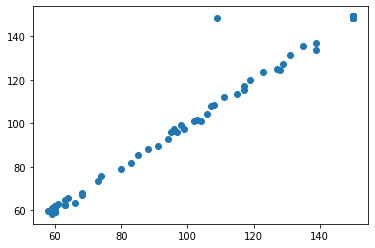

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99660248 0.92142172]]


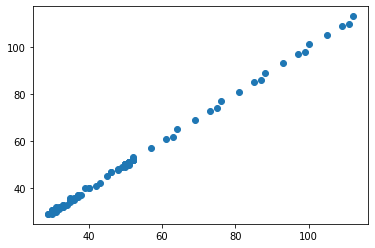

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.92373171]]
-------- 1 y up ->  center =  [[2.28828407]]
-------- 1 y up ->  right  =  [[2.17327327]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[54 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[45 -3]]
		 predicted_left   =  [[60.43024898]]
		 predicted_center =  [[149.89814598]]
		 predicted_right  =  [[42.33809571]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93218344 -2.02519876]]
		 regression_center.coef_ =  [[ 0.98275428 -0.29486857]]
		 regression_right.coef_  =  [[0

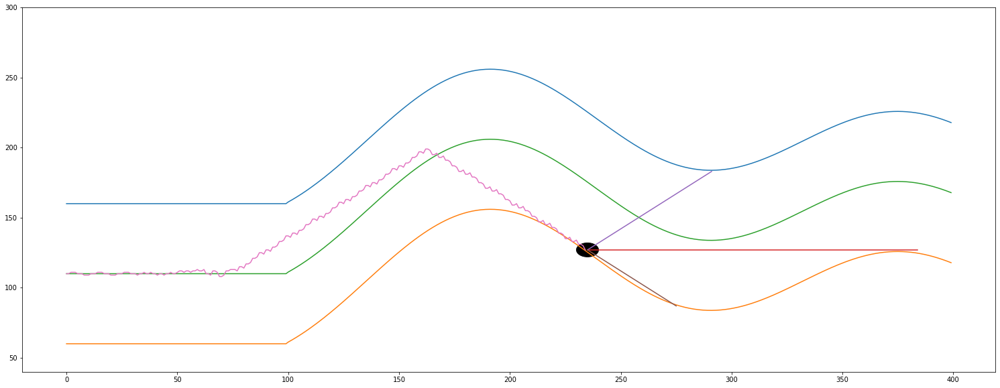

------------------------------ IF i % 3 == 1 ------------------------------
# i =  235
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 57 150  41]]
actual predicted =  [[-10.73773682]]
actual self.y_distance[-1] =  -48.3677254251873
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

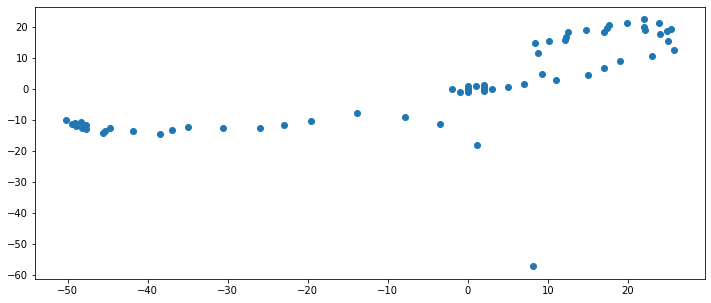

(236, 1)
(236, 1)


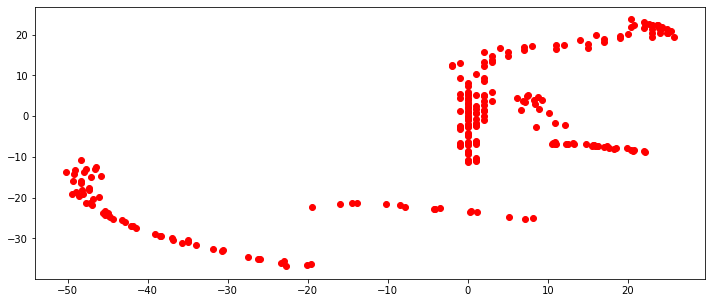

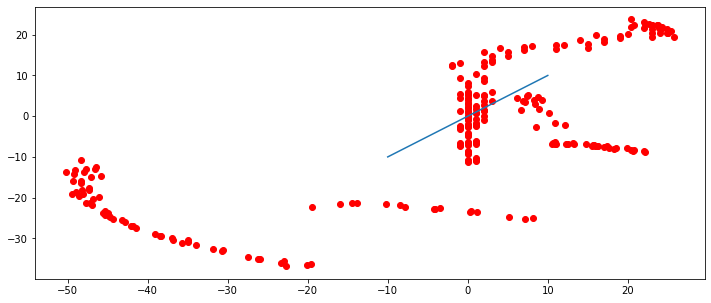

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
127.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

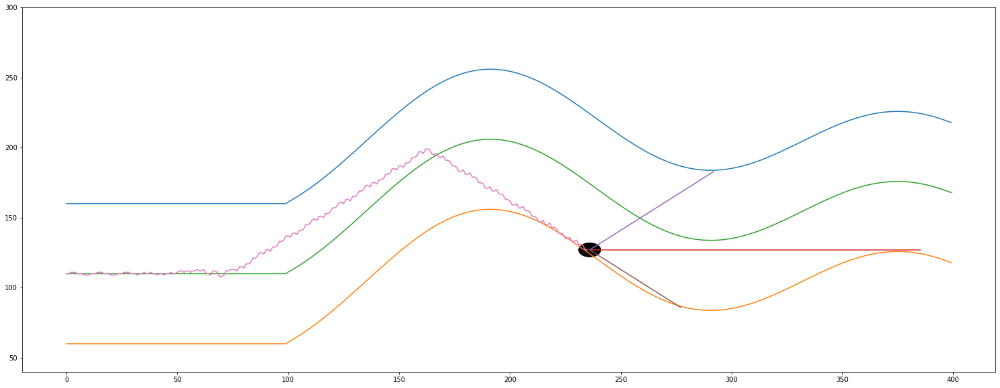

------------------------------ IF i % 3 == 2 ------------------------------
# i =  236
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor from left wall =  58
Sensor from right wall =  40
most távolsagra van a felső faltól =  98.23026926402522
most távolsagra van az alsó faltól =  1.7697307359747754
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  236
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -48.230269264025225
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -48.230269264025225
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  237
			 len(self.sensor_left)   =  237
			 len(self.sensor_center) =  237
			 len(self.sensor_right)  =  2

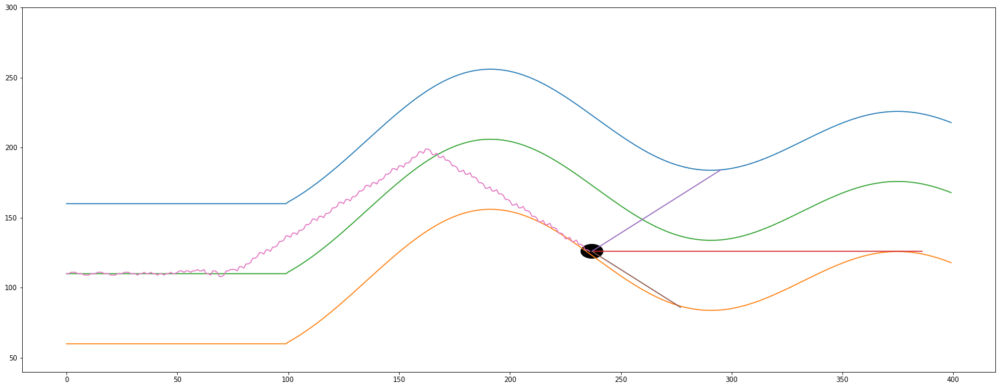

------------------------------ IF i % 3 == 0 ------------------------------
# i =  237
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (238, 3)
y.shape =  (238, 1)
i       =  237
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  237
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.]
(79, 4)
(79, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), array

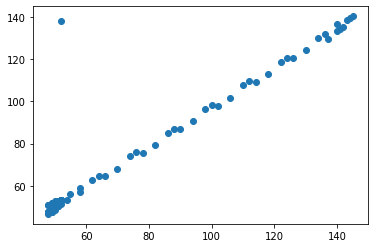

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98302335 -0.30358366]]


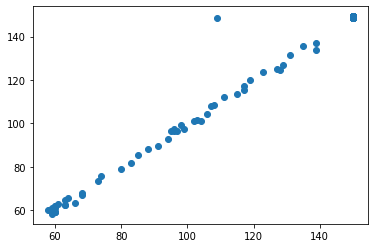

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99692746 0.93642461]]


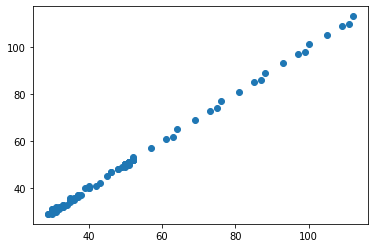

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.90547828]]
-------- 1 y up ->  center =  [[2.2581826]]
-------- 1 y up ->  right  =  [[2.15669941]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[59 -3]]
		 _X_center =  [[150  -3]]
		 _X_right  =  [[41 -3]]
		 predicted_left   =  [[65.02855478]]
		 predicted_center =  [[149.94299646]]
		 predicted_right  =  [[38.28809946]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93242241 -2.01064424]]
		 regression_center.coef_ =  [[ 0.98302335 -0.30358366]]
		 regression_right.coef_  =  [[0.

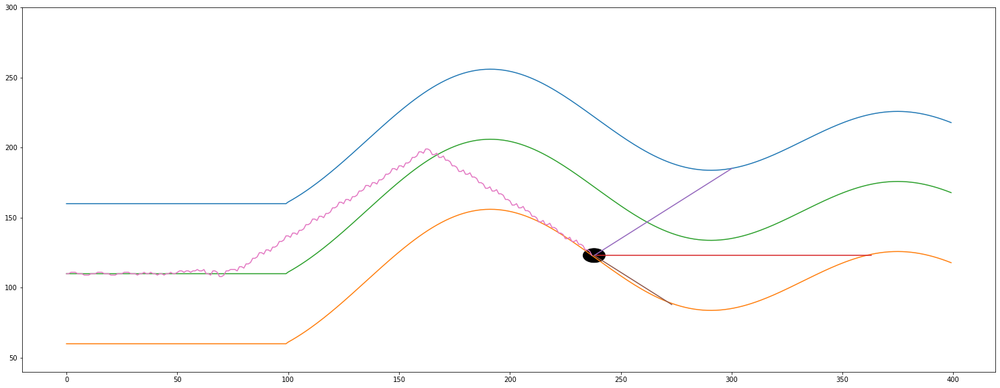

------------------------------ IF i % 3 == 1 ------------------------------
# i =  238
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 63 126  36]]
actual predicted =  [[-1.27179643]]
actual self.y_distance[-1] =  -48.945918290281185
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

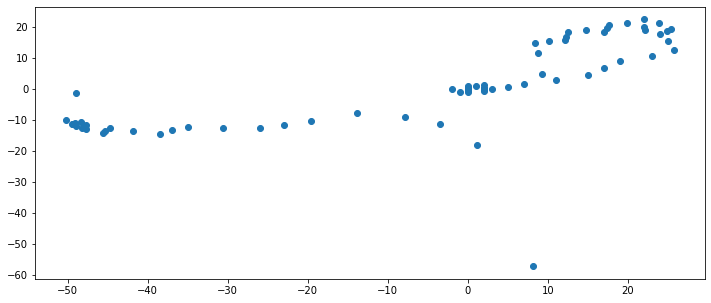

(239, 1)
(239, 1)


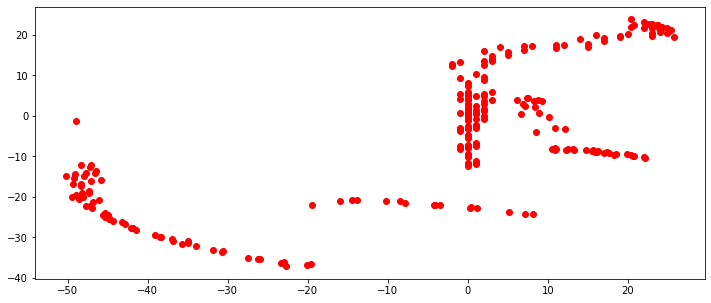

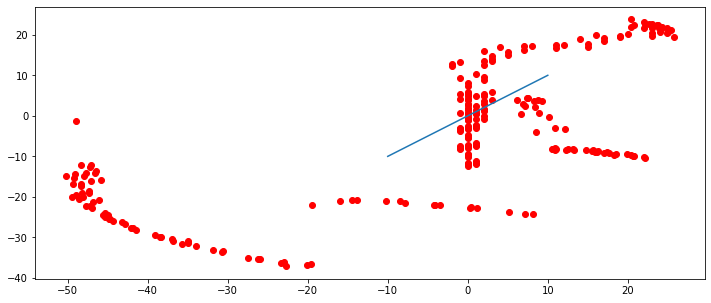

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
123.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

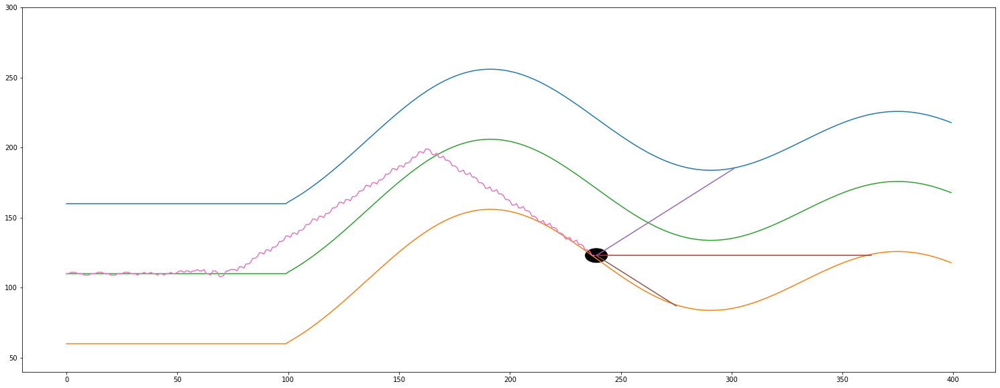

------------------------------ IF i % 3 == 2 ------------------------------
# i =  239
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  129
Sensor from left wall =  62
Sensor from right wall =  39
most távolsagra van a felső faltól =  96.80135997507864
most távolsagra van az alsó faltól =  3.1986400249213744
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  239
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -46.80135997507864
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -46.80135997507864
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  240
			 len(self.sensor_left)   =  240
			 len(self.sensor_center) =  240
			 len(self.se

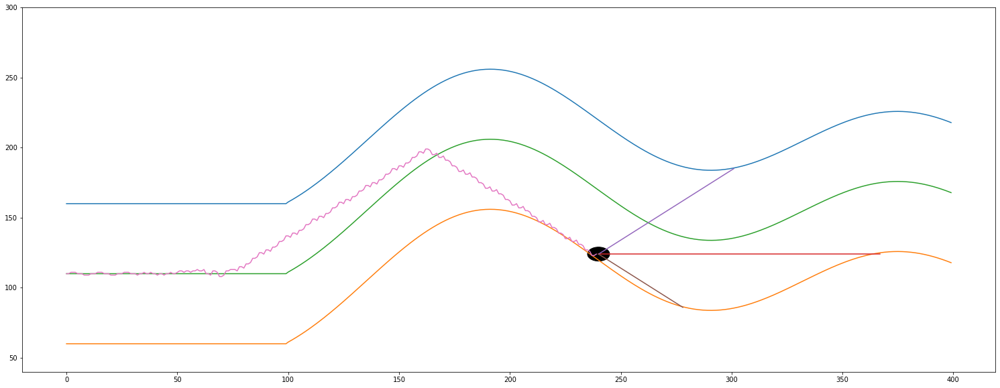

------------------------------ IF i % 3 == 0 ------------------------------
# i =  240
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (241, 3)
y.shape =  (241, 1)
i       =  240
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  240
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.]
(80, 4)
(80, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]), a

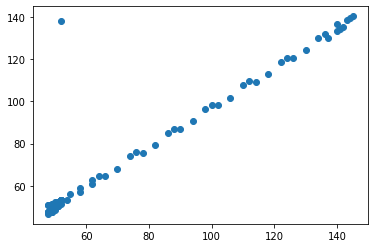

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98361474 -0.24324108]]


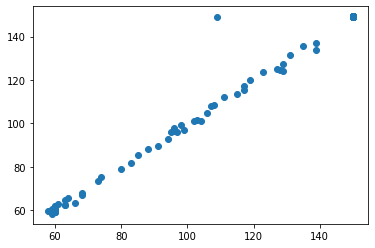

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99657372 0.94815837]]


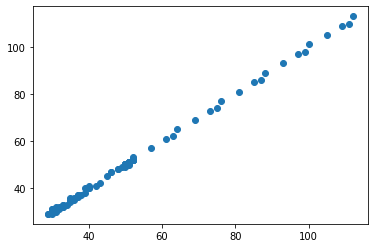

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.95210065]]
-------- 1 y up ->  center =  [[2.31301605]]
-------- 1 y up ->  right  =  [[2.19845561]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[62 -3]]
		 _X_center =  [[128  -3]]
		 _X_right  =  [[39 -3]]
		 predicted_left   =  [[67.79623849]]
		 predicted_center =  [[128.20505291]]
		 predicted_right  =  [[36.27562334]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93223149 -1.99450417]]
		 regression_center.coef_ =  [[ 0.98361474 -0.24324108]]
		 regression_right.coef_  =  [[0

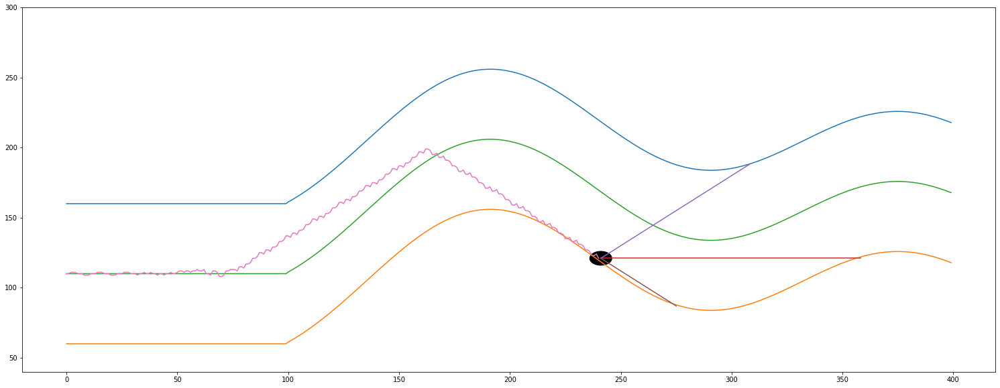

------------------------------ IF i % 3 == 1 ------------------------------
# i =  241
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 68 118  35]]
actual predicted =  [[0.57069235]]
actual self.y_distance[-1] =  -47.51330171217222
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735968

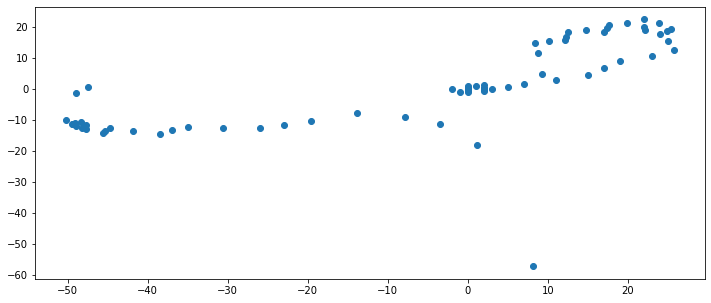

(242, 1)
(242, 1)


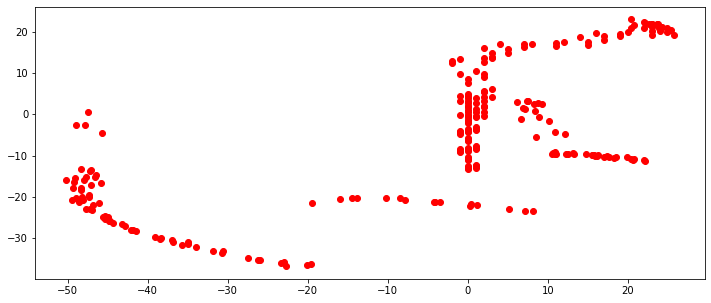

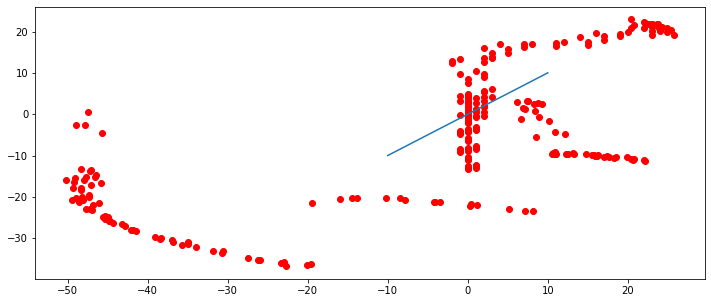

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
121.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

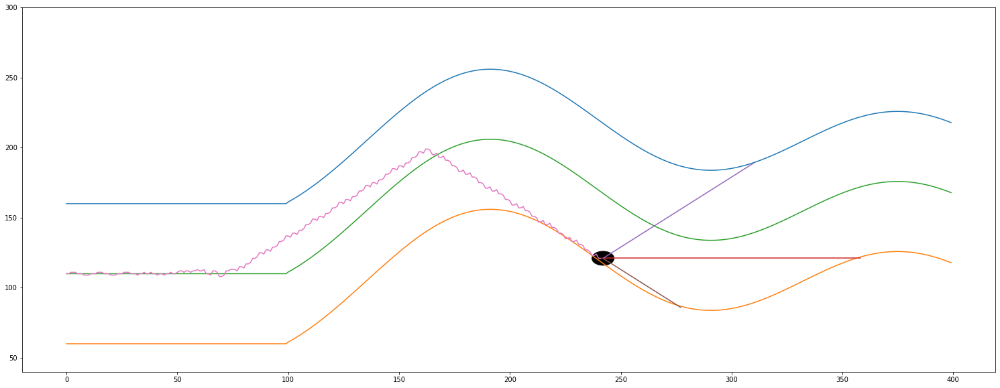

------------------------------ IF i % 3 == 2 ------------------------------
# i =  242
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  119
Sensor from left wall =  67
Sensor from right wall =  37
most távolsagra van a felső faltól =  95.37211929648709
most távolsagra van az alsó faltól =  4.627880703512929
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  242
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -45.372119296487085
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -45.372119296487085
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  243
			 len(self.sensor_left)   =  243
			 len(self.sensor_center) =  243
			 len(self.se

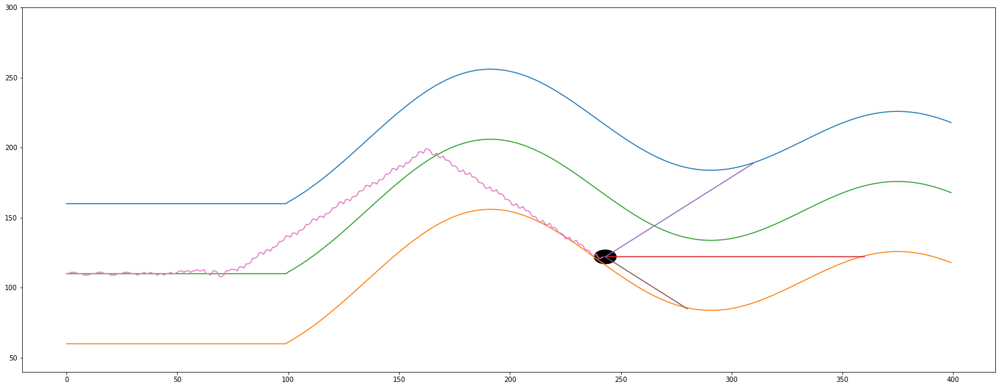

------------------------------ IF i % 3 == 0 ------------------------------
# i =  243
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (244, 3)
y.shape =  (244, 1)
i       =  243
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  243
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(81, 4)
(81, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  50.]

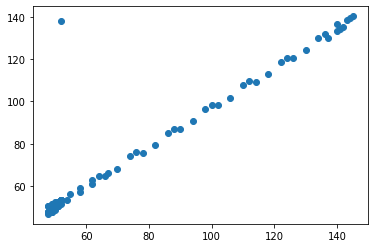

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98371437 -0.21172983]]


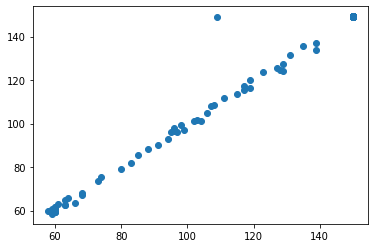

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99660389 0.94722259]]


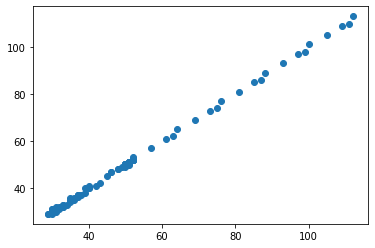

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.97223049]]
-------- 1 y up ->  center =  [[2.36494546]]
-------- 1 y up ->  right  =  [[2.19502403]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[68 -3]]
		 _X_center =  [[118  -3]]
		 _X_right  =  [[38 -3]]
		 predicted_left   =  [[73.37402738]]
		 predicted_center =  [[118.30644584]]
		 predicted_right  =  [[35.28047763]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93217708 -1.98648309]]
		 regression_center.coef_ =  [[ 0.98371437 -0.21172983]]
		 regression_right.coef_  =  [[0

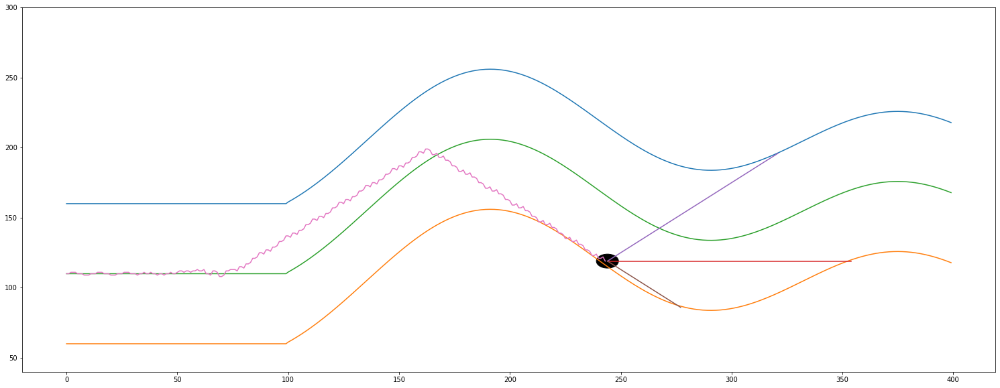

------------------------------ IF i % 3 == 1 ------------------------------
# i =  244
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 78 111  34]]
actual predicted =  [[1.90586041]]
actual self.y_distance[-1] =  -46.10119679365681
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735968

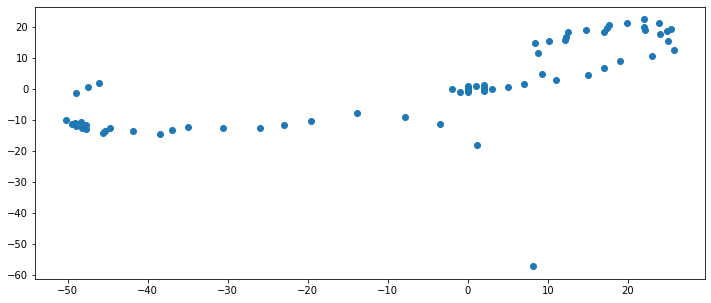

(245, 1)
(245, 1)


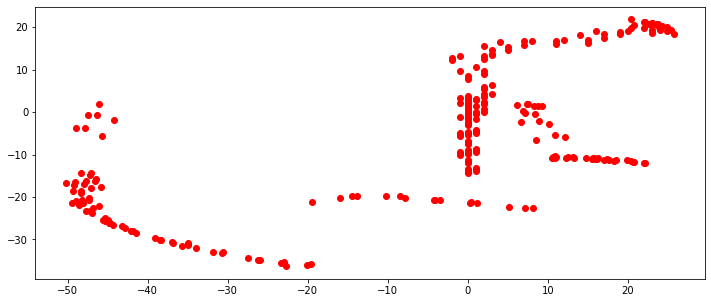

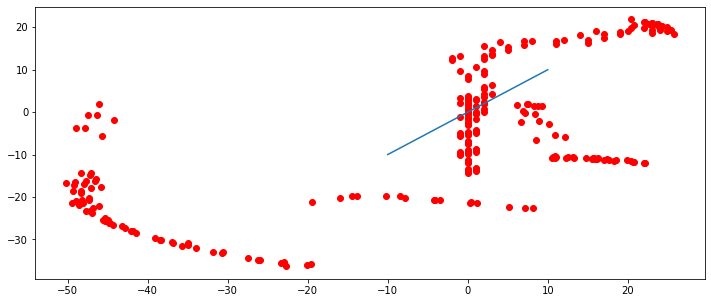

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
119.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

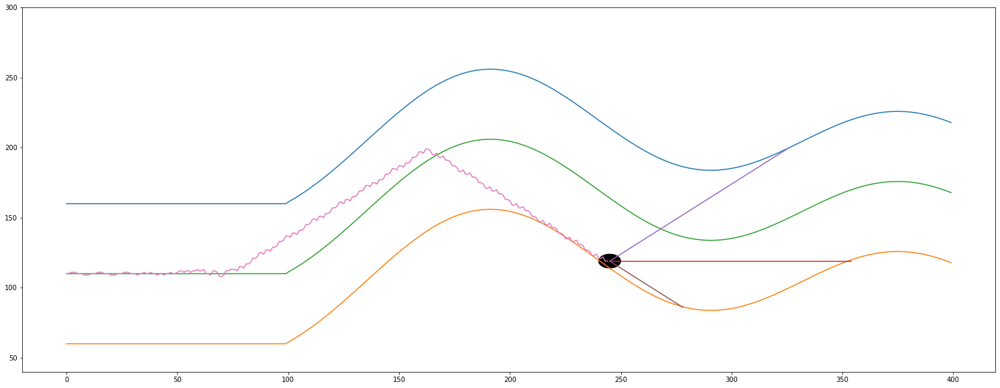

------------------------------ IF i % 3 == 2 ------------------------------
# i =  245
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  108
Sensor from left wall =  86
Sensor from right wall =  33
most távolsagra van a felső faltól =  95.97373317698907
most távolsagra van az alsó faltól =  4.026266823010928
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  245
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -45.97373317698907
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -45.97373317698907
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  246
			 len(self.sensor_left)   =  246
			 len(self.sensor_center) =  246
			 len(self.se

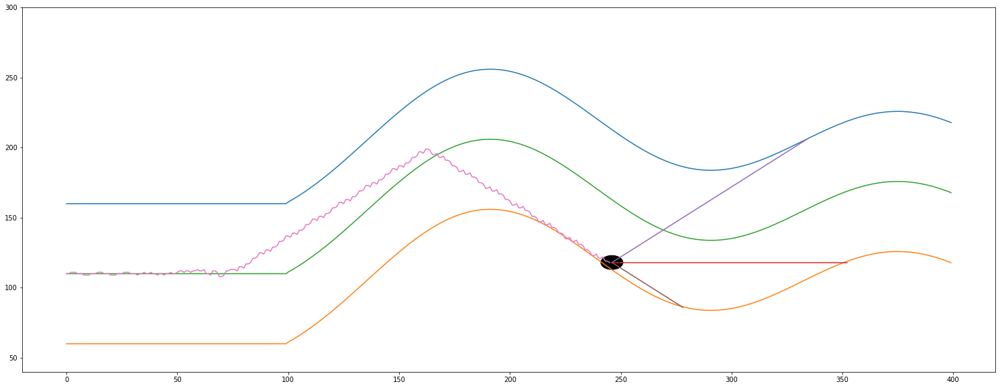

------------------------------ IF i % 3 == 0 ------------------------------
# i =  246
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (247, 3)
y.shape =  (247, 1)
i       =  246
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  246
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(82, 4)
(82, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128.,  

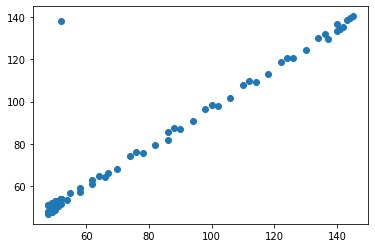

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98376199 -0.18720097]]


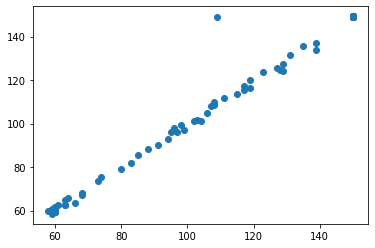

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99668983 0.94956443]]


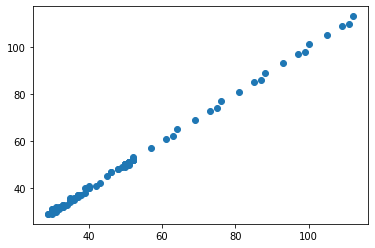

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.95511917]]
-------- 1 y up ->  center =  [[2.35959951]]
-------- 1 y up ->  right  =  [[2.19070602]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[89 -3]]
		 _X_center =  [[107  -3]]
		 _X_right  =  [[33 -3]]
		 predicted_left   =  [[93.17132434]]
		 predicted_center =  [[107.38717387]]
		 predicted_right  =  [[30.28652292]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93240274 -2.04119105]]
		 regression_center.coef_ =  [[ 0.98376199 -0.18720097]]
		 regression_right.coef_  =  [[0

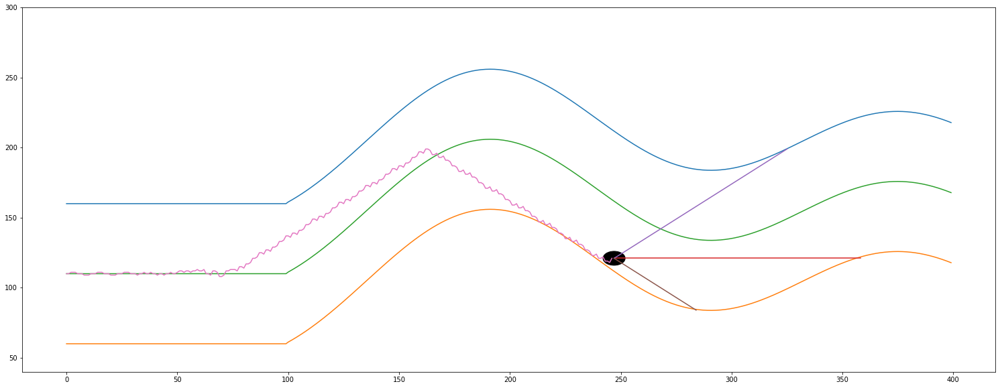

------------------------------ IF i % 3 == 1 ------------------------------
# i =  247
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 79 112  38]]
actual predicted =  [[-1.01076267]]
actual self.y_distance[-1] =  -40.740420216334115
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

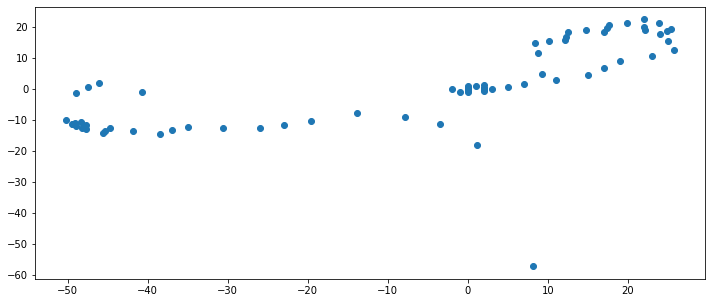

(248, 1)
(248, 1)


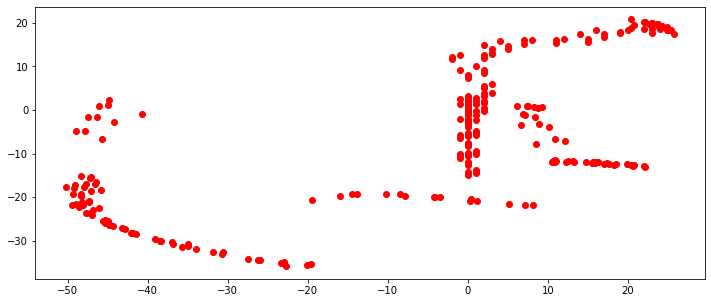

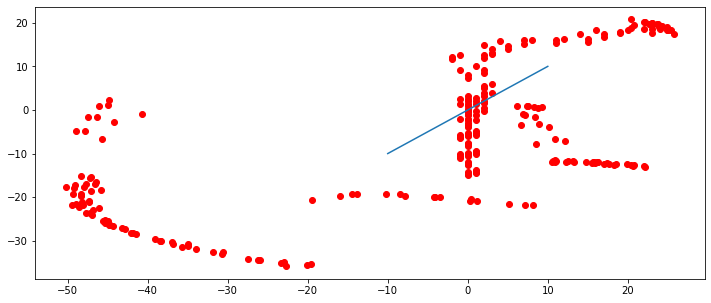

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
121.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

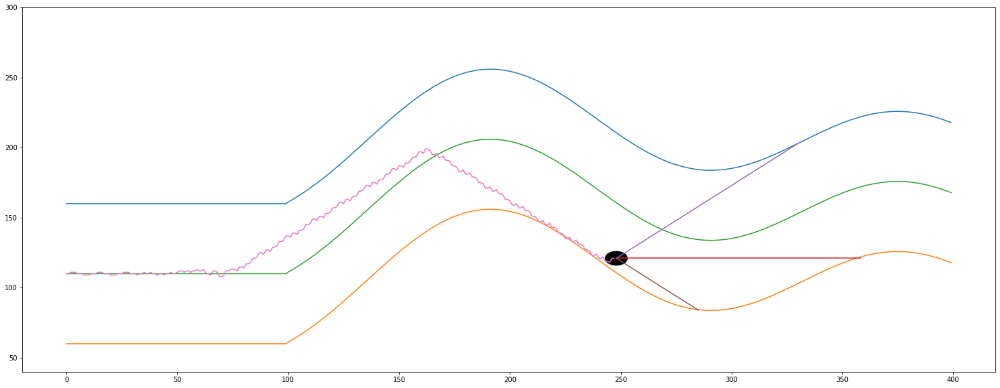

------------------------------ IF i % 3 == 2 ------------------------------
# i =  248
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  109
Sensor from left wall =  87
Sensor from right wall =  37
most távolsagra van a felső faltól =  90.63678461496039
most távolsagra van az alsó faltól =  9.363215385039624
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  248
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -40.63678461496039
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -40.63678461496039
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  249
			 len(self.sensor_left)   =  249
			 len(self.sensor_center) =  249
			 len(self.s

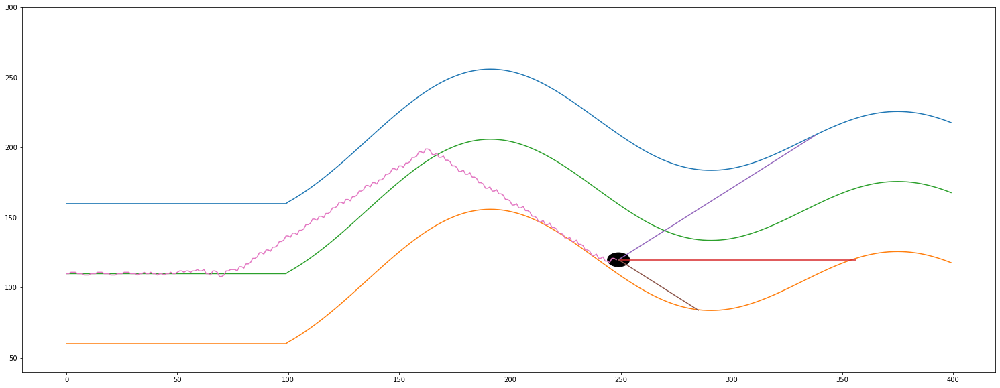

------------------------------ IF i % 3 == 0 ------------------------------
# i =  249
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (250, 3)
y.shape =  (250, 1)
i       =  249
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  249
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(83, 4)
(83, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52., 128

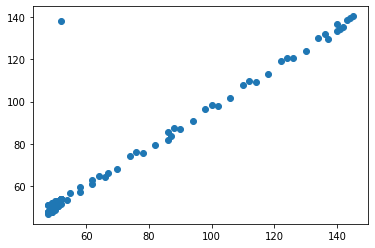

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98378734 -0.1640254 ]]


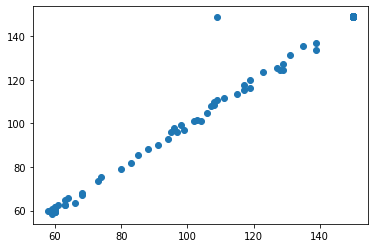

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.9967483  0.95159685]]


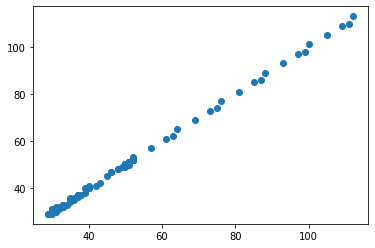

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.93656398]]
-------- 1 y up ->  center =  [[2.35675277]]
-------- 1 y up ->  right  =  [[2.18776836]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[90 -3]]
		 _X_center =  [[108  -3]]
		 _X_right  =  [[37 -3]]
		 predicted_left   =  [[94.27408501]]
		 predicted_center =  [[108.27809998]]
		 predicted_right  =  [[34.26431973]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93264744 -2.08297482]]
		 regression_center.coef_ =  [[ 0.98378734 -0.1640254 ]]
		 regression_right.coef_  =  [[0

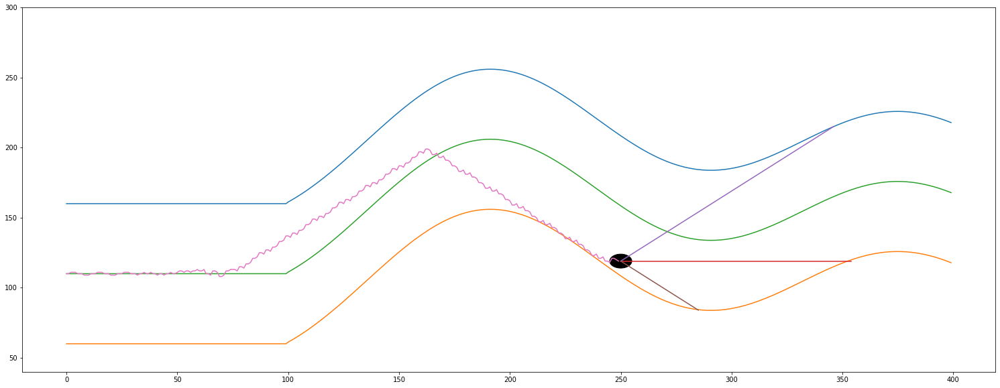

------------------------------ IF i % 3 == 1 ------------------------------
# i =  250
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 97 105  36]]
actual predicted =  [[0.84331948]]
actual self.y_distance[-1] =  -39.46099085812688
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.0929384735968

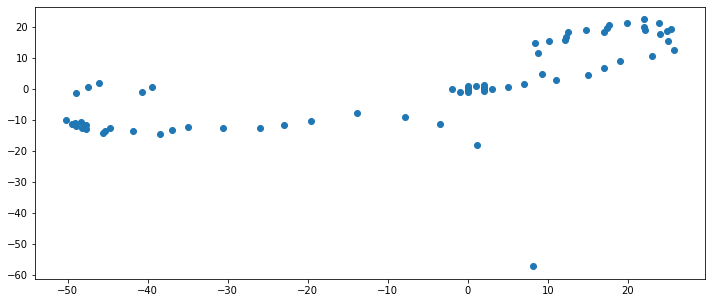

(251, 1)
(251, 1)


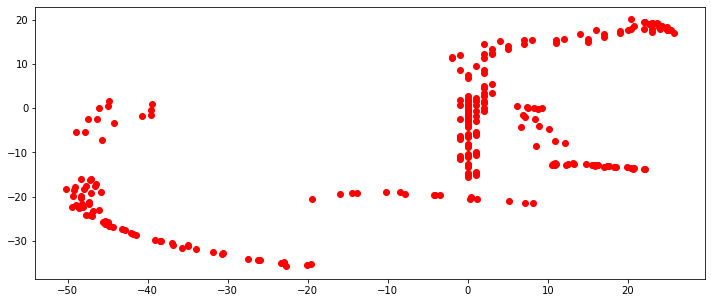

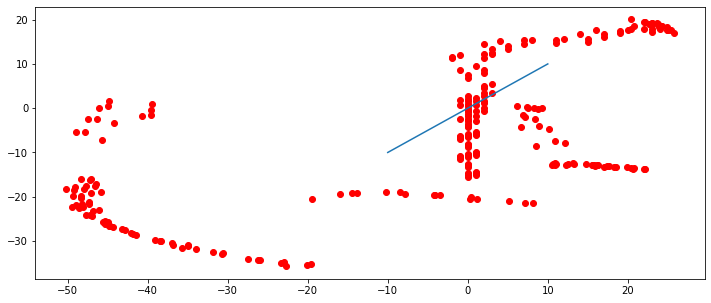

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
119.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

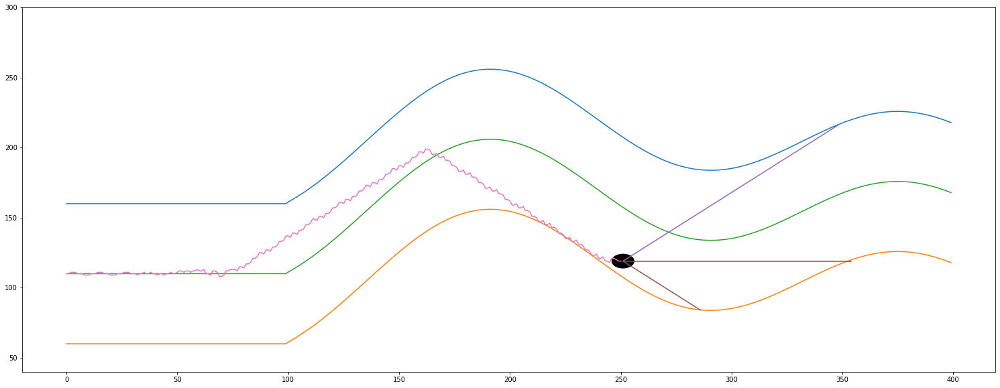

------------------------------ IF i % 3 == 2 ------------------------------
# i =  251
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  106
Sensor from left wall =  96
Sensor from right wall =  38
most távolsagra van a felső faltól =  87.39096269621717
most távolsagra van az alsó faltól =  12.609037303782813
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  251
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -37.39096269621717
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -37.39096269621717
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  252
			 len(self.sensor_left)   =  252
			 len(self.sensor_center) =  252
			 len(self.se

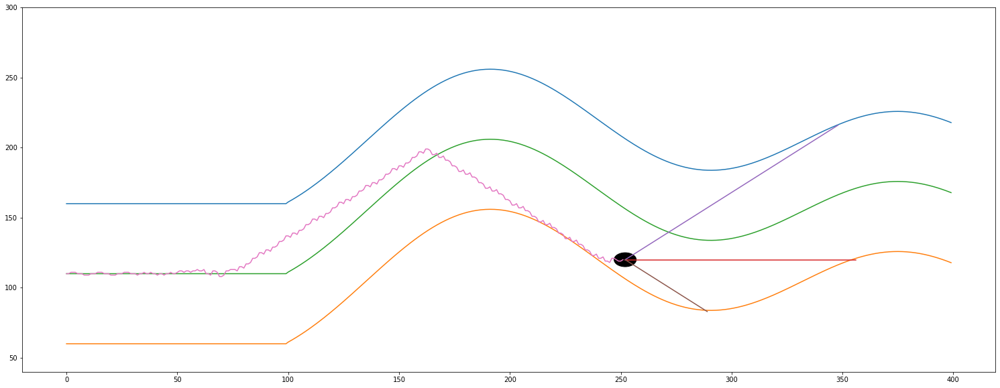

------------------------------ IF i % 3 == 0 ------------------------------
# i =  252
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (253, 3)
y.shape =  (253, 1)
i       =  252
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  252
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(84, 4)
(84, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  52.,

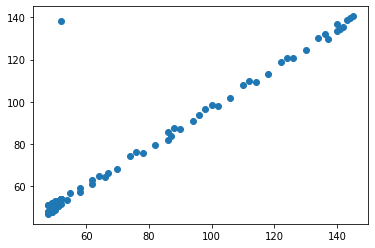

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98357163 -0.13640314]]


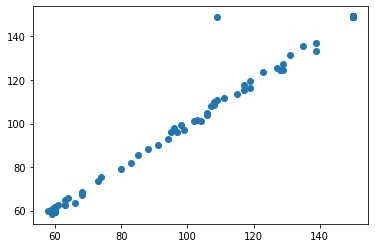

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99640756 0.96244672]]


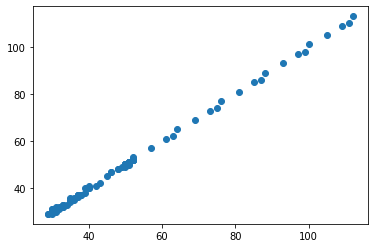

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.95523271]]
-------- 1 y up ->  center =  [[2.43599796]]
-------- 1 y up ->  right  =  [[2.22681359]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[97 -3]]
		 _X_center =  [[105  -3]]
		 _X_right  =  [[38 -3]]
		 predicted_left   =  [[100.75296115]]
		 predicted_center =  [[105.27305993]]
		 predicted_right  =  [[35.24410625]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.9332128  -2.05232499]]
		 regression_center.coef_ =  [[ 0.98357163 -0.13640314]]
		 regression_right.coef_  =  [[

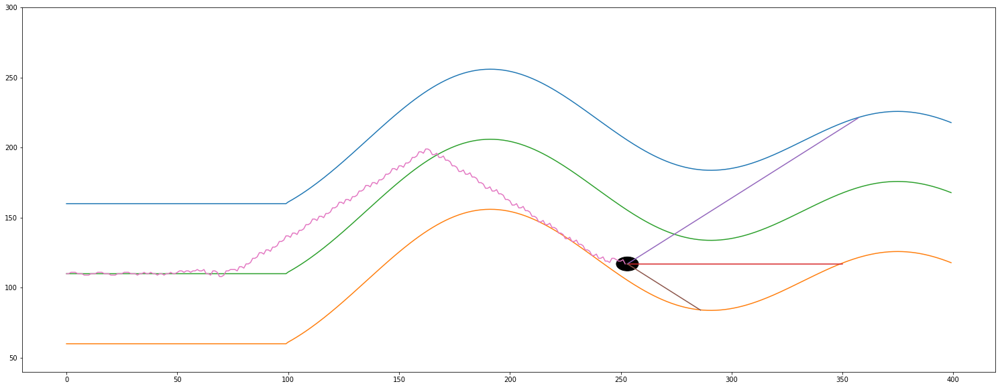

------------------------------ IF i % 3 == 1 ------------------------------
# i =  253
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[105  98  34]]
actual predicted =  [[2.99439344]]
actual self.y_distance[-1] =  -38.2918446328799
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359686

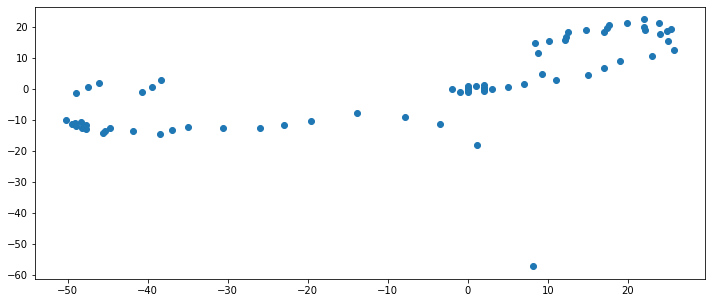

(254, 1)
(254, 1)


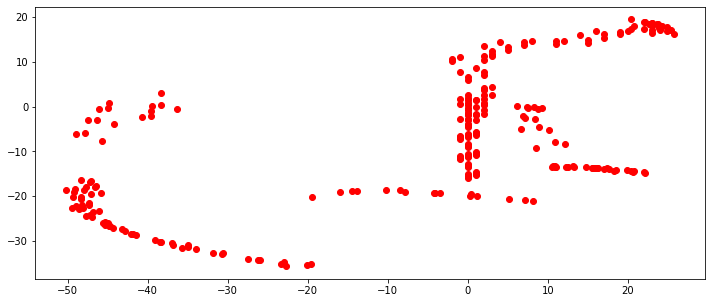

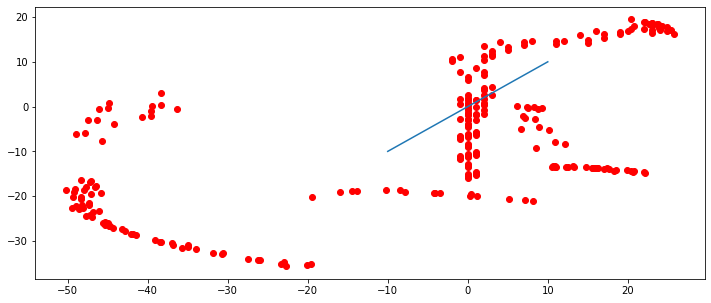

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
117.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

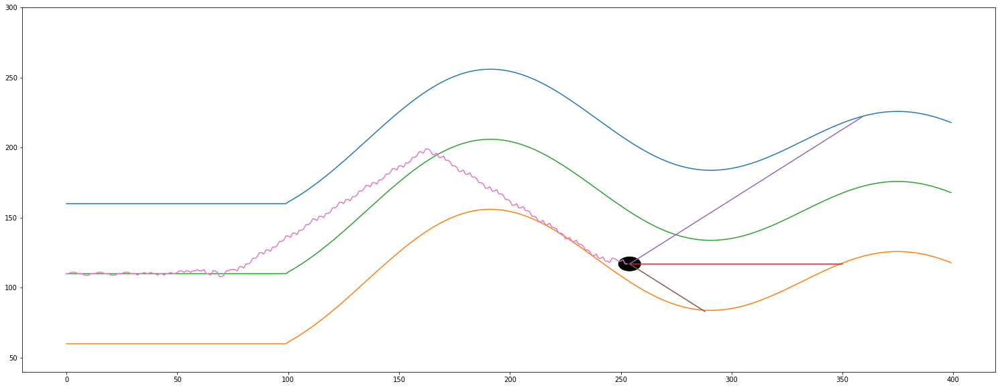

------------------------------ IF i % 3 == 2 ------------------------------
# i =  254
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  99
Sensor from left wall =  104
Sensor from right wall =  36
most távolsagra van a felső faltól =  86.26478080866298
most távolsagra van az alsó faltól =  13.735219191337023
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  254
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -36.26478080866298
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -36.26478080866298
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  255
			 len(self.sensor_left)   =  255
			 len(self.sensor_center) =  255
			 len(self.sen

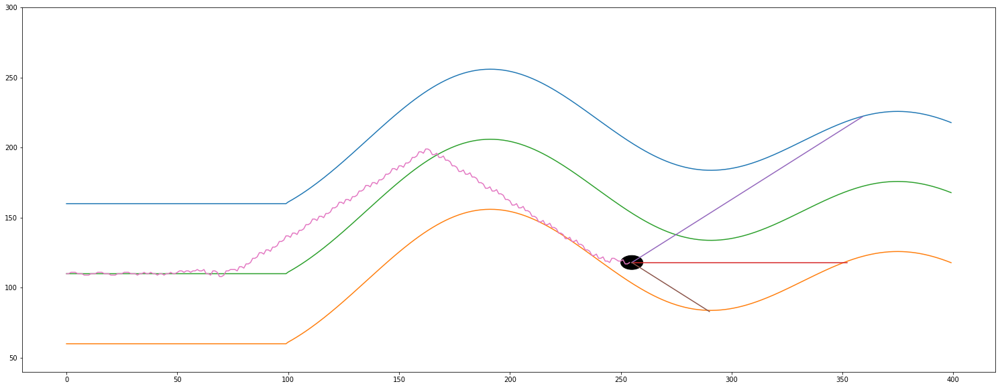

------------------------------ IF i % 3 == 0 ------------------------------
# i =  255
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (256, 3)
y.shape =  (256, 1)
i       =  255
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  255
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(85, 4)
(85, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109.,  

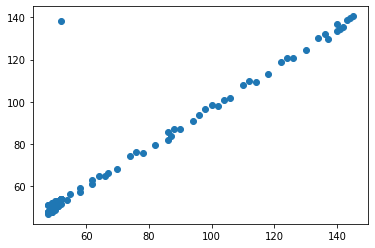

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98322661 -0.11143517]]


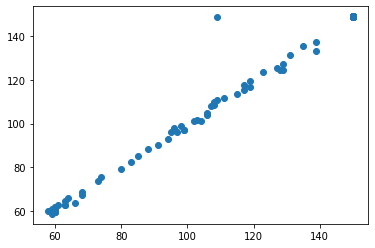

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99644746 0.96125742]]


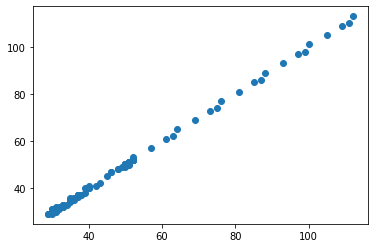

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.95747161]]
-------- 1 y up ->  center =  [[2.52432179]]
-------- 1 y up ->  right  =  [[2.2224037]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[105  -3]]
		 _X_center =  [[98 -3]]
		 _X_right  =  [[36 -3]]
		 predicted_left   =  [[108.17456112]]
		 predicted_center =  [[98.34304326]]
		 predicted_right  =  [[33.25303509]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93410713 -2.01748689]]
		 regression_center.coef_ =  [[ 0.98322661 -0.11143517]]
		 regression_right.coef_  =  [[0.

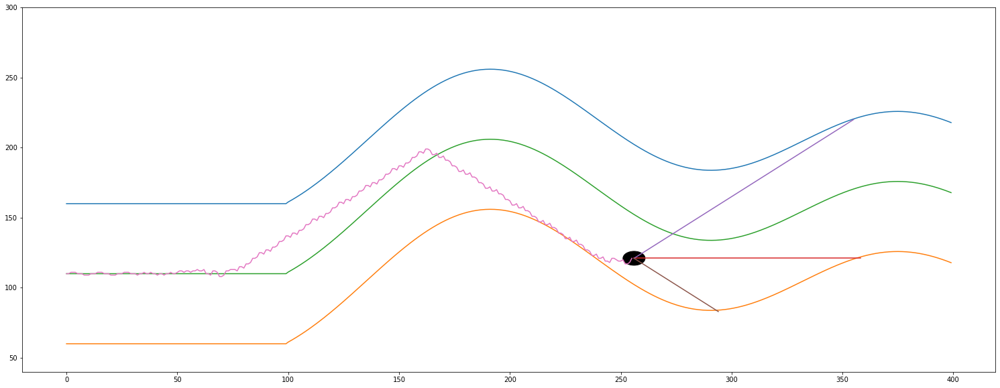

------------------------------ IF i % 3 == 1 ------------------------------
# i =  256
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[100 103  39]]
actual predicted =  [[-1.16129377]]
actual self.y_distance[-1] =  -31.260560384615502
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

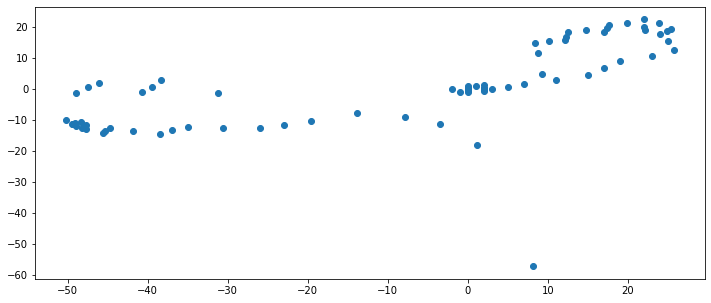

(257, 1)
(257, 1)


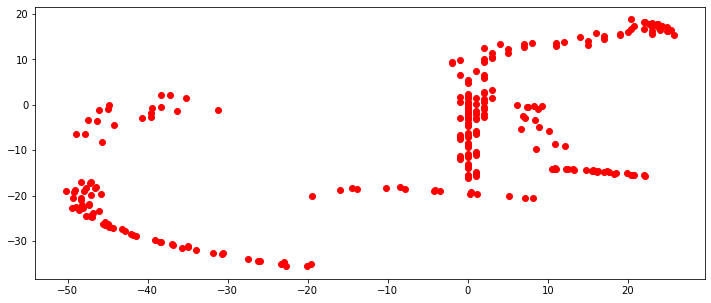

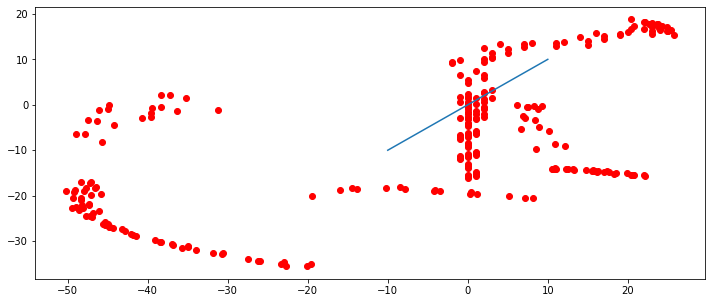

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
121.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

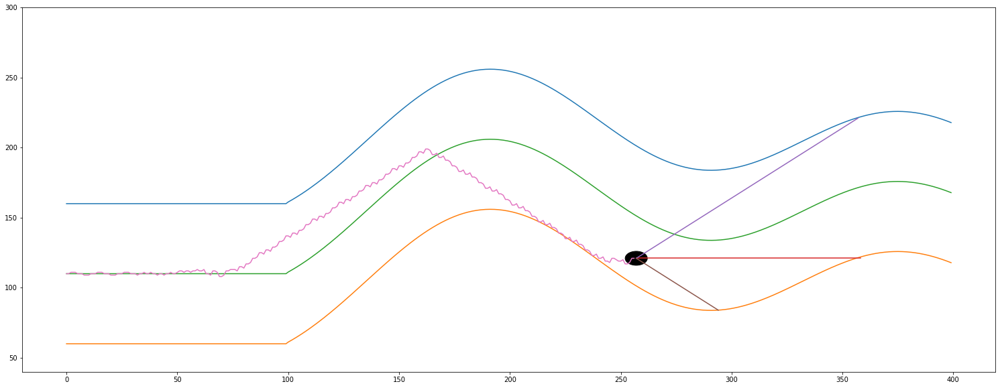

------------------------------ IF i % 3 == 2 ------------------------------
# i =  257
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  100
Sensor from left wall =  103
Sensor from right wall =  38
most távolsagra van a felső faltól =  81.28530683255414
most távolsagra van az alsó faltól =  18.71469316744586
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  257
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -31.28530683255414
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -31.28530683255414
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  258
			 len(self.sensor_left)   =  258
			 len(self.sensor_center) =  258
			 len(self.s

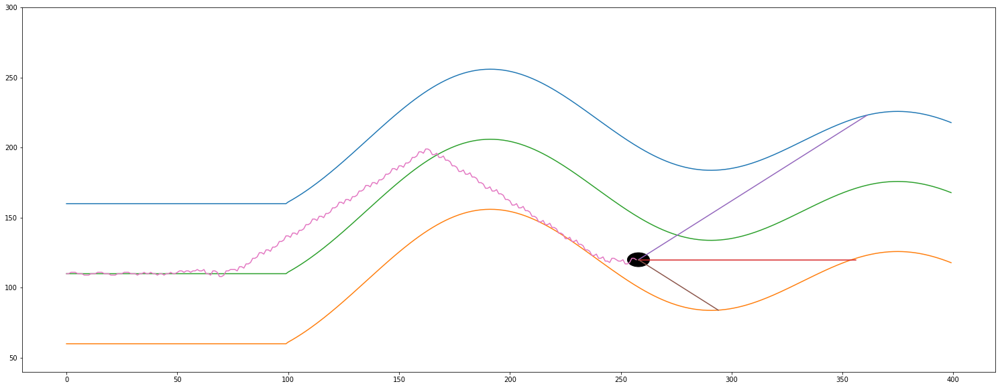

------------------------------ IF i % 3 == 0 ------------------------------
# i =  258
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (259, 3)
y.shape =  (259, 1)
i       =  258
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  258
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(86, 4)
(86, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array([109

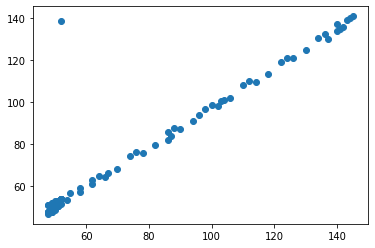

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98343794 -0.08763096]]


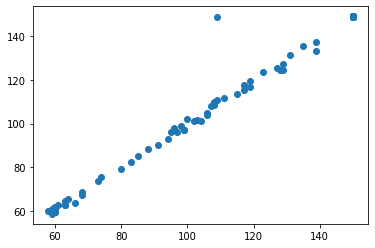

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99617118 0.9514404 ]]


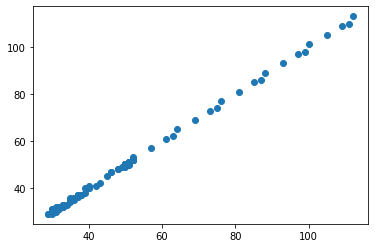

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.90759658]]
-------- 1 y up ->  center =  [[2.50072117]]
-------- 1 y up ->  right  =  [[2.23608292]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[104  -3]]
		 _X_center =  [[99 -3]]
		 _X_right  =  [[37 -3]]
		 predicted_left   =  [[107.3794038]]
		 predicted_center =  [[99.22816316]]
		 predicted_right  =  [[34.29248368]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93475486 -2.04801412]]
		 regression_center.coef_ =  [[ 0.98343794 -0.08763096]]
		 regression_right.coef_  =  [[0.

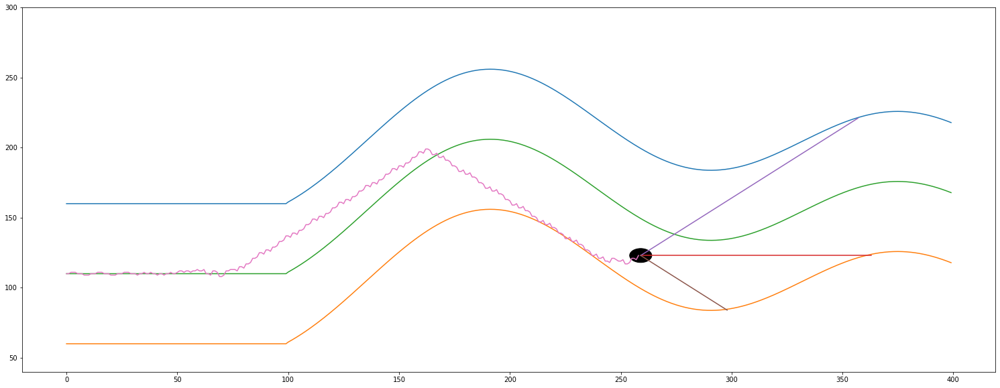

------------------------------ IF i % 3 == 1 ------------------------------
# i =  259
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 99 105  40]]
actual predicted =  [[-2.76541852]]
actual self.y_distance[-1] =  -26.393099558328572
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

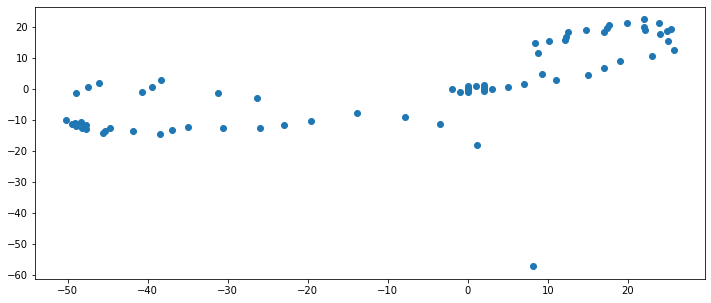

(260, 1)
(260, 1)


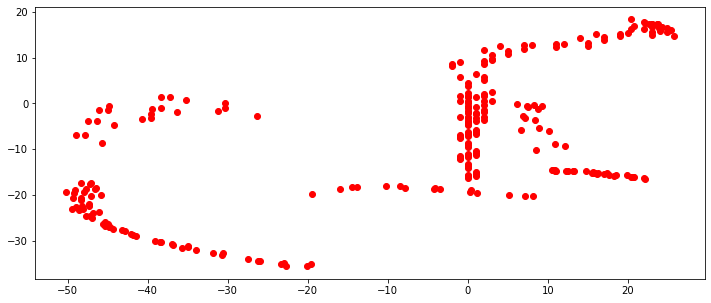

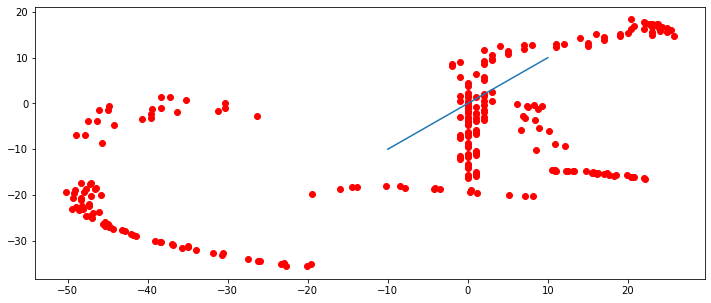

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
123.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

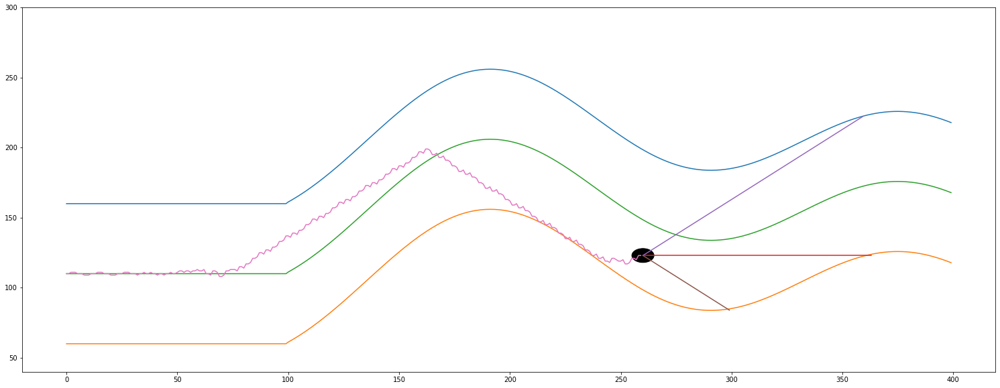

------------------------------ IF i % 3 == 2 ------------------------------
# i =  260
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  101
Sensor from left wall =  102
Sensor from right wall =  39
most távolsagra van a felső faltól =  76.4779079852654
most távolsagra van az alsó faltól =  23.52209201473461
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  260
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -26.477907985265404
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -26.477907985265404
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  261
			 len(self.sensor_left)   =  261
			 len(self.sensor_center) =  261
			 len(self

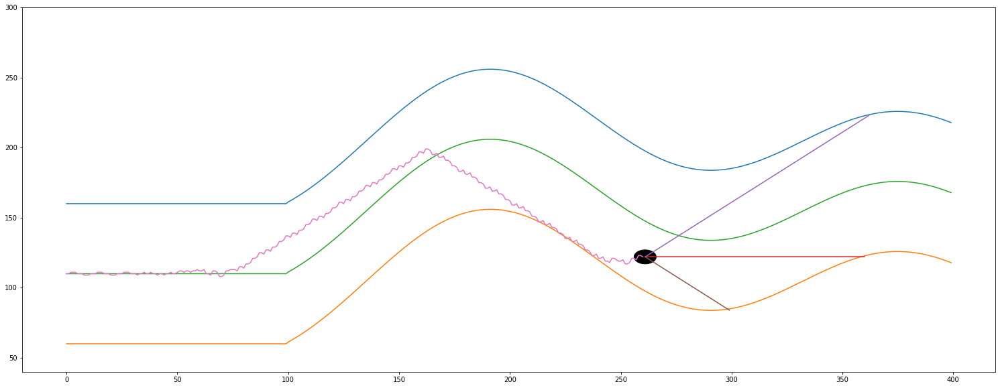

------------------------------ IF i % 3 == 0 ------------------------------
# i =  261
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (262, 3)
y.shape =  (262, 1)
i       =  261
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  261
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.]
(87, 4)
(87, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), array(

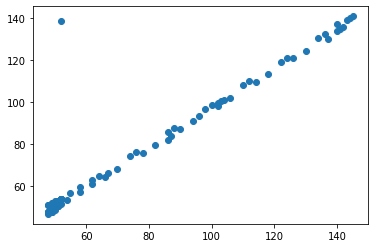

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98367695 -0.05397953]]


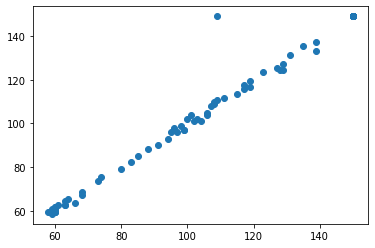

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99622193 0.95355039]]


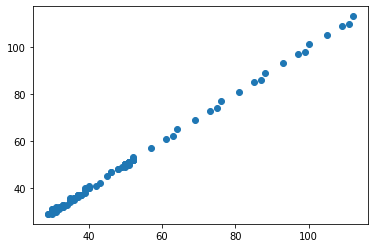

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.86366021]]
-------- 1 y up ->  center =  [[2.4740302]]
-------- 1 y up ->  right  =  [[2.23357021]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[102  -3]]
		 _X_center =  [[100  -3]]
		 _X_right  =  [[39 -3]]
		 predicted_left   =  [[105.6357793]]
		 predicted_center =  [[100.07396612]]
		 predicted_right  =  [[36.27580187]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93532546 -2.07606181]]
		 regression_center.coef_ =  [[ 0.98367695 -0.05397953]]
		 regression_right.coef_  =  [[

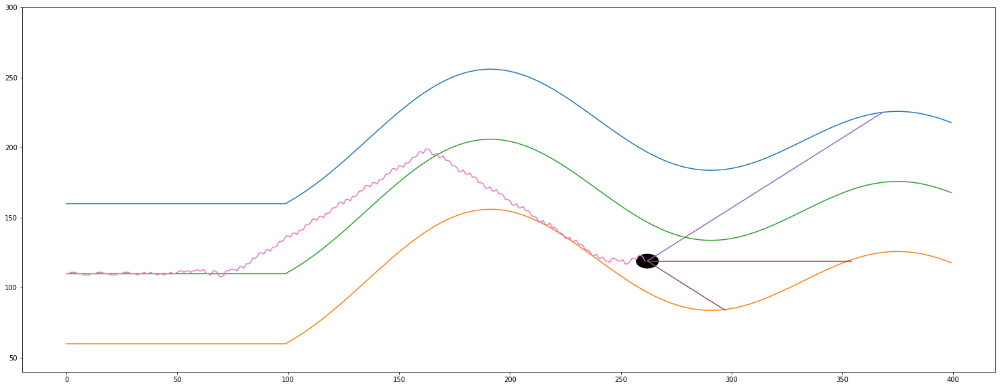

------------------------------ IF i % 3 == 1 ------------------------------
# i =  262
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[107  93  36]]
actual predicted =  [[2.12153208]]
actual self.y_distance[-1] =  -27.713562231330002
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

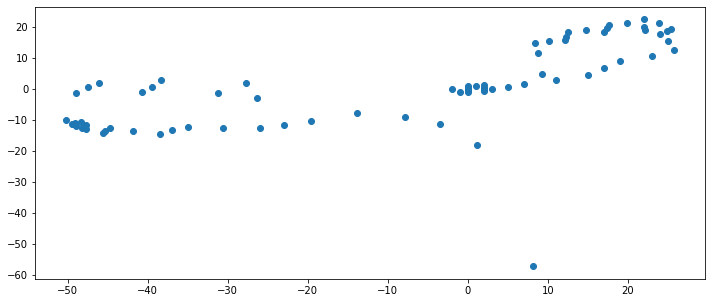

(263, 1)
(263, 1)


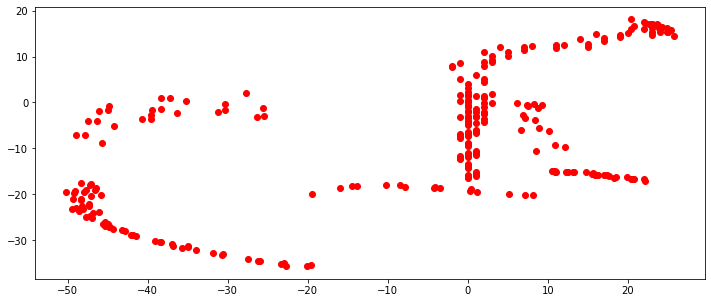

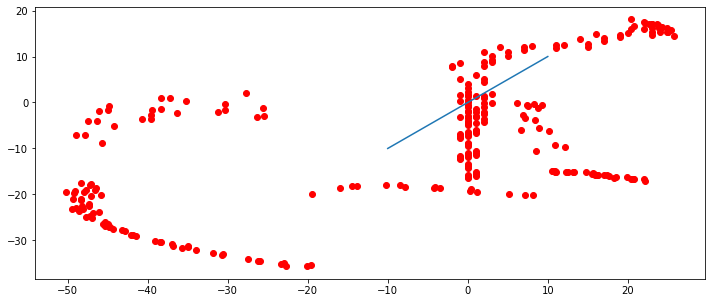

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
119.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

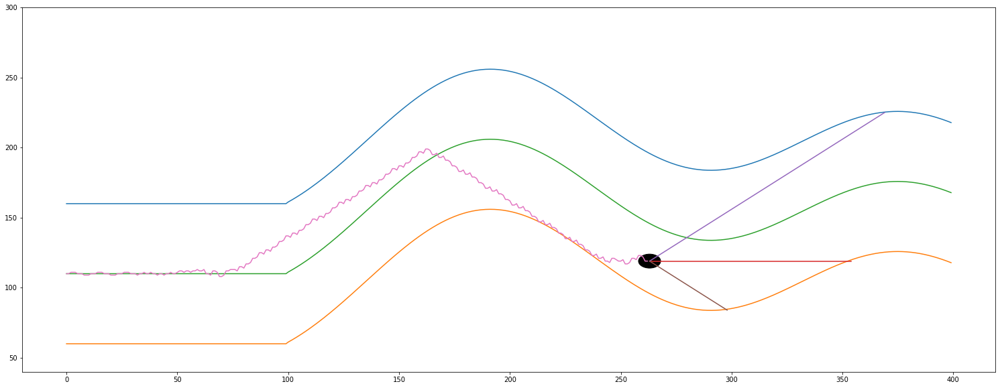

------------------------------ IF i % 3 == 2 ------------------------------
# i =  263
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  94
Sensor from left wall =  106
Sensor from right wall =  37
most távolsagra van a felső faltól =  75.8660128527975
most távolsagra van az alsó faltól =  24.133987147202504
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  263
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -25.866012852797496
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -25.866012852797496
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  264
			 len(self.sensor_left)   =  264
			 len(self.sensor_center) =  264
			 len(self.s

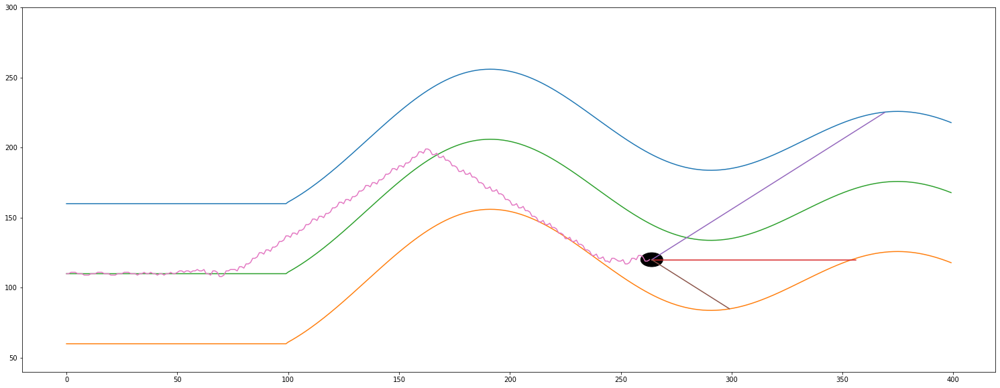

------------------------------ IF i % 3 == 0 ------------------------------
# i =  264
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (265, 3)
y.shape =  (265, 1)
i       =  264
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  264
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.]
(88, 4)
(88, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.]), ar

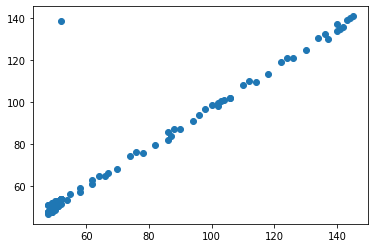

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98326165 -0.03104757]]


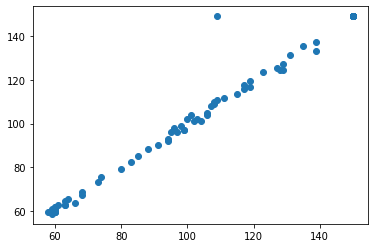

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.9962568  0.95241863]]


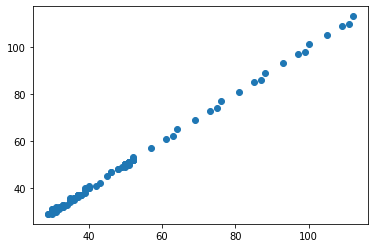

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.86441459]]
-------- 1 y up ->  center =  [[2.56592585]]
-------- 1 y up ->  right  =  [[2.2295521]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[106  -3]]
		 _X_center =  [[93 -3]]
		 _X_right  =  [[36 -3]]
		 predicted_left   =  [[109.32071803]]
		 predicted_center =  [[93.15018811]]
		 predicted_right  =  [[33.28886544]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93648398 -2.0313714 ]]
		 regression_center.coef_ =  [[ 0.98326165 -0.03104757]]
		 regression_right.coef_  =  [[0.

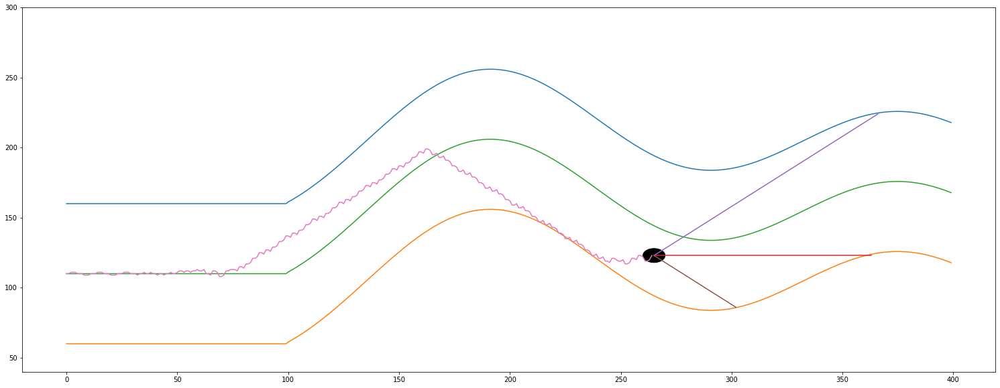

------------------------------ IF i % 3 == 1 ------------------------------
# i =  265
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[102  99  38]]
actual predicted =  [[-1.01805018]]
actual self.y_distance[-1] =  -21.243961925475105
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359

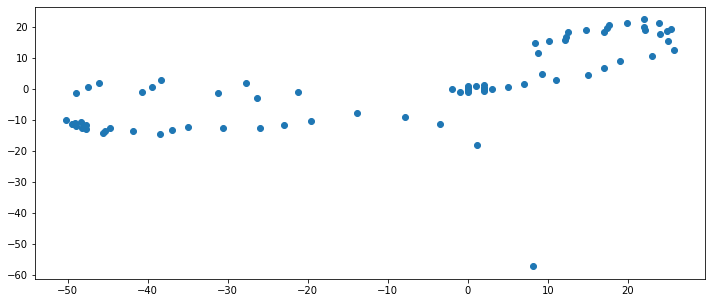

(266, 1)
(266, 1)


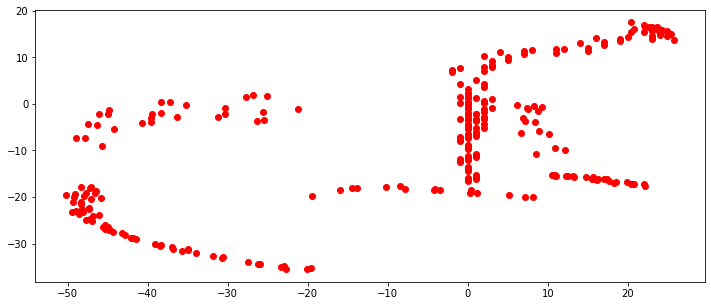

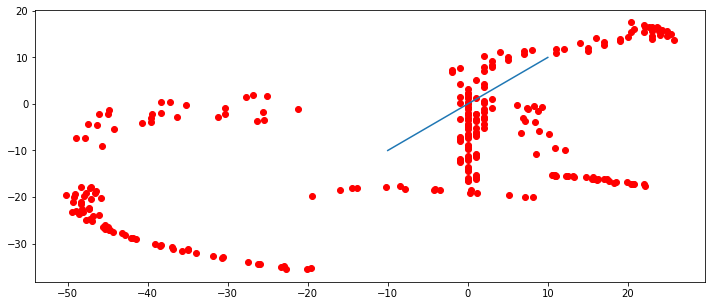

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
123.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

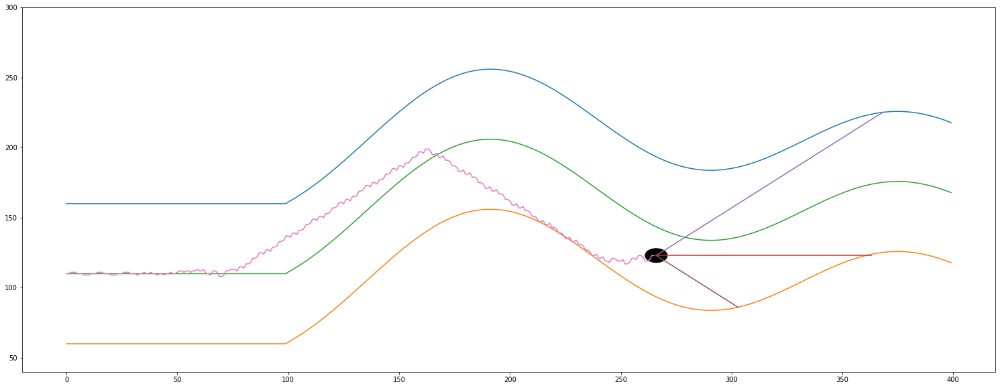

------------------------------ IF i % 3 == 2 ------------------------------
# i =  266
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up first
Sensor center =  102
Sensor from left wall =  101
Sensor from right wall =  39
most távolsagra van a felső faltól =  69.470892968349
most távolsagra van az alsó faltól =  30.52910703165098
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  266
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -19.470892968349006
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -19.470892968349006
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  267
			 len(self.sensor_left)   =  267
			 len(self.sensor_center) =  267
			 len(self.sen

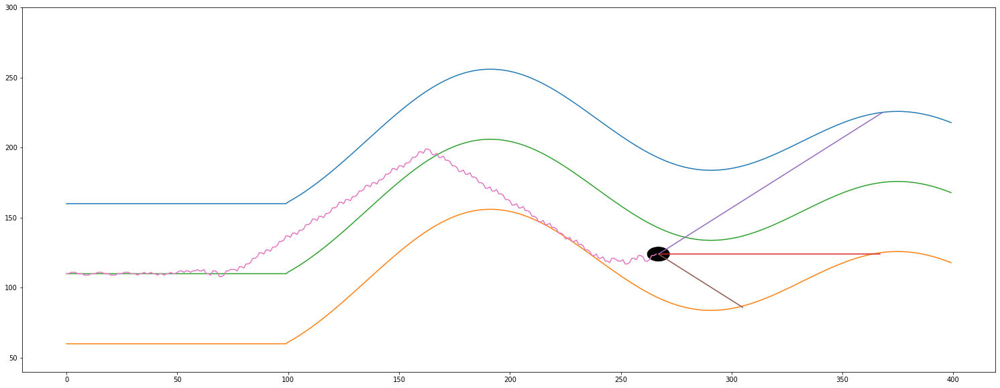

------------------------------ IF i % 3 == 0 ------------------------------
# i =  267
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (268, 3)
y.shape =  (268, 1)
i       =  267
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  267
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1.]
(89, 4)
(89, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  51.])

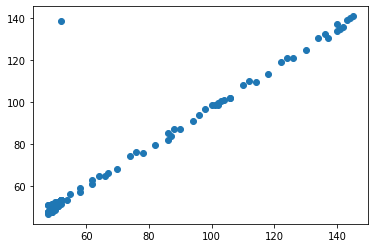

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.98268689 0.0140517 ]]


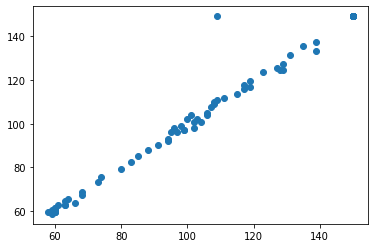

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99628302 0.95142538]]


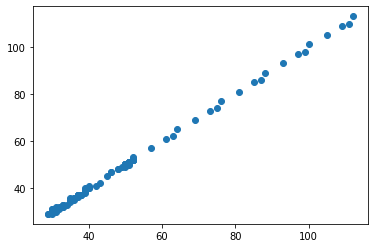

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.87297795]]
-------- 1 y up ->  center =  [[2.71983167]]
-------- 1 y up ->  right  =  [[2.2262461]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[102  -3]]
		 _X_center =  [[101  -3]]
		 _X_right  =  [[39 -3]]
		 predicted_left   =  [[105.53328293]]
		 predicted_center =  [[100.93231373]]
		 predicted_right  =  [[36.27929933]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93711736 -2.00286289]]
		 regression_center.coef_ =  [[0.98268689 0.0140517 ]]
		 regression_right.coef_  =  [[0

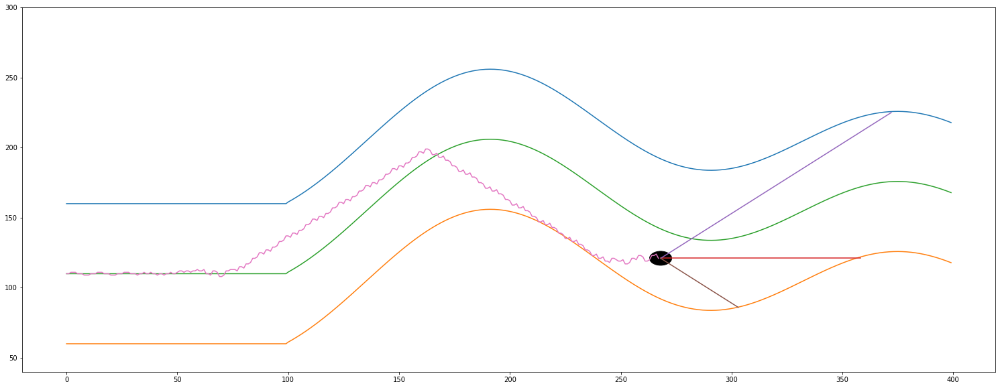

------------------------------ IF i % 3 == 1 ------------------------------
# i =  268
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[105  91  36]]
actual predicted =  [[2.11926026]]
actual self.y_distance[-1] =  -21.0040214327762
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.09293847359686

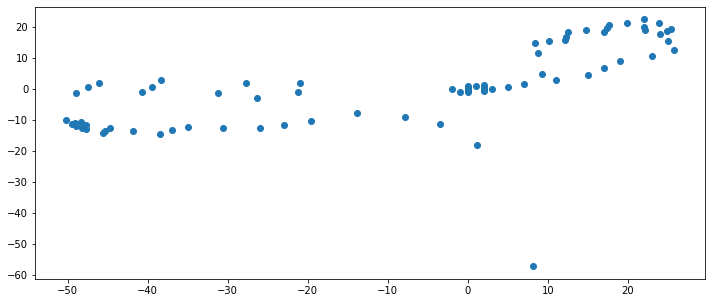

(269, 1)
(269, 1)


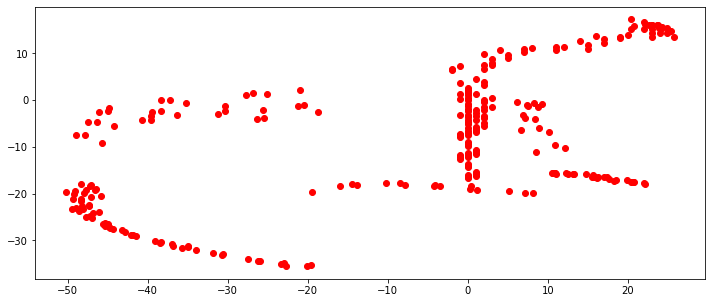

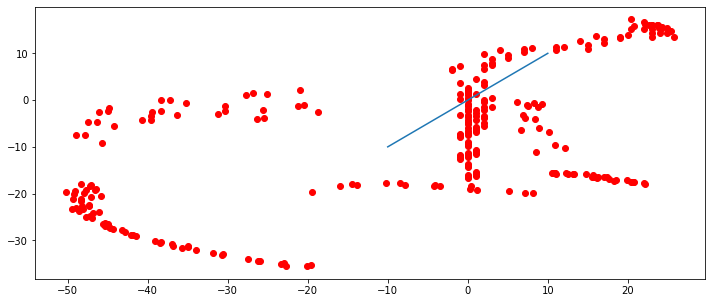

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
121.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

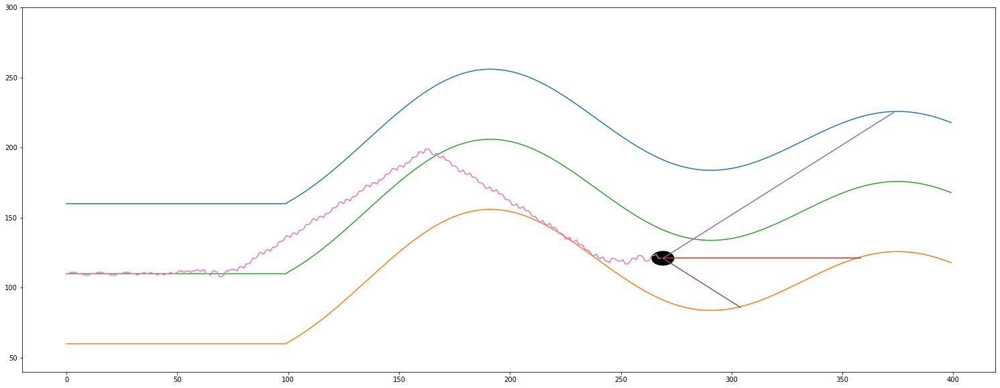

------------------------------ IF i % 3 == 2 ------------------------------
# i =  269
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  88
Sensor from left wall =  106
Sensor from right wall =  35
most távolsagra van a felső faltól =  71.31146610278591
most távolsagra van az alsó faltól =  28.6885338972141
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  269
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -21.311466102785914
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -21.311466102785914
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  270
			 len(self.sensor_left)   =  270
			 len(self.sensor_center) =  270
			 len(self.s

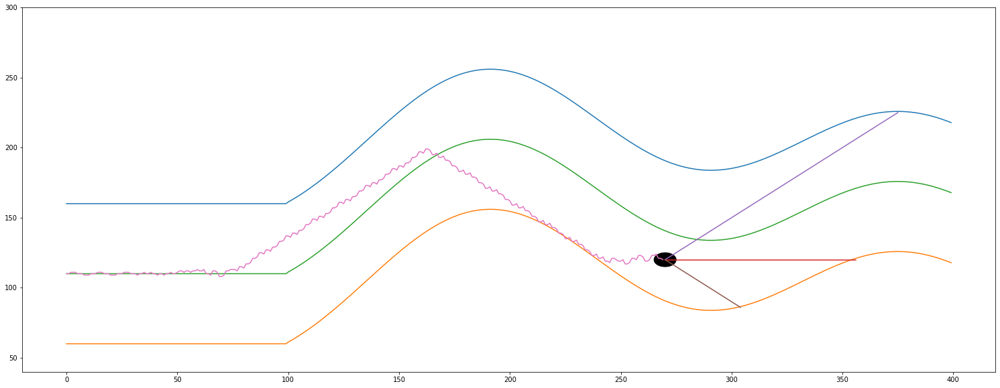

------------------------------ IF i % 3 == 0 ------------------------------
# i =  270
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (271, 3)
y.shape =  (271, 1)
i       =  270
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  270
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.]
(90, 4)
(90, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132.,  5

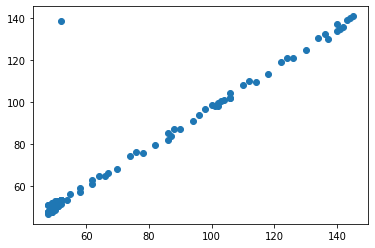

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.98315312 0.03782583]]


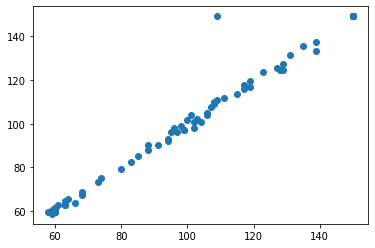

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99635263 0.95361029]]


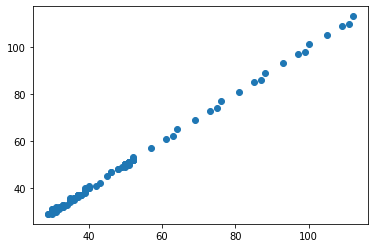

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.83768709]]
-------- 1 y up ->  center =  [[2.66813145]]
-------- 1 y up ->  right  =  [[2.22284112]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[106  -3]]
		 _X_center =  [[87 -3]]
		 _X_right  =  [[35 -3]]
		 predicted_left   =  [[109.368656]]
		 predicted_center =  [[87.06799671]]
		 predicted_right  =  [[32.28438953]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93756865 -2.02156515]]
		 regression_center.coef_ =  [[0.98315312 0.03782583]]
		 regression_right.coef_  =  [[0.996

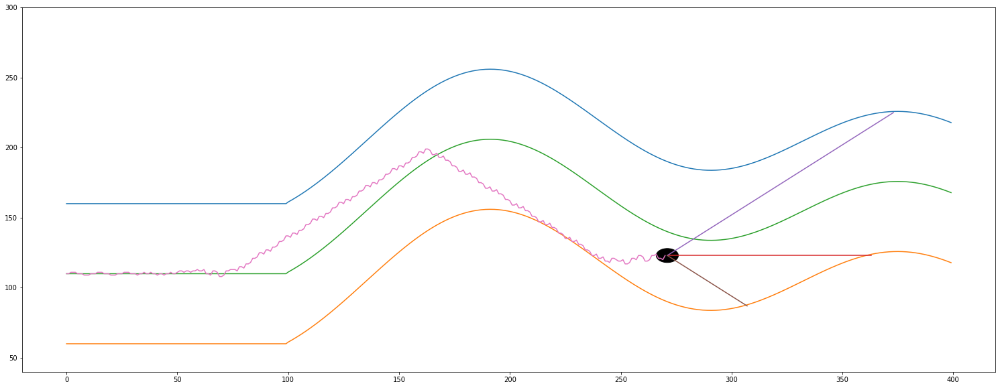

------------------------------ IF i % 3 == 1 ------------------------------
# i =  271
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[103  93  37]]
actual predicted =  [[0.75706699]]
actual self.y_distance[-1] =  -17.010991676774267
actual self.y_distance     =  [0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 1.0, 2.0, 2.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, -1.0, 2.0, 2.0, 1.0, -2.0, -2.0, -1.0, 2.0, 2.0, 3.0, 3.0, 3.0, 2.0, 5.0, 5.0, 4.0, 7.0, 7.0, 8.0, 11.0, 11.0, 12.0, 15.0, 15.0, 14.0, 17.0, 17.0, 16.0, 19.0, 19.0, 20.0, 23.0, 23.0, 24.0, 25.818148516678605, 24.926189710038045, 23.007796115695953, 25.06326743730733, 24.092938473596

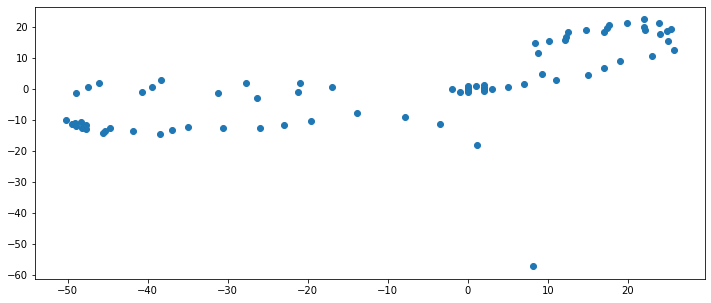

(272, 1)
(272, 1)


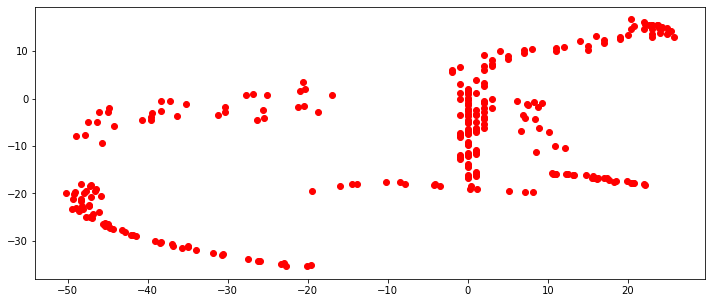

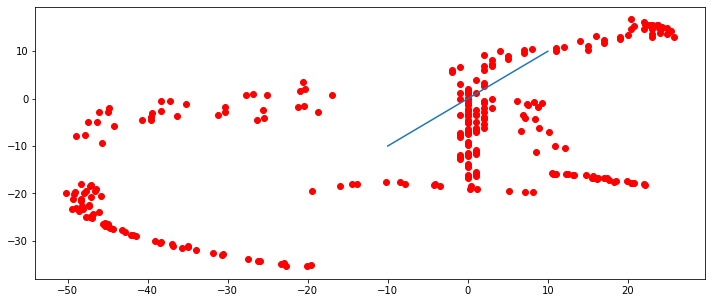

# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
123.0
#   self.y_history after append :
[110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 109.0, 109.0, 110.0, 110.0, 110.0, 111.0, 111.0, 111.0, 110.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 110.0, 110.0, 109.0, 110.0, 110.0, 109.0, 110.0, 110.0, 111.0, 110.0, 110.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 111.0, 112.0, 112.0, 113.0, 112.0, 112.0, 113.0, 110.0, 110.0, 109.0, 112.0, 112.0, 111.0, 108.0, 108.0, 109.0, 112.0, 112.0, 113.0, 113.0, 113.0, 112.0, 115.0, 115.0, 114.0, 117.0, 117.0, 118.0, 121.0, 121.0, 122.0, 125.0, 125.0, 124.0, 127.0, 127.0, 126.0, 129.0, 129.0, 130.0, 133.0, 133.0, 134.0, 137.0, 137.0, 136.0, 139.0, 139.0, 138.0, 1

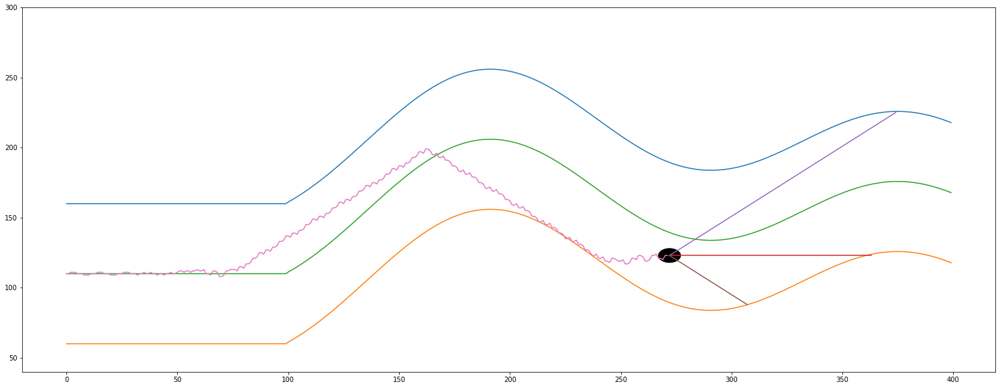

------------------------------ IF i % 3 == 2 ------------------------------
# i =  272
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  89
Sensor from left wall =  104
Sensor from right wall =  36
most távolsagra van a felső faltól =  67.40412321474838
most távolsagra van az alsó faltól =  32.59587678525163
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  272
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -17.40412321474838
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -17.40412321474838
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  273
			 len(self.sensor_left)   =  273
			 len(self.sensor_center) =  273
			 len(self.s

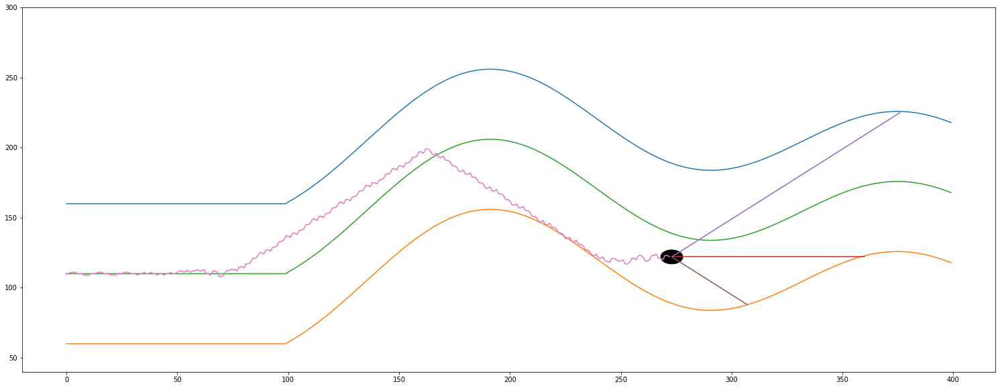

------------------------------ IF i % 3 == 0 ------------------------------
# i =  273
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (274, 3)
y.shape =  (274, 1)
i       =  273
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  273
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
--------------------------------------
[ 1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.
  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1. -1.  1.  1. -1.
 -1.]
(91, 4)
(91, 4)
[array([110.,  51., 138.,  51.]), array([111.,  50., 136.,  52.]), array([110.,  51., 132

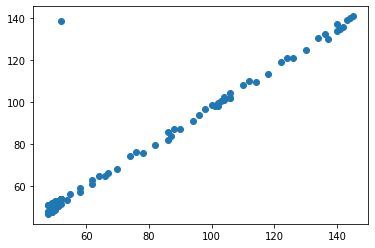

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[0.98373895 0.07080086]]


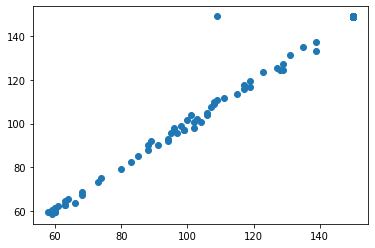

		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99606805 0.94467835]]


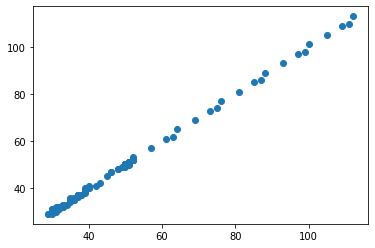

	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.80925108]]
-------- 1 y up ->  center =  [[2.60317009]]
-------- 1 y up ->  right  =  [[2.23676068]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[104  -3]]
		 _X_center =  [[88 -3]]
		 _X_right  =  [[35 -3]]
		 predicted_left   =  [[107.5675952]]
		 predicted_center =  [[87.90525503]]
		 predicted_right  =  [[32.32436083]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.93793228 -2.03782976]]
		 regression_center.coef_ =  [[0.98373895 0.07080086]]
		 regression_right.coef_  =  [[0.99

IndexError: ignored

In [7]:
auto.run()

<a name="irodalom"></a>

# Felhasznált irodalom és internetes cimek

Itt gyűjtöttem össze a menet közben összegyűjt okosságokat

[vissza a tartalomhoz](#tartalom)<br>

Scikit-learn - MLPRegressor API
<br>
https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPRegressor.html


Fogalmak és probléma meghatározás
<br>
https://www.rubrik.com/blog/architecture/20/12/customized-autoscaling--minimize-your-cloud-cost


https://github.com/kubernetes/autoscaler/blob/master/cluster-autoscaler/FAQ.md#what-are-the-parameters-to-ca

https://arxiv.org/pdf/1608.04030.pdf

Metrikák amivel a szollgáltatás minőségét mérik különböző esetekben
<br>
https://blog.avinetworks.com/autoscaling-metrics

------------

NumPy API Reference Guide
<br>
https://numpy.org/doc/stable/reference/random/generated/numpy.random.normal.html


Seaborn API Reference Guide
<br>
https://seaborn.pydata.org/examples/pair_grid_with_kde.html

